In [1]:
import yt
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from mpl_toolkits.axes_grid1 import make_axes_locatable
import json
import numpy as np
import os
import os.path
from mycolorpy import colorlist as mcp


yt.enable_plugins()

/home/dskinner6/software/yt-conda/envs/yt_analysis/lib/python3.10/site-packages/yt/utilities/logger.py:4: VisibleDeprecationWarning: The configuration file /home/dskinner6/.config/yt/ytrc is deprecated in favor of /home/dskinner6/.config/yt/yt.toml. Currently, both are present. Please manually remove the deprecated one to silence this warning.
Deprecated since v4.0.0. This feature will be removed in v4.1.0
  from yt.config import ytcfg
yt : [INFO     ] 2022-12-07 14:46:53,553 Loading plugins from /home/dskinner6/.config/yt/my_plugins.py


In [2]:
import matplotlib

font = {'family' : 'serif',
        'weight' : 'normal',
        'size'   : 18}

matplotlib.rc('font', **font)

In [3]:
run_dir = '/home/dskinner6/localdata/SG64-2020/'
data_dir = '/home/dskinner6/localdata/SG64-2020/NSM_analysis/run_data/'
image_outputs = '/home/dskinner6/localdata/SG64-2020/frontera_analysis/images/NSM_restart/'

In [4]:
stars = ['p3_living', 'p3_binary', 'ns_binary', 'bh', 'p2', 'dm']
types = [5, 12, 13, 6, 7, 1]

In [5]:
with open('param_info.json') as f:
    param_info = json.load(f)
    
with open('run_DD_data.json') as f:
    DD_data = json.load(f)
    
with open('run_halos.json') as f:
    run_halos = json.load(f)
    
with open('temp_run_info.json') as f:
    temp_run_info = json.load(f)
    
with open('halo_quantities.json') as f:
    halo_quantities = json.load(f)
    
with open('star_info.json') as f:
    star_info = json.load(f)
    
with open('massive_prog_info.json') as f:
    massive_prog = json.load(f)

In [6]:
## Profile plot fields for all datasets and for post-NSM
profile_fields = [('gas', 'metallicity'), ('gas', 'metallicity3'), ('gas', 'gas_fraction'), ('gas', 'temperature'), ('gas', 'electron_fraction'), ('gas', 'H2_fraction'), ('gas', 'density')]
profile_fields_postNSM = [("gas", "metallicity4")]

## Phase plot fields for all datasets and for post-NSM
phase_plot_fields = [[("gas", "density"), ("gas", "temperature")], [('index', 'radius'), ('gas', 'metallicity3')]]
phase_plot_colors = [[("gas", "cell_mass"), ("gas", "metallicity3")], [("gas", "cell_mass")]]
phase_plot_fields_postNSM = [[("gas", "metallicity3"), ("gas", "metallicity4")], [("gas", "density"), ("gas", "temperature")], [('index', 'radius'), ('gas', 'metallicity4')]]
phase_plot_colors_postNSM = [[("gas", "cell_mass")], [("gas", "metallicity4")], [("gas", "cell_mass")]]

## Projection plot fields for all datasets and for post-NSM
fields = [("gas", "density"), ('gas', 'temperature'), ('gas', 'metallicity'), ('gas', 'metallicity3')]
fields_postNSM = [('gas', 'metallicity4')]

## Halo quantities to calculate and their weights, pre- and post-NSM + some radiation fields
halo_quant_fields = [('gas', 'metallicity'), ('gas', 'metallicity3'), ('gas', 'gas_fraction'), ('gas', 'temperature'), (
'gas', 'electron_fraction'), ('gas', 'H2_fraction'), ('gas', 'density')]
halo_quant_weights = [('gas', 'density'), ('gas', 'cell_mass')]
halo_quant_radfields = [('gas', 'J21_LW'), ('gas', 'J_Lyman')]
halo_quant_radweights = [('index', 'ones')]
halo_quant_fields_postNSM = [('gas', 'metallicity4')]


units = {("gas", "density"):'g/cm**3', 
         ("gas", "temperature"):'K', 
         ("gas", "cell_mass"):'g', 
         ('gas', 'metallicity'):'Zsun',
         ("gas", "metallicity3"):'Zsun', 
         ("gas", "metallicity4"):"Zr",
         ('gas', 'gas_fraction'):"dimensionless",
         ('gas', 'electron_fraction'):"dimensionless",
         ('gas', 'H2_fraction'):"dimensionless",
         ('gas', 'J21_LW'):"dimensionless", 
         ('gas', 'J_Lyman'):"erg/cm**2",
         ('index', 'radius'):"pc"
        }

star_fields_p2 = [('p2', 'P2_metallicity_fraction'), ('p2', 'P3_metallicity_fraction'), ('p2', 'metallicity_fraction')]
star_fields_p3 = [('p3', 'P2_metallicity_fraction'), ('p3', 'P3_metallicity_fraction'), ('p3', 'metallicity_fraction')]
star_fields_postNSM_p2 = [('p2', 'NSM_metallicity_fraction')]
star_fields_postNSM_p3 = [('p3', 'NSM_metallicity_fraction')]

In [7]:
field_labels = {"density":r'Density $\left( \frac{g}{cm^{3}} \right)$', 
         "temperature":'Temperature (K)', 
         "cell_mass":'Mass [g]', 
         "metallicity3":r'Pop III Metallicity (Z$_{\odot}$)', 
         "metallicity4":r"NSM R-Process Metallicity (Z$_{r}$)",
         "metallicity":r"Pop II Metallicity (Z$_{\odot}$)",
        'gas_fraction':"Gas Fraction",
         'electron_fraction':"Electron Fraction",
         'H2_fraction':"H2 Fraction",
         'J21_LW':r"J$_{21}$", 
         'J_Lyman':r"J(Lyman) $\left( \frac{erg}{cm^{2}} \right)$",
        'radius':"r (pc)"
        }

colorbars = {"density":'viridis', 
         "temperature":'inferno', 
         "metallicity3":'magma', 
         "metallicity4":'magma',
         "metallicity":'magma'
        }

zlim = {}
zlim["density"] = (1e-27, 1e-23)
zlim["temperature"] = (1e3, 1e4)
zlim["metallicity"] = (1e-6, 1e-3)
zlim["metallicity3"] = (1e-10, 1e-2)
zlim["metallicity4"] = (1e-6, 1)


zlim_phase = {}
zlim_phase["density"] = (3e-28, 2e-20)
zlim_phase["temperature"] = (2e1, 2e7)
zlim_phase["metallicity3"] = (1e-3, 1)
zlim_phase["metallicity4"] = (1e-15, 1e5)
zlim_phase["cell_mass"] = (1e31, 2e38)
#zlim_phase["radius"] = (,)

## use one simulation to hard code the limits
## could set standard deviation

### Reorder star_info

In [8]:
new_star_info = {}
for i, run_name in enumerate(star_info):
    new_star_info[run_name] = {}
    keys = list(star_info[run_name].keys())
    keys = np.sort(keys)
    for key in keys:
        new_star_info[run_name][key] = {}
        new_star_info[run_name][key] = star_info[run_name][key]
        

In [9]:
halo_quant_fields = [('gas', 'metallicity'), ('gas', 'metallicity3'), ('gas', 'gas_fraction'), ('gas', 'temperature'), ('gas', 'electron_fraction'), ('gas', 'H2_fraction'), ('gas', 'density')]
halo_quant_radfields = [('gas', 'J21_LW'), ('gas', 'J_Lyman')]
halo_quant_weights = [('gas', 'density'), ('gas', 'cell_mass')]
halo_quant_radweights = [('index', 'ones')]
halo_quant_fields_postNSM = [('gas', 'metallicity4')]

In [10]:
NSM_time = {}

for i, run_name in enumerate(halo_quantities):
    
    target_type = 1
    
    for j, ds in enumerate(star_info[run_name]):
        if star_info[run_name][ds]['star_info']['chosen_star']['type'] == target_type:
            target_type = -1
            NSM_time[run_name] = DD_data[run_name][ds]['time']
            break

In [11]:
vary_energy = ['run_original', 'run_D', 'run_fiducial', 'run_E']
vary_time = ['run_original', 'run_A', 'run_B', 'run_fiducial', 'run_C']

In [12]:
NSM_time['run_C'] = 486

In [13]:
rprocess_enhanced = -8
high_rprocess_enhanced = -1

## Varying energy

### Halo quantities for energy runs

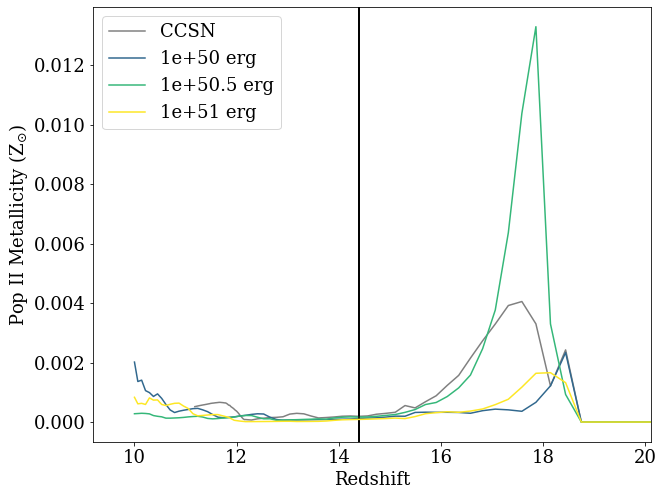

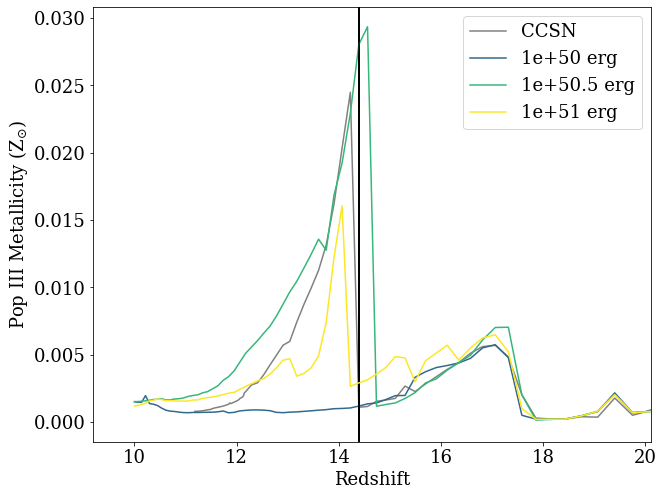

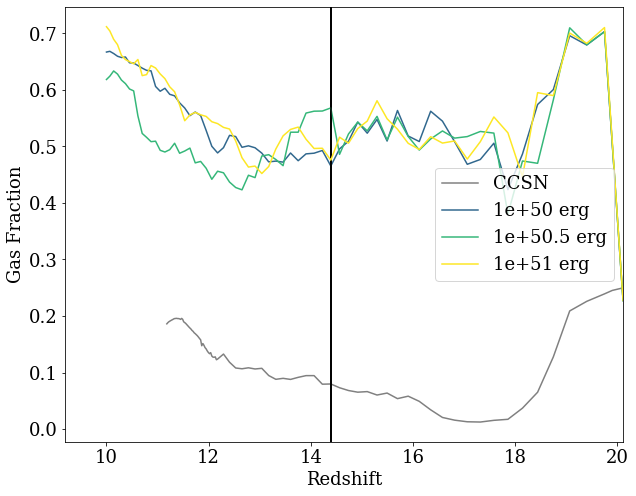

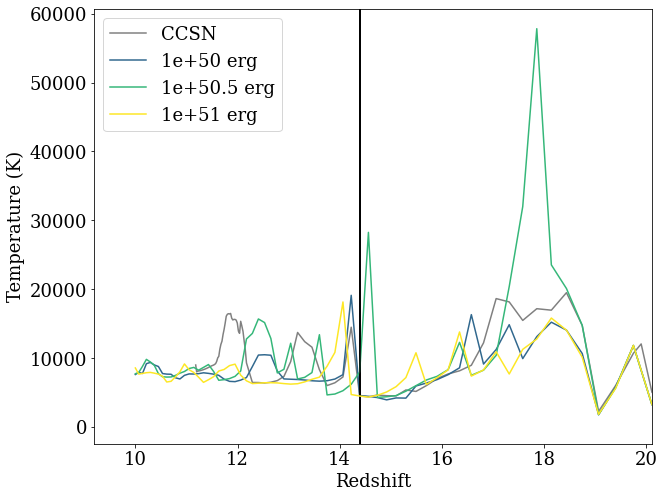

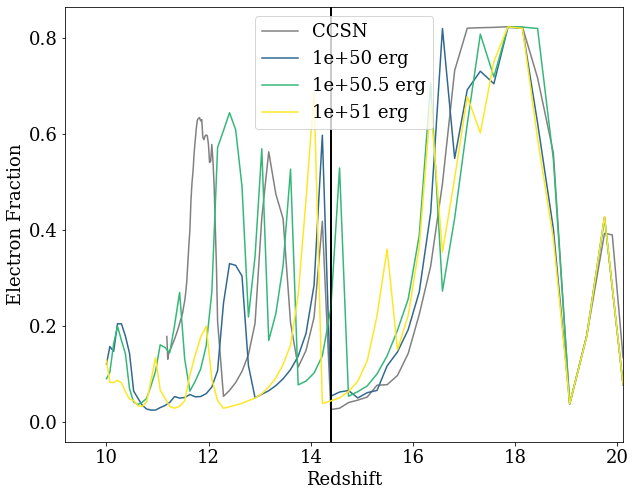

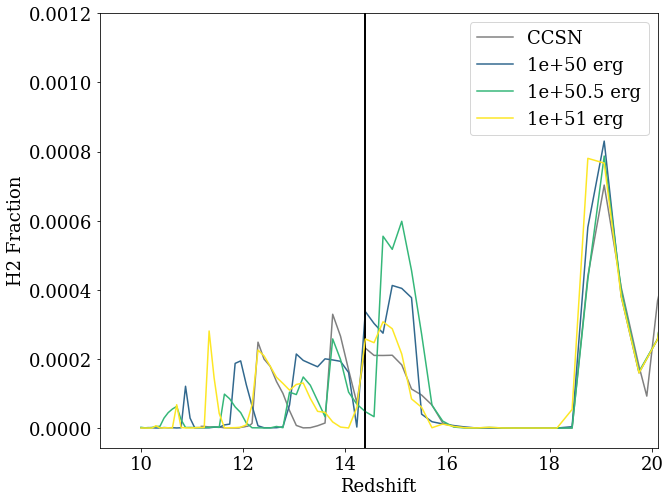

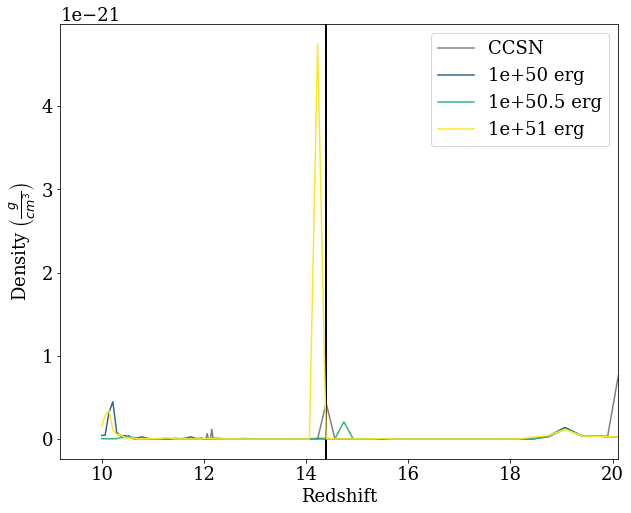

In [14]:
## Comparing energy

for field in halo_quant_fields:
    fig = plt.figure(figsize=(10, 8))
    colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))
    
    for i, run_name in enumerate(vary_energy):
        redshift = []
        y = []

        target_type = 1

        try:
            for j, ds in enumerate(halo_quantities[run_name]):
                redshift.append(DD_data[run_name][ds]['redshift'])
                y.append(halo_quantities[run_name][ds][field[1]]['cell_mass'])
                
                if run_name != 'run_original':
                    if star_info[run_name][ds]['star_info']['chosen_star']['type'] == target_type:
                        NSM_time = DD_data[run_name][ds]['redshift']
                        target_type = -1
        except Exception as e:
            print(e)
            print(run_name)
            print(ds)
            continue
            
        
        if run_name != 'run_original':
            plt.axvline(x = NSM_time, c = 'black')

        red_sorted = np.argsort(redshift)[::-1]
        redshift = np.array(redshift)[red_sorted]
        y = np.array(y)[red_sorted]
        
        if run_name != 'run_original':
            run_label = param_info[run_name]['energy'] + ' erg'
        else:
            run_label = 'CCSN'
        
        if run_name == 'run_original':
            plt.plot(redshift, y, label=run_label, c = 'gray')
        else:
            plt.plot(redshift, y, label=run_label, c = colors[i])
        
    #plt.title('cell_mass')
    plt.xlim(xmax=DD_data['run_A']['0037']['redshift'])
    plt.xlabel('Redshift')
    plt.ylabel(field_labels[field[1]])
    plt.legend()
    plt.show()


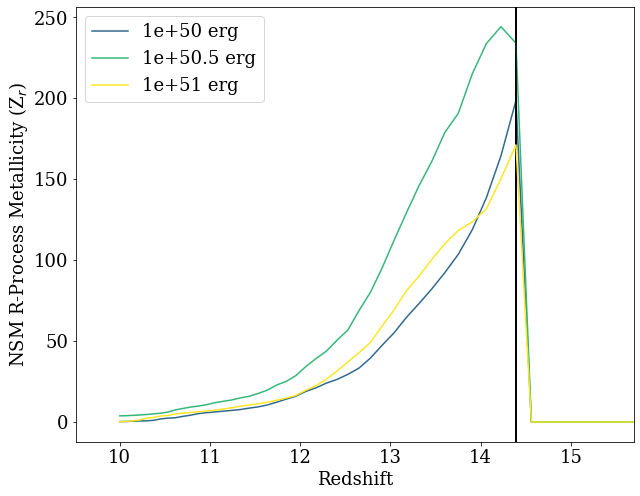

In [15]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
        redshift = []
        y = []

        target_type = 1

        for j, ds in enumerate(halo_quantities[run_name]):
            if int(ds) <= int('0037'):
                continue
            else:

                redshift.append(DD_data[run_name][ds]['redshift'])
                y.append(halo_quantities[run_name][ds]['metallicity4']['cell_mass'])
    
                if star_info[run_name][ds]['star_info']['chosen_star']['type'] == target_type:
                    NSM_time = DD_data[run_name][ds]['redshift']
                    target_type = -1

        plt.axvline(x = NSM_time, c = 'black')

        red_sorted = np.argsort(redshift)[::-1]
        redshift = np.array(redshift)[red_sorted]
        y = np.array(y)[red_sorted]
        run_label = param_info[run_name]['energy'] + ' erg'
        
        plt.plot(redshift, y, label=run_label, c = colors[i])    
#plt.title('cell_mass')
plt.xlim(xmax=DD_data['run_A']['0053']['redshift'])
plt.xlabel('Redshift')
plt.ylabel(field_labels['metallicity4'])
plt.legend()
plt.show()

Text(0, 0.5, 'Halo Mass [M$_{\\odot}$]')

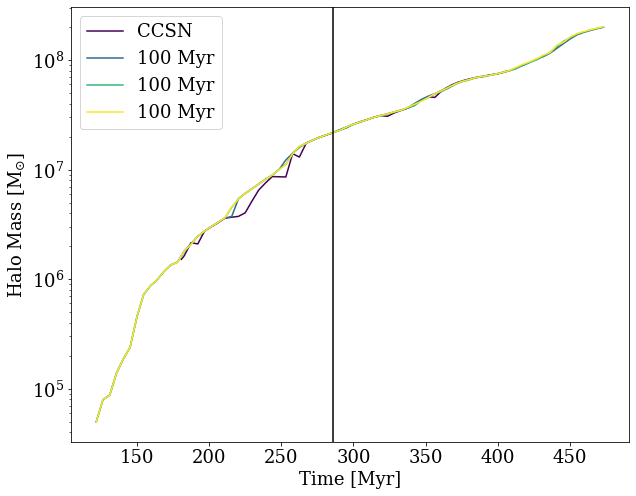

In [21]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

for i, run_name in enumerate(vary_energy):
    halo_mass = []
    time = []
    
    target_type = 1
    
    for j, ds in enumerate(run_halos[run_name]):
        
        
        if run_name != 'run_original':
            halo_mass.append(run_halos[run_name][ds]['mass'])
            time.append(DD_data[run_name][ds]['time'])
        else:
            halo_mass.append(massive_prog[ds]['mass'])
            time.append(DD_data[run_name][ds]['time'])
        
        
    

        
    if run_name != 'run_original':
            run_label = param_info[run_name]['delay_time'] + ' Myr'
    else:
        run_label = 'CCSN'
    plt.plot(time, halo_mass, label=run_label, c = colors[i])
    
plt.axvline(x = NSM_time[vary_energy[1]], c = 'black')  
plt.yscale('log')
plt.legend()
plt.xlabel('Time [Myr]')
plt.ylabel(r'Halo Mass [M$_{\odot}$]')
    

Text(0, 0.5, 'Halo Density [$\\frac{g}{cm^{3}}$]')

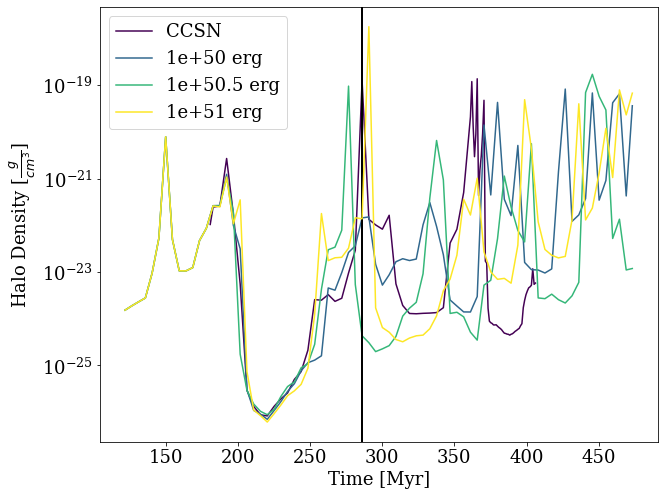

In [230]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

for i, run_name in enumerate(vary_energy):
    halo_density = []
    time = []
    
    target_type = 1
    
    for j, ds in enumerate(run_halos[run_name]):
        halo_density.append(halo_quantities[run_name][ds]['density']['density'])
        time.append(DD_data[run_name][ds]['time'])
        
        plt.axvline(x = NSM_time[vary_energy[1]], c = 'black') 
    

    if run_name != 'run_original':
            run_label = param_info[run_name]['energy'] + ' erg'
    else:
        run_label = 'CCSN'
    plt.plot(time, halo_density, label=run_label, c = colors[i])
    
  
plt.yscale('log')
plt.legend()
plt.xlabel('Time [Myr]')
plt.ylabel(r'Halo Density [$\frac{g}{cm^{3}}$]')

Text(0, 0.5, 'Total NSM R-process [$\\frac{g}{cm^{3}}$]')

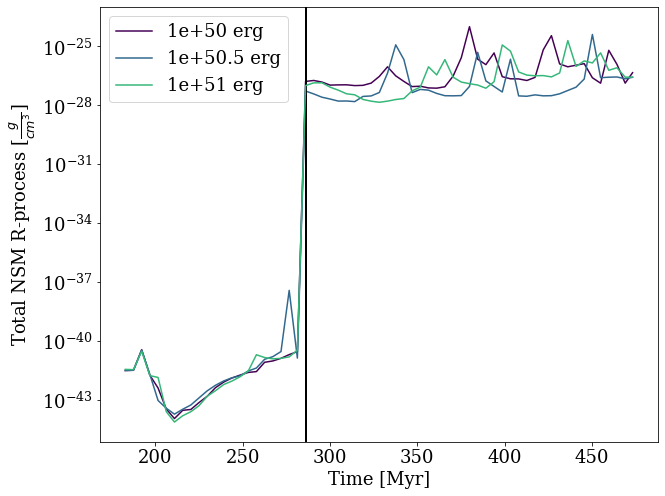

In [238]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

for i, run_name in enumerate(vary_energy[1::]):
    halo_density = []
    time = []
    
    target_type = 1
    
    for j, ds in enumerate(run_halos[run_name]):
        if ds < '0038':
            pass
        else:
            halo_density.append(halo_quantities[run_name][ds]['total_NSMRProcess']['none'])
            time.append(DD_data[run_name][ds]['time'])

            plt.axvline(x = NSM_time[vary_energy[1]], c = 'black') 


    if run_name != 'run_original':
            run_label = param_info[run_name]['energy'] + ' erg'
    else:
        run_label = 'CCSN'
    plt.plot(time, halo_density, label=run_label, c = colors[i])
    
  
plt.yscale('log')
plt.legend()
plt.xlabel('Time [Myr]')
plt.ylabel(r'Total NSM R-process [$\frac{g}{cm^{3}}$]')

run_original total # of P3 stars: 48
run_D total # of P3 stars: 65
run_fiducial total # of P3 stars: 59
run_E total # of P3 stars: 68


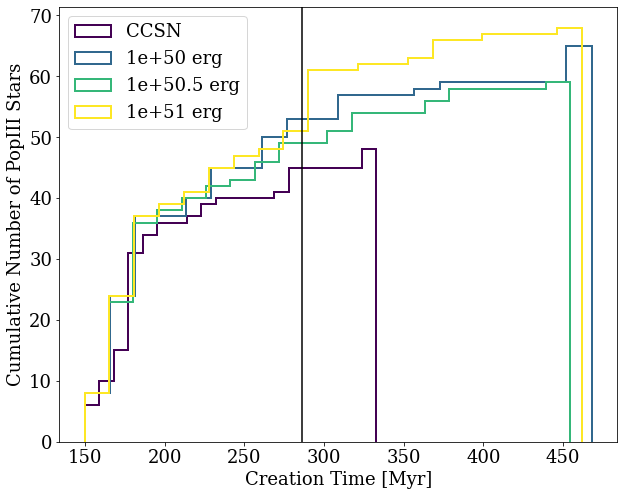

In [19]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
            run_label = param_info[run_name]['energy'] + ' erg'
    else:
        run_label = 'CCSN'
    
    final_ds = '0100'
        
    len_keys_p3 = len(star_info[run_name][final_ds]['star_info']['P3'])
    len_keys_p2 = len(star_info[run_name][final_ds]['star_info']['P2'])
    
    
    if len_keys_p3 > 1:
        number_p3 = len(star_info[run_name][final_ds]['star_info']['P3']['id'])
        ct_p3 = star_info[run_name][final_ds]['star_info']['P3']['creation_time']
    
    plt.hist(ct_p3, color = colors[i], label = run_label, edgecolor = colors[i], linewidth = 2, bins = 20, cumulative=True, histtype = 'step')
    print(run_name + ' total # of P3 stars: ' + str(number_p3))
plt.legend(loc = 'upper left')

plt.ylabel('Cumulative Number of PopIII Stars')
plt.xlabel('Creation Time [Myr]')
plt.axvline(NSM_time[vary_energy[1]], color = 'black')
#plt.savefig('/home/dskinner6/Dropbox/GaTech/GRAD/Group_Meeting_Presentations/Nov_4_2022/energy_num_PopIII.png', dpi = 300, facecolor='white')
plt.show()

run_original total # of P2 stars: 18
run_D total # of P2 stars: 74
run_fiducial total # of P2 stars: 38
run_E total # of P2 stars: 52


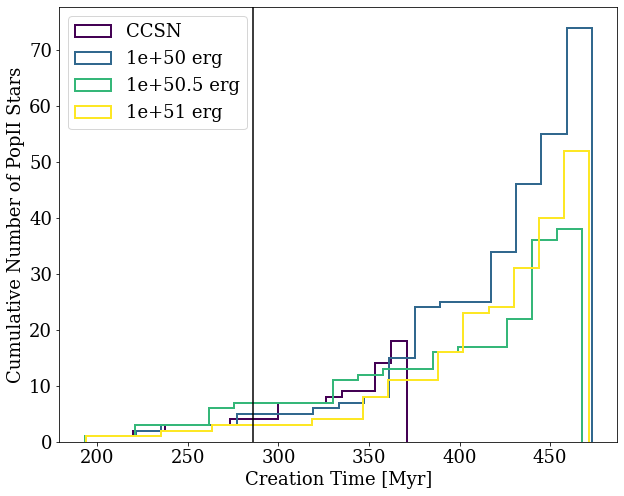

In [18]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
            run_label = param_info[run_name]['energy'] + ' erg'
    else:
        run_label = 'CCSN'
    
    final_ds = '0100'
        
    len_keys_p3 = len(star_info[run_name][final_ds]['star_info']['P3'])
    len_keys_p2 = len(star_info[run_name][final_ds]['star_info']['P2'])

    if len_keys_p2 > 1:
        number_p2 = len(star_info[run_name][final_ds]['star_info']['P2']['id'])
        ct_p2 = star_info[run_name][final_ds]['star_info']['P2']['creation_time']
    
    plt.hist(ct_p2, color = colors[i], label = run_label, bins = 20, edgecolor = colors[i], linewidth = 2, cumulative = True, histtype = 'step')
    print(run_name + ' total # of P2 stars: ' + str(number_p2))
plt.legend(loc = 'upper left')

plt.ylabel('Cumulative Number of PopII Stars')
plt.xlabel('Creation Time [Myr]')
plt.axvline(NSM_time[vary_energy[1]], color = 'black')
#plt.savefig('/home/dskinner6/Dropbox/GaTech/GRAD/Group_Meeting_Presentations/Nov_4_2022/energy_num_PopII.png', dpi = 300, facecolor='white')
plt.show()

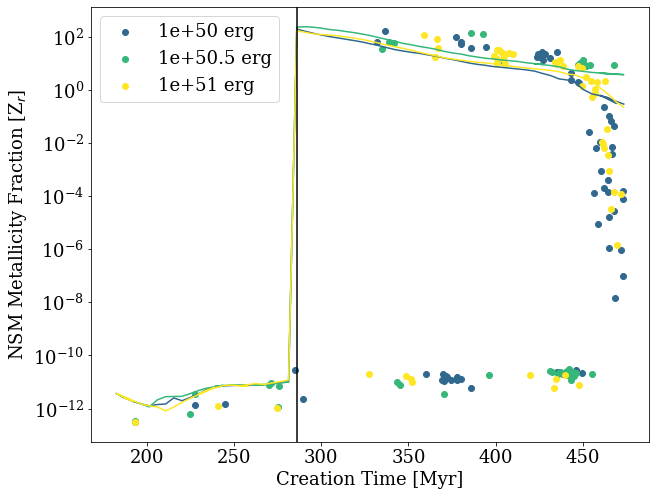

In [105]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

met_bins = np.logspace(-4, -6)

for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
            run_label = param_info[run_name]['energy'] + ' erg'
            
            final_ds = '0100'
            NSM_p2 = star_info[run_name][final_ds]['star_info']['P2']['NSM_metallicity_fraction']
            P3_p2 = star_info[run_name][final_ds]['star_info']['P2']['P3_metallicity_fraction']
            ct_p2 = star_info[run_name][final_ds]['star_info']['P2']['creation_time']


            plt.scatter(ct_p2, NSM_p2, c = colors[i], label = run_label)
            
            NSM_density = []
            time = []
            for j, ds in enumerate(halo_quantities[run_name]):
                try:
                    NSM_density.append(halo_quantities[run_name][ds]['metallicity4']['cell_mass'])
                    time.append(DD_data[run_name][ds]['time'])
                except Exception as e:
                    pass
            plt.plot(time, NSM_density, c = colors[i])
    else:
        run_label = 'CCSN'

    

    

plt.legend()
plt.ylabel(r'NSM Metallicity Fraction [Z$_{r}$]')
plt.xlabel('Creation Time [Myr]')
plt.axvline(NSM_time[vary_energy[1]], color = 'black')
plt.yscale('log')
plt.savefig('/home/dskinner6/Dropbox/GaTech/GRAD/Group_Meeting_Presentations/Nov_4_2022/energy_NSM_metallicity.png', dpi = 300, facecolor='white')

1e+50 erg
Number of r-process enhanced P2 stars:  45
Number of highly r-process enhanced P2 stars:  24
Total P2 stellar mass:  5.301264671209496
Mass fraction of r-process enhanced P2 stars:  0.8808091020869119
Mass fraction of highly r-process enhanced P2 stars:  0.23995271957607792
Smallest creation time:  193.3938016842685
Largest creation time:  473.02959760882703


1e+50.5 erg
Number of r-process enhanced P2 stars:  13
Number of highly r-process enhanced P2 stars:  13
Total P2 stellar mass:  4.659901341088855
Mass fraction of r-process enhanced P2 stars:  0.32573379662688695
Mass fraction of highly r-process enhanced P2 stars:  0.32573379662688695
Smallest creation time:  193.158276339343
Largest creation time:  467.5831193487362


1e+51 erg
Number of r-process enhanced P2 stars:  40
Number of highly r-process enhanced P2 stars:  30
Total P2 stellar mass:  5.4723634264861545
Mass fraction of r-process enhanced P2 stars:  0.9609794866837091
Mass fraction of highly r-process enhance

/tmp/ipykernel_19232/2069659164.py:15: RuntimeWarning: divide by zero encountered in log10
  NSM_p3 = np.log10(star_info[run_name][final_ds]['star_info']['P3']['NSM_metallicity_fraction'])


(-13.0, 3.0)

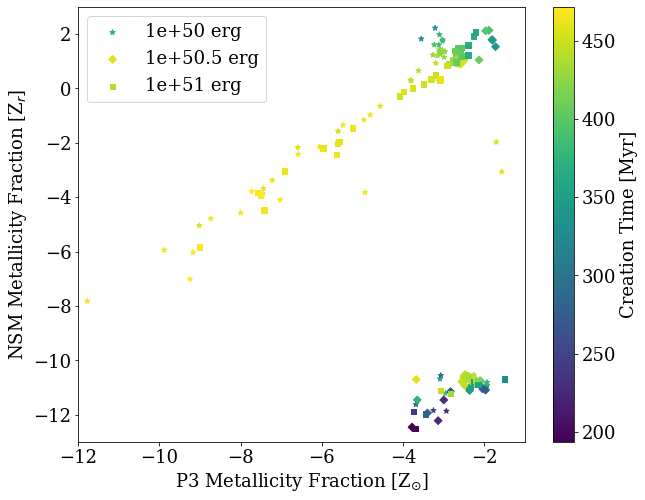

In [93]:
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))
markers = ['.', '*', 'D', 's']

met_bins = np.logspace(-4, -6)
fig = plt.figure(figsize=(10, 8))
for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
        
        run_label = param_info[run_name]['energy'] + ' erg'
        final_ds = '0100'
        NSM_p2 = np.log10(star_info[run_name][final_ds]['star_info']['P2']['NSM_metallicity_fraction'])
        P3_p2 = np.log10(star_info[run_name][final_ds]['star_info']['P2']['P3_metallicity_fraction'])
        ct_p2 = star_info[run_name][final_ds]['star_info']['P2']['creation_time']

        NSM_p3 = np.log10(star_info[run_name][final_ds]['star_info']['P3']['NSM_metallicity_fraction'])
        
        p2_mass = np.array(star_info[run_name][final_ds]['star_info']['P2']['mass'])
        total_p2_mass = np.sum(p2_mass)
        
        rproc_stars = np.sum(p2_mass[NSM_p2 > rprocess_enhanced])
        high_rproc_stars = np.sum(p2_mass[NSM_p2 > high_rprocess_enhanced])
        
        plt.scatter(P3_p2, NSM_p2, c = ct_p2, marker = markers[i], s = 30, label = run_label)
        
        rproc_frac = rproc_stars / total_p2_mass
        high_rproc_frac = high_rproc_stars / total_p2_mass
        
        print(run_label)
        print('Number of r-process enhanced P2 stars: ', len(NSM_p2[NSM_p2 > rprocess_enhanced]))
        print('Number of highly r-process enhanced P2 stars: ', len(NSM_p2[NSM_p2 > high_rprocess_enhanced]))
        print('Total P2 stellar mass: ', np.log10(total_p2_mass))
        print('Mass fraction of r-process enhanced P2 stars: ', rproc_frac)
        print('Mass fraction of highly r-process enhanced P2 stars: ', high_rproc_frac)
        print('Smallest creation time: ', np.min(ct_p2))
        print('Largest creation time: ', np.max(ct_p2))
        
        print('\n')
    else:
        run_label = 'CCSN'


cbar = plt.colorbar()
cbar.set_label('Creation Time [Myr]')
plt.ylabel(r'NSM Metallicity Fraction [Z$_{r}$]')
plt.xlabel(r'P3 Metallicity Fraction [Z$_{\odot}$]')
plt.legend()
plt.xlim(-12, -1)
plt.ylim(-13, 3)


In [122]:
## For making animation of the above plot
from matplotlib.lines import Line2D
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))
markers = ['.', '*', 'D']
marker_size = [50, 50, 20]
legend_elements = []
for i, run_name in enumerate(vary_energy[1::]):
    run_label = param_info[run_name]['energy'] + ' erg'
    legend_elements.append(Line2D([0], [0], marker=markers[i], color='w', label=run_label, markerfacecolor='black', markersize=15))


for i, ds in enumerate(DD_data['run_A']):
    if ds > '0038':
        fig = plt.figure(figsize=(10, 8))
        for j, run_name in enumerate(vary_energy[1::]):
            marker = markers[j]
            if len(star_info[run_name][ds]['star_info']['P2']['NSM_metallicity_fraction']) != 0: ## No p2
                run_label = param_info[run_name]['energy'] + ' erg'

                NSM_p2 = np.log10(star_info[run_name][ds]['star_info']['P2']['NSM_metallicity_fraction'])
                P3_p2 = np.log10(star_info[run_name][ds]['star_info']['P2']['P3_metallicity_fraction'])
                ct_p2 = star_info[run_name][ds]['star_info']['P2']['creation_time']
                
                plt.scatter(P3_p2, NSM_p2, c = ct_p2, marker = marker, s = marker_size[j], label = run_label)
                plt.clim(190, 475)
            else:
                pass
        if fig.get_axes():
            cbar = plt.colorbar()
            cbar.set_label('Creation Time [Myr]')
            plt.clim(190, 475)
            plt.ylabel(r'NSM Metallicity Fraction [Z$_{r}$]')
            plt.xlabel(r'P3 Metallicity Fraction [Z$_{\odot}$]')
            plt.legend(handles = legend_elements, loc = 'upper left')    
            plt.xlim(-12, -1)
            plt.ylim(-13, 3)
            plt.savefig(image_outputs + 'energy_NSM_P3_' + str(ds) + '.png', facecolor = 'white', dpi = 300)
            plt.close()
    else:
        pass

<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

In [92]:
## Finding which P2 stars formed inside the halo based on creation time -- done

inside_out = {}
for i, run_name in enumerate(vary_energy):
    inside_out[run_name] = {}
    
    inside_p2 = []
    outside_p2 = []

    z = np.array([DD_data[run_name][ds]['redshift'] for ds in DD_data[run_name].keys()])
    time = np.array([DD_data[run_name][ds]['time'] for ds in DD_data[run_name].keys()])
    outputs = np.array([ds for ds in DD_data[run_name].keys()])

    if run_name == 'run_original':
        for j, ds in enumerate(star_info[run_name]):
            if len(star_info[run_name][ds]['star_info']['P2']) != 0:
                p2_ct = star_info[run_name][ds]['star_info']['P2']['creation_time']
                p2_pos = star_info[run_name][ds]['star_info']['P2']['position']
                p2_id = star_info[run_name][ds]['star_info']['P2']['id']

                for k, ct in enumerate(p2_ct):
                    diff = np.abs(time - ct)
                    min_index = np.argmin(diff)

                    data = yt.load(f'../{run_name}/DD{outputs[min_index]}/output_{outputs[min_index]}')
                    halo_pos = data.arr(run_halos[run_name][outputs[min_index]]['position'], 'unitary').to('kpc').v
                    halo_rvir = data.quan(run_halos[run_name][outputs[min_index]]['rvir'], 'unitary').to('kpc').v

                    dr = np.sqrt(((p2_pos[k] - halo_pos)**2).sum())

                    if dr < halo_rvir:
                        if p2_id[k] not in inside_p2:
                            inside_p2.append(p2_id[k])
                    else:
                        if p2_id[k] not in outside_p2:
                            outside_p2.append(p2_id[k])
    else:
        for j, ds in enumerate(star_info[run_name]):
            if ds > '0038':
                if len(star_info[run_name][ds]['star_info']['P2']['NSM_metallicity_fraction']) != 0:
                    p2_ct = star_info[run_name][ds]['star_info']['P2']['creation_time']
                    p2_pos = star_info[run_name][ds]['star_info']['P2']['position']
                    p2_id = star_info[run_name][ds]['star_info']['P2']['id']

                    for k, ct in enumerate(p2_ct):
                        diff = np.abs(time - ct)
                        min_index = np.argmin(diff)

                        data = yt.load(f'../{run_name}/DD{outputs[min_index]}/output_{outputs[min_index]}')
                        halo_pos = data.arr(run_halos[run_name][outputs[min_index]]['position'], 'unitary').to('kpc').v
                        halo_rvir = data.quan(run_halos[run_name][outputs[min_index]]['rvir'], 'unitary').to('kpc').v

                        dr = np.sqrt(((p2_pos[k] - halo_pos)**2).sum())

                        if dr < halo_rvir:
                            if p2_id[k] not in inside_p2:
                                inside_p2.append(p2_id[k])
                        else:
                            if p2_id[k] not in outside_p2:
                                outside_p2.append(p2_id[k])

    inside_out[run_name]['inside'] = {}
    inside_out[run_name]['outside'] = {}
    
    inside_out[run_name]['inside']['P2'] = inside_p2
    inside_out[run_name]['outside']['P2'] = outside_p2


yt : [INFO     ] 2022-12-02 08:42:51,034 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:42:51,035 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:51,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:51,036 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:51,037 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:51,037 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:42:51,037 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:51,037 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:51,037 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:51,038 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:51,080 Parameters: current_time              = 35.902224325004
yt 

yt : [INFO     ] 2022-12-02 08:42:51,431 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:51,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:51,432 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:51,432 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:51,432 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:42:51,433 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:51,433 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:51,433 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:51,433 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:51,473 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:42:51,473 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:42:51,819 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:51,819 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:51,820 Parameters: current_redshift          = 16.122360779053
yt : [INFO     ] 2022-12-02 08:42:51,820 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:51,820 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:51,821 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:51,821 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:51,861 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:42:51,861 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:51,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:51,862 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:42:52,211 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:42:52,211 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:52,211 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:52,212 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:52,212 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:52,252 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:42:52,252 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:52,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:52,253 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:52,254 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:52,254 Parameters: current_redshift          = 19.067255608031
yt 

yt : [INFO     ] 2022-12-02 08:42:52,596 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:52,597 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:52,597 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:52,597 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:52,638 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:42:52,639 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:52,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:52,640 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:52,640 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:52,641 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:42:52,641 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:42:52,986 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:52,986 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:53,025 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:42:53,025 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:53,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:53,026 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:53,027 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:53,027 Parameters: current_redshift          = 16.122360779053
yt : [INFO     ] 2022-12-02 08:42:53,027 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:53,027 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:53,028 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:42:53,412 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:42:53,414 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:53,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:53,416 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:53,416 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:53,416 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:42:53,416 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:53,417 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:53,417 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:53,417 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:53,457 Parameters: current_time              = 45.550775583546
yt 

yt : [INFO     ] 2022-12-02 08:42:53,813 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:53,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:53,814 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:53,814 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:53,815 Parameters: current_redshift          = 13.906052826651
yt : [INFO     ] 2022-12-02 08:42:53,815 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:53,815 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:53,815 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:53,816 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:53,856 Parameters: current_time              = 57.830767258154
yt : [INFO     ] 2022-12-02 08:42:53,856 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:42:54,205 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:54,205 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:54,205 Parameters: current_redshift          = 13.906052826651
yt : [INFO     ] 2022-12-02 08:42:54,208 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:54,208 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:54,208 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:54,209 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:54,250 Parameters: current_time              = 57.830767258154
yt : [INFO     ] 2022-12-02 08:42:54,250 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:54,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:54,252 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:42:54,609 Parameters: current_redshift          = 13.602991811142
yt : [INFO     ] 2022-12-02 08:42:54,610 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:54,610 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:54,610 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:54,610 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:54,651 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:42:54,652 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:54,653 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:54,653 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:54,653 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:54,654 Parameters: current_redshift          = 16.122360779053
yt 

yt : [INFO     ] 2022-12-02 08:42:55,004 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:55,004 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:55,005 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:55,005 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:55,045 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:42:55,046 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:55,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:55,047 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:55,047 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:55,047 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:42:55,048 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:42:55,395 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:55,395 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:55,434 Parameters: current_time              = 56.953627289249
yt : [INFO     ] 2022-12-02 08:42:55,435 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:55,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:55,436 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:55,437 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:55,437 Parameters: current_redshift          = 13.752577816662
yt : [INFO     ] 2022-12-02 08:42:55,437 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:55,437 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:55,437 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:42:55,823 Parameters: current_time              = 56.953627289249
yt : [INFO     ] 2022-12-02 08:42:55,824 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:55,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:55,825 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:55,825 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:55,825 Parameters: current_redshift          = 13.752577816662
yt : [INFO     ] 2022-12-02 08:42:55,825 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:55,825 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:55,826 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:55,826 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:55,867 Parameters: current_time              = 35.902224325004
yt 

yt : [INFO     ] 2022-12-02 08:42:56,216 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:56,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:56,217 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:56,218 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:56,218 Parameters: current_redshift          = 13.752577816662
yt : [INFO     ] 2022-12-02 08:42:56,218 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:56,218 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:56,218 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:56,219 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:56,259 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:42:56,260 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:42:56,611 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:56,612 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:56,612 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:42:56,612 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:56,612 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:56,613 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:56,613 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:56,654 Parameters: current_time              = 56.076487368796
yt : [INFO     ] 2022-12-02 08:42:56,654 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:56,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:56,655 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:42:57,007 Parameters: current_redshift          = 13.602991811142
yt : [INFO     ] 2022-12-02 08:42:57,008 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:57,008 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:57,008 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:57,008 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:57,050 Parameters: current_time              = 56.953627289249
yt : [INFO     ] 2022-12-02 08:42:57,050 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:57,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:57,051 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:57,052 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:57,052 Parameters: current_redshift          = 13.752577816662
yt 

yt : [INFO     ] 2022-12-02 08:42:57,396 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:57,396 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:57,396 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:57,397 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:57,436 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:42:57,437 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:57,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:57,439 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:57,439 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:57,439 Parameters: current_redshift          = 16.122360779053
yt : [INFO     ] 2022-12-02 08:42:57,440 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:42:57,786 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:57,786 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:57,826 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:42:57,827 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:57,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:57,828 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:57,828 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:57,828 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:42:57,829 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:57,829 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:57,829 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:42:58,220 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:42:58,221 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:58,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:58,222 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:58,222 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:58,223 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:42:58,223 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:58,223 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:58,223 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:58,223 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:58,262 Parameters: current_time              = 67.479336441745
yt 

yt : [INFO     ] 2022-12-02 08:42:58,612 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:58,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:58,613 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:58,614 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:58,614 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:42:58,614 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:58,614 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:58,614 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:58,614 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:58,658 Parameters: current_time              = 63.970765382809
yt : [INFO     ] 2022-12-02 08:42:58,658 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:42:59,015 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:59,016 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:59,016 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:42:59,016 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:59,016 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:59,017 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:59,017 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:59,056 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:42:59,057 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:59,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:59,058 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:42:59,407 Parameters: current_redshift          = 16.122360779053
yt : [INFO     ] 2022-12-02 08:42:59,407 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:59,407 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:59,407 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:59,408 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:59,448 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:42:59,448 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:59,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:59,449 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:59,450 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:59,450 Parameters: current_redshift          = 16.815352691798
yt 

yt : [INFO     ] 2022-12-02 08:42:59,797 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:42:59,797 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:42:59,798 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:42:59,798 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:42:59,837 Parameters: current_time              = 66.602151694332
yt : [INFO     ] 2022-12-02 08:42:59,837 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:42:59,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:42:59,839 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:42:59,839 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:42:59,839 Parameters: current_redshift          = 12.290595651462
yt : [INFO     ] 2022-12-02 08:42:59,839 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:00,187 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:00,188 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:00,229 Parameters: current_time              = 57.830767258154
yt : [INFO     ] 2022-12-02 08:43:00,230 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:00,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:00,231 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:00,231 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:00,231 Parameters: current_redshift          = 13.602991811142
yt : [INFO     ] 2022-12-02 08:43:00,232 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:00,232 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:00,232 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:00,623 Parameters: current_time              = 56.953627289249
yt : [INFO     ] 2022-12-02 08:43:00,624 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:00,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:00,625 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:00,626 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:00,626 Parameters: current_redshift          = 13.752577816662
yt : [INFO     ] 2022-12-02 08:43:00,626 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:00,626 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:00,627 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:00,627 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:00,667 Parameters: current_time              = 62.216448098055
yt 

yt : [INFO     ] 2022-12-02 08:43:01,014 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:01,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:01,016 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:01,017 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:01,018 Parameters: current_redshift          = 12.107048733093
yt : [INFO     ] 2022-12-02 08:43:01,018 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:01,019 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:01,019 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:01,019 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:01,059 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:43:01,060 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:01,412 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:01,412 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:01,412 Parameters: current_redshift          = 12.652717788525
yt : [INFO     ] 2022-12-02 08:43:01,413 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:01,413 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:01,413 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:01,413 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:01,453 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:43:01,454 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:01,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:01,455 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:01,800 Parameters: current_redshift          = 12.290595651462
yt : [INFO     ] 2022-12-02 08:43:01,801 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:01,801 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:01,801 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:01,801 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:01,840 Parameters: current_time              = 66.602151694332
yt : [INFO     ] 2022-12-02 08:43:01,841 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:01,841 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:01,842 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:01,842 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:01,843 Parameters: current_redshift          = 12.290595651462
yt 

yt : [INFO     ] 2022-12-02 08:43:02,200 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:02,201 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:02,201 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:02,201 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:02,240 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:43:02,241 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:02,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:02,242 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:02,242 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:02,243 Parameters: current_redshift          = 16.122360779053
yt : [INFO     ] 2022-12-02 08:43:02,243 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:02,580 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:02,581 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:02,623 Parameters: current_time              = 67.83016755114
yt : [INFO     ] 2022-12-02 08:43:02,624 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:02,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:02,625 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:02,625 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:02,625 Parameters: current_redshift          = 12.129645353526
yt : [INFO     ] 2022-12-02 08:43:02,625 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:02,626 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:02,626 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:43:03,012 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:43:03,013 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:03,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:03,014 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:03,014 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:03,015 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:43:03,015 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:03,015 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:03,015 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:03,015 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:03,055 Parameters: current_time              = 66.602151694332
yt 

yt : [INFO     ] 2022-12-02 08:43:03,399 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:03,399 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:03,400 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:03,400 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:03,401 Parameters: current_redshift          = 12.290595651462
yt : [INFO     ] 2022-12-02 08:43:03,401 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:03,401 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:03,401 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:03,402 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:03,442 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:03,442 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:03,789 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:03,790 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:03,790 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:43:03,790 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:03,790 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:03,791 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:03,791 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:03,830 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:43:03,831 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:03,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:03,832 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:04,180 Parameters: current_redshift          = 12.129645353526
yt : [INFO     ] 2022-12-02 08:43:04,180 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:04,181 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:04,181 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:04,181 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:04,223 Parameters: current_time              = 68.00559595114
yt : [INFO     ] 2022-12-02 08:43:04,224 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:04,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:04,225 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:04,225 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:04,226 Parameters: current_redshift          = 12.107048733093
yt :

yt : [INFO     ] 2022-12-02 08:43:04,572 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:04,572 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:04,572 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:04,572 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:04,612 Parameters: current_time              = 66.602151694332
yt : [INFO     ] 2022-12-02 08:43:04,613 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:04,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:04,614 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:04,614 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:04,615 Parameters: current_redshift          = 12.290595651462
yt : [INFO     ] 2022-12-02 08:43:04,615 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:04,963 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:04,963 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:05,003 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:43:05,003 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:05,004 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:05,005 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:05,005 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:05,005 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:43:05,005 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:05,005 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:05,006 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:05,391 Parameters: current_time              = 56.953627289249
yt : [INFO     ] 2022-12-02 08:43:05,391 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:05,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:05,392 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:05,393 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:05,393 Parameters: current_redshift          = 13.752577816662
yt : [INFO     ] 2022-12-02 08:43:05,393 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:05,393 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:05,394 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:05,394 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:05,434 Parameters: current_time              = 66.602151694332
yt 

yt : [INFO     ] 2022-12-02 08:43:05,777 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:05,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:05,779 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:05,779 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:05,779 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:43:05,779 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:05,780 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:05,780 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:05,780 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:05,820 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:43:05,821 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:06,165 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:06,165 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:06,166 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:43:06,166 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:06,166 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:06,166 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:06,166 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:06,206 Parameters: current_time              = 66.602151694332
yt : [INFO     ] 2022-12-02 08:43:06,207 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:06,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:06,208 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:06,550 Parameters: current_redshift          = 11.951548441635
yt : [INFO     ] 2022-12-02 08:43:06,551 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:06,551 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:06,551 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:06,551 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:06,590 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:43:06,591 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:06,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:06,592 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:06,592 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:06,593 Parameters: current_redshift          = 12.908242835631
yt 

yt : [INFO     ] 2022-12-02 08:43:06,951 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:06,951 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:06,952 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:06,952 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:06,991 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:43:06,992 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:06,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:06,993 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:06,993 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:06,993 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:43:06,994 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:07,336 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:07,336 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:07,375 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:43:07,376 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:07,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:07,377 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:07,377 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:07,378 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:43:07,378 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:07,378 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:07,378 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:07,763 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:07,763 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:07,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:07,765 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:07,765 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:07,765 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:07,765 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:07,766 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:07,766 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:07,766 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:07,806 Parameters: current_time              = 67.83016755114
yt :

yt : [INFO     ] 2022-12-02 08:43:08,154 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:08,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:08,156 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:08,156 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:08,156 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:43:08,156 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:08,157 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:08,158 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:08,159 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:08,199 Parameters: current_time              = 63.970765382809
yt : [INFO     ] 2022-12-02 08:43:08,200 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:08,549 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:08,549 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:08,549 Parameters: current_redshift          = 12.290595651462
yt : [INFO     ] 2022-12-02 08:43:08,549 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:08,550 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:08,550 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:08,550 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:08,589 Parameters: current_time              = 66.602151694332
yt : [INFO     ] 2022-12-02 08:43:08,590 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:08,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:08,591 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:08,936 Parameters: current_redshift          = 12.652717788525
yt : [INFO     ] 2022-12-02 08:43:08,937 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:08,937 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:08,937 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:08,937 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:08,977 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:43:08,977 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:08,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:08,979 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:08,979 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:08,979 Parameters: current_redshift          = 14.737872196384
yt 

yt : [INFO     ] 2022-12-02 08:43:09,323 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:09,323 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:09,323 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:09,323 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:09,362 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:09,363 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:09,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:09,364 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:09,364 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:09,364 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:09,364 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:09,711 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:09,711 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:09,751 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:43:09,752 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:09,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:09,753 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:09,753 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:09,754 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:43:09,754 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:09,754 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:09,754 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:10,145 Parameters: current_time              = 66.602151694332
yt : [INFO     ] 2022-12-02 08:43:10,146 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:10,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:10,147 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:10,147 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:10,148 Parameters: current_redshift          = 12.290595651462
yt : [INFO     ] 2022-12-02 08:43:10,148 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:10,148 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:10,148 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:10,148 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:10,191 Parameters: current_time              = 67.479336441745
yt 

yt : [INFO     ] 2022-12-02 08:43:10,564 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:10,564 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:10,565 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:10,565 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:10,565 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:43:10,566 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:10,566 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:10,566 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:10,566 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:10,609 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:43:10,609 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:10,984 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:10,984 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:10,984 Parameters: current_redshift          = 12.062145241998
yt : [INFO     ] 2022-12-02 08:43:10,984 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:10,985 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:10,985 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:10,985 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:11,027 Parameters: current_time              = 66.602151694332
yt : [INFO     ] 2022-12-02 08:43:11,027 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:11,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:11,029 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:11,400 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:43:11,400 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:11,400 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:11,400 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:11,401 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:11,442 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:43:11,443 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:11,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:11,444 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:11,445 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:11,445 Parameters: current_redshift          = 14.737872196384
yt 

yt : [INFO     ] 2022-12-02 08:43:11,815 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:11,815 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:11,816 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:11,816 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:11,858 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:11,859 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:11,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:11,860 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:11,860 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:11,861 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:11,861 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:12,225 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:12,225 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:12,265 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:43:12,265 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:12,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:12,267 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:12,267 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:12,268 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:43:12,268 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:12,268 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:12,269 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:12,653 Parameters: current_time              = 66.602151694332
yt : [INFO     ] 2022-12-02 08:43:12,653 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:12,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:12,654 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:12,655 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:12,655 Parameters: current_redshift          = 12.290595651462
yt : [INFO     ] 2022-12-02 08:43:12,655 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:12,655 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:12,656 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:12,656 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:12,695 Parameters: current_time              = 67.479336441745
yt 

yt : [INFO     ] 2022-12-02 08:43:13,052 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:13,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:13,053 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:13,054 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:13,054 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:43:13,054 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:13,054 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:13,055 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:13,055 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:13,096 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:43:13,096 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:13,445 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:13,446 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:13,446 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:13,446 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:13,446 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:13,447 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:13,447 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:13,486 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:13,486 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:13,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:13,488 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:13,834 Parameters: current_redshift          = 12.652717788525
yt : [INFO     ] 2022-12-02 08:43:13,834 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:13,834 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:13,834 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:13,835 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:13,874 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:43:13,875 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:13,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:13,876 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:13,876 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:13,877 Parameters: current_redshift          = 16.122360779053
yt 

yt : [INFO     ] 2022-12-02 08:43:14,221 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:14,221 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:14,221 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:14,221 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:14,262 Parameters: current_time              = 68.35645275114
yt : [INFO     ] 2022-12-02 08:43:14,263 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:14,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:14,264 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:14,265 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:14,265 Parameters: current_redshift          = 12.062145241998
yt : [INFO     ] 2022-12-02 08:43:14,265 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:43:14,614 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:14,614 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:14,656 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:43:14,657 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:14,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:14,658 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:14,658 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:14,658 Parameters: current_redshift          = 16.122360779053
yt : [INFO     ] 2022-12-02 08:43:14,658 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:14,659 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:14,659 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:15,042 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:15,043 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:15,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:15,044 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:15,044 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:15,044 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:15,045 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:15,045 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:15,045 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:15,045 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:15,085 Parameters: current_time              = 67.83016755114
yt :

yt : [INFO     ] 2022-12-02 08:43:15,430 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:15,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:15,431 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:15,431 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:15,432 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:43:15,432 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:15,432 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:15,432 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:15,432 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:15,473 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:43:15,473 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:15,823 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:15,824 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:15,824 Parameters: current_redshift          = 13.752577816662
yt : [INFO     ] 2022-12-02 08:43:15,824 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:15,824 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:15,824 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:15,825 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:15,865 Parameters: current_time              = 56.076487368796
yt : [INFO     ] 2022-12-02 08:43:15,866 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:15,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:15,867 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:16,214 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:43:16,214 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:16,214 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:16,215 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:16,215 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:16,256 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:43:16,256 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:16,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:16,258 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:16,258 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:16,260 Parameters: current_redshift          = 16.122360779053
yt 

yt : [INFO     ] 2022-12-02 08:43:16,605 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:16,605 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:16,605 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:16,605 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:16,645 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:16,646 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:16,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:16,647 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:16,647 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:16,648 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:16,648 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:16,988 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:16,989 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:17,028 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:43:17,028 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:17,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:17,029 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:17,030 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:17,030 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:43:17,030 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:17,030 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:17,030 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:17,413 Parameters: current_time              = 57.830767258154
yt : [INFO     ] 2022-12-02 08:43:17,414 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:17,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:17,415 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:17,416 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:17,416 Parameters: current_redshift          = 13.602991811142
yt : [INFO     ] 2022-12-02 08:43:17,416 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:17,416 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:17,416 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:17,417 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:17,456 Parameters: current_time              = 67.83016755114
yt :

yt : [INFO     ] 2022-12-02 08:43:17,800 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:17,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:17,801 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:17,801 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:17,801 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:43:17,801 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:17,802 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:17,802 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:17,802 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:17,842 Parameters: current_time              = 69.23359475114
yt : [INFO     ] 2022-12-02 08:43:17,842 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:43:18,200 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:18,201 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:18,201 Parameters: current_redshift          = 12.107048733093
yt : [INFO     ] 2022-12-02 08:43:18,201 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:18,201 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:18,201 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:18,202 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:18,243 Parameters: current_time              = 68.35645275114
yt : [INFO     ] 2022-12-02 08:43:18,244 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:18,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:18,245 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:43:18,589 Parameters: current_redshift          = 11.951548441635
yt : [INFO     ] 2022-12-02 08:43:18,589 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:18,589 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:18,590 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:18,590 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:18,630 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:43:18,631 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:18,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:18,633 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:18,633 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:18,633 Parameters: current_redshift          = 16.122360779053
yt 

yt : [INFO     ] 2022-12-02 08:43:18,981 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:18,981 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:18,981 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:18,981 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:19,024 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:19,025 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:19,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:19,026 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:19,026 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:19,027 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:19,027 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:19,396 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:19,397 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:19,438 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:43:19,439 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:19,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:19,440 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:19,441 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:19,441 Parameters: current_redshift          = 16.122360779053
yt : [INFO     ] 2022-12-02 08:43:19,441 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:19,441 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:19,442 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:19,842 Parameters: current_time              = 67.83016755114
yt : [INFO     ] 2022-12-02 08:43:19,843 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:19,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:19,844 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:19,844 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:19,845 Parameters: current_redshift          = 12.129645353526
yt : [INFO     ] 2022-12-02 08:43:19,845 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:19,845 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:19,845 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:19,845 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:19,885 Parameters: current_time              = 68.00559595114
yt : 

yt : [INFO     ] 2022-12-02 08:43:20,237 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:20,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:20,240 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:20,241 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:20,241 Parameters: current_redshift          = 12.290595651462
yt : [INFO     ] 2022-12-02 08:43:20,241 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:20,241 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:20,242 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:20,242 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:20,285 Parameters: current_time              = 66.602151694332
yt : [INFO     ] 2022-12-02 08:43:20,285 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:20,651 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:20,651 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:20,651 Parameters: current_redshift          = 13.752577816662
yt : [INFO     ] 2022-12-02 08:43:20,652 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:20,652 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:20,652 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:20,652 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:20,695 Parameters: current_time              = 56.076487368796
yt : [INFO     ] 2022-12-02 08:43:20,696 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:20,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:20,698 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:21,066 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:43:21,066 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:21,066 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:21,067 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:21,067 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:21,109 Parameters: current_time              = 56.953627289249
yt : [INFO     ] 2022-12-02 08:43:21,109 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:21,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:21,110 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:21,111 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:21,111 Parameters: current_redshift          = 13.752577816662
yt 

yt : [INFO     ] 2022-12-02 08:43:21,467 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:21,467 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:21,467 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:21,467 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:21,507 Parameters: current_time              = 69.23359475114
yt : [INFO     ] 2022-12-02 08:43:21,507 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:21,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:21,508 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:21,509 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:21,509 Parameters: current_redshift          = 11.951548441635
yt : [INFO     ] 2022-12-02 08:43:21,509 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:43:21,871 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:21,871 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:21,913 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:43:21,914 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:21,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:21,915 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:21,915 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:21,915 Parameters: current_redshift          = 16.122360779053
yt : [INFO     ] 2022-12-02 08:43:21,916 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:21,916 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:21,916 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:22,306 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:22,307 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:22,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:22,308 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:22,308 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:22,309 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:22,309 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:22,309 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:22,309 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:22,309 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:22,350 Parameters: current_time              = 67.479336441745
yt 

yt : [INFO     ] 2022-12-02 08:43:22,710 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:22,710 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:22,711 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:22,711 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:22,711 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:43:22,712 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:22,712 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:22,712 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:22,712 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:22,753 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:43:22,754 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:23,101 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:23,102 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:23,102 Parameters: current_redshift          = 12.290595651462
yt : [INFO     ] 2022-12-02 08:43:23,102 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:23,102 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:23,103 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:23,103 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:23,144 Parameters: current_time              = 66.602151694332
yt : [INFO     ] 2022-12-02 08:43:23,144 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:23,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:23,145 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:23,505 Parameters: current_redshift          = 13.906052826651
yt : [INFO     ] 2022-12-02 08:43:23,505 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:23,505 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:23,506 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:23,506 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:23,545 Parameters: current_time              = 57.830767258154
yt : [INFO     ] 2022-12-02 08:43:23,546 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:23,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:23,547 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:23,547 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:23,547 Parameters: current_redshift          = 13.602991811142
yt 

yt : [INFO     ] 2022-12-02 08:43:23,890 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:23,890 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:23,890 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:23,890 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:23,929 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:23,930 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:23,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:23,931 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:23,931 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:23,931 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:23,931 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:24,272 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:24,272 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:24,311 Parameters: current_time              = 69.23359475114
yt : [INFO     ] 2022-12-02 08:43:24,311 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:24,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:24,312 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:24,313 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:24,313 Parameters: current_redshift          = 11.951548441635
yt : [INFO     ] 2022-12-02 08:43:24,313 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:24,313 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:24,313 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:43:24,693 Parameters: current_time              = 68.35645275114
yt : [INFO     ] 2022-12-02 08:43:24,694 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:24,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:24,695 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:24,695 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:24,696 Parameters: current_redshift          = 12.062145241998
yt : [INFO     ] 2022-12-02 08:43:24,696 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:24,696 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:24,696 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:24,696 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:24,735 Parameters: current_time              = 67.479336441745
yt :

yt : [INFO     ] 2022-12-02 08:43:25,080 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:25,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:25,081 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:25,081 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:25,081 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:25,082 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:25,082 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:25,082 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:25,082 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:25,122 Parameters: current_time              = 56.953627289249
yt : [INFO     ] 2022-12-02 08:43:25,123 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:25,468 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:25,468 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:25,469 Parameters: current_redshift          = 12.652717788525
yt : [INFO     ] 2022-12-02 08:43:25,469 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:25,469 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:25,469 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:25,469 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:25,510 Parameters: current_time              = 69.23359475114
yt : [INFO     ] 2022-12-02 08:43:25,510 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:25,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:25,511 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:43:25,858 Parameters: current_redshift          = 12.652717788525
yt : [INFO     ] 2022-12-02 08:43:25,859 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:25,859 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:25,861 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:25,861 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:25,901 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:25,902 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:25,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:25,903 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:25,904 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:25,904 Parameters: current_redshift          = 12.175128801855
yt 

yt : [INFO     ] 2022-12-02 08:43:26,251 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:26,251 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:26,251 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:26,252 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:26,291 Parameters: current_time              = 56.953627289249
yt : [INFO     ] 2022-12-02 08:43:26,292 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:26,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:26,293 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:26,293 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:26,293 Parameters: current_redshift          = 13.752577816662
yt : [INFO     ] 2022-12-02 08:43:26,294 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:26,638 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:26,639 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:26,678 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:26,679 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:26,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:26,680 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:26,680 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:26,680 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:26,681 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:26,681 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:26,681 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:27,073 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:27,073 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:27,074 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:27,074 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:27,075 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:27,075 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:27,075 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:27,075 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:27,076 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:27,076 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:27,116 Parameters: current_time              = 67.83016755114
yt :

yt : [INFO     ] 2022-12-02 08:43:27,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:27,463 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:27,463 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:27,463 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:43:27,463 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:27,464 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:27,464 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:27,464 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:27,505 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:43:27,505 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:27,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:27,859 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:27,859 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:43:27,860 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:27,860 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:27,860 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:27,860 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:27,900 Parameters: current_time              = 63.970765382809
yt : [INFO     ] 2022-12-02 08:43:27,901 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:27,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:27,902 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:27,903 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:28,253 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:28,253 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:28,253 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:28,254 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:28,294 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:43:28,294 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:28,295 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:28,296 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:28,296 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:28,297 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:43:28,297 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:28,648 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:28,648 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:28,688 Parameters: current_time              = 63.970765382809
yt : [INFO     ] 2022-12-02 08:43:28,689 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:28,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:28,690 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:28,690 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:28,690 Parameters: current_redshift          = 12.652717788525
yt : [INFO     ] 2022-12-02 08:43:28,691 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:28,691 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:28,691 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:29,086 Parameters: current_time              = 68.00559595114
yt : [INFO     ] 2022-12-02 08:43:29,087 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:29,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:29,088 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:29,089 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:29,089 Parameters: current_redshift          = 12.107048733093
yt : [INFO     ] 2022-12-02 08:43:29,089 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:29,089 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:29,089 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:29,090 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:29,131 Parameters: current_time              = 68.35645275114
yt : 

yt : [INFO     ] 2022-12-02 08:43:29,483 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:29,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:29,484 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:29,484 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:29,485 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:43:29,485 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:29,485 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:29,485 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:29,485 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:29,525 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:43:29,525 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:29,880 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:29,880 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:29,881 Parameters: current_redshift          = 13.906052826651
yt : [INFO     ] 2022-12-02 08:43:29,881 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:29,881 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:29,881 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:29,882 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:29,922 Parameters: current_time              = 57.830767258154
yt : [INFO     ] 2022-12-02 08:43:29,922 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:29,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:29,924 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:30,278 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:30,278 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:30,278 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:30,278 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:30,279 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:30,318 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:43:30,319 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:30,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:30,320 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:30,322 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:30,323 Parameters: current_redshift          = 16.815352691798
yt 

yt : [INFO     ] 2022-12-02 08:43:30,673 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:30,673 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:30,674 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:30,674 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:30,714 Parameters: current_time              = 67.479336441745
yt : [INFO     ] 2022-12-02 08:43:30,714 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:30,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:30,715 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:30,716 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:30,716 Parameters: current_redshift          = 12.175128801855
yt : [INFO     ] 2022-12-02 08:43:30,716 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:31,062 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:31,062 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:31,104 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:43:31,105 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:31,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:31,106 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:31,106 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:31,107 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:43:31,107 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:31,107 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:31,107 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:31,496 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:43:31,497 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:31,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:31,498 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:31,498 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:31,498 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:43:31,499 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:31,499 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:31,499 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:31,499 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:31,539 Parameters: current_time              = 42.919355000398
yt 

yt : [INFO     ] 2022-12-02 08:43:31,891 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:31,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:31,893 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:31,893 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:31,893 Parameters: current_redshift          = 12.652717788525
yt : [INFO     ] 2022-12-02 08:43:31,894 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:31,894 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:31,894 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:31,894 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:31,934 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:43:31,935 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:32,287 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:32,287 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:32,288 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:43:32,288 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:32,288 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:32,288 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:32,288 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:32,329 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:43:32,330 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:32,330 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:32,331 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:32,676 Parameters: current_redshift          = 13.906052826651
yt : [INFO     ] 2022-12-02 08:43:32,676 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:32,676 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:32,676 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:32,677 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:32,716 Parameters: current_time              = 57.830767258154
yt : [INFO     ] 2022-12-02 08:43:32,717 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:32,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:32,718 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:32,718 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:32,718 Parameters: current_redshift          = 13.602991811142
yt 

yt : [INFO     ] 2022-12-02 08:43:33,063 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:33,064 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:33,064 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:33,065 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:33,104 Parameters: current_time              = 68.35645275114
yt : [INFO     ] 2022-12-02 08:43:33,104 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:33,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:33,106 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:33,106 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:33,107 Parameters: current_redshift          = 12.062145241998
yt : [INFO     ] 2022-12-02 08:43:33,107 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:43:33,458 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:33,458 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:33,500 Parameters: current_time              = 69.23359475114
yt : [INFO     ] 2022-12-02 08:43:33,500 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:33,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:33,501 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:33,502 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:33,502 Parameters: current_redshift          = 11.951548441635
yt : [INFO     ] 2022-12-02 08:43:33,502 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:33,502 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:33,502 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:43:33,898 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:43:33,898 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:33,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:33,900 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:33,900 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:33,900 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:43:33,901 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:33,901 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:33,901 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:33,901 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:33,944 Parameters: current_time              = 66.602151694332
yt 

yt : [INFO     ] 2022-12-02 08:43:34,296 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:34,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:34,297 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:34,297 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:34,298 Parameters: current_redshift          = 12.129645353526
yt : [INFO     ] 2022-12-02 08:43:34,298 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:34,298 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:34,298 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:34,299 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:34,341 Parameters: current_time              = 45.550775583546
yt : [INFO     ] 2022-12-02 08:43:34,341 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:34,693 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:34,693 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:34,694 Parameters: current_redshift          = 12.290595651462
yt : [INFO     ] 2022-12-02 08:43:34,694 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:34,694 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:34,694 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:34,694 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:34,734 Parameters: current_time              = 66.602151694332
yt : [INFO     ] 2022-12-02 08:43:34,734 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:34,735 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:34,736 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:35,084 Parameters: current_redshift          = 13.602991811142
yt : [INFO     ] 2022-12-02 08:43:35,084 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:35,084 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:35,084 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:35,085 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:35,149 Parameters: current_time              = 35.902223039
yt : [INFO     ] 2022-12-02 08:43:35,149 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:35,150 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:35,150 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:35,151 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:35,151 Parameters: current_redshift          = 19.067256087276
yt : [

yt : [INFO     ] 2022-12-02 08:43:35,541 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:35,541 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:35,542 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:35,596 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 08:43:35,597 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:35,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:35,598 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:35,599 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:35,599 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:43:35,599 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:35,599 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:43:35,974 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:36,013 Parameters: current_time              = 35.902223039
yt : [INFO     ] 2022-12-02 08:43:36,014 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:36,014 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:36,015 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:36,015 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:36,015 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 08:43:36,016 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:36,016 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:36,016 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:36,016 Parameters: hubble_constant           = 0.6766
yt : [INFO     

yt : [INFO     ] 2022-12-02 08:43:36,424 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:36,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:36,425 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:36,426 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:36,426 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:43:36,426 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:36,426 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:36,427 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:36,427 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:36,468 Parameters: current_time              = 45.550777112042
yt : [INFO     ] 2022-12-02 08:43:36,469 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:43:36,819 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:36,819 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:36,819 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 08:43:36,820 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:36,820 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:36,820 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:36,820 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:36,860 Parameters: current_time              = 45.550777112042
yt : [INFO     ] 2022-12-02 08:43:36,861 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:36,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:36,862 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:37,232 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:43:37,232 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:37,232 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:37,232 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:37,233 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:37,296 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:43:37,297 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:37,297 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:37,298 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:37,298 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:37,299 Parameters: current_redshift          = 14.22534076655
yt : 

yt : [INFO     ] 2022-12-02 08:43:37,672 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:37,672 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:37,672 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:37,712 Parameters: current_time              = 45.550777112042
yt : [INFO     ] 2022-12-02 08:43:37,712 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:37,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:37,714 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:37,714 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:37,714 Parameters: current_redshift          = 16.12236039596
yt : [INFO     ] 2022-12-02 08:43:37,714 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:37,714 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:43:38,061 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:38,101 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 08:43:38,101 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:38,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:38,102 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:38,103 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:38,103 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:43:38,103 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:38,103 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:38,103 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:38,104 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:43:38,489 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:38,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:38,490 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:38,491 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:38,491 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 08:43:38,491 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:38,491 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:38,492 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:38,492 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:38,531 Parameters: current_time              = 53.445049586229
yt : [INFO     ] 2022-12-02 08:43:38,532 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:43:38,880 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:38,880 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:38,881 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 08:43:38,881 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:38,881 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:38,881 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:38,881 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:38,924 Parameters: current_time              = 35.902223039
yt : [INFO     ] 2022-12-02 08:43:38,925 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:38,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:38,926 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:39,287 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:43:39,288 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:39,288 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:39,288 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:39,289 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:39,350 Parameters: current_time              = 62.216452601104
yt : [INFO     ] 2022-12-02 08:43:39,350 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:39,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:39,351 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:39,352 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:39,352 Parameters: current_redshift          = 12.908242164355
yt :

yt : [INFO     ] 2022-12-02 08:43:39,729 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:39,730 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:39,730 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:39,776 Parameters: current_time              = 62.216452601104
yt : [INFO     ] 2022-12-02 08:43:39,777 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:39,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:39,778 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:39,778 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:39,778 Parameters: current_redshift          = 12.908242164355
yt : [INFO     ] 2022-12-02 08:43:39,778 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:39,779 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:40,139 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:40,180 Parameters: current_time              = 62.216452601104
yt : [INFO     ] 2022-12-02 08:43:40,182 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:40,183 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:40,184 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:40,185 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:40,185 Parameters: current_redshift          = 12.908242164355
yt : [INFO     ] 2022-12-02 08:43:40,185 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:40,185 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:40,186 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:40,186 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:40,590 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:40,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:40,592 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:40,593 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:40,593 Parameters: current_redshift          = 16.12236039596
yt : [INFO     ] 2022-12-02 08:43:40,593 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:40,593 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:40,594 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:40,594 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:40,634 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:43:40,634 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:43:40,983 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:40,983 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:40,983 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 08:43:40,983 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:40,984 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:40,984 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:40,984 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:41,023 Parameters: current_time              = 45.550777112042
yt : [INFO     ] 2022-12-02 08:43:41,024 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:41,024 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:41,025 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:41,395 Parameters: current_redshift          = 12.779002700647
yt : [INFO     ] 2022-12-02 08:43:41,396 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:41,396 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:41,396 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:41,396 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:41,436 Parameters: current_time              = 62.216452601104
yt : [INFO     ] 2022-12-02 08:43:41,436 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:41,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:41,438 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:41,438 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:41,438 Parameters: current_redshift          = 12.908242164355
yt 

yt : [INFO     ] 2022-12-02 08:43:41,832 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:41,833 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:41,833 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:41,872 Parameters: current_time              = 35.902223039
yt : [INFO     ] 2022-12-02 08:43:41,873 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:41,874 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:41,874 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:41,875 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:41,875 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 08:43:41,875 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:41,875 Parameters: omega_matter              = 0.3111
yt : [INFO     

yt : [INFO     ] 2022-12-02 08:43:42,253 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:42,294 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:43:42,295 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:42,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:42,296 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:42,297 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:42,297 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:43:42,298 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:42,298 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:42,298 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:42,298 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:42,712 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:42,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:42,713 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:42,713 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:42,714 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:43:42,714 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:42,714 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:42,714 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:42,714 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:42,754 Parameters: current_time              = 35.902223039
yt : [INFO     ] 2022-12-02 08:43:42,755 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO 

yt : [INFO     ] 2022-12-02 08:43:43,127 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:43,127 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:43,128 Parameters: current_redshift          = 11.843261643098
yt : [INFO     ] 2022-12-02 08:43:43,128 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:43,128 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:43,128 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:43,128 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:43,192 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:43:43,192 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:43,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:43,193 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:43,563 Parameters: current_redshift          = 11.843261643098
yt : [INFO     ] 2022-12-02 08:43:43,563 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:43,563 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:43,564 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:43,564 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:43,608 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:43:43,608 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:43,609 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:43,609 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:43,610 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:43,610 Parameters: current_redshift          = 11.73720984745
yt :

yt : [INFO     ] 2022-12-02 08:43:43,971 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:43,971 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:43,971 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:43,971 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:44,012 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:43:44,013 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:44,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:44,014 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:44,014 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:44,014 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 08:43:44,015 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:43:44,362 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:44,362 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:44,403 Parameters: current_time              = 67.479300441899
yt : [INFO     ] 2022-12-02 08:43:44,404 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:44,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:44,405 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:44,405 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:44,405 Parameters: current_redshift          = 12.175133489269
yt : [INFO     ] 2022-12-02 08:43:44,405 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:44,406 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:44,406 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:44,795 Parameters: current_time              = 53.445049586229
yt : [INFO     ] 2022-12-02 08:43:44,796 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:44,796 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:44,797 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:44,797 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:44,797 Parameters: current_redshift          = 14.391507458596
yt : [INFO     ] 2022-12-02 08:43:44,797 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:44,798 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:44,798 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:44,798 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:44,838 Parameters: current_time              = 69.233591483042
yt 

yt : [INFO     ] 2022-12-02 08:43:45,212 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:45,213 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:45,213 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:45,213 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 08:43:45,213 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:45,213 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:45,214 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:45,214 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:45,253 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:43:45,254 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:45,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:43:45,597 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:45,597 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 08:43:45,597 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:45,598 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:45,598 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:45,598 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:45,638 Parameters: current_time              = 45.550777112042
yt : [INFO     ] 2022-12-02 08:43:45,638 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:45,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:45,639 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:45,640 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:43:46,002 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:46,002 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:46,003 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:46,003 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:46,042 Parameters: current_time              = 63.093590464559
yt : [INFO     ] 2022-12-02 08:43:46,043 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:46,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:46,044 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:46,044 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:46,045 Parameters: current_redshift          = 12.779002700647
yt : [INFO     ] 2022-12-02 08:43:46,045 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:46,414 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:46,414 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:46,455 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 08:43:46,456 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:46,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:46,457 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:46,458 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:46,458 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:43:46,458 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:46,458 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:46,459 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:43:46,865 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:43:46,865 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:46,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:46,867 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:46,867 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:46,867 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:43:46,867 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:46,868 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:46,868 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:46,868 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:46,910 Parameters: current_time              = 70.110738553065
yt 

yt : [INFO     ] 2022-12-02 08:43:47,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:47,277 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:47,277 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:47,277 Parameters: current_redshift          = 11.843261643098
yt : [INFO     ] 2022-12-02 08:43:47,277 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:47,278 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:47,278 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:47,278 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:47,319 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:43:47,320 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:47,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:47,698 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:47,698 Parameters: current_redshift          = 11.843261643098
yt : [INFO     ] 2022-12-02 08:43:47,699 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:47,699 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:47,699 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:47,699 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:47,738 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:43:47,738 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:47,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:47,740 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:47,740 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:48,100 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:48,100 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:48,101 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:48,101 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:48,141 Parameters: current_time              = 71.865019613805
yt : [INFO     ] 2022-12-02 08:43:48,141 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:48,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:48,143 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:48,143 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:48,143 Parameters: current_redshift          = 11.633318278137
yt : [INFO     ] 2022-12-02 08:43:48,143 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:48,497 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:48,497 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:48,537 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:43:48,538 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:48,538 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:48,539 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:48,539 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:48,539 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 08:43:48,540 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:48,540 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:48,540 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:43:48,923 Parameters: current_time              = 53.445049586229
yt : [INFO     ] 2022-12-02 08:43:48,924 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:48,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:48,925 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:48,926 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:48,926 Parameters: current_redshift          = 14.391507458596
yt : [INFO     ] 2022-12-02 08:43:48,926 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:48,926 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:48,926 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:48,927 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:48,966 Parameters: current_time              = 69.233591483042
yt 

yt : [INFO     ] 2022-12-02 08:43:49,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:49,313 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:49,313 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:49,314 Parameters: current_redshift          = 11.431741217351
yt : [INFO     ] 2022-12-02 08:43:49,314 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:49,314 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:49,314 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:49,314 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:49,354 Parameters: current_time              = 67.479300441899
yt : [INFO     ] 2022-12-02 08:43:49,354 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:49,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:49,696 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:49,697 Parameters: current_redshift          = 11.843261643098
yt : [INFO     ] 2022-12-02 08:43:49,697 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:49,697 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:49,697 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:49,697 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:49,737 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:43:49,737 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:49,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:49,738 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:49,739 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:50,082 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:50,082 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:50,083 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:50,083 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:50,124 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:43:50,125 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:50,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:50,126 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:50,127 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:50,127 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 08:43:50,127 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:43:50,478 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:50,478 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:50,518 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:43:50,519 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:50,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:50,520 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:50,520 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:50,520 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 08:43:50,521 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:50,521 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:50,521 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:43:50,903 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:43:50,903 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:50,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:50,904 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:50,905 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:50,905 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:43:50,905 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:50,905 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:50,906 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:50,906 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:50,945 Parameters: current_time              = 69.233591483042
yt 

yt : [INFO     ] 2022-12-02 08:43:51,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:51,310 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:51,310 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:51,311 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:43:51,311 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:51,311 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:51,312 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:51,312 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:51,353 Parameters: current_time              = 67.479300441899
yt : [INFO     ] 2022-12-02 08:43:51,354 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:51,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:43:51,721 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:51,721 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:43:51,722 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:51,722 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:51,722 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:51,722 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:51,763 Parameters: current_time              = 70.110738553065
yt : [INFO     ] 2022-12-02 08:43:51,764 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:51,765 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:51,765 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:51,765 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:52,121 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:52,121 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:52,121 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:52,122 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:52,163 Parameters: current_time              = 71.865019613805
yt : [INFO     ] 2022-12-02 08:43:52,164 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:52,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:52,165 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:52,165 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:52,166 Parameters: current_redshift          = 11.633318278137
yt : [INFO     ] 2022-12-02 08:43:52,166 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:52,531 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:52,532 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:52,573 Parameters: current_time              = 71.865019613805
yt : [INFO     ] 2022-12-02 08:43:52,573 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:52,574 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:52,574 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:52,575 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:52,575 Parameters: current_redshift          = 11.633318278137
yt : [INFO     ] 2022-12-02 08:43:52,575 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:52,575 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:52,575 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:52,982 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:43:52,983 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:52,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:52,984 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:52,984 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:52,984 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:43:52,984 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:52,985 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:52,985 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:52,985 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:53,027 Parameters: current_time              = 45.550777112042
yt 

yt : [INFO     ] 2022-12-02 08:43:53,381 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:53,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:53,382 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:53,382 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:53,382 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 08:43:53,383 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:53,383 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:53,383 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:53,383 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:53,428 Parameters: current_time              = 67.479300441899
yt : [INFO     ] 2022-12-02 08:43:53,429 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:43:53,791 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:53,791 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:53,792 Parameters: current_redshift          = 11.431741217351
yt : [INFO     ] 2022-12-02 08:43:53,792 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:53,792 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:53,792 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:53,792 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:53,836 Parameters: current_time              = 62.216452601104
yt : [INFO     ] 2022-12-02 08:43:53,837 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:53,838 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:53,838 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:54,251 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:43:54,251 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:54,251 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:54,251 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:54,251 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:54,291 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:43:54,291 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:54,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:54,293 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:54,293 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:54,293 Parameters: current_redshift          = 11.951548849348
yt 

yt : [INFO     ] 2022-12-02 08:43:54,648 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:54,648 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:54,648 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:54,688 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:43:54,689 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:54,690 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:54,690 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:54,690 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:54,691 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 08:43:54,693 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:54,693 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:43:55,042 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:55,082 Parameters: current_time              = 71.865019613805
yt : [INFO     ] 2022-12-02 08:43:55,082 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:55,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:55,083 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:55,084 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:55,084 Parameters: current_redshift          = 11.633318278137
yt : [INFO     ] 2022-12-02 08:43:55,084 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:55,084 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:55,084 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:55,085 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:43:55,474 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:55,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:55,477 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:55,478 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:55,478 Parameters: current_redshift          = 12.779002700647
yt : [INFO     ] 2022-12-02 08:43:55,479 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:55,479 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:55,479 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:55,480 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:55,520 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:43:55,521 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:55,875 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:55,876 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:55,876 Parameters: current_redshift          = 10.784993757476
yt : [INFO     ] 2022-12-02 08:43:55,876 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:55,877 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:55,877 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:55,878 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:55,917 Parameters: current_time              = 79.759285106646
yt : [INFO     ] 2022-12-02 08:43:55,918 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:55,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:55,919 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:56,272 Parameters: current_redshift          = 11.843261643098
yt : [INFO     ] 2022-12-02 08:43:56,272 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:56,273 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:56,273 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:56,273 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:56,313 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 08:43:56,314 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:56,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:56,315 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:56,315 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:56,315 Parameters: current_redshift          = 16.81535244727
yt :

yt : [INFO     ] 2022-12-02 08:43:56,686 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:56,686 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:56,686 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:56,686 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:56,726 Parameters: current_time              = 35.902223039
yt : [INFO     ] 2022-12-02 08:43:56,726 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:56,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:56,728 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:56,728 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:56,728 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 08:43:56,728 Parameters: omega_lambda              = 0.6889
yt : [INFO     

yt : [INFO     ] 2022-12-02 08:43:57,107 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:57,107 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:57,151 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:43:57,152 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:57,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:57,153 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:57,153 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:57,154 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 08:43:57,154 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:57,154 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:57,154 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:43:57,546 Parameters: current_time              = 70.110738553065
yt : [INFO     ] 2022-12-02 08:43:57,547 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:57,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:57,548 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:57,548 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:57,548 Parameters: current_redshift          = 11.843261643098
yt : [INFO     ] 2022-12-02 08:43:57,549 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:57,549 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:57,549 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:57,549 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:57,590 Parameters: current_time              = 70.987877752039
yt 

yt : [INFO     ] 2022-12-02 08:43:57,976 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:57,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:57,977 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:57,977 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:57,978 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:43:57,978 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:57,978 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:57,978 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:57,978 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:58,017 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:43:58,018 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:58,366 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:58,367 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:58,367 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:43:58,367 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:58,367 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:58,367 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:58,368 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:58,407 Parameters: current_time              = 62.216452601104
yt : [INFO     ] 2022-12-02 08:43:58,408 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:58,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:58,409 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:43:58,767 Parameters: current_redshift          = 11.431741217351
yt : [INFO     ] 2022-12-02 08:43:58,768 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:58,768 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:58,768 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:58,768 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:58,809 Parameters: current_time              = 81.513582081656
yt : [INFO     ] 2022-12-02 08:43:58,809 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:58,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:58,810 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:58,811 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:58,811 Parameters: current_redshift          = 10.615216387716
yt 

yt : [INFO     ] 2022-12-02 08:43:59,178 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:59,179 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:59,179 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:59,179 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:59,219 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:43:59,219 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:59,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:59,221 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:59,221 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:59,221 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 08:43:59,221 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:43:59,561 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:59,561 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:43:59,601 Parameters: current_time              = 78.882156154962
yt : [INFO     ] 2022-12-02 08:43:59,603 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:59,604 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:59,605 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:59,605 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:59,605 Parameters: current_redshift          = 10.872233936144
yt : [INFO     ] 2022-12-02 08:43:59,606 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:59,606 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:59,606 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:43:59,987 Parameters: current_time              = 81.513582081656
yt : [INFO     ] 2022-12-02 08:43:59,988 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:43:59,988 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:43:59,989 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:43:59,989 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:43:59,990 Parameters: current_redshift          = 10.615216387716
yt : [INFO     ] 2022-12-02 08:43:59,990 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:43:59,990 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:43:59,990 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:43:59,991 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:00,042 Parameters: current_time              = 82.390717233422
yt 

yt : [INFO     ] 2022-12-02 08:44:00,411 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:00,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:00,412 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:00,413 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:00,413 Parameters: current_redshift          = 10.784993757476
yt : [INFO     ] 2022-12-02 08:44:00,413 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:00,413 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:00,413 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:00,413 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:00,455 Parameters: current_time              = 79.759285106646
yt : [INFO     ] 2022-12-02 08:44:00,456 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:00,814 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:00,814 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:00,814 Parameters: current_redshift          = 10.784993757476
yt : [INFO     ] 2022-12-02 08:44:00,814 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:00,815 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:00,815 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:00,815 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:00,855 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:44:00,856 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:00,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:00,857 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:01,202 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:44:01,202 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:01,203 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:01,203 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:01,203 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:01,242 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:44:01,243 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:01,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:01,244 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:01,244 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:01,245 Parameters: current_redshift          = 11.73720984745
yt :

yt : [INFO     ] 2022-12-02 08:44:01,612 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:01,612 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:01,612 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:01,613 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:01,653 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:44:01,653 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:01,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:01,654 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:01,655 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:01,655 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:44:01,655 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:02,005 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:02,006 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:02,046 Parameters: current_time              = 45.550777112042
yt : [INFO     ] 2022-12-02 08:44:02,047 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:02,047 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:02,048 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:02,048 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:02,048 Parameters: current_redshift          = 16.12236039596
yt : [INFO     ] 2022-12-02 08:44:02,049 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:02,049 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:02,049 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:44:02,466 Parameters: current_time              = 79.759285106646
yt : [INFO     ] 2022-12-02 08:44:02,466 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:02,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:02,468 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:02,468 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:02,468 Parameters: current_redshift          = 10.784993757476
yt : [INFO     ] 2022-12-02 08:44:02,468 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:02,469 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:02,469 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:02,469 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:02,531 Parameters: current_time              = 62.216452601104
yt 

yt : [INFO     ] 2022-12-02 08:44:02,871 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:02,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:02,872 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:02,872 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:02,872 Parameters: current_redshift          = 10.532592961713
yt : [INFO     ] 2022-12-02 08:44:02,873 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:02,873 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:02,873 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:02,873 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:02,918 Parameters: current_time              = 83.267858056874
yt : [INFO     ] 2022-12-02 08:44:02,919 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:03,286 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:03,287 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:03,287 Parameters: current_redshift          = 10.451421416579
yt : [INFO     ] 2022-12-02 08:44:03,287 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:03,287 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:03,287 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:03,288 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:03,327 Parameters: current_time              = 78.882156154962
yt : [INFO     ] 2022-12-02 08:44:03,327 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:03,328 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:03,328 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:03,671 Parameters: current_redshift          = 14.391507458596
yt : [INFO     ] 2022-12-02 08:44:03,671 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:03,671 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:03,672 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:03,672 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:03,712 Parameters: current_time              = 79.759285106646
yt : [INFO     ] 2022-12-02 08:44:03,713 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:03,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:03,714 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:03,715 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:03,715 Parameters: current_redshift          = 10.784993757476
yt 

yt : [INFO     ] 2022-12-02 08:44:04,090 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:04,090 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:04,090 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:04,090 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:04,130 Parameters: current_time              = 70.110738553065
yt : [INFO     ] 2022-12-02 08:44:04,131 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:04,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:04,132 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:04,132 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:04,132 Parameters: current_redshift          = 11.843261643098
yt : [INFO     ] 2022-12-02 08:44:04,132 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:04,492 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:04,494 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:04,535 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:44:04,536 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:04,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:04,537 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:04,537 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:04,538 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 08:44:04,538 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:04,538 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:04,538 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:44:04,918 Parameters: current_time              = 78.882156154962
yt : [INFO     ] 2022-12-02 08:44:04,919 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:04,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:04,920 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:04,921 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:04,921 Parameters: current_redshift          = 10.872233936144
yt : [INFO     ] 2022-12-02 08:44:04,921 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:04,921 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:04,922 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:04,922 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:04,960 Parameters: current_time              = 79.759285106646
yt 

yt : [INFO     ] 2022-12-02 08:44:05,334 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:05,335 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:05,336 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:05,336 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:05,336 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 08:44:05,336 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:05,337 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:05,337 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:05,337 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:05,376 Parameters: current_time              = 79.759285106646
yt : [INFO     ] 2022-12-02 08:44:05,376 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:05,773 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:05,773 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:05,773 Parameters: current_redshift          = 10.532592961713
yt : [INFO     ] 2022-12-02 08:44:05,774 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:05,774 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:05,774 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:05,774 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:05,813 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:44:05,814 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:05,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:05,815 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:06,183 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:44:06,183 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:06,183 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:06,183 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:06,183 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:06,223 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:44:06,223 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:06,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:06,224 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:06,225 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:06,225 Parameters: current_redshift          = 11.951548849348
yt 

yt : [INFO     ] 2022-12-02 08:44:06,564 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:06,564 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:06,564 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:06,565 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:06,605 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:44:06,606 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:06,607 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:06,607 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:06,607 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:06,608 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:44:06,608 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:07,016 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:07,016 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:07,055 Parameters: current_time              = 79.759285106646
yt : [INFO     ] 2022-12-02 08:44:07,058 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:07,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:07,059 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:07,059 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:07,060 Parameters: current_redshift          = 10.784993757476
yt : [INFO     ] 2022-12-02 08:44:07,060 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:07,060 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:07,060 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:07,493 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 08:44:07,494 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:07,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:07,495 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:07,495 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:07,495 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 08:44:07,496 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:07,496 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:07,496 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:07,496 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:07,536 Parameters: current_time              = 69.233591483042
yt :

yt : [INFO     ] 2022-12-02 08:44:07,906 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:07,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:07,907 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:07,908 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:07,908 Parameters: current_redshift          = 10.140475453699
yt : [INFO     ] 2022-12-02 08:44:07,908 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:07,908 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:07,908 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:07,909 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:07,950 Parameters: current_time              = 79.759285106646
yt : [INFO     ] 2022-12-02 08:44:07,951 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:08,310 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:08,311 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:08,311 Parameters: current_redshift          = 10.216225819904
yt : [INFO     ] 2022-12-02 08:44:08,312 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:08,312 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:08,312 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:08,313 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:08,354 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:44:08,355 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:08,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:08,358 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:08,719 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 08:44:08,719 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:08,719 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:08,720 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:08,720 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:08,786 Parameters: current_time              = 73.619326563282
yt : [INFO     ] 2022-12-02 08:44:08,787 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:08,787 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:08,788 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:08,788 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:08,788 Parameters: current_redshift          = 11.431741217351
yt :

yt : [INFO     ] 2022-12-02 08:44:09,209 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:09,209 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:09,209 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:09,209 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:09,267 Parameters: current_time              = 45.550777112042
yt : [INFO     ] 2022-12-02 08:44:09,267 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:09,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:09,268 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:09,269 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:09,269 Parameters: current_redshift          = 16.12236039596
yt : [INFO     ] 2022-12-02 08:44:09,269 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:44:09,727 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:09,727 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:09,771 Parameters: current_time              = 85.899280752724
yt : [INFO     ] 2022-12-02 08:44:09,772 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:09,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:09,773 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:09,774 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:09,774 Parameters: current_redshift          = 10.216225819904
yt : [INFO     ] 2022-12-02 08:44:09,774 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:09,774 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:09,774 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:10,248 Parameters: current_time              = 86.776418098043
yt : [INFO     ] 2022-12-02 08:44:10,248 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:10,249 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:10,250 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:10,250 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:10,251 Parameters: current_redshift          = 10.140475453699
yt : [INFO     ] 2022-12-02 08:44:10,251 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:10,251 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:10,252 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:10,252 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:10,316 Parameters: current_time              = 70.987877752039
yt 

yt : [INFO     ] 2022-12-02 08:44:10,692 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:10,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:10,693 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:10,693 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:10,693 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:44:10,693 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:10,693 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:10,694 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:10,694 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:10,733 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:44:10,734 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:11,100 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:11,101 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:11,101 Parameters: current_redshift          = 10.532592961713
yt : [INFO     ] 2022-12-02 08:44:11,101 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:11,101 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:11,102 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:11,102 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:11,142 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:44:11,142 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:11,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:11,144 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:11,525 Parameters: current_redshift          = 10.451421416579
yt : [INFO     ] 2022-12-02 08:44:11,525 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:11,526 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:11,526 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:11,526 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:11,582 Parameters: current_time              = 85.022142325928
yt : [INFO     ] 2022-12-02 08:44:11,582 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:11,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:11,583 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:11,584 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:11,584 Parameters: current_redshift          = 10.293275819516
yt 

yt : [INFO     ] 2022-12-02 08:44:11,966 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:11,966 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:11,966 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:11,966 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:12,006 Parameters: current_time              = 86.776418098043
yt : [INFO     ] 2022-12-02 08:44:12,006 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:12,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:12,007 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:12,008 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:12,008 Parameters: current_redshift          = 10.140475453699
yt : [INFO     ] 2022-12-02 08:44:12,008 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:12,384 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:12,384 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:12,448 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 08:44:12,448 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:12,449 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:12,449 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:12,450 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:12,450 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:44:12,450 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:12,450 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:12,451 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:44:12,858 Parameters: current_time              = 82.390717233422
yt : [INFO     ] 2022-12-02 08:44:12,859 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:12,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:12,860 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:12,860 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:12,860 Parameters: current_redshift          = 10.532592961713
yt : [INFO     ] 2022-12-02 08:44:12,861 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:12,861 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:12,861 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:12,861 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:12,900 Parameters: current_time              = 83.267858056874
yt 

yt : [INFO     ] 2022-12-02 08:44:13,320 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:13,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:13,321 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:13,321 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:13,321 Parameters: current_redshift          = 10.451421416579
yt : [INFO     ] 2022-12-02 08:44:13,321 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:13,322 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:13,322 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:13,322 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:13,383 Parameters: current_time              = 85.899280752724
yt : [INFO     ] 2022-12-02 08:44:13,384 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:13,754 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:13,754 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:13,755 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 08:44:13,755 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:13,755 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:13,755 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:13,756 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:13,795 Parameters: current_time              = 79.759285106646
yt : [INFO     ] 2022-12-02 08:44:13,796 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:13,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:13,797 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:14,177 Parameters: current_redshift          = 10.451421416579
yt : [INFO     ] 2022-12-02 08:44:14,178 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:14,178 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:14,178 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:14,178 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:14,227 Parameters: current_time              = 85.022142325928
yt : [INFO     ] 2022-12-02 08:44:14,228 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:14,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:14,229 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:14,229 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:14,229 Parameters: current_redshift          = 10.293275819516
yt 

yt : [INFO     ] 2022-12-02 08:44:14,603 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:14,604 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:14,604 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:14,604 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:14,649 Parameters: current_time              = 70.110738553065
yt : [INFO     ] 2022-12-02 08:44:14,650 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:14,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:14,651 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:14,652 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:14,652 Parameters: current_redshift          = 11.843261643098
yt : [INFO     ] 2022-12-02 08:44:14,653 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:15,026 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:15,026 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:15,064 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 08:44:15,065 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:15,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:15,066 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:15,066 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:15,067 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 08:44:15,067 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:15,067 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:15,067 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:15,471 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:44:15,472 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:15,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:15,473 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:15,473 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:15,473 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 08:44:15,473 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:15,474 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:15,474 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:15,474 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:15,514 Parameters: current_time              = 71.865019613805
yt :

yt : [INFO     ] 2022-12-02 08:44:15,911 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:15,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:15,912 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:15,913 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:15,913 Parameters: current_redshift          = 10.140475453699
yt : [INFO     ] 2022-12-02 08:44:15,913 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:15,913 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:15,913 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:15,914 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:15,954 Parameters: current_time              = 70.110738553065
yt : [INFO     ] 2022-12-02 08:44:15,955 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:16,345 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:16,346 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:16,346 Parameters: current_redshift          = 10.784993757476
yt : [INFO     ] 2022-12-02 08:44:16,346 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:16,346 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:16,347 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:16,347 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:16,387 Parameters: current_time              = 79.759285106646
yt : [INFO     ] 2022-12-02 08:44:16,388 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:16,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:16,389 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:16,791 Parameters: current_redshift          = 12.779002700647
yt : [INFO     ] 2022-12-02 08:44:16,791 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:16,791 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:16,792 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:16,792 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:16,832 Parameters: current_time              = 86.776418098043
yt : [INFO     ] 2022-12-02 08:44:16,832 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:16,833 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:16,833 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:16,834 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:16,834 Parameters: current_redshift          = 10.140475453699
yt 

yt : [INFO     ] 2022-12-02 08:44:17,199 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:17,200 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:17,200 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:17,240 Parameters: current_time              = 79.759285106646
yt : [INFO     ] 2022-12-02 08:44:17,241 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:17,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:17,242 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:17,242 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:17,242 Parameters: current_redshift          = 10.784993757476
yt : [INFO     ] 2022-12-02 08:44:17,242 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:17,243 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:17,616 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:17,656 Parameters: current_time              = 82.390717233422
yt : [INFO     ] 2022-12-02 08:44:17,657 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:17,658 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:17,658 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:17,659 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:17,659 Parameters: current_redshift          = 10.532592961713
yt : [INFO     ] 2022-12-02 08:44:17,659 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:17,659 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:17,659 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:17,660 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:18,045 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:18,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:18,046 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:18,046 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:18,046 Parameters: current_redshift          = 10.784993757476
yt : [INFO     ] 2022-12-02 08:44:18,046 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:18,047 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:18,047 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:18,047 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:18,086 Parameters: current_time              = 86.776418098043
yt : [INFO     ] 2022-12-02 08:44:18,087 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:18,491 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:18,491 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:18,492 Parameters: current_redshift          = 10.615216387716
yt : [INFO     ] 2022-12-02 08:44:18,492 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:18,492 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:18,493 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:18,493 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:18,534 Parameters: current_time              = 81.513582081656
yt : [INFO     ] 2022-12-02 08:44:18,535 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:18,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:18,536 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:18,931 Parameters: current_redshift          = 10.216225819904
yt : [INFO     ] 2022-12-02 08:44:18,931 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:18,931 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:18,932 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:18,932 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:18,972 Parameters: current_time              = 85.899280752724
yt : [INFO     ] 2022-12-02 08:44:18,973 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:18,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:18,974 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:18,974 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:18,974 Parameters: current_redshift          = 10.216225819904
yt 

yt : [INFO     ] 2022-12-02 08:44:19,431 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:19,431 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:19,431 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:19,432 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:19,473 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 08:44:19,474 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:19,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:19,475 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:19,475 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:19,475 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 08:44:19,476 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:19,901 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:19,901 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:19,945 Parameters: current_time              = 42.04220836284
yt : [INFO     ] 2022-12-02 08:44:19,946 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:19,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:19,947 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:19,947 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:19,947 Parameters: current_redshift          = 17.062324191973
yt : [INFO     ] 2022-12-02 08:44:19,947 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:19,948 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:19,948 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:44:20,343 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 08:44:20,346 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:20,346 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:20,347 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:20,348 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:20,348 Parameters: current_redshift          = 16.815356886754
yt : [INFO     ] 2022-12-02 08:44:20,348 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:20,348 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:20,349 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:20,349 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:20,389 Parameters: current_time              = 42.04220836284
yt :

yt : [INFO     ] 2022-12-02 08:44:20,736 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:20,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:20,737 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:20,738 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:20,738 Parameters: current_redshift          = 17.062324191973
yt : [INFO     ] 2022-12-02 08:44:20,738 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:20,738 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:20,738 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:20,739 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:20,777 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 08:44:20,778 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:21,158 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:21,158 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:21,158 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 08:44:21,158 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:21,159 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:21,159 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:21,159 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:21,198 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 08:44:21,199 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:21,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:21,200 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:21,584 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 08:44:21,584 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:21,584 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:21,585 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:21,585 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:21,630 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 08:44:21,630 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:21,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:21,631 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:21,632 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:21,632 Parameters: current_redshift          = 14.737870112008
yt 

yt : [INFO     ] 2022-12-02 08:44:21,980 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:21,981 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:21,981 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:21,981 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:22,020 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:22,021 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:22,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:22,024 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:22,024 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:22,024 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:22,025 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:44:22,374 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:22,374 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:22,414 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 08:44:22,414 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:22,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:22,415 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:22,416 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:22,416 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 08:44:22,416 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:22,416 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:22,417 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:22,808 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 08:44:22,810 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:22,811 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:22,811 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:22,812 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:22,812 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 08:44:22,812 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:22,812 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:22,813 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:22,813 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:22,852 Parameters: current_time              = 51.690784435197
yt 

yt : [INFO     ] 2022-12-02 08:44:23,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:23,195 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:23,195 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:23,196 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 08:44:23,196 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:23,196 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:23,197 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:23,197 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:23,236 Parameters: current_time              = 42.04220836284
yt : [INFO     ] 2022-12-02 08:44:23,237 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:23,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:44:23,592 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:23,592 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 08:44:23,593 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:23,593 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:23,593 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:23,594 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:23,637 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 08:44:23,638 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:23,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:23,639 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:23,640 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:23,991 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:23,991 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:23,991 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:23,991 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:24,031 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 08:44:24,032 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:24,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:24,033 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:24,033 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:24,034 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 08:44:24,034 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:24,379 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:24,381 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:24,422 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:24,423 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:24,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:24,424 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:24,424 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:24,424 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:24,424 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:24,425 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:24,425 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:44:24,812 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 08:44:24,812 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:24,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:24,813 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:24,814 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:24,814 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 08:44:24,814 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:24,814 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:24,814 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:24,815 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:24,856 Parameters: current_time              = 42.04220836284
yt :

yt : [INFO     ] 2022-12-02 08:44:25,205 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:25,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:25,206 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:25,206 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:25,206 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 08:44:25,207 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:25,207 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:25,207 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:25,207 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:25,248 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 08:44:25,249 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:25,627 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:25,628 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:25,628 Parameters: current_redshift          = 12.908241073362
yt : [INFO     ] 2022-12-02 08:44:25,628 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:25,628 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:25,629 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:25,629 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:25,690 Parameters: current_time              = 63.093587315198
yt : [INFO     ] 2022-12-02 08:44:25,691 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:25,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:25,692 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:26,058 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 08:44:26,058 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:26,059 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:26,059 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:26,059 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:26,103 Parameters: current_time              = 62.216459919706
yt : [INFO     ] 2022-12-02 08:44:26,104 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:26,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:26,105 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:26,105 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:26,105 Parameters: current_redshift          = 12.908241073362
yt 

yt : [INFO     ] 2022-12-02 08:44:26,505 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:26,505 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:26,505 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:26,505 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:26,547 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 08:44:26,548 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:26,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:26,549 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:26,549 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:26,549 Parameters: current_redshift          = 16.815356886754
yt : [INFO     ] 2022-12-02 08:44:26,550 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:26,926 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:26,926 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:26,969 Parameters: current_time              = 63.970812923843
yt : [INFO     ] 2022-12-02 08:44:26,970 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:26,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:26,971 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:26,971 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:26,971 Parameters: current_redshift          = 12.652711022431
yt : [INFO     ] 2022-12-02 08:44:26,971 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:26,972 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:26,972 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:27,387 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:27,388 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:27,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:27,389 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:27,390 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:27,390 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:27,390 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:27,390 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:27,391 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:27,391 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:27,432 Parameters: current_time              = 50.81360452638
yt : 

yt : [INFO     ] 2022-12-02 08:44:27,802 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:27,802 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:27,803 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:27,803 Parameters: current_redshift          = 16.815356886754
yt : [INFO     ] 2022-12-02 08:44:27,803 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:27,804 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:27,804 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:27,804 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:27,846 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:27,846 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:27,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:44:28,215 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:28,215 Parameters: current_redshift          = 12.652711022431
yt : [INFO     ] 2022-12-02 08:44:28,216 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:28,216 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:28,216 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:28,217 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:28,258 Parameters: current_time              = 42.04220836284
yt : [INFO     ] 2022-12-02 08:44:28,259 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:28,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:28,260 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:28,261 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:44:28,611 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:28,612 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:28,612 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:28,612 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:28,654 Parameters: current_time              = 64.84788510422
yt : [INFO     ] 2022-12-02 08:44:28,655 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:28,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:28,656 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:28,656 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:28,657 Parameters: current_redshift          = 12.52929291999
yt : [INFO     ] 2022-12-02 08:44:28,657 Parameters: omega_lambda              = 0.6889
yt : [INFO    

yt : [INFO     ] 2022-12-02 08:44:29,029 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:29,030 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:29,070 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:29,070 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:29,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:29,072 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:29,072 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:29,072 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:29,072 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:29,073 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:29,073 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:44:29,459 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:29,460 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:29,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:29,461 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:29,461 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:29,461 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:29,461 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:29,461 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:29,462 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:29,462 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:29,503 Parameters: current_time              = 51.690784435197
yt :

yt : [INFO     ] 2022-12-02 08:44:29,857 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:29,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:29,858 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:29,858 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:29,858 Parameters: current_redshift          = 12.652711022431
yt : [INFO     ] 2022-12-02 08:44:29,859 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:29,859 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:29,859 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:29,859 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:29,899 Parameters: current_time              = 42.04220836284
yt : [INFO     ] 2022-12-02 08:44:29,900 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:44:30,270 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:30,271 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:30,271 Parameters: current_redshift          = 16.815356886754
yt : [INFO     ] 2022-12-02 08:44:30,271 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:30,272 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:30,272 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:30,272 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:30,313 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:30,313 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:30,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:30,315 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:44:30,664 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:30,664 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:30,665 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:30,665 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:30,665 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:30,704 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 08:44:30,705 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:30,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:30,706 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:30,706 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:30,706 Parameters: current_redshift          = 14.737870112008
yt 

yt : [INFO     ] 2022-12-02 08:44:31,054 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:31,054 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:31,054 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:31,054 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:31,095 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 08:44:31,096 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:31,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:31,097 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:31,098 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:31,098 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 08:44:31,098 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:31,472 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:31,473 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:31,513 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 08:44:31,514 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:31,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:31,515 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:31,515 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:31,516 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 08:44:31,516 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:31,516 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:31,516 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:31,950 Parameters: current_time              = 73.619296813155
yt : [INFO     ] 2022-12-02 08:44:31,950 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:31,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:31,952 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:31,952 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:31,952 Parameters: current_redshift          = 11.431744567798
yt : [INFO     ] 2022-12-02 08:44:31,952 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:31,953 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:31,953 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:31,953 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:31,993 Parameters: current_time              = 51.690784435197
yt 

yt : [INFO     ] 2022-12-02 08:44:32,347 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:32,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:32,348 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:32,349 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:32,349 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:32,349 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:32,350 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:32,350 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:32,350 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:32,390 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 08:44:32,390 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:32,756 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:32,756 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:32,757 Parameters: current_redshift          = 12.908241073362
yt : [INFO     ] 2022-12-02 08:44:32,757 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:32,757 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:32,757 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:32,758 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:32,797 Parameters: current_time              = 63.093587315198
yt : [INFO     ] 2022-12-02 08:44:32,798 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:32,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:32,799 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:33,163 Parameters: current_redshift          = 11.951549508822
yt : [INFO     ] 2022-12-02 08:44:33,163 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:33,163 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:33,163 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:33,164 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:33,203 Parameters: current_time              = 64.84788510422
yt : [INFO     ] 2022-12-02 08:44:33,204 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:33,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:33,207 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:33,208 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:33,208 Parameters: current_redshift          = 12.52929291999
yt : 

yt : [INFO     ] 2022-12-02 08:44:33,573 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:33,573 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:33,573 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:33,574 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:33,612 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:33,613 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:33,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:33,614 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:33,614 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:33,614 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:33,615 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:44:33,961 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:33,961 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:34,001 Parameters: current_time              = 63.970812923843
yt : [INFO     ] 2022-12-02 08:44:34,001 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:34,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:34,002 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:34,003 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:34,003 Parameters: current_redshift          = 12.652711022431
yt : [INFO     ] 2022-12-02 08:44:34,003 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:34,003 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:34,004 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:34,418 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:34,419 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:34,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:34,420 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:34,420 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:34,421 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:34,421 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:34,421 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:34,421 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:34,421 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:34,460 Parameters: current_time              = 50.81360452638
yt : 

yt : [INFO     ] 2022-12-02 08:44:34,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:34,816 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:34,816 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:34,816 Parameters: current_redshift          = 11.238018707235
yt : [INFO     ] 2022-12-02 08:44:34,816 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:34,816 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:34,817 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:34,817 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:34,857 Parameters: current_time              = 62.216459919706
yt : [INFO     ] 2022-12-02 08:44:34,857 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:34,858 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:35,209 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:35,209 Parameters: current_redshift          = 11.333931548537
yt : [INFO     ] 2022-12-02 08:44:35,210 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:35,210 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:35,210 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:35,210 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:35,252 Parameters: current_time              = 64.84788510422
yt : [INFO     ] 2022-12-02 08:44:35,252 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:35,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:35,253 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:35,254 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:44:35,605 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:35,606 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:35,606 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:35,606 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:35,648 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 08:44:35,648 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:35,650 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:35,651 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:35,651 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:35,652 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 08:44:35,652 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:35,996 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:35,996 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:36,035 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 08:44:36,036 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:36,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:36,037 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:36,037 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:36,037 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 08:44:36,037 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:36,038 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:36,038 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:36,428 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:36,428 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:36,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:36,429 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:36,430 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:36,430 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:36,430 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:36,430 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:36,430 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:36,431 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:36,470 Parameters: current_time              = 51.690784435197
yt :

yt : [INFO     ] 2022-12-02 08:44:36,818 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:36,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:36,820 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:36,820 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:36,820 Parameters: current_redshift          = 11.431744567798
yt : [INFO     ] 2022-12-02 08:44:36,820 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:36,821 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:36,821 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:36,821 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:36,861 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 08:44:36,862 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:37,208 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:37,208 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:37,209 Parameters: current_redshift          = 12.52929291999
yt : [INFO     ] 2022-12-02 08:44:37,209 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:37,209 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:37,209 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:37,209 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:37,251 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 08:44:37,252 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:37,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:37,253 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:44:37,613 Parameters: current_redshift          = 11.431744567798
yt : [INFO     ] 2022-12-02 08:44:37,613 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:37,613 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:37,614 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:37,614 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:37,656 Parameters: current_time              = 74.496433150158
yt : [INFO     ] 2022-12-02 08:44:37,656 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:37,657 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:37,658 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:37,658 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:37,658 Parameters: current_redshift          = 11.333931548537
yt 

yt : [INFO     ] 2022-12-02 08:44:38,100 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:38,100 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:38,101 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:38,101 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:38,158 Parameters: current_time              = 63.970812923843
yt : [INFO     ] 2022-12-02 08:44:38,159 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:38,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:38,165 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:38,165 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:38,166 Parameters: current_redshift          = 12.652711022431
yt : [INFO     ] 2022-12-02 08:44:38,166 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:38,724 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:38,724 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:38,790 Parameters: current_time              = 71.865012357316
yt : [INFO     ] 2022-12-02 08:44:38,791 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:38,792 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:38,797 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:38,797 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:38,798 Parameters: current_redshift          = 11.633319128871
yt : [INFO     ] 2022-12-02 08:44:38,798 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:38,799 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:38,799 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:39,374 Parameters: current_time              = 69.233586196905
yt : [INFO     ] 2022-12-02 08:44:39,375 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:39,376 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:39,376 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:39,376 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:39,377 Parameters: current_redshift          = 11.951549508822
yt : [INFO     ] 2022-12-02 08:44:39,377 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:39,377 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:39,377 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:39,377 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:39,418 Parameters: current_time              = 62.216459919706
yt 

yt : [INFO     ] 2022-12-02 08:44:39,789 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:39,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:39,791 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:39,791 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:39,791 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 08:44:39,792 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:39,792 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:39,792 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:39,792 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:39,834 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 08:44:39,835 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:40,221 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:40,222 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:40,224 Parameters: current_redshift          = 10.615209655634
yt : [INFO     ] 2022-12-02 08:44:40,224 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:40,224 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:40,225 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:40,225 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:40,266 Parameters: current_time              = 71.865012357316
yt : [INFO     ] 2022-12-02 08:44:40,267 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:40,267 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:40,268 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:40,618 Parameters: current_redshift          = 17.062324191973
yt : [INFO     ] 2022-12-02 08:44:40,619 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:40,619 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:40,619 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:40,619 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:40,659 Parameters: current_time              = 74.496433150158
yt : [INFO     ] 2022-12-02 08:44:40,660 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:40,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:40,661 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:40,662 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:40,662 Parameters: current_redshift          = 11.333931548537
yt 

yt : [INFO     ] 2022-12-02 08:44:41,011 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:41,011 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:41,011 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:41,011 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:41,051 Parameters: current_time              = 71.865012357316
yt : [INFO     ] 2022-12-02 08:44:41,052 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:41,052 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:41,053 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:41,053 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:41,053 Parameters: current_redshift          = 11.633319128871
yt : [INFO     ] 2022-12-02 08:44:41,054 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:41,472 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:41,472 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:41,518 Parameters: current_time              = 80.636510915484
yt : [INFO     ] 2022-12-02 08:44:41,518 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:41,519 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:41,520 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:41,520 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:41,520 Parameters: current_redshift          = 10.699328513251
yt : [INFO     ] 2022-12-02 08:44:41,520 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:41,521 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:41,521 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:41,954 Parameters: current_time              = 82.390794915483
yt : [INFO     ] 2022-12-02 08:44:41,955 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:41,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:41,956 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:41,956 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:41,957 Parameters: current_redshift          = 10.532585709187
yt : [INFO     ] 2022-12-02 08:44:41,957 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:41,957 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:41,957 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:41,957 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:41,998 Parameters: current_time              = 69.233586196905
yt 

yt : [INFO     ] 2022-12-02 08:44:42,444 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:42,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:42,445 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:42,445 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:42,446 Parameters: current_redshift          = 10.37165497183
yt : [INFO     ] 2022-12-02 08:44:42,446 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:42,446 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:42,446 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:42,446 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:42,492 Parameters: current_time              = 84.145078915483
yt : [INFO     ] 2022-12-02 08:44:42,492 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:44:42,874 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:42,874 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:42,874 Parameters: current_redshift          = 10.451414183036
yt : [INFO     ] 2022-12-02 08:44:42,874 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:42,875 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:42,875 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:42,875 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:42,939 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 08:44:42,940 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:42,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:42,941 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:43,439 Parameters: current_redshift          = 10.699328513251
yt : [INFO     ] 2022-12-02 08:44:43,440 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:43,440 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:43,440 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:43,440 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:43,481 Parameters: current_time              = 82.390794915483
yt : [INFO     ] 2022-12-02 08:44:43,482 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:43,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:43,483 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:43,483 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:43,485 Parameters: current_redshift          = 10.532585709187
yt 

yt : [INFO     ] 2022-12-02 08:44:43,898 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:43,898 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:43,898 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:43,899 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:43,939 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:43,940 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:43,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:43,941 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:43,941 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:43,942 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:43,942 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:44:44,370 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:44,370 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:44,413 Parameters: current_time              = 69.233586196905
yt : [INFO     ] 2022-12-02 08:44:44,413 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:44,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:44,414 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:44,415 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:44,415 Parameters: current_redshift          = 11.951549508822
yt : [INFO     ] 2022-12-02 08:44:44,415 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:44,415 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:44,416 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:44,828 Parameters: current_time              = 81.513652915484
yt : [INFO     ] 2022-12-02 08:44:44,829 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:44,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:44,830 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:44,830 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:44,831 Parameters: current_redshift          = 10.615209655634
yt : [INFO     ] 2022-12-02 08:44:44,831 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:44,831 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:44,831 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:44,831 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:44,871 Parameters: current_time              = 83.267936915483
yt 

yt : [INFO     ] 2022-12-02 08:44:45,246 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:45,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:45,247 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:45,247 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:45,247 Parameters: current_redshift          = 12.779003159303
yt : [INFO     ] 2022-12-02 08:44:45,248 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:45,248 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:45,248 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:45,248 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:45,288 Parameters: current_time              = 63.970812923843
yt : [INFO     ] 2022-12-02 08:44:45,289 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:45,642 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:45,642 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:45,642 Parameters: current_redshift          = 10.451414183036
yt : [INFO     ] 2022-12-02 08:44:45,642 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:45,642 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:45,643 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:45,643 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:45,682 Parameters: current_time              = 83.267936915483
yt : [INFO     ] 2022-12-02 08:44:45,682 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:45,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:45,683 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:46,071 Parameters: current_redshift          = 11.633319128871
yt : [INFO     ] 2022-12-02 08:44:46,071 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:46,071 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:46,072 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:46,072 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:46,122 Parameters: current_time              = 73.619296813155
yt : [INFO     ] 2022-12-02 08:44:46,123 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:46,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:46,124 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:46,124 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:46,125 Parameters: current_redshift          = 11.431744567798
yt 

yt : [INFO     ] 2022-12-02 08:44:46,509 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:46,509 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:46,509 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:46,509 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:46,552 Parameters: current_time              = 84.145078915483
yt : [INFO     ] 2022-12-02 08:44:46,553 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:46,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:46,555 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:46,555 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:46,555 Parameters: current_redshift          = 10.37165497183
yt : [INFO     ] 2022-12-02 08:44:46,555 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:44:46,961 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:46,962 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:47,001 Parameters: current_time              = 81.513652915484
yt : [INFO     ] 2022-12-02 08:44:47,002 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:47,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:47,003 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:47,004 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:47,004 Parameters: current_redshift          = 10.615209655634
yt : [INFO     ] 2022-12-02 08:44:47,004 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:47,004 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:47,004 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:47,430 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 08:44:47,430 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:47,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:47,431 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:47,432 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:47,432 Parameters: current_redshift          = 16.815356886754
yt : [INFO     ] 2022-12-02 08:44:47,432 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:47,432 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:47,432 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:47,433 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:47,495 Parameters: current_time              = 50.81360452638
yt :

yt : [INFO     ] 2022-12-02 08:44:47,910 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:47,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:47,911 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:47,911 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:47,912 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 08:44:47,912 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:47,912 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:47,912 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:47,912 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:47,952 Parameters: current_time              = 84.145078915483
yt : [INFO     ] 2022-12-02 08:44:47,952 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:48,333 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:48,333 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:48,334 Parameters: current_redshift          = 10.37165497183
yt : [INFO     ] 2022-12-02 08:44:48,334 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:48,334 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:48,334 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:48,335 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:48,376 Parameters: current_time              = 84.145078915483
yt : [INFO     ] 2022-12-02 08:44:48,376 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:48,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:48,377 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:44:48,805 Parameters: current_redshift          = 10.532585709187
yt : [INFO     ] 2022-12-02 08:44:48,806 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:48,806 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:48,806 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:48,806 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:48,851 Parameters: current_time              = 82.390794915483
yt : [INFO     ] 2022-12-02 08:44:48,852 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:48,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:48,854 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:48,854 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:48,854 Parameters: current_redshift          = 10.532585709187
yt 

yt : [INFO     ] 2022-12-02 08:44:49,253 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:49,254 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:49,254 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:49,254 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:49,298 Parameters: current_time              = 82.390794915483
yt : [INFO     ] 2022-12-02 08:44:49,299 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:49,299 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:49,300 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:49,301 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:49,301 Parameters: current_redshift          = 10.532585709187
yt : [INFO     ] 2022-12-02 08:44:49,301 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:49,695 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:49,695 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:49,738 Parameters: current_time              = 84.145078915483
yt : [INFO     ] 2022-12-02 08:44:49,739 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:49,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:49,740 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:49,740 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:49,741 Parameters: current_redshift          = 10.37165497183
yt : [INFO     ] 2022-12-02 08:44:49,741 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:49,741 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:49,741 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:44:50,133 Parameters: current_time              = 82.390794915483
yt : [INFO     ] 2022-12-02 08:44:50,134 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:50,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:50,135 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:50,135 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:50,136 Parameters: current_redshift          = 10.532585709187
yt : [INFO     ] 2022-12-02 08:44:50,136 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:50,136 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:50,136 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:50,137 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:50,177 Parameters: current_time              = 82.390794915483
yt 

yt : [INFO     ] 2022-12-02 08:44:50,536 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:50,536 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:50,537 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:50,537 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:50,538 Parameters: current_redshift          = 10.615209655634
yt : [INFO     ] 2022-12-02 08:44:50,538 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:50,538 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:50,539 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:50,539 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:50,583 Parameters: current_time              = 62.216459919706
yt : [INFO     ] 2022-12-02 08:44:50,584 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:50,976 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:50,976 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:50,977 Parameters: current_redshift          = 10.532585709187
yt : [INFO     ] 2022-12-02 08:44:50,977 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:50,977 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:50,977 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:50,978 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:51,040 Parameters: current_time              = 42.04220836284
yt : [INFO     ] 2022-12-02 08:44:51,041 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:51,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:51,042 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:44:51,393 Parameters: current_redshift          = 12.652711022431
yt : [INFO     ] 2022-12-02 08:44:51,393 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:51,393 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:51,394 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:51,394 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:51,434 Parameters: current_time              = 84.145078915483
yt : [INFO     ] 2022-12-02 08:44:51,434 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:51,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:51,437 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:51,438 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:51,438 Parameters: current_redshift          = 10.37165497183
yt :

yt : [INFO     ] 2022-12-02 08:44:51,787 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:51,787 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:51,787 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:51,787 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:51,827 Parameters: current_time              = 83.267936915483
yt : [INFO     ] 2022-12-02 08:44:51,827 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:51,828 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:51,829 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:51,829 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:51,829 Parameters: current_redshift          = 10.451414183036
yt : [INFO     ] 2022-12-02 08:44:51,829 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:52,226 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:52,226 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:52,265 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 08:44:52,266 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:52,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:52,267 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:52,267 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:52,267 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 08:44:52,268 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:52,268 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:52,268 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:44:52,750 Parameters: current_time              = 83.267936915483
yt : [INFO     ] 2022-12-02 08:44:52,750 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:52,751 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:52,752 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:52,752 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:52,752 Parameters: current_redshift          = 10.451414183036
yt : [INFO     ] 2022-12-02 08:44:52,752 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:52,753 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:52,753 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:52,753 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:52,793 Parameters: current_time              = 83.267936915483
yt 

yt : [INFO     ] 2022-12-02 08:44:53,209 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:53,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:53,210 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:53,210 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:53,210 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 08:44:53,211 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:53,211 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:53,211 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:53,211 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:53,252 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 08:44:53,253 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:53,613 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:53,613 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:53,614 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 08:44:53,614 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:53,614 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:53,614 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:53,614 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:53,668 Parameters: current_time              = 44.673610048285
yt : [INFO     ] 2022-12-02 08:44:53,668 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:53,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:53,669 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:54,016 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 08:44:54,016 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:54,017 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:54,017 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:54,017 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:54,056 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 08:44:54,057 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:54,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:54,058 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:54,058 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:54,058 Parameters: current_redshift          = 19.067255102645
yt 

yt : [INFO     ] 2022-12-02 08:44:54,442 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:54,443 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:54,443 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:54,443 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:54,488 Parameters: current_time              = 51.690751365449
yt : [INFO     ] 2022-12-02 08:44:54,489 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:54,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:54,490 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:54,490 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:54,491 Parameters: current_redshift          = 14.737876825588
yt : [INFO     ] 2022-12-02 08:44:54,491 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:54,843 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:54,843 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:54,883 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 08:44:54,884 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:54,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:54,885 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:54,885 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:54,885 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 08:44:54,886 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:54,886 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:54,886 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:55,266 Parameters: current_time              = 44.673610048285
yt : [INFO     ] 2022-12-02 08:44:55,267 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:55,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:55,268 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:55,268 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:55,269 Parameters: current_redshift          = 16.34579756316
yt : [INFO     ] 2022-12-02 08:44:55,269 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:55,269 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:55,269 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:55,269 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:55,308 Parameters: current_time              = 51.690751365449
yt :

yt : [INFO     ] 2022-12-02 08:44:55,650 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:55,652 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:55,653 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:55,654 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:55,654 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 08:44:55,654 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:55,655 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:55,655 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:55,655 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:55,719 Parameters: current_time              = 61.339300060344
yt : [INFO     ] 2022-12-02 08:44:55,719 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:56,084 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:56,084 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:56,085 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 08:44:56,085 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:56,085 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:56,085 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:56,085 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:56,125 Parameters: current_time              = 44.673610048285
yt : [INFO     ] 2022-12-02 08:44:56,126 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:56,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:56,127 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:56,477 Parameters: current_redshift          = 13.040556280575
yt : [INFO     ] 2022-12-02 08:44:56,477 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:56,477 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:56,478 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:56,478 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:56,543 Parameters: current_time              = 64.847884608585
yt : [INFO     ] 2022-12-02 08:44:56,544 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:56,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:56,545 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:56,545 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:56,546 Parameters: current_redshift          = 12.529292988947
yt 

yt : [INFO     ] 2022-12-02 08:44:56,960 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:56,961 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:56,961 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:56,961 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:57,001 Parameters: current_time              = 61.339300060344
yt : [INFO     ] 2022-12-02 08:44:57,002 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:57,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:57,003 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:57,003 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:57,004 Parameters: current_redshift          = 13.040556280575
yt : [INFO     ] 2022-12-02 08:44:57,004 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:57,389 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:57,389 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:57,431 Parameters: current_time              = 65.725025271114
yt : [INFO     ] 2022-12-02 08:44:57,432 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:57,432 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:57,433 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:57,433 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:57,433 Parameters: current_redshift          = 12.408616277841
yt : [INFO     ] 2022-12-02 08:44:57,433 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:57,434 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:57,434 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:44:57,868 Parameters: current_time              = 68.356453951242
yt : [INFO     ] 2022-12-02 08:44:57,868 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:57,869 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:57,869 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:57,870 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:57,870 Parameters: current_redshift          = 12.062145089063
yt : [INFO     ] 2022-12-02 08:44:57,870 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:57,870 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:57,870 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:57,871 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:57,912 Parameters: current_time              = 65.725025271114
yt 

yt : [INFO     ] 2022-12-02 08:44:58,280 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:58,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:58,281 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:58,281 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:58,281 Parameters: current_redshift          = 12.062145089063
yt : [INFO     ] 2022-12-02 08:44:58,282 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:58,282 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:58,282 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:58,282 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:58,326 Parameters: current_time              = 68.356453951242
yt : [INFO     ] 2022-12-02 08:44:58,327 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:58,688 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:58,689 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:58,689 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 08:44:58,689 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:58,689 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:58,690 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:58,690 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:58,732 Parameters: current_time              = 51.690751365449
yt : [INFO     ] 2022-12-02 08:44:58,733 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:58,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:58,734 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:44:59,081 Parameters: current_redshift          = 12.062145089063
yt : [INFO     ] 2022-12-02 08:44:59,081 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:59,081 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:59,081 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:59,082 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:59,122 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 08:44:59,124 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:59,124 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:59,125 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:59,125 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:59,125 Parameters: current_redshift          = 19.067255102645
yt 

yt : [INFO     ] 2022-12-02 08:44:59,467 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:59,468 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:59,468 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:59,468 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:59,507 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 08:44:59,508 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:59,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:59,509 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:59,509 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:59,510 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 08:44:59,510 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:44:59,850 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:44:59,850 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:44:59,890 Parameters: current_time              = 44.673610048285
yt : [INFO     ] 2022-12-02 08:44:59,890 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:44:59,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:44:59,891 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:44:59,891 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:44:59,893 Parameters: current_redshift          = 16.34579756316
yt : [INFO     ] 2022-12-02 08:44:59,894 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:44:59,894 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:44:59,894 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:45:00,277 Parameters: current_time              = 64.847884608585
yt : [INFO     ] 2022-12-02 08:45:00,278 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:00,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:00,279 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:00,279 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:00,279 Parameters: current_redshift          = 12.529292988947
yt : [INFO     ] 2022-12-02 08:45:00,279 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:00,280 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:00,280 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:00,280 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:00,319 Parameters: current_time              = 65.725025271114
yt 

yt : [INFO     ] 2022-12-02 08:45:00,659 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:00,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:00,660 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:00,661 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:00,661 Parameters: current_redshift          = 14.737876825588
yt : [INFO     ] 2022-12-02 08:45:00,661 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:00,661 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:00,662 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:00,662 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:00,703 Parameters: current_time              = 64.847884608585
yt : [INFO     ] 2022-12-02 08:45:00,703 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:01,052 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:01,052 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:01,052 Parameters: current_redshift          = 12.408616277841
yt : [INFO     ] 2022-12-02 08:45:01,053 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:01,053 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:01,053 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:01,053 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:01,092 Parameters: current_time              = 65.725025271114
yt : [INFO     ] 2022-12-02 08:45:01,092 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:01,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:01,093 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:01,495 Parameters: current_redshift          = 11.333931958577
yt : [INFO     ] 2022-12-02 08:45:01,495 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:01,495 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:01,495 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:01,496 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:01,540 Parameters: current_time              = 74.496429436691
yt : [INFO     ] 2022-12-02 08:45:01,540 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:01,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:01,542 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:01,542 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:01,542 Parameters: current_redshift          = 11.333931958577
yt 

yt : [INFO     ] 2022-12-02 08:45:01,902 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:01,902 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:01,902 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:01,903 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:01,942 Parameters: current_time              = 61.339300060344
yt : [INFO     ] 2022-12-02 08:45:01,942 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:01,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:01,943 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:01,944 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:01,944 Parameters: current_redshift          = 13.040556280575
yt : [INFO     ] 2022-12-02 08:45:01,944 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:45:02,317 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:02,317 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:02,356 Parameters: current_time              = 74.496429436691
yt : [INFO     ] 2022-12-02 08:45:02,356 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:02,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:02,357 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:02,359 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:02,360 Parameters: current_redshift          = 11.333931958577
yt : [INFO     ] 2022-12-02 08:45:02,360 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:02,360 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:02,360 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:45:02,744 Parameters: current_time              = 66.602158848963
yt : [INFO     ] 2022-12-02 08:45:02,744 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:02,745 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:02,746 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:02,746 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:02,746 Parameters: current_redshift          = 12.290594699354
yt : [INFO     ] 2022-12-02 08:45:02,747 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:02,747 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:02,747 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:02,747 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:02,786 Parameters: current_time              = 44.673610048285
yt 

yt : [INFO     ] 2022-12-02 08:45:03,124 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:03,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:03,125 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:03,126 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:03,126 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:03,126 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:03,126 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:03,126 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:03,127 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:03,166 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 08:45:03,166 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:03,518 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:03,518 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:03,518 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:03,518 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:03,519 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:03,519 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:03,519 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:03,559 Parameters: current_time              = 75.373571842585
yt : [INFO     ] 2022-12-02 08:45:03,559 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:03,560 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:03,560 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:03,904 Parameters: current_redshift          = 16.34579756316
yt : [INFO     ] 2022-12-02 08:45:03,904 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:03,904 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:03,905 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:03,905 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:03,944 Parameters: current_time              = 51.690751365449
yt : [INFO     ] 2022-12-02 08:45:03,946 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:03,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:03,948 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:03,948 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:03,948 Parameters: current_redshift          = 14.737876825588
yt :

yt : [INFO     ] 2022-12-02 08:45:04,290 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:04,291 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:04,291 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:04,291 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:04,330 Parameters: current_time              = 75.373571842585
yt : [INFO     ] 2022-12-02 08:45:04,330 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:04,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:04,332 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:04,332 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:04,332 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:04,332 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:45:04,685 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:04,686 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:04,726 Parameters: current_time              = 75.373571842585
yt : [INFO     ] 2022-12-02 08:45:04,726 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:04,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:04,728 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:04,728 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:04,728 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:04,728 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:04,728 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:04,729 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:45:05,127 Parameters: current_time              = 61.339300060344
yt : [INFO     ] 2022-12-02 08:45:05,127 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:05,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:05,128 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:05,129 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:05,129 Parameters: current_redshift          = 13.040556280575
yt : [INFO     ] 2022-12-02 08:45:05,129 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:05,129 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:05,130 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:05,130 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:05,169 Parameters: current_time              = 35.902225681152
yt 

yt : [INFO     ] 2022-12-02 08:45:05,510 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:05,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:05,511 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:05,511 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:05,512 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:05,512 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:05,512 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:05,512 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:05,512 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:05,552 Parameters: current_time              = 76.250714940063
yt : [INFO     ] 2022-12-02 08:45:05,552 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:05,897 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:05,898 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:05,898 Parameters: current_redshift          = 12.408616277841
yt : [INFO     ] 2022-12-02 08:45:05,898 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:05,898 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:05,899 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:05,899 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:05,961 Parameters: current_time              = 78.004999190314
yt : [INFO     ] 2022-12-02 08:45:05,961 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:05,962 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:05,962 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:06,314 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:06,315 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:06,315 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:06,315 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:06,316 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:06,358 Parameters: current_time              = 66.602158848963
yt : [INFO     ] 2022-12-02 08:45:06,358 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:06,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:06,360 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:06,360 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:06,360 Parameters: current_redshift          = 12.290594699354
yt 

yt : [INFO     ] 2022-12-02 08:45:06,716 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:06,716 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:06,716 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:06,716 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:06,757 Parameters: current_time              = 74.496429436691
yt : [INFO     ] 2022-12-02 08:45:06,758 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:06,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:06,759 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:06,760 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:06,760 Parameters: current_redshift          = 11.333931958577
yt : [INFO     ] 2022-12-02 08:45:06,760 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:45:07,137 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:07,137 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:07,178 Parameters: current_time              = 44.673610048285
yt : [INFO     ] 2022-12-02 08:45:07,179 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:07,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:07,180 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:07,180 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:07,181 Parameters: current_redshift          = 16.34579756316
yt : [INFO     ] 2022-12-02 08:45:07,181 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:07,181 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:07,182 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:45:07,585 Parameters: current_time              = 76.250714940063
yt : [INFO     ] 2022-12-02 08:45:07,585 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:07,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:07,586 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:07,587 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:07,587 Parameters: current_redshift          = 11.14394689518
yt : [INFO     ] 2022-12-02 08:45:07,587 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:07,587 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:07,587 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:07,588 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:07,631 Parameters: current_time              = 61.339300060344
yt :

yt : [INFO     ] 2022-12-02 08:45:07,980 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:07,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:07,981 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:07,981 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:07,982 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:07,982 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:07,982 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:07,982 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:07,982 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:08,024 Parameters: current_time              = 51.690751365449
yt : [INFO     ] 2022-12-02 08:45:08,024 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:08,425 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:08,425 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:08,425 Parameters: current_redshift          = 10.69933648759
yt : [INFO     ] 2022-12-02 08:45:08,426 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:08,426 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:08,426 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:08,426 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:08,469 Parameters: current_time              = 68.356453951242
yt : [INFO     ] 2022-12-02 08:45:08,469 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:08,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:08,470 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:45:08,860 Parameters: current_redshift          = 12.408616277841
yt : [INFO     ] 2022-12-02 08:45:08,861 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:08,861 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:08,861 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:08,861 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:08,908 Parameters: current_time              = 78.004999190314
yt : [INFO     ] 2022-12-02 08:45:08,909 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:08,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:08,910 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:08,910 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:08,910 Parameters: current_redshift          = 10.961107836064
yt 

yt : [INFO     ] 2022-12-02 08:45:09,291 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:09,291 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:09,291 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:09,291 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:09,335 Parameters: current_time              = 75.373571842585
yt : [INFO     ] 2022-12-02 08:45:09,336 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:09,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:09,337 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:09,337 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:09,337 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:09,338 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:45:09,713 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:09,713 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:09,758 Parameters: current_time              = 81.513570123964
yt : [INFO     ] 2022-12-02 08:45:09,759 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:09,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:09,760 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:09,760 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:09,760 Parameters: current_redshift          = 10.615217524182
yt : [INFO     ] 2022-12-02 08:45:09,761 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:09,761 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:09,761 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:45:10,140 Parameters: current_time              = 81.513570123964
yt : [INFO     ] 2022-12-02 08:45:10,141 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:10,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:10,142 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:10,143 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:10,143 Parameters: current_redshift          = 10.615217524182
yt : [INFO     ] 2022-12-02 08:45:10,143 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:10,143 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:10,143 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:10,144 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:10,184 Parameters: current_time              = 66.602158848963
yt 

yt : [INFO     ] 2022-12-02 08:45:10,554 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:10,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:10,556 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:10,556 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:10,557 Parameters: current_redshift          = 12.408616277841
yt : [INFO     ] 2022-12-02 08:45:10,557 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:10,557 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:10,557 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:10,558 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:10,623 Parameters: current_time              = 82.39070797255
yt : [INFO     ] 2022-12-02 08:45:10,623 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:45:10,989 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:10,990 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:10,990 Parameters: current_redshift          = 16.34579756316
yt : [INFO     ] 2022-12-02 08:45:10,990 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:10,991 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:10,991 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:10,991 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:11,033 Parameters: current_time              = 61.339300060344
yt : [INFO     ] 2022-12-02 08:45:11,033 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:11,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:11,035 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:45:11,388 Parameters: current_redshift          = 12.062145089063
yt : [INFO     ] 2022-12-02 08:45:11,389 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:11,389 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:11,389 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:11,389 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:11,429 Parameters: current_time              = 75.373571842585
yt : [INFO     ] 2022-12-02 08:45:11,430 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:11,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:11,431 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:11,431 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:11,431 Parameters: current_redshift          = 11.238018742853
yt 

yt : [INFO     ] 2022-12-02 08:45:11,779 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:11,779 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:11,779 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:11,779 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:11,819 Parameters: current_time              = 74.496429436691
yt : [INFO     ] 2022-12-02 08:45:11,819 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:11,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:11,820 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:11,821 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:11,821 Parameters: current_redshift          = 11.333931958577
yt : [INFO     ] 2022-12-02 08:45:11,821 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:45:12,160 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:12,160 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:12,198 Parameters: current_time              = 74.496429436691
yt : [INFO     ] 2022-12-02 08:45:12,199 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:12,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:12,200 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:12,200 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:12,201 Parameters: current_redshift          = 11.333931958577
yt : [INFO     ] 2022-12-02 08:45:12,201 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:12,201 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:12,201 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:45:12,597 Parameters: current_time              = 75.373571842585
yt : [INFO     ] 2022-12-02 08:45:12,597 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:12,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:12,598 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:12,599 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:12,599 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:12,599 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:12,599 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:12,599 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:12,600 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:12,639 Parameters: current_time              = 75.373571842585
yt 

yt : [INFO     ] 2022-12-02 08:45:13,038 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:13,038 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:13,039 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:13,039 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:13,039 Parameters: current_redshift          = 10.45142177147
yt : [INFO     ] 2022-12-02 08:45:13,039 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:13,040 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:13,040 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:13,040 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:13,080 Parameters: current_time              = 68.356453951242
yt : [INFO     ] 2022-12-02 08:45:13,081 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:45:13,437 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:13,438 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:13,438 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:13,438 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:13,438 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:13,439 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:13,439 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:13,480 Parameters: current_time              = 74.496429436691
yt : [INFO     ] 2022-12-02 08:45:13,481 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:13,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:13,482 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:13,832 Parameters: current_redshift          = 10.69933648759
yt : [INFO     ] 2022-12-02 08:45:13,832 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:13,832 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:13,833 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:13,833 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:13,885 Parameters: current_time              = 83.267854187929
yt : [INFO     ] 2022-12-02 08:45:13,885 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:13,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:13,888 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:13,888 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:13,889 Parameters: current_redshift          = 10.45142177147
yt : 

yt : [INFO     ] 2022-12-02 08:45:14,245 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:14,246 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:14,246 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:14,246 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:14,287 Parameters: current_time              = 68.356453951242
yt : [INFO     ] 2022-12-02 08:45:14,288 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:14,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:14,289 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:14,289 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:14,289 Parameters: current_redshift          = 12.062145089063
yt : [INFO     ] 2022-12-02 08:45:14,289 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:45:14,637 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:14,638 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:14,678 Parameters: current_time              = 84.144991892058
yt : [INFO     ] 2022-12-02 08:45:14,679 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:14,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:14,680 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:14,680 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:14,681 Parameters: current_redshift          = 10.371662816248
yt : [INFO     ] 2022-12-02 08:45:14,681 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:14,681 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:14,681 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:45:15,074 Parameters: current_time              = 75.373571842585
yt : [INFO     ] 2022-12-02 08:45:15,077 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:15,077 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:15,078 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:15,078 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:15,078 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:15,079 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:15,079 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:15,079 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:15,079 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:15,119 Parameters: current_time              = 51.690751365449
yt 

yt : [INFO     ] 2022-12-02 08:45:15,523 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:15,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:15,526 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:15,527 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:15,527 Parameters: current_redshift          = 10.69933648759
yt : [INFO     ] 2022-12-02 08:45:15,527 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:15,528 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:15,528 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:15,529 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:15,572 Parameters: current_time              = 83.267854187929
yt : [INFO     ] 2022-12-02 08:45:15,572 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:45:15,923 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:15,924 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:15,924 Parameters: current_redshift          = 11.333931958577
yt : [INFO     ] 2022-12-02 08:45:15,924 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:15,924 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:15,924 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:15,925 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:15,964 Parameters: current_time              = 75.373571842585
yt : [INFO     ] 2022-12-02 08:45:15,965 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:15,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:15,966 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:16,311 Parameters: current_redshift          = 12.062145089063
yt : [INFO     ] 2022-12-02 08:45:16,311 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:16,312 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:16,312 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:16,312 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:16,353 Parameters: current_time              = 74.496429436691
yt : [INFO     ] 2022-12-02 08:45:16,354 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:16,354 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:16,355 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:16,355 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:16,355 Parameters: current_redshift          = 11.333931958577
yt 

yt : [INFO     ] 2022-12-02 08:45:16,698 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:16,698 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:16,698 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:16,699 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:16,737 Parameters: current_time              = 75.373571842585
yt : [INFO     ] 2022-12-02 08:45:16,738 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:16,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:16,739 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:16,739 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:16,739 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:16,740 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:45:17,122 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:17,122 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:17,162 Parameters: current_time              = 74.496429436691
yt : [INFO     ] 2022-12-02 08:45:17,163 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:17,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:17,164 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:17,164 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:17,165 Parameters: current_redshift          = 11.333931958577
yt : [INFO     ] 2022-12-02 08:45:17,165 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:17,165 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:17,166 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:45:17,578 Parameters: current_time              = 61.339300060344
yt : [INFO     ] 2022-12-02 08:45:17,579 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:17,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:17,580 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:17,582 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:17,583 Parameters: current_redshift          = 13.040556280575
yt : [INFO     ] 2022-12-02 08:45:17,583 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:17,583 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:17,583 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:17,583 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:17,623 Parameters: current_time              = 44.673610048285
yt 

yt : [INFO     ] 2022-12-02 08:45:17,974 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:17,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:17,975 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:17,976 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:17,976 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:17,976 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:17,976 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:17,977 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:17,977 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:18,015 Parameters: current_time              = 68.356453951242
yt : [INFO     ] 2022-12-02 08:45:18,015 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:18,412 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:18,412 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:18,412 Parameters: current_redshift          = 10.293276607579
yt : [INFO     ] 2022-12-02 08:45:18,413 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:18,413 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:18,413 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:18,413 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:18,466 Parameters: current_time              = 86.776418032854
yt : [INFO     ] 2022-12-02 08:45:18,467 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:18,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:18,468 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:18,881 Parameters: current_redshift          = 11.333931958577
yt : [INFO     ] 2022-12-02 08:45:18,881 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:18,881 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:18,881 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:18,881 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:18,944 Parameters: current_time              = 76.250714940063
yt : [INFO     ] 2022-12-02 08:45:18,944 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:18,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:18,945 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:18,946 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:18,946 Parameters: current_redshift          = 11.14394689518
yt :

yt : [INFO     ] 2022-12-02 08:45:19,345 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:19,346 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:19,346 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:19,346 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:19,386 Parameters: current_time              = 81.513570123964
yt : [INFO     ] 2022-12-02 08:45:19,387 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:19,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:19,388 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:19,388 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:19,389 Parameters: current_redshift          = 10.615217524182
yt : [INFO     ] 2022-12-02 08:45:19,389 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:45:19,762 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:19,762 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:19,826 Parameters: current_time              = 61.339300060344
yt : [INFO     ] 2022-12-02 08:45:19,827 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:19,827 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:19,828 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:19,828 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:19,828 Parameters: current_redshift          = 13.040556280575
yt : [INFO     ] 2022-12-02 08:45:19,828 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:19,829 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:19,829 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:45:20,274 Parameters: current_time              = 65.725025271114
yt : [INFO     ] 2022-12-02 08:45:20,275 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:20,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:20,276 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:20,277 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:20,277 Parameters: current_redshift          = 12.408616277841
yt : [INFO     ] 2022-12-02 08:45:20,277 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:20,277 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:20,277 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:20,278 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:20,317 Parameters: current_time              = 81.513570123964
yt 

yt : [INFO     ] 2022-12-02 08:45:20,677 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:20,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:20,678 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:20,679 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:20,679 Parameters: current_redshift          = 10.961107836064
yt : [INFO     ] 2022-12-02 08:45:20,679 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:20,679 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:20,679 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:20,680 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:20,720 Parameters: current_time              = 74.496429436691
yt : [INFO     ] 2022-12-02 08:45:20,722 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:21,070 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:21,071 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:21,071 Parameters: current_redshift          = 11.238018742853
yt : [INFO     ] 2022-12-02 08:45:21,071 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:21,071 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:21,071 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:21,072 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:21,121 Parameters: current_time              = 76.250714940063
yt : [INFO     ] 2022-12-02 08:45:21,122 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:21,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:21,123 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:21,467 Parameters: current_redshift          = 10.293276607579
yt : [INFO     ] 2022-12-02 08:45:21,467 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:21,467 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:21,467 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:21,467 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:21,507 Parameters: current_time              = 85.899276861559
yt : [INFO     ] 2022-12-02 08:45:21,510 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:21,510 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:21,511 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:21,511 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:21,512 Parameters: current_redshift          = 10.216226158807
yt 

yt : [INFO     ] 2022-12-02 08:45:21,881 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:21,881 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:21,881 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:21,881 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:21,925 Parameters: current_time              = 61.339300060344
yt : [INFO     ] 2022-12-02 08:45:21,926 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:21,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:21,928 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:21,928 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:21,928 Parameters: current_redshift          = 13.040556280575
yt : [INFO     ] 2022-12-02 08:45:21,928 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:45:22,299 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:22,299 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:22,344 Parameters: current_time              = 85.899276861559
yt : [INFO     ] 2022-12-02 08:45:22,344 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:22,345 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:22,345 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:22,346 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:22,346 Parameters: current_redshift          = 10.216226158807
yt : [INFO     ] 2022-12-02 08:45:22,346 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:22,346 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:22,346 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:45:22,789 Parameters: current_time              = 82.39070797255
yt : [INFO     ] 2022-12-02 08:45:22,789 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:22,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:22,790 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:22,791 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:22,791 Parameters: current_redshift          = 10.532593826325
yt : [INFO     ] 2022-12-02 08:45:22,791 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:22,791 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:22,792 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:22,792 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:22,849 Parameters: current_time              = 35.902225681152
yt :

yt : [INFO     ] 2022-12-02 08:45:23,229 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:23,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:23,230 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:23,231 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:23,231 Parameters: current_redshift          = 10.45142177147
yt : [INFO     ] 2022-12-02 08:45:23,231 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:23,231 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:23,231 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:23,232 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:23,285 Parameters: current_time              = 66.602158848963
yt : [INFO     ] 2022-12-02 08:45:23,285 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:45:23,679 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:23,679 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:23,679 Parameters: current_redshift          = 10.615217524182
yt : [INFO     ] 2022-12-02 08:45:23,679 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:23,680 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:23,680 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:23,680 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:23,723 Parameters: current_time              = 74.496429436691
yt : [INFO     ] 2022-12-02 08:45:23,724 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:23,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:23,725 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:45:24,062 Parameters: current_redshift          = 10.293276607579
yt : [INFO     ] 2022-12-02 08:45:24,062 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:24,062 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:24,063 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:24,063 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:24,103 Parameters: current_time              = 85.899276861559
yt : [INFO     ] 2022-12-02 08:45:24,104 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:24,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:24,105 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:24,106 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:24,106 Parameters: current_redshift          = 10.216226158807
yt 

yt : [INFO     ] 2022-12-02 08:45:24,482 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:45:24,483 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:45:24,483 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:45:24,532 Parameters: current_time              = 44.673610048285
yt : [INFO     ] 2022-12-02 08:45:24,533 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:45:24,534 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:45:24,534 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:45:24,535 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:45:24,535 Parameters: current_redshift          = 16.34579756316
yt : [INFO     ] 2022-12-02 08:45:24,535 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:45:24,535 Parameters: omega_matter              = 0.3111
yt : [INFO   

In [104]:
## Finding which P3 stars formed inside the halo based on creation time -- done

for i, run_name in enumerate(vary_energy):
    
    inside_p3 = []
    outside_p3 = []

    z = np.array([DD_data[run_name][ds]['redshift'] for ds in DD_data[run_name].keys()])
    time = np.array([DD_data[run_name][ds]['time'] for ds in DD_data[run_name].keys()])
    outputs = np.array([ds for ds in DD_data[run_name].keys()])
    
    for j, ds in enumerate(star_info[run_name]):
        if ds < '0038':
            if len(star_info[run_name][ds]['star_info']['P3']) != 0:
                    p3_ct = star_info[run_name][ds]['star_info']['P3']['creation_time']
                    p3_pos = star_info[run_name][ds]['star_info']['P3']['position']
                    p3_id = star_info[run_name][ds]['star_info']['P3']['id']

                    for k, ct in enumerate(p3_ct):
                        diff = np.abs(time - ct)
                        min_index = np.argmin(diff)

                        data = yt.load(f'../{run_name}/DD{outputs[min_index]}/output_{outputs[min_index]}')
                        halo_pos = data.arr(massive_prog[outputs[min_index]]['position'], 'unitary').to('kpc').v
                        halo_rvir = data.quan(massive_prog[outputs[min_index]]['rvir'], 'unitary').to('kpc').v

                        dr = np.sqrt(((p3_pos[k] - halo_pos)**2).sum())

                        if dr < halo_rvir:
                            if p3_id[k] not in inside_p3:
                                inside_p3.append(p3_id[k])
                        else:
                            if p3_id[k] not in outside_p3:
                                outside_p3.append(p3_id[k])
        else:
            if len(star_info[run_name][ds]['star_info']['P3']) != 0:
                p3_ct = star_info[run_name][ds]['star_info']['P3']['creation_time']
                p3_pos = star_info[run_name][ds]['star_info']['P3']['position']
                p3_id = star_info[run_name][ds]['star_info']['P3']['id']

                for k, ct in enumerate(p3_ct):
                    diff = np.abs(time - ct)
                    min_index = np.argmin(diff)

                    data = yt.load(f'../{run_name}/DD{outputs[min_index]}/output_{outputs[min_index]}')
                    
                    if outputs[min_index] < '0038':
                        halo_pos = data.arr(massive_prog[outputs[min_index]]['position'], 'unitary').to('kpc').v
                        halo_rvir = data.quan(massive_prog[outputs[min_index]]['rvir'], 'unitary').to('kpc').v
                    else:
                        halo_pos = data.arr(run_halos[run_name][outputs[min_index]]['position'], 'unitary').to('kpc').v
                        halo_rvir = data.quan(run_halos[run_name][outputs[min_index]]['rvir'], 'unitary').to('kpc').v

                    dr = np.sqrt(((p3_pos[k] - halo_pos)**2).sum())

                    if dr < halo_rvir:
                        if p3_id[k] not in inside_p3:
                            inside_p3.append(p3_id[k])
                    else:
                        if p3_id[k] not in outside_p3:
                            outside_p3.append(p3_id[k])

    
    
    inside_out[run_name]['inside']['P3'] = inside_p3
    inside_out[run_name]['outside']['P3'] = outside_p3

yt : [INFO     ] 2022-12-02 08:55:41,686 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:41,687 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:41,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:41,688 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:41,688 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:41,689 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:41,689 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:41,689 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:41,689 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:41,689 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:41,754 Parameters: current_time              = 32.393617277821
yt :

yt : [INFO     ] 2022-12-02 08:55:42,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:42,167 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:42,167 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:42,167 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:42,168 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:42,168 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:42,168 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:42,168 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:42,208 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:42,208 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:42,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:55:42,608 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:42,608 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:55:42,609 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:42,609 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:42,609 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:42,609 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:42,674 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:55:42,675 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:42,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:42,676 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:42,676 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:55:43,071 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:43,071 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:43,072 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:43,072 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:43,111 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:55:43,112 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:43,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:43,113 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:43,113 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:43,114 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:55:43,114 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:55:43,480 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:43,480 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:43,520 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:55:43,521 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:43,522 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:43,522 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:43,522 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:43,523 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:55:43,523 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:43,523 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:43,523 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:55:43,904 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:43,905 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:43,906 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:43,906 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:43,906 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:43,907 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:43,907 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:43,907 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:43,907 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:43,907 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:43,946 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:55:44,342 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:44,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:44,343 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:44,344 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:44,344 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:55:44,344 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:44,345 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:44,345 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:44,345 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:44,387 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:55:44,388 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:55:44,735 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:44,736 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:44,736 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:44,736 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:44,736 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:44,737 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:44,737 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:44,778 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:44,779 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:44,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:44,781 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:55:45,167 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:55:45,167 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:45,167 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:45,167 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:45,167 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:45,212 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 08:55:45,212 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:45,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:45,213 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:45,214 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:45,214 Parameters: current_redshift          = 22.198394426362
yt :

yt : [INFO     ] 2022-12-02 08:55:45,554 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:45,554 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:45,555 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:45,557 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:45,597 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:55:45,598 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:45,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:45,599 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:45,599 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:45,600 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:55:45,600 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:55:45,955 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:45,955 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:45,995 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:55:45,996 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:45,996 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:45,997 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:45,997 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:45,997 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:55:45,998 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:45,998 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:45,998 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:55:46,386 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:46,386 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:46,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:46,387 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:46,388 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:46,388 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:46,388 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:46,388 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:46,388 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:46,389 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:46,428 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:55:46,773 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:46,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:46,774 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:46,774 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:46,774 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:55:46,774 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:46,775 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:46,775 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:46,775 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:46,814 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:55:46,815 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:55:47,215 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:47,215 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:47,215 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:55:47,215 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:47,215 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:47,216 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:47,216 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:47,255 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:55:47,256 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:47,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:47,257 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:55:47,602 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:47,602 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:47,602 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:47,603 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:47,603 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:47,643 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:47,643 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:47,644 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:47,644 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:47,644 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:47,645 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:55:47,986 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:47,987 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:47,987 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:48,026 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:55:48,026 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:48,027 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:48,027 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:48,028 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:48,028 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:55:48,028 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:48,028 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:55:48,398 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:48,440 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:55:48,441 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:48,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:48,443 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:48,443 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:48,443 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:55:48,444 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:48,444 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:48,444 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:48,444 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:55:48,829 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:48,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:48,830 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:48,830 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:48,831 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:55:48,831 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:48,831 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:48,831 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:48,831 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:48,871 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:55:48,872 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:55:49,214 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:49,214 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:49,214 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:49,215 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:49,215 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:49,215 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:49,215 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:49,254 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:49,255 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:49,256 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:49,256 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:55:49,604 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:55:49,605 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:49,605 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:49,605 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:49,605 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:49,645 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:55:49,646 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:49,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:49,647 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:49,647 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:49,648 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 08:55:50,025 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:50,025 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:50,025 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:50,025 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:50,065 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:50,065 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:50,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:50,066 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:50,067 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:50,067 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:50,067 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:55:50,418 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:50,419 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:50,458 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:55:50,459 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:50,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:50,460 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:50,460 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:50,461 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:55:50,461 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:50,461 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:50,461 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:55:50,843 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:50,844 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:50,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:50,845 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:50,846 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:50,846 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:50,846 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:50,846 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:50,847 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:50,847 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:50,886 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:55:51,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:51,233 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:51,233 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:51,233 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:55:51,233 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:51,234 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:51,234 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:51,234 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:51,273 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:55:51,274 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:51,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:55:51,617 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:51,617 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:55:51,617 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:51,617 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:51,617 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:51,618 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:51,658 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:55:51,659 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:51,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:51,660 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:51,660 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:55:52,008 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:52,009 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:52,009 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:52,009 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:52,048 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:55:52,049 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:52,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:52,050 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:52,050 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:52,051 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:55:52,051 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:55:52,403 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:52,403 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:52,443 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:52,444 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:52,444 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:52,445 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:52,445 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:52,445 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:52,446 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:52,446 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:52,446 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:55:52,842 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:55:52,842 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:52,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:52,844 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:52,844 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:52,844 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:55:52,845 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:52,845 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:52,845 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:52,846 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:52,886 Parameters: current_time              = 32.393617277821
yt 

yt : [INFO     ] 2022-12-02 08:55:53,246 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:53,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:53,247 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:53,247 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:53,248 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:55:53,248 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:53,248 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:53,248 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:53,248 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:53,290 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:55:53,290 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:55:53,659 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:53,659 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:53,659 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 08:55:53,659 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:53,660 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:53,660 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:53,660 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:53,702 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:55:53,702 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:53,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:53,703 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:55:54,063 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:54,063 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:54,063 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:54,063 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:54,064 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:54,103 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:54,104 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:54,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:54,105 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:54,105 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:54,106 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:55:54,457 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:54,457 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:54,458 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:54,497 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:55:54,498 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:54,499 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:54,499 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:54,499 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:54,500 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:55:54,500 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:54,500 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:55:54,846 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:54,885 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:55:54,886 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:54,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:54,887 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:54,887 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:54,887 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:55:54,888 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:54,888 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:54,888 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:54,888 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:55:55,273 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:55,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:55,274 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:55,275 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:55,275 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:55:55,275 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:55,275 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:55,276 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:55,276 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:55,315 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:55:55,315 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:55:55,660 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:55,660 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:55,661 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:55,661 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:55,661 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:55,661 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:55,661 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:55,701 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:55,701 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:55,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:55,702 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:55:56,041 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:55:56,041 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:56,042 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:56,042 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:56,042 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:56,081 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:55:56,084 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:56,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:56,085 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:56,085 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:56,085 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 08:55:56,431 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:56,431 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:56,431 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:56,431 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:56,471 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:56,472 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:56,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:56,473 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:56,473 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:56,473 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:56,473 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:55:56,841 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:56,841 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:56,881 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:56,881 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:56,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:56,882 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:56,883 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:56,883 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:56,883 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:56,883 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:56,884 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:55:57,269 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:55:57,270 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:57,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:57,271 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:57,271 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:57,271 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:55:57,272 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:57,272 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:57,272 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:57,272 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:57,312 Parameters: current_time              = 34.147941871361
yt 

yt : [INFO     ] 2022-12-02 08:55:57,659 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:57,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:57,660 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:57,660 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:57,660 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:55:57,661 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:57,661 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:57,661 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:57,661 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:57,701 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:55:57,702 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:55:58,048 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:58,048 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:58,048 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:58,049 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:58,049 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:58,049 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:58,049 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:58,089 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:55:58,089 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:58,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:58,090 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:55:58,439 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:55:58,439 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:58,439 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:58,439 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:58,440 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:58,492 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:55:58,492 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:58,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:58,493 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:58,494 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:58,494 Parameters: current_redshift          = 17.318033013582
yt 

yt : [INFO     ] 2022-12-02 08:55:58,837 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:58,837 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:58,838 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:58,879 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:55:58,879 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:58,880 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:58,881 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:58,881 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:58,881 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:55:58,881 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:58,881 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:55:59,230 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:59,270 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 08:55:59,270 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:59,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:59,272 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:59,272 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:59,272 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 08:55:59,272 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:59,272 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:59,273 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:59,273 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:55:59,660 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:55:59,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:55:59,661 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:55:59,661 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:55:59,661 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:55:59,662 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:55:59,662 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:55:59,662 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:55:59,662 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:55:59,702 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 08:55:59,703 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:00,053 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:00,053 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:00,053 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:56:00,053 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:00,054 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:00,054 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:00,054 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:00,094 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:56:00,095 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:00,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:00,098 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:00,448 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:00,448 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:00,448 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:00,449 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:00,449 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:00,489 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:00,489 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:00,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:00,491 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:00,491 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:00,492 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:56:00,836 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:00,836 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:00,838 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:00,901 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:56:00,901 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:00,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:00,902 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:00,903 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:00,903 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:56:00,903 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:00,903 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:01,266 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:01,305 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:01,305 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:01,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:01,306 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:01,306 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:01,307 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:01,307 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:01,307 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:01,307 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:01,307 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:01,715 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:01,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:01,717 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:01,717 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:01,717 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:56:01,717 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:01,718 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:01,718 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:01,718 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:01,756 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:01,757 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:02,106 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:02,107 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:02,107 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:56:02,107 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:02,107 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:02,108 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:02,108 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:02,148 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:56:02,148 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:02,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:02,150 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:02,491 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:02,491 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:02,491 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:02,491 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:02,492 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:02,530 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:02,531 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:02,531 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:02,532 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:02,532 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:02,532 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:56:02,885 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:02,885 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:02,886 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:02,886 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:02,928 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:02,929 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:02,929 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:02,930 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:02,930 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:02,930 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:02,930 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:03,291 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:03,291 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:03,332 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:56:03,333 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:03,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:03,334 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:03,334 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:03,334 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:56:03,335 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:03,335 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:03,335 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:03,723 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:56:03,723 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:03,724 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:03,724 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:03,725 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:03,725 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:56:03,725 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:03,727 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:03,728 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:03,728 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:03,771 Parameters: current_time              = 36.779366282391
yt 

yt : [INFO     ] 2022-12-02 08:56:04,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:04,124 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:04,124 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:04,125 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:56:04,125 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:04,125 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:04,126 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:04,126 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:04,166 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:04,166 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:04,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO

yt : [INFO     ] 2022-12-02 08:56:04,514 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:04,514 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:04,515 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:04,515 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:04,515 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:04,515 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:04,569 Parameters: current_time              = 44.673641524271
yt : [INFO     ] 2022-12-02 08:56:04,569 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:04,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:04,570 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:04,571 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:04,912 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:04,912 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:04,912 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:04,912 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:04,951 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:04,952 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:04,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:04,953 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:04,953 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:04,954 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:04,954 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:05,301 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:05,302 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:05,341 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:05,342 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:05,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:05,343 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:05,344 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:05,344 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:05,344 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:05,344 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:05,344 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:05,739 Parameters: current_time              = 44.673641524271
yt : [INFO     ] 2022-12-02 08:56:05,740 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:05,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:05,742 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:05,742 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:05,742 Parameters: current_redshift          = 16.345789414391
yt : [INFO     ] 2022-12-02 08:56:05,743 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:05,743 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:05,743 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:05,743 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:05,784 Parameters: current_time              = 31.516513789274
yt 

yt : [INFO     ] 2022-12-02 08:56:06,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:06,133 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:06,134 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:06,134 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:06,134 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:06,135 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:06,135 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:06,135 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:06,175 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:06,176 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:06,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:06,533 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:06,533 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:56:06,533 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:06,534 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:06,534 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:06,534 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:06,573 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:56:06,574 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:06,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:06,575 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:06,575 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:06,931 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:06,931 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:06,931 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:06,931 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:06,973 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:06,974 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:06,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:06,975 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:06,976 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:06,976 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:56:06,976 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:07,323 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:07,323 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:07,366 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:07,366 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:07,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:07,367 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:07,367 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:07,368 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:07,368 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:07,368 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:07,368 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:07,779 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:56:07,779 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:07,780 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:07,781 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:07,781 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:07,781 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:56:07,781 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:07,781 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:07,782 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:07,782 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:07,824 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:56:08,195 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:08,195 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:08,196 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:08,196 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:08,196 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:08,197 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:08,197 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:08,197 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:08,240 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:56:08,240 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:08,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:08,620 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:08,620 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:56:08,620 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:08,621 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:08,621 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:08,621 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:08,665 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:56:08,665 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:08,666 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:08,667 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:08,668 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:09,017 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:09,017 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:09,017 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:09,018 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:09,057 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:56:09,057 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:09,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:09,058 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:09,059 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:09,059 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:09,059 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:09,421 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:09,421 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:09,462 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:09,463 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:09,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:09,465 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:09,465 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:09,465 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:09,466 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:09,466 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:09,466 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:56:09,866 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:09,867 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:09,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:09,868 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:09,869 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:09,869 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:09,869 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:09,870 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:09,870 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:09,870 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:09,911 Parameters: current_time              = 35.025080092262
yt 

yt : [INFO     ] 2022-12-02 08:56:10,274 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:10,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:10,275 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:10,275 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:10,275 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:56:10,276 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:10,276 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:10,276 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:10,276 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:10,316 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:56:10,316 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:10,660 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:10,660 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:10,660 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:10,660 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:10,661 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:10,661 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:10,661 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:10,701 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:56:10,701 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:10,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:10,703 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:11,046 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 08:56:11,046 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:11,046 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:11,046 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:11,047 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:11,086 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:56:11,086 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:11,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:11,087 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:11,088 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:11,088 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 08:56:11,433 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:11,433 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:11,434 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:11,434 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:11,473 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:11,473 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:11,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:11,474 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:11,475 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:11,475 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:11,475 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:56:11,820 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:11,820 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:11,860 Parameters: current_time              = 44.673641524271
yt : [INFO     ] 2022-12-02 08:56:11,861 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:11,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:11,862 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:11,862 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:11,862 Parameters: current_redshift          = 16.345789414391
yt : [INFO     ] 2022-12-02 08:56:11,862 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:11,863 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:11,863 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:12,249 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:56:12,250 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:12,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:12,252 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:12,252 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:12,252 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:56:12,252 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:12,252 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:12,253 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:12,253 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:12,292 Parameters: current_time              = 31.516513789274
yt :

yt : [INFO     ] 2022-12-02 08:56:12,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:12,638 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:12,638 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:12,638 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:56:12,638 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:12,639 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:12,639 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:12,639 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:12,679 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:12,679 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:12,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:13,027 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:13,028 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:13,028 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:13,028 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:13,028 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:13,028 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:13,069 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:56:13,069 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:13,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:13,072 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:13,073 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:13,430 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:13,430 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:13,431 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:13,431 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:13,471 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:13,472 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:13,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:13,473 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:13,473 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:13,474 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:13,474 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:13,825 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:13,826 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:13,866 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:56:13,866 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:13,867 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:13,868 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:13,868 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:13,868 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:56:13,868 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:13,869 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:13,869 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:14,256 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:14,257 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:14,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:14,258 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:14,258 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:14,258 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:14,259 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:14,259 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:14,259 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:14,259 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:14,299 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:56:14,649 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:14,649 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:14,650 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:14,650 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:14,650 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:14,650 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:14,650 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:14,651 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:14,692 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:56:14,692 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:14,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:15,053 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:15,053 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:56:15,053 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:15,054 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:15,054 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:15,054 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:15,093 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:56:15,094 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:15,095 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:15,095 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:15,095 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:15,440 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:15,440 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:15,441 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:15,441 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:15,482 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:15,482 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:15,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:15,483 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:15,484 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:15,484 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:15,484 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:56:15,846 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:15,846 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:15,887 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:56:15,888 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:15,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:15,889 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:15,890 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:15,890 Parameters: current_redshift          = 17.318033013582
yt : [INFO     ] 2022-12-02 08:56:15,890 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:15,891 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:15,891 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:16,290 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:56:16,291 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:16,292 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:16,292 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:16,292 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:16,293 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:56:16,293 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:16,293 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:16,293 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:16,293 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:16,332 Parameters: current_time              = 42.919355000398
yt 

yt : [INFO     ] 2022-12-02 08:56:16,681 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:16,682 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:16,682 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:16,683 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:16,683 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:56:16,683 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:16,683 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:16,683 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:16,683 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:16,723 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:16,723 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:17,093 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:17,093 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:17,094 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:56:17,094 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:17,094 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:17,094 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:17,094 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:17,134 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:56:17,134 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:17,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:17,135 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:17,493 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:56:17,493 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:17,494 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:17,494 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:17,494 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:17,534 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:56:17,534 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:17,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:17,535 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:17,536 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:17,536 Parameters: current_redshift          = 18.746891390579
yt 

yt : [INFO     ] 2022-12-02 08:56:17,883 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:17,883 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:17,883 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:17,883 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:17,923 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:17,923 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:17,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:17,924 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:17,925 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:17,925 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:17,925 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:18,282 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:18,283 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:18,326 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:18,326 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:18,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:18,327 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:18,328 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:18,328 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:18,328 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:18,328 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:18,328 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:56:18,759 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:56:18,760 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:18,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:18,761 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:18,761 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:18,762 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:56:18,762 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:18,762 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:18,762 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:18,762 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:18,802 Parameters: current_time              = 42.919355000398
yt 

yt : [INFO     ] 2022-12-02 08:56:19,163 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:19,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:19,164 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:19,164 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:19,164 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:19,165 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:19,165 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:19,165 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:19,165 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:19,207 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:19,208 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:19,573 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:19,573 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:19,573 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:56:19,573 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:19,574 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:19,574 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:19,574 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:19,616 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:19,616 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:19,617 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:19,618 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:19,964 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:19,966 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:19,967 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:19,967 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:19,967 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:20,009 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:20,010 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:20,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:20,011 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:20,012 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:20,012 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:56:20,379 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:20,380 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:20,380 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:20,380 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:20,423 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:20,424 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:20,425 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:20,426 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:20,426 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:20,426 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:20,426 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:20,797 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:20,797 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:20,839 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:56:20,839 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:20,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:20,840 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:20,841 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:20,841 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:56:20,841 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:20,841 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:20,841 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:21,242 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:21,243 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:21,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:21,244 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:21,245 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:21,245 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:21,245 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:21,245 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:21,246 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:21,246 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:21,288 Parameters: current_time              = 41.165067878947
yt :

yt : [INFO     ] 2022-12-02 08:56:21,656 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:21,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:21,657 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:21,657 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:21,657 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:21,658 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:21,658 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:21,658 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:21,658 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:21,698 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:21,698 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:22,065 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:22,065 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:22,066 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:56:22,066 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:22,066 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:22,066 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:22,066 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:22,106 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:22,106 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:22,107 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:22,107 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:22,461 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:56:22,462 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:22,462 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:22,462 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:22,463 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:22,509 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:56:22,510 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:22,511 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:22,512 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:22,512 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:22,512 Parameters: current_redshift          = 14.391506021211
yt 

yt : [INFO     ] 2022-12-02 08:56:22,878 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:22,879 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:22,879 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:22,920 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:22,920 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:22,921 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:22,921 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:22,921 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:22,922 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:22,922 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:22,922 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:56:23,282 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:23,322 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:23,322 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:23,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:23,323 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:23,324 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:23,324 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:56:23,324 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:23,324 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:23,325 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:23,325 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:23,710 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:23,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:23,713 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:23,713 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:23,714 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:23,714 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:23,714 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:23,714 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:23,714 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:23,754 Parameters: current_time              = 44.673641524271
yt : [INFO     ] 2022-12-02 08:56:23,755 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:24,103 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:24,103 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:24,103 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:24,104 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:24,104 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:24,104 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:24,104 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:24,144 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:24,145 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:24,145 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:24,146 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:24,507 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:24,507 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:24,508 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:24,508 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:24,509 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:24,552 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:24,553 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:24,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:24,554 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:24,554 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:24,554 Parameters: current_redshift          = 19.400936320993
yt 

yt : [INFO     ] 2022-12-02 08:56:24,910 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:24,910 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:24,910 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:24,910 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:24,951 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:56:24,952 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:24,952 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:24,953 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:24,953 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:24,954 Parameters: current_redshift          = 17.318033013582
yt : [INFO     ] 2022-12-02 08:56:24,954 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:25,319 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:25,319 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:25,361 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:56:25,361 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:25,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:25,363 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:25,363 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:25,363 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:56:25,363 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:25,364 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:25,364 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:25,770 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:56:25,771 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:25,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:25,772 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:25,772 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:25,773 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:56:25,773 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:25,773 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:25,773 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:25,774 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:25,815 Parameters: current_time              = 36.779366282391
yt 

yt : [INFO     ] 2022-12-02 08:56:26,167 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:26,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:26,168 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:26,168 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:26,168 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:26,168 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:26,169 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:26,169 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:26,169 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:26,209 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:26,210 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:26,559 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:26,559 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:26,559 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:26,559 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:26,560 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:26,560 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:26,560 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:26,602 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:26,603 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:26,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:26,604 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:26,955 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:26,955 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:26,955 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:26,956 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:26,956 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:26,996 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:26,997 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:26,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:26,998 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:26,999 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:26,999 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:56:27,351 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:27,351 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:27,351 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:27,351 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:27,393 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:27,394 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:27,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:27,395 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:27,395 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:27,395 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:56:27,396 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:27,749 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:27,749 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:27,789 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:56:27,789 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:27,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:27,791 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:27,791 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:27,791 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:56:27,791 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:27,791 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:27,792 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:28,181 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:28,181 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:28,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:28,182 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:28,183 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:28,183 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:28,183 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:28,183 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:28,184 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:28,184 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:28,223 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:56:28,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:28,570 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:28,571 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:28,571 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:28,571 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:28,571 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:28,572 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:28,572 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:28,612 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:56:28,612 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:28,613 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:28,969 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:28,969 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:28,969 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:28,969 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:28,970 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:28,970 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:29,011 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:56:29,012 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:29,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:29,013 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:29,013 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:29,361 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:29,361 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:29,361 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:29,362 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:29,401 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:29,401 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:29,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:29,402 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:29,403 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:29,403 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:56:29,403 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:29,757 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:29,757 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:29,797 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:56:29,798 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:29,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:29,799 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:29,799 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:29,799 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:56:29,800 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:29,800 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:29,800 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:30,195 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:56:30,195 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:30,196 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:30,197 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:30,197 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:30,197 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:56:30,198 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:30,198 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:30,198 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:30,199 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:30,240 Parameters: current_time              = 35.025080092262
yt 

yt : [INFO     ] 2022-12-02 08:56:30,587 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:30,587 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:30,588 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:30,589 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:30,589 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:30,589 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:30,590 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:30,590 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:30,590 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:30,632 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:30,633 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:30,983 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:30,984 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:30,984 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:30,984 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:30,984 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:30,984 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:30,985 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:31,028 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:56:31,029 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:31,029 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:31,030 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:31,375 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:31,376 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:31,376 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:31,376 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:31,376 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:31,417 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:56:31,417 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:31,418 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:31,418 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:31,419 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:31,419 Parameters: current_redshift          = 19.900897685591
yt 

yt : [INFO     ] 2022-12-02 08:56:31,765 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:31,765 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:31,766 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:31,766 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:31,807 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:31,808 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:31,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:31,809 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:31,809 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:31,810 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:31,810 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:32,172 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:32,173 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:32,213 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:56:32,213 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:32,214 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:32,215 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:32,215 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:32,215 Parameters: current_redshift          = 17.318033013582
yt : [INFO     ] 2022-12-02 08:56:32,215 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:32,215 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:32,216 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:32,607 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:32,607 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:32,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:32,609 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:32,609 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:32,610 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:32,610 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:32,610 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:32,610 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:32,611 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:32,653 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:56:33,022 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:33,022 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:33,023 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:33,023 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:33,023 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:33,023 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:33,024 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:33,024 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:33,066 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:56:33,066 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:33,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:33,438 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:33,438 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:33,439 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:33,439 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:33,439 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:33,439 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:33,481 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:33,481 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:33,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:33,483 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:33,483 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:33,848 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:33,848 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:33,848 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:33,849 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:33,888 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:33,889 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:33,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:33,890 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:33,890 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:33,890 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:33,890 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:56:34,234 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:34,234 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:34,273 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:34,274 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:34,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:34,275 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:34,275 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:34,276 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:34,276 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:34,276 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:34,276 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:34,659 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:56:34,660 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:34,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:34,661 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:34,661 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:34,661 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:56:34,662 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:34,662 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:34,662 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:34,662 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:34,702 Parameters: current_time              = 28.88506990852
yt :

yt : [INFO     ] 2022-12-02 08:56:35,050 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:35,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:35,051 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:35,052 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:35,052 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:35,052 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:35,052 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:35,053 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:35,053 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:35,093 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:56:35,093 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:35,441 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:35,441 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:35,441 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:35,441 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:35,441 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:35,442 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:35,442 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:35,481 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:35,482 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:35,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:35,483 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:35,831 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:35,831 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:35,831 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:35,832 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:35,832 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:35,872 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:56:35,872 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:35,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:35,873 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:35,874 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:35,874 Parameters: current_redshift          = 17.318033013582
yt 

yt : [INFO     ] 2022-12-02 08:56:36,217 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:36,218 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:36,218 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:36,259 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:56:36,259 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:36,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:36,260 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:36,261 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:36,261 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:56:36,261 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:36,261 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:36,606 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:36,646 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:56:36,646 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:36,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:36,647 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:36,648 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:36,648 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:56:36,648 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:36,648 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:36,648 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:36,649 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:37,099 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:37,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:37,100 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:37,100 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:37,101 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:56:37,101 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:37,101 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:37,101 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:37,101 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:37,142 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:56:37,143 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:37,495 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:37,495 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:37,496 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:56:37,496 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:37,496 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:37,496 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:37,497 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:37,538 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:37,539 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:37,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:37,540 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:37,923 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:56:37,923 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:37,924 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:37,924 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:37,924 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:37,967 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:37,969 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:37,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:37,970 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:37,971 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:37,971 Parameters: current_redshift          = 19.400936320993
yt 

yt : [INFO     ] 2022-12-02 08:56:38,489 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:38,490 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:38,490 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:38,490 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:38,547 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:38,548 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:38,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:38,554 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:38,554 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:38,554 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:38,555 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:56:39,143 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:39,143 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:39,198 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:56:39,199 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:39,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:39,200 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:39,200 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:39,201 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:56:39,201 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:39,201 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:39,201 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:39,617 Parameters: current_time              = 44.673641524271
yt : [INFO     ] 2022-12-02 08:56:39,617 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:39,618 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:39,618 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:39,619 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:39,619 Parameters: current_redshift          = 16.345789414391
yt : [INFO     ] 2022-12-02 08:56:39,619 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:39,619 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:39,620 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:39,620 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:39,661 Parameters: current_time              = 42.919355000398
yt 

yt : [INFO     ] 2022-12-02 08:56:40,012 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:40,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:40,014 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:40,014 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:40,014 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:56:40,015 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:40,015 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:40,015 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:40,015 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:40,057 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:40,058 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:40,428 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:40,428 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:40,429 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:40,429 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:40,429 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:40,429 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:40,430 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:40,472 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:56:40,472 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:40,473 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:40,474 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:40,845 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:40,845 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:40,845 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:40,846 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:40,846 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:40,887 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:40,888 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:40,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:40,890 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:40,890 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:40,890 Parameters: current_redshift          = 19.400936320993
yt 

yt : [INFO     ] 2022-12-02 08:56:41,244 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:41,245 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:41,245 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:41,245 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:41,285 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:56:41,286 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:41,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:41,287 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:41,287 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:41,287 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:41,287 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:41,647 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:41,647 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:41,696 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:56:41,696 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:41,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:41,697 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:41,698 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:41,698 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:56:41,698 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:41,698 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:41,699 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:42,093 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:42,093 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:42,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:42,094 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:42,095 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:42,095 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:42,095 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:42,095 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:42,096 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:42,096 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:42,137 Parameters: current_time              = 29.762228456744
yt 

yt : [INFO     ] 2022-12-02 08:56:42,505 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:42,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:42,506 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:42,507 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:42,507 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:56:42,507 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:42,507 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:42,508 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:42,508 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:42,549 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:42,550 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:42,903 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:42,903 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:42,903 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:42,904 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:42,904 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:42,904 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:42,904 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:42,944 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:42,945 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:42,946 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:42,946 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:43,313 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:56:43,313 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:43,314 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:43,314 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:43,314 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:43,355 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:56:43,356 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:43,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:43,357 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:43,357 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:43,358 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 08:56:43,721 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:43,721 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:43,721 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:43,722 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:43,761 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:56:43,762 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:43,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:43,763 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:43,763 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:43,763 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:56:43,763 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:44,116 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:44,116 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:44,159 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:56:44,160 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:44,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:44,161 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:44,161 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:44,161 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:56:44,162 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:44,162 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:44,162 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:44,568 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:56:44,568 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:44,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:44,570 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:44,570 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:44,570 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:44,570 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:44,571 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:44,571 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:44,571 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:44,611 Parameters: current_time              = 42.919355000398
yt 

yt : [INFO     ] 2022-12-02 08:56:44,962 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:44,963 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:44,964 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:44,964 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:44,964 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:56:44,964 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:44,965 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:44,965 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:44,965 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:45,006 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:45,007 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:45,365 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:45,365 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:45,365 Parameters: current_redshift          = 13.040551419949
yt : [INFO     ] 2022-12-02 08:56:45,366 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:45,366 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:45,366 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:45,366 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:45,406 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:56:45,407 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:45,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:45,408 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:45,747 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:45,747 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:45,747 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:45,747 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:45,747 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:45,790 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:56:45,791 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:45,791 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:45,792 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:45,792 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:45,792 Parameters: current_redshift          = 12.908242835631
yt 

yt : [INFO     ] 2022-12-02 08:56:46,133 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:46,133 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:46,134 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:46,134 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:46,173 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:46,174 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:46,174 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:46,175 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:46,175 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:46,175 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:46,175 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:56:46,521 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:46,521 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:46,560 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:56:46,561 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:46,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:46,562 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:46,562 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:46,562 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:56:46,563 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:46,563 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:46,563 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:46,941 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:46,942 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:46,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:46,943 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:46,943 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:46,944 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:46,944 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:46,944 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:46,944 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:46,944 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:46,983 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:56:47,326 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:47,327 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:47,327 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:47,328 Parameters: current_redshift          = 13.040551419949
yt : [INFO     ] 2022-12-02 08:56:47,328 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:47,328 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:47,328 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:47,328 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:47,368 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:47,368 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:47,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:47,719 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:47,719 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:56:47,720 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:47,720 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:47,720 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:47,720 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:47,759 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:47,760 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:47,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:47,761 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:47,761 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:48,118 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:48,118 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:48,118 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:48,119 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:48,159 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:48,160 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:48,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:48,161 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:48,162 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:48,162 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:48,162 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:48,509 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:48,510 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:48,553 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:56:48,554 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:48,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:48,555 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:48,555 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:48,556 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:56:48,556 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:48,556 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:48,556 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:48,944 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:56:48,944 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:48,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:48,945 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:48,946 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:48,946 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:56:48,946 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:48,946 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:48,946 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:48,947 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:48,986 Parameters: current_time              = 62.216448098055
yt 

yt : [INFO     ] 2022-12-02 08:56:49,333 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:49,334 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:49,334 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:49,335 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:49,335 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:49,335 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:49,335 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:49,336 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:49,336 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:49,376 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:49,377 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:56:49,727 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:49,727 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:49,727 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:49,727 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:49,728 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:49,728 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:49,728 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:49,768 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:56:49,768 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:49,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:49,770 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:50,115 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:50,116 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:50,116 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:50,116 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:50,116 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:50,161 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:56:50,161 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:50,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:50,162 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:50,163 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:50,163 Parameters: current_redshift          = 16.815352691798
yt 

yt : [INFO     ] 2022-12-02 08:56:50,518 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:50,519 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:50,519 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:50,519 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:50,561 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:50,562 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:50,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:50,563 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:50,563 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:50,564 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:56:50,564 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:50,907 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:50,907 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:50,946 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:50,947 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:50,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:50,948 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:50,948 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:50,949 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:50,949 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:50,949 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:50,949 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:56:51,332 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:56:51,332 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:51,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:51,333 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:51,335 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:51,335 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:56:51,336 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:51,336 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:51,336 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:51,336 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:51,376 Parameters: current_time              = 32.393617277821
yt 

yt : [INFO     ] 2022-12-02 08:56:51,718 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:51,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:51,719 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:51,719 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:51,720 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:56:51,720 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:51,720 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:51,720 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:51,721 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:51,760 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:56:51,761 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:52,107 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:52,107 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:52,108 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:56:52,108 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:52,108 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:52,108 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:52,108 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:52,150 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:56:52,151 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:52,151 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:52,152 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:52,501 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:56:52,502 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:52,502 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:52,502 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:52,502 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:52,541 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:56:52,542 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:52,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:52,543 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:52,543 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:52,543 Parameters: current_redshift          = 21.740292874543
yt 

yt : [INFO     ] 2022-12-02 08:56:52,883 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:52,883 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:52,883 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:52,922 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:52,923 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:52,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:52,924 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:52,926 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:52,926 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:52,927 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:52,927 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:56:53,287 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:53,328 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:53,328 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:53,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:53,330 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:53,330 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:53,330 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:53,330 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:53,331 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:53,331 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:53,331 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:53,733 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:53,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:53,734 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:53,735 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:53,735 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:56:53,735 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:53,735 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:53,736 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:53,736 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:53,778 Parameters: current_time              = 61.339331904119
yt : [INFO     ] 2022-12-02 08:56:53,780 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:54,126 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:54,127 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:54,127 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:56:54,127 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:54,127 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:54,128 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:54,128 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:54,169 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:56:54,170 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:54,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:54,171 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:54,521 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:54,521 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:54,522 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:54,522 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:54,524 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:54,564 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:56:54,565 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:54,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:54,566 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:54,567 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:54,567 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 08:56:54,912 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:54,912 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:54,912 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:54,912 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:54,955 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:54,956 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:54,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:54,957 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:54,957 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:54,957 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:54,958 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:56:55,325 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:55,325 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:55,366 Parameters: current_time              = 44.673641524271
yt : [INFO     ] 2022-12-02 08:56:55,367 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:55,367 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:55,368 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:55,368 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:55,369 Parameters: current_redshift          = 16.345789414391
yt : [INFO     ] 2022-12-02 08:56:55,369 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:55,369 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:55,369 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:56:55,760 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:55,761 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:55,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:55,762 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:55,762 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:55,763 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:55,763 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:55,763 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:55,763 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:55,763 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:55,803 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 08:56:56,145 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:56,146 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:56,146 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:56,147 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:56,147 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:56:56,147 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:56,147 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:56,147 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:56,148 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:56,186 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:56,187 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:56,533 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:56,533 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:56,534 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:56:56,534 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:56,534 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:56,534 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:56,535 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:56,576 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:56:56,577 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:56,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:56,578 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:56,923 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:56,924 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:56,924 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:56,924 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:56,924 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:56,964 Parameters: current_time              = 44.673641524271
yt : [INFO     ] 2022-12-02 08:56:56,964 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:56,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:56,965 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:56,965 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:56,966 Parameters: current_redshift          = 16.345789414391
yt 

yt : [INFO     ] 2022-12-02 08:56:57,317 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:57,317 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:57,317 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:57,317 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:57,359 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:56:57,360 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:57,360 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:57,361 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:57,361 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:57,361 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:56:57,361 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:56:57,733 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:57,733 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:57,776 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:57,776 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:57,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:57,777 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:57,778 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:57,778 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:57,778 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:57,778 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:57,778 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:56:58,196 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:56:58,197 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:58,197 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:58,198 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:58,198 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:58,198 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:56:58,198 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:58,199 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:58,199 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:58,199 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:58,242 Parameters: current_time              = 35.902224325004
yt 

yt : [INFO     ] 2022-12-02 08:56:58,597 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:58,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:58,598 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:58,599 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:58,599 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:56:58,599 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:58,599 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:58,600 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:58,600 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:58,640 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:56:58,641 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:58,985 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:58,985 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:58,985 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:56:58,985 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:58,986 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:58,986 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:58,986 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:59,025 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:56:59,025 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:59,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:59,026 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:56:59,375 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:56:59,375 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:59,375 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:59,376 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:59,376 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:59,414 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:59,415 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:59,416 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:59,416 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:59,416 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:59,417 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:56:59,760 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:56:59,760 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:56:59,760 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:56:59,800 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:56:59,800 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:56:59,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:56:59,802 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:56:59,802 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:56:59,803 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:56:59,803 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:56:59,803 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:57:00,157 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:00,196 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:00,197 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:00,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:00,198 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:00,198 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:00,199 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:00,199 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:00,199 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:00,199 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:00,199 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:00,579 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:00,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:00,580 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:00,580 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:00,581 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:57:00,581 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:00,581 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:00,581 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:00,581 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:00,621 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:57:00,622 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:00,981 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:00,981 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:00,982 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:57:00,982 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:00,982 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:00,982 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:00,982 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:01,023 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:57:01,024 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:01,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:01,025 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:01,370 Parameters: current_redshift          = 16.345789414391
yt : [INFO     ] 2022-12-02 08:57:01,370 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:01,371 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:01,371 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:01,371 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:01,411 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:01,411 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:01,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:01,414 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:01,415 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:01,415 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 08:57:01,765 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:01,765 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:01,766 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:01,766 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:01,807 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:57:01,808 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:01,808 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:01,809 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:01,809 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:01,809 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:57:01,809 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:02,164 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:02,164 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:02,204 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:02,204 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:02,205 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:02,206 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:02,206 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:02,206 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:02,206 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:02,206 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:02,207 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:57:02,597 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:02,598 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:02,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:02,599 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:02,600 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:02,600 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:02,600 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:02,602 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:02,602 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:02,603 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:02,645 Parameters: current_time              = 35.025080092262
yt 

yt : [INFO     ] 2022-12-02 08:57:03,012 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:03,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:03,014 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:03,014 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:03,014 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:57:03,015 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:03,015 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:03,015 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:03,015 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:03,057 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:03,058 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:03,422 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:03,422 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:03,423 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:03,423 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:03,423 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:03,423 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:03,424 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:03,464 Parameters: current_time              = 44.673641524271
yt : [INFO     ] 2022-12-02 08:57:03,465 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:03,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:03,466 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:03,816 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:03,816 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:03,816 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:03,817 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:03,817 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:03,856 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:57:03,856 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:03,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:03,858 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:03,858 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:03,858 Parameters: current_redshift          = 14.391506021211
yt 

yt : [INFO     ] 2022-12-02 08:57:04,201 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:04,201 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:04,201 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:04,242 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:04,243 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:04,243 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:04,244 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:04,244 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:04,244 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:04,245 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:04,245 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:57:04,589 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:04,629 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:04,629 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:04,630 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:04,630 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:04,631 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:04,631 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:04,631 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:04,631 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:04,631 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:04,632 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:05,014 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:05,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:05,015 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:05,016 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:05,016 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:57:05,016 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:05,016 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:05,016 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:05,017 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:05,057 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:57:05,057 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:05,409 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:05,409 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:05,409 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:05,409 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:05,410 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:05,410 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:05,410 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:05,452 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:05,452 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:05,453 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:05,453 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:05,805 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:57:05,805 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:05,805 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:05,805 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:05,806 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:05,845 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:05,846 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:05,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:05,847 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:05,847 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:05,847 Parameters: current_redshift          = 20.111978616284
yt : 

yt : [INFO     ] 2022-12-02 08:57:06,194 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:06,194 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:06,194 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:06,234 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:57:06,234 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:06,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:06,235 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:06,236 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:06,236 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:57:06,236 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:06,236 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:06,584 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:06,623 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:57:06,624 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:06,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:06,625 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:06,626 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:06,626 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:57:06,626 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:06,626 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:06,627 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:06,627 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:07,018 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:07,018 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:07,019 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:07,019 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:07,020 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:57:07,020 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:07,020 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:07,020 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:07,021 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:07,061 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:07,062 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:07,412 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:07,413 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:07,413 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:57:07,413 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:07,415 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:07,416 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:07,416 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:07,458 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:07,459 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:07,459 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:07,460 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:57:07,804 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:07,804 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:07,804 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:07,804 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:07,804 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:07,844 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:57:07,845 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:07,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:07,846 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:07,846 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:07,846 Parameters: current_redshift          = 14.391506021211
yt 

yt : [INFO     ] 2022-12-02 08:57:08,190 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:08,190 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:08,190 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:08,231 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:08,231 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:08,232 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:08,233 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:08,234 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:08,234 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:08,234 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:08,235 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:08,591 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:08,630 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:57:08,631 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:08,632 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:08,632 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:08,632 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:08,633 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:57:08,633 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:08,633 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:08,633 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:08,633 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:09,021 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:09,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:09,022 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:09,023 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:09,023 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:57:09,023 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:09,024 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:09,024 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:09,024 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:09,064 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:57:09,065 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:09,412 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:09,412 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:09,412 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:57:09,413 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:09,413 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:09,413 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:09,413 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:09,455 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:57:09,455 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:09,456 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:09,456 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:09,827 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:09,828 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:09,828 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:09,828 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:09,828 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:09,870 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:09,871 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:09,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:09,872 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:09,872 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:09,873 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:57:10,229 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:10,229 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:10,230 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:10,230 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:10,270 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:57:10,271 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:10,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:10,272 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:10,272 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:10,273 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:57:10,273 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:10,632 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:10,633 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:10,674 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:10,674 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:10,675 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:10,675 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:10,676 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:10,676 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:10,676 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:10,676 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:10,676 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:57:11,067 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:57:11,068 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:11,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:11,069 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:11,069 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:11,070 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:57:11,070 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:11,070 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:11,070 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:11,070 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:11,110 Parameters: current_time              = 32.393617277821
yt 

yt : [INFO     ] 2022-12-02 08:57:11,465 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:11,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:11,466 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:11,466 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:11,467 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:11,467 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:11,467 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:11,467 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:11,467 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:11,509 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:57:11,509 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:11,874 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:11,875 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:11,875 Parameters: current_redshift          = 13.040551419949
yt : [INFO     ] 2022-12-02 08:57:11,875 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:11,875 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:11,875 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:11,876 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:11,917 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:57:11,918 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:11,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:11,918 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:12,268 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:57:12,268 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:12,268 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:12,268 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:12,268 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:12,309 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:57:12,311 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:12,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:12,312 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:12,312 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:12,313 Parameters: current_redshift          = 20.88835557169
yt : 

yt : [INFO     ] 2022-12-02 08:57:12,658 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:12,659 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:12,659 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:12,699 Parameters: current_time              = 44.673641524271
yt : [INFO     ] 2022-12-02 08:57:12,700 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:12,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:12,701 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:12,701 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:12,702 Parameters: current_redshift          = 16.345789414391
yt : [INFO     ] 2022-12-02 08:57:12,702 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:12,702 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:13,056 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:13,096 Parameters: current_time              = 35.902224325004
yt : [INFO     ] 2022-12-02 08:57:13,097 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:13,098 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:13,098 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:13,099 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:13,099 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:57:13,099 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:13,099 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:13,100 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:13,100 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:13,486 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:13,486 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:13,487 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:13,487 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:13,487 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:57:13,488 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:13,488 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:13,488 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:13,488 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:13,528 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:57:13,528 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:13,874 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:13,875 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:13,875 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:13,875 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:13,876 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:13,876 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:13,877 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:13,916 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:13,918 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:13,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:13,919 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:57:14,263 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:14,263 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:14,263 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:14,263 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:14,264 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:14,303 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:14,304 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:14,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:14,305 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:14,306 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:14,306 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:57:14,659 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:14,659 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:14,660 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:14,661 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:14,700 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:57:14,701 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:14,701 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:14,702 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:14,702 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:14,702 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:57:14,705 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:15,048 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:15,048 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:15,088 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:15,088 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:15,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:15,089 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:15,090 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:15,090 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:15,090 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:15,090 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:15,091 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:15,473 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:57:15,474 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:15,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:15,475 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:15,475 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:15,475 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:57:15,476 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:15,476 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:15,476 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:15,476 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:15,516 Parameters: current_time              = 34.147941871361
yt 

yt : [INFO     ] 2022-12-02 08:57:15,860 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:15,860 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:15,861 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:15,861 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:15,862 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:57:15,862 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:15,862 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:15,862 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:15,862 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:15,902 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:57:15,902 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:16,244 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:16,244 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:16,245 Parameters: current_redshift          = 17.318033013582
yt : [INFO     ] 2022-12-02 08:57:16,245 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:16,245 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:16,245 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:16,245 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:16,285 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:16,286 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:16,286 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:16,287 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:16,630 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:57:16,630 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:16,630 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:16,630 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:16,630 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:16,670 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:57:16,671 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:16,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:16,672 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:16,672 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:16,672 Parameters: current_redshift          = 14.391506021211
yt 

yt : [INFO     ] 2022-12-02 08:57:17,016 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:17,016 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:17,016 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:17,017 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:17,057 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:57:17,058 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:17,059 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:17,059 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:17,060 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:17,060 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:57:17,060 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:17,405 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:17,405 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:17,445 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:17,445 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:17,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:17,446 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:17,447 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:17,447 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:17,447 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:17,447 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:17,447 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:57:17,833 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:17,833 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:17,834 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:17,835 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:17,835 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:17,835 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:17,835 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:17,836 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:17,836 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:17,836 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:17,875 Parameters: current_time              = 35.025080092262
yt 

yt : [INFO     ] 2022-12-02 08:57:18,220 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:18,221 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:18,221 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:18,221 Parameters: current_redshift          = 17.318033013582
yt : [INFO     ] 2022-12-02 08:57:18,221 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:18,222 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:18,222 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:18,222 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:18,262 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:57:18,262 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:18,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:18,609 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:18,609 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:18,609 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:18,610 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:18,610 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:18,610 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:18,650 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:18,651 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:18,651 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:18,652 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:18,652 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:19,002 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:19,002 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:19,002 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:19,002 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:19,042 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:19,043 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:19,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:19,044 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:19,044 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:19,045 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:19,045 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:19,393 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:19,393 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:19,432 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:19,433 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:19,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:19,434 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:19,434 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:19,434 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:19,435 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:19,435 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:19,435 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:19,821 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:19,822 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:19,823 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:19,823 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:19,824 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:19,824 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:19,825 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:19,825 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:19,825 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:19,825 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:19,864 Parameters: current_time              = 35.025080092262
yt 

yt : [INFO     ] 2022-12-02 08:57:20,209 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:20,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:20,210 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:20,211 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:20,211 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:20,211 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:20,211 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:20,211 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:20,212 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:20,251 Parameters: current_time              = 61.339331904119
yt : [INFO     ] 2022-12-02 08:57:20,252 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:20,594 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:20,595 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:20,595 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:20,595 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:20,595 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:20,596 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:20,596 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:20,635 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:20,636 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:20,636 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:20,637 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:57:20,978 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:57:20,978 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:20,978 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:20,978 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:20,978 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:21,019 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:21,021 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:21,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:21,022 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:21,022 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:21,023 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 08:57:21,370 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:21,370 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:21,370 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:21,371 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:21,413 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:21,414 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:21,414 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:21,415 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:21,415 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:21,415 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:21,415 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:21,787 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:21,787 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:21,829 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:57:21,830 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:21,831 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:21,831 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:21,831 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:21,832 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:57:21,832 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:21,832 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:21,832 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:22,243 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:22,244 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:22,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:22,245 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:22,246 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:22,246 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:22,246 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:22,247 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:22,247 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:22,247 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:22,287 Parameters: current_time              = 61.339331904119
yt 

yt : [INFO     ] 2022-12-02 08:57:22,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:22,644 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:22,644 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:22,644 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:22,644 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:22,645 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:22,645 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:22,645 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:22,686 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:22,686 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:22,688 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:57:23,048 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:23,048 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:23,048 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:23,048 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:23,048 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:23,049 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:23,090 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:23,091 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:23,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:23,092 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:23,092 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:23,442 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:23,442 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:23,443 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:23,443 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:23,483 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:23,483 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:23,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:23,484 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:23,485 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:23,485 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:57:23,485 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:23,832 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:23,832 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:23,872 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:57:23,873 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:23,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:23,874 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:23,874 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:23,874 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:57:23,875 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:23,875 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:23,875 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:24,277 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:24,278 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:24,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:24,279 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:24,279 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:24,280 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:24,280 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:24,280 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:24,280 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:24,281 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:24,322 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 08:57:24,680 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:24,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:24,682 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:24,682 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:24,682 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:24,682 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:24,683 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:24,683 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:24,683 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:24,722 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:24,723 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:57:25,068 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:25,069 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:25,069 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:25,069 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:25,069 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:25,069 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:25,070 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:25,109 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:25,110 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:25,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:25,111 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:57:25,462 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:57:25,462 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:25,462 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:25,462 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:25,463 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:25,502 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:25,502 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:25,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:25,504 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:25,504 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:25,504 Parameters: current_redshift          = 19.400936320993
yt 

yt : [INFO     ] 2022-12-02 08:57:25,853 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:25,854 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:25,854 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:25,854 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:25,894 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:57:25,895 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:25,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:25,896 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:25,896 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:25,896 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:57:25,896 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:26,238 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:26,239 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:26,278 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:57:26,279 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:26,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:26,280 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:26,280 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:26,280 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:57:26,281 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:26,281 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:26,281 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:26,664 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:26,665 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:26,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:26,666 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:26,666 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:26,666 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:26,667 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:26,667 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:26,667 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:26,667 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:26,707 Parameters: current_time              = 31.516513789274
yt 

yt : [INFO     ] 2022-12-02 08:57:27,050 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:27,051 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:27,051 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:27,052 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:27,052 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:27,052 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:27,052 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:27,052 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:27,093 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:57:27,093 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:27,094 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:27,455 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:27,455 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:57:27,455 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:27,456 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:27,456 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:27,456 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:27,496 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:57:27,497 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:27,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:27,498 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:27,498 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:27,849 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:27,849 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:27,849 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:27,849 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:27,890 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:27,890 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:27,891 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:27,891 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:27,891 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:27,892 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:27,892 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:57:28,238 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:28,239 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:28,278 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:57:28,279 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:28,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:28,280 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:28,280 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:28,280 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:57:28,281 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:28,281 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:28,281 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:28,670 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:28,671 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:28,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:28,672 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:28,672 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:28,672 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:28,672 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:28,673 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:28,673 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:28,673 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:28,714 Parameters: current_time              = 32.393617277821
yt 

yt : [INFO     ] 2022-12-02 08:57:29,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:29,060 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:29,061 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:29,061 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:29,061 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:29,061 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:29,062 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:29,062 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:29,102 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:29,103 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:29,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:57:29,454 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:29,454 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:57:29,454 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:29,455 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:29,455 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:29,455 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:29,495 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:29,495 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:29,496 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:29,497 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:29,497 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:29,843 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:29,843 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:29,843 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:29,843 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:29,883 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:29,884 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:29,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:29,885 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:29,885 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:29,885 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:57:29,885 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:30,237 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:30,237 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:30,277 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:30,278 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:30,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:30,279 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:30,279 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:30,279 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:30,280 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:30,280 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:30,280 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:30,676 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:30,677 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:30,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:30,679 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:30,679 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:30,680 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:30,680 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:30,680 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:30,680 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:30,681 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:30,722 Parameters: current_time              = 61.339331904119
yt 

yt : [INFO     ] 2022-12-02 08:57:31,067 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:31,068 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:31,068 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:31,068 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:31,069 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:31,069 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:31,069 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:31,069 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:31,069 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:31,108 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:31,109 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:57:31,453 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:31,453 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:31,454 Parameters: current_redshift          = 16.345789414391
yt : [INFO     ] 2022-12-02 08:57:31,454 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:31,454 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:31,454 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:31,454 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:31,494 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:57:31,494 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:31,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:31,496 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:31,846 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:57:31,846 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:31,846 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:31,846 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:31,846 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:31,886 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 08:57:31,887 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:31,887 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:31,888 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:31,888 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:31,888 Parameters: current_redshift          = 22.198394426362
yt :

yt : [INFO     ] 2022-12-02 08:57:32,232 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:32,233 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:32,233 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:32,233 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:32,273 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:57:32,273 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:32,274 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:32,274 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:32,275 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:32,275 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:57:32,275 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:32,629 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:32,629 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:32,669 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:32,670 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:32,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:32,671 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:32,671 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:32,671 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:57:32,671 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:32,672 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:32,672 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:33,054 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:33,055 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:33,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:33,056 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:33,056 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:33,056 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:33,057 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:33,057 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:33,057 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:33,057 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:33,096 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:57:33,441 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:33,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:33,442 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:33,442 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:33,442 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:57:33,442 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:33,443 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:33,445 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:33,445 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:33,484 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:57:33,485 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:33,830 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:33,830 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:33,830 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:57:33,830 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:33,830 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:33,831 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:33,831 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:33,871 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 08:57:33,872 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:33,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:33,873 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:57:34,229 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:34,229 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:34,229 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:34,229 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:34,230 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:34,269 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:34,271 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:34,272 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:34,272 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:34,272 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:34,273 Parameters: current_redshift          = 19.400936320993
yt 

yt : [INFO     ] 2022-12-02 08:57:34,621 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:34,621 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:34,621 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:34,621 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:34,663 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:57:34,663 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:34,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:34,665 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:34,665 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:34,665 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:57:34,665 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:35,012 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:35,012 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:35,052 Parameters: current_time              = 61.339331904119
yt : [INFO     ] 2022-12-02 08:57:35,053 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:35,054 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:35,055 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:35,056 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:35,056 Parameters: current_redshift          = 13.040551419949
yt : [INFO     ] 2022-12-02 08:57:35,057 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:35,057 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:35,057 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:35,463 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:35,464 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:35,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:35,465 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:35,465 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:35,465 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:35,466 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:35,466 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:35,466 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:35,466 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:35,508 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:57:35,875 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:35,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:35,876 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:35,876 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:35,876 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:35,877 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:35,877 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:35,877 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:35,877 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:35,918 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:57:35,918 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:36,271 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:36,271 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:36,272 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:57:36,272 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:36,272 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:36,272 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:36,273 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:36,311 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:57:36,312 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:36,312 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:36,313 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:36,653 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:57:36,653 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:36,653 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:36,654 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:36,654 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:36,692 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:57:36,693 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:36,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:36,694 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:36,694 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:36,695 Parameters: current_redshift          = 16.815352691798
yt 

yt : [INFO     ] 2022-12-02 08:57:37,034 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:37,035 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:37,035 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:37,035 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:37,075 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:37,075 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:37,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:37,076 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:37,076 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:37,078 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:37,079 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:57:37,420 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:37,420 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:37,459 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:37,459 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:37,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:37,460 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:37,461 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:37,461 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:37,461 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:37,461 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:37,462 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:57:37,844 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:37,844 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:37,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:37,845 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:37,846 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:37,846 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:57:37,846 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:37,846 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:37,847 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:37,847 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:37,886 Parameters: current_time              = 35.025080092262
yt 

yt : [INFO     ] 2022-12-02 08:57:38,237 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:38,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:38,238 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:38,239 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:38,239 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:57:38,239 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:38,240 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:38,240 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:38,240 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:38,279 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:38,280 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:38,637 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:38,637 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:38,637 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:38,638 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:38,638 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:38,638 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:38,638 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:38,679 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:57:38,680 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:38,681 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:38,681 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:39,029 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:39,029 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:39,030 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:39,030 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:39,030 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:39,070 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:39,071 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:39,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:39,072 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:39,073 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:39,073 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:57:39,421 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:39,421 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:39,422 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:39,463 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:57:39,463 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:39,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:39,464 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:39,465 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:39,465 Parameters: current_redshift          = 17.318033013582
yt : [INFO     ] 2022-12-02 08:57:39,465 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:39,465 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:39,815 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:39,855 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:39,856 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:39,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:39,857 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:39,857 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:39,858 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:39,858 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:39,858 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:39,858 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:39,859 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:40,247 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:40,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:40,249 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:40,249 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:40,249 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:57:40,249 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:40,250 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:40,250 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:40,250 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:40,290 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:40,291 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:40,648 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:40,648 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:40,649 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:40,649 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:40,649 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:40,649 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:40,650 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:40,690 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:57:40,691 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:40,691 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:40,692 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:41,044 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:57:41,044 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:41,044 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:41,045 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:41,045 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:41,085 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:57:41,086 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:41,087 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:41,087 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:41,088 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:41,088 Parameters: current_redshift          = 12.908242835631
yt 

yt : [INFO     ] 2022-12-02 08:57:41,438 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:41,438 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:41,438 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:41,478 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:41,479 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:41,480 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:41,480 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:41,481 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:41,481 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:41,481 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:41,481 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:41,830 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:41,869 Parameters: current_time              = 61.339331904119
yt : [INFO     ] 2022-12-02 08:57:41,869 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:41,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:41,871 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:41,871 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:41,871 Parameters: current_redshift          = 13.040551419949
yt : [INFO     ] 2022-12-02 08:57:41,871 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:41,871 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:41,872 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:41,872 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:42,264 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:42,264 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:42,265 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:42,265 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:42,265 Parameters: current_redshift          = 19.067255608031
yt : [INFO     ] 2022-12-02 08:57:42,266 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:42,266 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:42,266 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:42,266 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:42,309 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:42,309 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:42,668 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:42,669 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:42,669 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:57:42,670 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:42,670 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:42,670 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:42,671 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:42,712 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:57:42,712 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:42,713 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:42,714 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:43,064 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:43,065 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:43,065 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:43,065 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:43,065 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:43,107 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:57:43,107 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:43,108 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:43,108 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:43,110 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:43,111 Parameters: current_redshift          = 19.748838461229
yt 

yt : [INFO     ] 2022-12-02 08:57:43,457 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:43,457 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:43,458 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:43,458 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:43,499 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:43,500 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:43,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:43,501 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:43,501 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:43,501 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:43,502 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:43,848 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:43,848 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:43,888 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:43,888 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:43,889 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:43,889 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:43,890 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:43,890 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:43,890 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:43,890 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:43,891 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:57:44,310 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:44,312 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:44,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:44,313 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:44,314 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:44,314 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:57:44,314 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:44,314 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:44,315 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:44,315 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:44,355 Parameters: current_time              = 35.025080092262
yt 

yt : [INFO     ] 2022-12-02 08:57:44,707 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:44,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:44,708 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:44,708 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:44,708 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:44,709 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:44,709 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:44,709 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:44,709 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:44,749 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:57:44,750 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:45,114 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:45,114 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:45,114 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:57:45,114 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:45,115 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:45,115 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:45,115 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:45,155 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:57:45,156 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:45,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:45,157 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:45,504 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:45,504 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:45,505 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:45,505 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:45,505 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:45,545 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:57:45,546 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:45,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:45,547 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:45,547 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:45,547 Parameters: current_redshift          = 14.737872196384
yt 

yt : [INFO     ] 2022-12-02 08:57:45,889 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:45,889 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:45,890 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:45,890 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:45,929 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:45,930 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:45,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:45,931 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:45,931 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:45,931 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:45,931 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:57:46,276 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:46,276 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:46,317 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:46,318 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:46,318 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:46,319 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:46,319 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:46,319 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:46,320 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:46,320 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:46,320 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:46,701 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:57:46,702 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:46,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:46,703 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:46,703 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:46,703 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:57:46,703 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:46,704 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:46,704 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:46,704 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:46,743 Parameters: current_time              = 53.445057071407
yt 

yt : [INFO     ] 2022-12-02 08:57:47,087 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:47,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:47,089 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:47,089 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:47,090 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:47,090 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:47,092 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:47,092 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:47,093 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:47,132 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:57:47,133 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:47,478 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:47,479 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:47,479 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:47,479 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:47,479 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:47,479 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:47,480 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:47,519 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:57:47,520 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:47,520 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:47,521 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:47,865 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:47,865 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:47,865 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:47,865 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:47,866 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:47,906 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:47,907 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:47,907 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:47,908 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:47,908 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:47,909 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:57:48,257 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:48,258 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:48,258 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:48,258 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:48,298 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:57:48,299 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:48,300 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:48,300 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:48,301 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:48,301 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:57:48,301 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:48,656 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:48,657 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:48,698 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:48,699 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:48,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:48,700 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:48,700 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:48,701 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:48,701 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:48,701 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:48,701 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:49,091 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:57:49,092 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:49,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:49,093 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:49,094 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:49,094 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:57:49,094 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:49,094 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:49,095 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:49,095 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:49,135 Parameters: current_time              = 44.673641524271
yt 

yt : [INFO     ] 2022-12-02 08:57:49,480 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:49,481 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:49,481 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:49,481 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:49,482 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:57:49,482 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:49,482 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:49,482 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:49,482 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:49,522 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:57:49,523 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:49,870 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:49,871 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:49,871 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:49,871 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:49,871 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:49,871 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:49,872 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:49,912 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:49,912 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:49,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:49,913 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:50,257 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:50,258 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:50,258 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:50,258 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:50,258 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:50,297 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:50,298 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:50,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:50,299 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:50,299 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:50,300 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:57:50,654 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:50,654 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:50,654 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:50,654 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:50,695 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:57:50,696 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:50,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:50,697 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:50,697 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:50,697 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:57:50,698 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:51,041 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:51,041 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:51,082 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:51,083 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:51,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:51,084 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:51,085 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:51,085 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:51,085 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:51,085 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:51,086 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:51,494 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:57:51,494 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:51,495 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:51,496 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:51,496 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:51,496 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:57:51,497 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:51,497 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:51,497 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:51,497 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:51,539 Parameters: current_time              = 34.147941871361
yt 

yt : [INFO     ] 2022-12-02 08:57:51,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:51,884 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:51,884 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:51,885 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:51,885 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:51,885 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:51,885 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:51,885 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:51,926 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:57:51,926 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:51,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:52,279 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:52,279 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:57:52,279 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:52,279 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:52,280 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:52,280 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:52,321 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:57:52,321 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:52,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:52,323 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:52,323 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:52,684 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:52,685 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:52,685 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:52,685 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:52,726 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:57:52,727 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:52,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:52,728 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:52,728 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:52,729 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:57:52,729 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:53,089 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:53,089 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:53,131 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:53,131 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:53,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:53,133 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:53,133 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:53,133 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:53,133 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:53,134 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:53,134 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:53,539 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:53,539 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:53,540 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:53,541 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:53,541 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:53,541 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:53,542 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:53,542 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:53,542 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:53,543 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:53,584 Parameters: current_time              = 35.025080092262
yt 

yt : [INFO     ] 2022-12-02 08:57:53,946 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:53,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:53,947 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:53,948 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:53,948 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:57:53,948 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:53,948 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:53,949 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:53,949 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:53,989 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:53,990 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO

yt : [INFO     ] 2022-12-02 08:57:54,336 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:54,336 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:54,337 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:57:54,337 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:54,337 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:54,338 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:54,338 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:54,377 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:57:54,378 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:54,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:54,379 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:54,717 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:57:54,717 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:54,718 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:54,718 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:54,718 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:54,757 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:54,758 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:54,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:54,759 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:54,759 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:54,759 Parameters: current_redshift          = 19.400936320993
yt 

yt : [INFO     ] 2022-12-02 08:57:55,098 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:55,099 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:55,099 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:55,099 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:55,138 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:57:55,139 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:55,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:55,140 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:55,140 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:55,141 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:57:55,141 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:55,483 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:55,483 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:55,523 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:55,525 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:55,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:55,527 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:55,527 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:55,527 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:55,527 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:55,528 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:55,528 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:57:55,911 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:55,911 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:55,912 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:55,913 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:55,913 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:55,913 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:55,913 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:55,914 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:55,914 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:55,914 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:55,953 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 08:57:56,297 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:56,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:56,298 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:56,298 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:56,299 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:56,299 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:56,299 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:56,299 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:56,300 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:56,339 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:56,339 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:57:56,684 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:56,685 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:56,685 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:57:56,685 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:56,686 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:56,686 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:56,686 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:56,726 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:57:56,726 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:56,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:56,728 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:57,071 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:57:57,071 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:57,071 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:57,071 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:57,071 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:57,110 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:57,111 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:57,112 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:57,112 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:57,112 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:57,112 Parameters: current_redshift          = 19.400936320993
yt 

yt : [INFO     ] 2022-12-02 08:57:57,457 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:57,457 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:57,457 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:57,457 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:57,498 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:57:57,500 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:57,500 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:57,501 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:57,501 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:57,502 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:57:57,502 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:57:57,854 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:57,855 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:57,894 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:57:57,895 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:57,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:57,896 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:57,896 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:57,896 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:57:57,897 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:57,897 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:57,897 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:57:58,282 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:58,283 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:58,283 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:58,284 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:58,284 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:58,284 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:58,284 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:58,285 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:58,285 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:58,285 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:58,325 Parameters: current_time              = 41.165067878947
yt :

yt : [INFO     ] 2022-12-02 08:57:58,678 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:58,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:58,679 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:58,679 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:58,680 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:57:58,680 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:58,680 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:58,680 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:58,681 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:58,722 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:57:58,722 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:57:59,068 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:59,068 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:59,069 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:57:59,069 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:59,069 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:59,069 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:59,069 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:59,109 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 08:57:59,110 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:59,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:59,111 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:57:59,456 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:57:59,456 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:59,456 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:59,456 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:59,457 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:59,496 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:57:59,497 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:59,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:59,498 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:59,498 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:59,498 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:57:59,845 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:57:59,845 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:57:59,845 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:57:59,885 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:57:59,885 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:57:59,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:57:59,887 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:57:59,887 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:57:59,887 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:57:59,887 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:57:59,887 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:00,230 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:00,270 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:58:00,270 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:00,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:00,271 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:00,271 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:00,272 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:58:00,272 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:00,272 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:00,272 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:00,272 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:00,658 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:00,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:00,659 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:00,660 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:00,660 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:00,660 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:00,660 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:00,661 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:00,661 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:00,701 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:58:00,701 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:01,043 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:01,043 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:01,043 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:01,043 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:01,044 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:01,044 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:01,044 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:01,083 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:01,084 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:01,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:01,085 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:01,445 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:58:01,446 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:01,446 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:01,446 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:01,446 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:01,488 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:58:01,488 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:01,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:01,490 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:01,490 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:01,490 Parameters: current_redshift          = 19.748838461229
yt 

yt : [INFO     ] 2022-12-02 08:58:01,855 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:01,855 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:01,856 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:01,856 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:01,898 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:01,899 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:01,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:01,900 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:01,900 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:01,901 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:01,901 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:02,274 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:02,274 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:02,315 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:58:02,316 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:02,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:02,317 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:02,317 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:02,318 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:58:02,318 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:02,318 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:02,318 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:02,728 Parameters: current_time              = 44.673641524271
yt : [INFO     ] 2022-12-02 08:58:02,729 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:02,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:02,730 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:02,730 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:02,730 Parameters: current_redshift          = 16.345789414391
yt : [INFO     ] 2022-12-02 08:58:02,731 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:02,731 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:02,731 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:02,731 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:02,774 Parameters: current_time              = 51.690774167975
yt 

yt : [INFO     ] 2022-12-02 08:58:03,140 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:03,141 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:03,141 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:03,142 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:03,142 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:58:03,142 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:03,142 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:03,143 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:03,143 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:03,183 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:03,184 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO

yt : [INFO     ] 2022-12-02 08:58:03,527 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:03,527 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:03,528 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:58:03,528 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:03,528 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:03,528 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:03,528 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:03,567 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:58:03,568 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:03,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:03,569 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:03,921 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:03,921 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:03,921 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:03,922 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:03,922 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:03,964 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:58:03,965 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:03,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:03,966 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:03,966 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:03,966 Parameters: current_redshift          = 21.740292874543
yt 

yt : [INFO     ] 2022-12-02 08:58:04,313 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:04,313 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:04,313 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:04,313 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:04,353 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:04,354 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:04,355 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:04,355 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:04,355 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:04,356 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:04,356 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:58:04,700 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:04,700 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:04,741 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:04,741 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:04,742 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:04,742 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:04,742 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:04,743 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:04,743 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:04,743 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:04,743 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:05,127 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:58:05,128 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:05,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:05,129 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:05,129 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:05,130 Parameters: current_redshift          = 17.318033013582
yt : [INFO     ] 2022-12-02 08:58:05,130 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:05,130 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:05,130 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:05,130 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:05,170 Parameters: current_time              = 53.445057071407
yt 

yt : [INFO     ] 2022-12-02 08:58:05,517 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:05,518 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:05,518 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:05,519 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:05,519 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:05,519 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:05,519 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:05,519 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:05,520 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:05,561 Parameters: current_time              = 61.339331904119
yt : [INFO     ] 2022-12-02 08:58:05,561 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:05,909 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:05,909 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:05,909 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:58:05,909 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:05,909 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:05,910 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:05,910 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:05,949 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:58:05,950 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:05,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:05,951 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:06,298 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:58:06,298 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:06,298 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:06,298 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:06,298 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:06,339 Parameters: current_time              = 44.673641524271
yt : [INFO     ] 2022-12-02 08:58:06,340 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:06,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:06,341 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:06,341 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:06,341 Parameters: current_redshift          = 16.345789414391
yt 

yt : [INFO     ] 2022-12-02 08:58:06,689 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:06,689 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:06,689 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:06,689 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:06,729 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:06,730 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:06,730 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:06,731 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:06,731 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:06,731 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:06,731 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:58:07,078 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:07,078 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:07,117 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:07,118 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:07,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:07,119 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:07,119 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:07,119 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:07,121 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:07,122 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:07,122 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:07,510 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:07,511 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:07,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:07,512 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:07,513 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:07,513 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:07,513 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:07,513 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:07,513 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:07,513 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:07,553 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:58:07,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:07,906 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:07,906 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:07,906 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:07,907 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:07,907 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:07,907 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:07,907 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:07,947 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:07,948 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:07,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:58:08,297 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:08,297 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:58:08,297 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:08,298 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:08,298 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:08,298 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:08,338 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:58:08,338 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:08,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:08,339 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:08,340 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:08,699 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:08,699 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:08,700 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:08,700 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:08,742 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:58:08,743 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:08,744 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:08,744 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:08,745 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:08,745 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:58:08,746 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:09,090 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:09,090 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:09,130 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:09,130 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:09,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:09,132 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:09,132 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:09,132 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:09,132 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:09,132 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:09,133 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:09,522 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:58:09,523 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:09,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:09,524 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:09,525 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:09,525 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:58:09,525 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:09,525 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:09,525 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:09,526 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:09,566 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:58:09,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:09,914 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:09,914 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:09,915 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:58:09,915 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:09,915 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:09,915 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:09,915 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:09,956 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:09,956 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:09,957 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:10,305 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:10,305 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:58:10,306 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:10,306 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:10,306 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:10,306 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:10,348 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:58:10,349 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:10,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:10,350 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:10,351 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:10,705 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:10,705 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:10,705 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:10,705 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:10,746 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:58:10,747 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:10,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:10,748 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:10,749 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:10,749 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:58:10,749 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:11,108 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:11,108 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:11,148 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:11,149 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:11,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:11,150 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:11,150 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:11,150 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:11,150 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:11,151 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:11,151 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:58:11,540 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:58:11,541 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:11,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:11,542 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:11,542 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:11,542 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:58:11,542 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:11,543 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:11,543 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:11,543 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:11,584 Parameters: current_time              = 61.339331904119
yt 

yt : [INFO     ] 2022-12-02 08:58:11,931 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:11,932 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:11,932 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:11,933 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:11,933 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:58:11,933 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:11,933 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:11,934 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:11,934 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:11,973 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:11,973 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:12,323 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:12,323 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:12,324 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:58:12,324 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:12,324 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:12,324 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:12,324 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:12,366 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:58:12,369 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:12,369 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:12,370 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:12,730 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:58:12,731 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:12,731 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:12,731 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:12,731 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:12,773 Parameters: current_time              = 41.165067878947
yt : [INFO     ] 2022-12-02 08:58:12,774 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:12,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:12,776 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:12,777 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:12,777 Parameters: current_redshift          = 17.318033013582
yt 

yt : [INFO     ] 2022-12-02 08:58:13,126 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:13,126 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:13,126 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:13,127 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:13,167 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:58:13,167 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:13,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:13,168 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:13,169 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:13,169 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:58:13,169 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:13,517 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:13,517 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:13,557 Parameters: current_time              = 61.339331904119
yt : [INFO     ] 2022-12-02 08:58:13,558 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:13,558 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:13,561 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:13,561 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:13,562 Parameters: current_redshift          = 13.040551419949
yt : [INFO     ] 2022-12-02 08:58:13,562 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:13,562 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:13,562 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:13,948 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:58:13,949 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:13,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:13,950 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:13,951 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:13,951 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:58:13,951 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:13,951 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:13,951 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:13,952 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:13,992 Parameters: current_time              = 62.216448098055
yt 

yt : [INFO     ] 2022-12-02 08:58:14,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:14,348 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:14,348 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:14,349 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:14,349 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:14,349 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:14,349 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:14,349 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:14,389 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:14,390 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:14,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:58:14,736 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:14,737 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:58:14,737 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:14,737 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:14,737 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:14,737 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:14,777 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:14,778 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:14,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:14,779 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:14,779 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:58:15,138 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:15,138 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:15,138 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:15,138 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:15,179 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:15,179 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:15,180 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:15,180 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:15,181 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:15,181 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:15,181 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:15,534 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:15,535 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:15,577 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:15,578 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:15,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:15,579 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:15,580 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:15,580 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:15,580 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:15,580 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:15,581 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:15,972 Parameters: current_time              = 61.339331904119
yt : [INFO     ] 2022-12-02 08:58:15,973 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:15,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:15,974 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:15,974 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:15,975 Parameters: current_redshift          = 13.040551419949
yt : [INFO     ] 2022-12-02 08:58:15,975 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:15,975 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:15,975 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:15,975 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:16,015 Parameters: current_time              = 36.779366282391
yt 

yt : [INFO     ] 2022-12-02 08:58:16,357 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:16,358 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:16,359 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:16,359 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:16,359 Parameters: current_redshift          = 17.318033013582
yt : [INFO     ] 2022-12-02 08:58:16,359 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:16,360 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:16,360 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:16,360 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:16,401 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:16,401 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:58:16,740 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:16,740 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:16,740 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:58:16,741 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:16,741 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:16,741 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:16,741 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:16,780 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:16,781 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:16,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:16,782 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:58:17,122 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:17,122 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:17,122 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:17,122 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:17,123 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:17,162 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:17,163 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:17,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:17,164 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:17,164 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:17,164 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:58:17,510 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:17,511 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:17,511 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:17,550 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:17,551 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:17,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:17,552 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:17,552 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:17,554 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:17,555 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:17,555 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:17,900 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:17,939 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:58:17,940 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:17,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:17,941 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:17,941 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:17,942 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:58:17,942 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:17,942 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:17,942 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:17,943 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:18,332 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:18,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:18,333 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:18,334 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:18,334 Parameters: current_redshift          = 17.318033013582
yt : [INFO     ] 2022-12-02 08:58:18,334 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:18,334 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:18,334 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:18,335 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:18,376 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:58:18,376 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:18,726 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:18,727 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:18,727 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:58:18,727 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:18,727 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:18,728 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:18,728 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:18,767 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:58:18,768 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:18,768 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:18,769 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:19,116 Parameters: current_redshift          = 13.040551419949
yt : [INFO     ] 2022-12-02 08:58:19,117 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:19,117 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:19,117 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:19,118 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:19,158 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:58:19,158 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:19,159 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:19,159 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:19,160 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:19,160 Parameters: current_redshift          = 19.400936320993
yt 

yt : [INFO     ] 2022-12-02 08:58:19,519 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:19,519 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:19,519 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:19,519 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:19,559 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:58:19,560 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:19,561 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:19,561 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:19,562 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:19,562 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:58:19,562 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:19,914 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:19,915 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:19,957 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:58:19,958 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:19,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:19,959 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:19,960 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:19,960 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:58:19,960 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:19,960 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:19,961 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:20,342 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:58:20,342 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:20,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:20,343 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:20,344 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:20,344 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:58:20,344 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:20,344 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:20,345 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:20,345 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:20,384 Parameters: current_time              = 53.445057071407
yt 

yt : [INFO     ] 2022-12-02 08:58:20,729 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:20,729 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:20,730 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:20,730 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:20,731 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:20,731 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:20,731 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:20,732 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:20,771 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:20,771 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:20,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:58:21,115 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:21,116 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:58:21,116 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:21,116 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:21,116 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:21,116 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:21,156 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:21,157 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:21,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:21,158 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:21,158 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:21,501 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:21,502 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:21,502 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:21,502 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:21,541 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:21,542 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:21,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:21,543 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:21,543 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:21,543 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:21,544 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:21,903 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:21,903 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:21,944 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:58:21,944 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:21,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:21,946 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:21,946 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:21,946 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:58:21,946 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:21,946 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:21,947 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:22,342 Parameters: current_time              = 62.216448098055
yt : [INFO     ] 2022-12-02 08:58:22,342 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:22,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:22,343 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:22,344 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:22,344 Parameters: current_redshift          = 12.908242835631
yt : [INFO     ] 2022-12-02 08:58:22,344 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:22,344 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:22,345 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:22,345 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:22,384 Parameters: current_time              = 62.216448098055
yt 

yt : [INFO     ] 2022-12-02 08:58:22,733 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:22,734 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:22,734 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:22,735 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:22,735 Parameters: current_redshift          = 19.748838461229
yt : [INFO     ] 2022-12-02 08:58:22,735 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:22,735 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:22,735 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:22,736 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:22,776 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:22,777 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:58:23,133 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:23,133 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:23,133 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:23,133 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:23,133 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:23,134 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:23,134 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:23,174 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:58:23,175 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:23,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:23,176 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:23,526 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:58:23,526 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:23,526 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:23,526 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:23,527 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:23,568 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:23,568 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:23,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:23,570 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:23,570 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:23,570 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 08:58:23,932 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:23,932 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:23,932 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:23,933 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:23,974 Parameters: current_time              = 61.339331904119
yt : [INFO     ] 2022-12-02 08:58:23,975 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:23,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:23,976 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:23,977 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:23,977 Parameters: current_redshift          = 13.040551419949
yt : [INFO     ] 2022-12-02 08:58:23,977 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:24,332 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:24,332 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:24,373 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:24,374 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:24,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:24,375 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:24,375 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:24,375 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:24,376 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:24,376 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:24,378 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:24,768 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:58:24,769 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:24,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:24,770 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:24,771 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:24,771 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:58:24,771 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:24,771 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:24,772 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:24,772 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:24,812 Parameters: current_time              = 28.007929881528
yt :

yt : [INFO     ] 2022-12-02 08:58:25,157 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:25,158 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:25,158 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:25,159 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:25,161 Parameters: current_redshift          = 19.900897685591
yt : [INFO     ] 2022-12-02 08:58:25,161 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:25,161 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:25,162 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:25,162 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:25,202 Parameters: current_time              = 34.147941871361
yt : [INFO     ] 2022-12-02 08:58:25,203 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:25,549 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:25,549 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:25,550 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:58:25,550 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:25,550 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:25,550 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:25,550 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:25,590 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:58:25,591 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:25,592 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:25,592 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:25,938 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:58:25,939 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:25,939 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:25,939 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:25,939 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:25,979 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:25,980 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:25,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:25,981 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:25,983 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:25,983 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 08:58:26,330 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:26,331 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:26,331 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:26,331 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:26,372 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:58:26,373 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:26,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:26,374 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:26,374 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:26,375 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:58:26,375 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:26,725 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:26,725 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:26,765 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:26,765 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:26,766 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:26,766 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:26,767 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:26,767 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:26,767 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:26,767 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:26,767 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:27,151 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:27,151 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:27,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:27,152 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:27,153 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:27,153 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:27,153 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:27,153 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:27,153 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:27,154 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:27,192 Parameters: current_time              = 35.025080092262
yt 

yt : [INFO     ] 2022-12-02 08:58:27,536 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:27,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:27,537 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:27,538 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:27,538 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:58:27,538 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:27,539 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:27,539 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:27,539 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:27,579 Parameters: current_time              = 33.775998588978
yt : [INFO     ] 2022-12-02 08:58:27,580 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:27,936 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:27,936 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:27,936 Parameters: current_redshift          = 13.040551419949
yt : [INFO     ] 2022-12-02 08:58:27,936 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:27,937 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:27,937 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:27,937 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:27,977 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:27,977 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:27,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:27,978 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:28,323 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:28,323 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:28,324 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:28,324 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:28,324 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:28,364 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:28,364 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:28,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:28,365 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:28,366 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:28,366 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:58:28,711 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:28,711 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:28,711 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:28,751 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:28,752 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:28,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:28,753 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:28,753 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:28,754 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:28,754 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:28,754 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:58:29,099 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:29,139 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:29,139 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:29,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:29,140 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:29,141 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:29,141 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:29,141 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:29,141 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:29,142 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:29,142 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:58:29,524 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:29,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:29,525 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:29,525 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:29,526 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 08:58:29,526 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:29,526 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:29,526 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:29,526 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:29,565 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:29,566 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:29,916 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:29,916 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:29,916 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:58:29,916 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:29,916 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:29,917 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:29,917 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:29,957 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:58:29,958 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:29,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:29,959 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:30,307 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:58:30,308 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:30,308 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:30,308 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:30,308 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:30,347 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:58:30,348 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:30,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:30,349 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:30,349 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:30,349 Parameters: current_redshift          = 21.740292874543
yt 

yt : [INFO     ] 2022-12-02 08:58:30,695 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:30,695 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:30,696 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:30,696 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:30,739 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:30,739 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:30,740 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:30,741 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:30,741 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:30,741 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:30,741 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:58:31,084 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:31,084 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:31,124 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:58:31,125 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:31,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:31,127 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:31,127 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:31,127 Parameters: current_redshift          = 14.737872196384
yt : [INFO     ] 2022-12-02 08:58:31,127 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:31,128 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:31,128 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:31,535 Parameters: current_time              = 35.025080092262
yt : [INFO     ] 2022-12-02 08:58:31,536 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:31,537 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:31,537 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:31,538 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:31,538 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:58:31,538 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:31,539 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:31,539 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:31,539 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:31,580 Parameters: current_time              = 35.025080092262
yt 

yt : [INFO     ] 2022-12-02 08:58:31,971 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:31,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:31,973 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:31,973 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:31,973 Parameters: current_redshift          = 16.815352691798
yt : [INFO     ] 2022-12-02 08:58:31,974 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:31,974 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:31,974 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:31,974 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:32,015 Parameters: current_time              = 42.919355000398
yt : [INFO     ] 2022-12-02 08:58:32,016 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:32,385 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:32,386 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:32,386 Parameters: current_redshift          = 14.391506021211
yt : [INFO     ] 2022-12-02 08:58:32,386 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:32,386 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:32,387 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:32,387 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:32,429 Parameters: current_time              = 53.445057071407
yt : [INFO     ] 2022-12-02 08:58:32,429 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:32,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:32,430 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:32,790 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:32,790 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:32,791 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:32,791 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:32,791 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:32,831 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:32,832 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:32,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:32,833 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:32,833 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:32,833 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:58:33,198 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:33,198 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:33,199 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:33,241 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:33,242 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:33,242 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:33,243 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:33,243 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:33,243 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:33,243 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:33,244 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:33,592 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:33,632 Parameters: current_time              = 36.779366282391
yt : [INFO     ] 2022-12-02 08:58:33,633 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:33,633 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:33,634 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:33,634 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:33,634 Parameters: current_redshift          = 18.746891390579
yt : [INFO     ] 2022-12-02 08:58:33,635 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:33,635 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:33,635 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:33,635 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:34,019 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:34,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:34,020 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:34,021 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:34,021 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:58:34,021 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:34,021 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:34,021 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:34,022 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:34,061 Parameters: current_time              = 51.690774167975
yt : [INFO     ] 2022-12-02 08:58:34,062 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:34,421 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:34,421 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:34,422 Parameters: current_redshift          = 19.400936320993
yt : [INFO     ] 2022-12-02 08:58:34,422 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:34,422 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:34,423 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:34,423 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:34,463 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:34,464 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:34,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:34,465 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:58:34,831 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:58:34,831 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:34,831 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:34,831 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:34,832 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:34,872 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:34,872 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:34,873 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:34,873 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:34,873 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:34,874 Parameters: current_redshift          = 20.111978616284
yt : 

yt : [INFO     ] 2022-12-02 08:58:35,226 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:35,226 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:35,226 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:35,227 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:35,267 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:58:35,268 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:35,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:35,269 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:35,269 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:35,269 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:58:35,269 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:58:35,612 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:35,612 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:35,652 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:35,653 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:35,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:35,654 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:35,654 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:35,655 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:35,655 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:35,655 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:35,655 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:36,035 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:58:36,036 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:36,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:36,037 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:36,037 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:36,037 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:58:36,038 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:36,038 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:36,038 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:36,038 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:36,077 Parameters: current_time              = 29.762228456744
yt :

yt : [INFO     ] 2022-12-02 08:58:36,418 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:36,419 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:36,419 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:36,420 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:36,420 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:36,420 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:36,420 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:36,421 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:36,421 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:36,462 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:36,463 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:36,808 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:36,808 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:36,809 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:36,809 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:36,809 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:36,809 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:36,809 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:36,849 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:36,850 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:36,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:36,851 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:37,210 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:37,210 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:37,210 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:37,211 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:37,211 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:37,253 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:37,253 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:37,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:37,255 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:37,255 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:37,255 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:58:37,619 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:37,620 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:37,620 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:37,662 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:37,663 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:37,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:37,664 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:37,665 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:37,665 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:37,665 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:37,665 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:38,032 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:38,073 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:38,074 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:38,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:38,075 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:38,076 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:38,076 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:38,076 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:38,076 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:38,077 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:38,077 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:38,470 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:38,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:38,473 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:38,474 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:38,474 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:38,474 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:38,474 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:38,475 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:38,475 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:38,515 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:38,515 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:38,860 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:38,860 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:38,861 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:58:38,861 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:38,861 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:38,861 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:38,861 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:38,901 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:38,902 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:38,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:38,903 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:39,254 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:58:39,254 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:39,255 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:39,255 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:39,255 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:39,297 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:58:39,298 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:39,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:39,301 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:39,301 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:39,302 Parameters: current_redshift          = 21.740292874543
yt 

yt : [INFO     ] 2022-12-02 08:58:39,646 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:39,646 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:39,646 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:39,647 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:39,686 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:39,686 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:39,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:39,687 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:39,688 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:39,688 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:39,688 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:40,029 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:40,030 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:40,070 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:40,070 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:40,071 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:40,071 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:40,072 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:40,072 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:40,072 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:40,072 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:40,073 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:40,488 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:40,488 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:40,489 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:40,489 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:40,490 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:40,490 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:40,490 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:40,490 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:40,490 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:40,491 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:40,530 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:58:40,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:40,878 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:40,879 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:40,879 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:40,879 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:40,879 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:40,880 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:40,880 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:40,922 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 08:58:40,922 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:40,923 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:58:41,317 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:41,317 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:58:41,318 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:41,318 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:41,318 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:41,319 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:41,363 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:41,363 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:41,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:41,364 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:41,365 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:58:41,712 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:41,712 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:41,712 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:41,712 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:41,752 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:41,753 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:41,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:41,754 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:41,754 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:41,754 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:41,755 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:42,109 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:42,110 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:42,151 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:58:42,151 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:42,152 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:42,153 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:42,153 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:42,153 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:58:42,154 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:42,154 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:42,154 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:42,577 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:58:42,578 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:42,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:42,579 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:42,579 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:42,579 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:58:42,580 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:42,580 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:42,580 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:42,580 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:42,634 Parameters: current_time              = 35.025080855791
yt 

yt : [INFO     ] 2022-12-02 08:58:42,986 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:42,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:42,987 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:42,987 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:42,987 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:58:42,987 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:42,988 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:42,988 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:42,988 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:43,028 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:58:43,029 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:43,371 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:43,371 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:43,371 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:43,371 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:43,372 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:43,372 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:43,372 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:43,411 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:43,411 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:43,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:43,412 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:58:43,754 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:43,755 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:43,755 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:43,755 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:43,755 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:43,795 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:58:43,797 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:43,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:43,798 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:43,798 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:43,799 Parameters: current_redshift          = 21.740292874543
yt 

yt : [INFO     ] 2022-12-02 08:58:44,141 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:44,141 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:44,141 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:44,141 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:44,180 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:44,181 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:44,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:44,182 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:44,182 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:44,183 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:44,183 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:58:44,525 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:44,525 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:44,565 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:58:44,566 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:44,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:44,567 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:44,567 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:44,567 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:58:44,568 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:44,568 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:44,568 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:44,947 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:44,948 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:44,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:44,949 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:44,949 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:44,949 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:44,949 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:44,950 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:44,950 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:44,950 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:44,989 Parameters: current_time              = 28.007929881528
yt :

yt : [INFO     ] 2022-12-02 08:58:45,332 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:45,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:45,333 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:45,334 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:45,336 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:58:45,336 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:45,337 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:45,337 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:45,337 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:45,376 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:45,377 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:45,773 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:45,773 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:45,774 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:58:45,774 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:45,774 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:45,774 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:45,775 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:45,815 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:58:45,815 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:45,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:45,817 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:46,169 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:46,169 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:46,169 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:46,169 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:46,170 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:46,210 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:46,210 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:46,211 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:46,211 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:46,212 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:46,212 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:58:46,558 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:46,559 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:46,559 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:46,559 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:46,599 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:46,600 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:46,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:46,601 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:46,601 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:46,601 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:46,601 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:46,971 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:46,971 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:47,012 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:47,013 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:47,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:47,014 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:47,014 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:47,014 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:47,014 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:47,015 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:47,015 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:47,413 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:47,414 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:47,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:47,415 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:47,415 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:47,416 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:47,416 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:47,416 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:47,416 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:47,416 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:47,456 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:58:47,816 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:47,817 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:47,817 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:47,817 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:58:47,818 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:47,818 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:47,818 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:47,818 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:47,858 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:58:47,859 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:47,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:48,209 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:48,210 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:48,210 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:48,210 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:48,210 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:48,210 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:48,253 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:58:48,253 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:48,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:48,254 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:48,255 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:48,633 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:48,633 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:48,634 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:48,634 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:48,675 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:58:48,676 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:48,676 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:48,677 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:48,677 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:48,677 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:58:48,677 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:49,046 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:49,046 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:49,087 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:58:49,088 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:49,088 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:49,089 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:49,089 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:49,091 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:58:49,092 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:49,092 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:49,092 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:58:49,476 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:49,477 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:49,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:49,478 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:49,478 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:49,478 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:49,478 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:49,479 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:49,479 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:49,479 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:49,518 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:58:49,865 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:49,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:49,866 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:49,867 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:49,867 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:49,867 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:49,867 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:49,868 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:49,868 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:49,908 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:49,909 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:50,263 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:50,263 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:50,263 Parameters: current_redshift          = 18.746894732029
yt : [INFO     ] 2022-12-02 08:58:50,264 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:50,264 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:50,264 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:50,265 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:50,305 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:50,305 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:50,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:50,306 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:50,654 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:50,654 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:50,654 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:50,654 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:50,655 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:50,696 Parameters: current_time              = 35.902223039
yt : [INFO     ] 2022-12-02 08:58:50,697 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:50,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:50,698 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:50,699 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:50,699 Parameters: current_redshift          = 19.067256087276
yt : [

yt : [INFO     ] 2022-12-02 08:58:51,042 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:51,042 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:51,042 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:51,081 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:51,082 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:51,083 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:51,083 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:51,083 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:51,084 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:51,084 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:51,084 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:58:51,423 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:51,462 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:58:51,463 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:51,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:51,464 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:51,464 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:51,465 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:58:51,465 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:51,465 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:51,465 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:51,465 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:58:51,845 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:51,846 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:51,846 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:51,847 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:51,847 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:58:51,847 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:51,847 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:51,847 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:51,848 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:51,888 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:58:51,889 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:52,233 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:52,233 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:52,234 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:52,234 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:52,234 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:52,234 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:52,234 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:52,274 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:52,275 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:52,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:52,276 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:58:52,622 Parameters: current_redshift          = 18.746894732029
yt : [INFO     ] 2022-12-02 08:58:52,622 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:52,622 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:52,622 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:52,623 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:52,663 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:58:52,663 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:52,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:52,664 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:52,664 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:52,665 Parameters: current_redshift          = 19.748856509772
yt 

yt : [INFO     ] 2022-12-02 08:58:53,012 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:53,012 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:53,012 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:53,012 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:53,054 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:58:53,054 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:53,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:53,055 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:53,056 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:53,056 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:58:53,056 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:53,406 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:53,406 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:53,447 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:53,447 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:53,448 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:53,448 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:53,449 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:53,449 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:53,449 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:53,449 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:53,449 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:58:53,836 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:58:53,836 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:53,837 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:53,837 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:53,840 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:53,840 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:58:53,840 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:53,841 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:53,841 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:53,842 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:53,881 Parameters: current_time              = 29.762228456744
yt 

yt : [INFO     ] 2022-12-02 08:58:54,229 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:54,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:54,230 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:54,231 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:54,231 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:58:54,231 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:54,232 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:54,232 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:54,232 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:54,272 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:58:54,273 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:54,684 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:54,684 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:54,684 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:58:54,685 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:54,685 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:54,685 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:54,685 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:54,726 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:58:54,727 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:54,728 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:54,728 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:55,090 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:55,090 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:55,090 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:55,091 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:55,091 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:55,131 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:55,132 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:55,132 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:55,133 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:55,133 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:55,133 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 08:58:55,513 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:55,513 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:55,514 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:55,514 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:55,556 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:58:55,556 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:55,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:55,557 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:55,558 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:55,558 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:58:55,558 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:55,927 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:55,927 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:55,969 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:58:55,969 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:55,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:55,970 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:55,971 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:55,971 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:55,971 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:55,971 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:55,972 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:58:56,377 Parameters: current_time              = 36.779356947921
yt : [INFO     ] 2022-12-02 08:58:56,377 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:56,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:56,379 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:56,379 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:56,379 Parameters: current_redshift          = 18.746894732029
yt : [INFO     ] 2022-12-02 08:58:56,379 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:56,379 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:56,380 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:56,380 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:56,422 Parameters: current_time              = 34.147897319264
yt 

yt : [INFO     ] 2022-12-02 08:58:56,778 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:56,779 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:56,779 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:56,780 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:56,780 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:58:56,780 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:56,780 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:56,780 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:56,781 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:56,821 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:56,821 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:57,203 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:57,204 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:57,204 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:57,204 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:57,204 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:57,205 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:57,205 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:57,245 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:57,245 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:57,246 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:57,247 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:57,605 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:58:57,606 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:57,606 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:57,606 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:57,606 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:57,646 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:58:57,647 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:57,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:57,649 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:57,650 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:57,650 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 08:58:58,002 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:58,002 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:58,002 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:58,042 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:58,043 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:58,043 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:58,044 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:58,044 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:58,044 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:58,045 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:58,045 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:58,422 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:58,462 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:58:58,462 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:58,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:58,463 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:58,464 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:58,464 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:58:58,464 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:58,464 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:58,465 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:58,465 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:58:58,896 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:58,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:58,897 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:58,897 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:58,897 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:58:58,898 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:58,898 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:58,898 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:58,898 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:58,938 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:58:58,939 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:59,294 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:59,294 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:59,294 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:58:59,295 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:59,295 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:59,295 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:59,295 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:59,335 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:58:59,336 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:59,336 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:59,337 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:58:59,695 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:58:59,696 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:58:59,696 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:58:59,696 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:58:59,696 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:58:59,737 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:58:59,738 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:58:59,738 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:58:59,739 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:58:59,739 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:58:59,739 Parameters: current_redshift          = 20.88835557169
yt :

yt : [INFO     ] 2022-12-02 08:59:00,081 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:00,081 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:00,081 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:00,127 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 08:59:00,128 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:00,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:00,130 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:00,130 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:00,130 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:59:00,130 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:00,130 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:59:00,518 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:00,558 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:59:00,559 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:00,559 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:00,560 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:00,560 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:00,560 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:59:00,560 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:00,561 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:00,561 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:00,561 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:00,950 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:00,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:00,951 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:00,952 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:00,952 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 08:59:00,952 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:00,952 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:00,952 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:00,952 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:00,992 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:59:00,993 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:01,337 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:01,337 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:01,337 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:01,337 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:01,337 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:01,338 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:01,338 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:01,377 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:01,378 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:01,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:01,379 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:01,728 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 08:59:01,729 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:01,729 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:01,729 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:01,729 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:01,769 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:01,770 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:01,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:01,771 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:01,771 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:01,771 Parameters: current_redshift          = 19.748856509772
yt 

yt : [INFO     ] 2022-12-02 08:59:02,115 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:02,115 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:02,116 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:02,116 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:02,159 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:59:02,159 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:02,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:02,160 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:02,161 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:02,161 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:59:02,161 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:02,504 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:02,504 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:02,545 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:02,546 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:02,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:02,547 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:02,548 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:02,548 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:02,548 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:02,549 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:02,549 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:02,956 Parameters: current_time              = 44.6736372803
yt : [INFO     ] 2022-12-02 08:59:02,957 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:02,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:02,959 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:02,959 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:02,960 Parameters: current_redshift          = 16.345790513106
yt : [INFO     ] 2022-12-02 08:59:02,960 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:02,960 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:02,961 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:02,961 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:03,001 Parameters: current_time              = 33.27075988951
yt : [

yt : [INFO     ] 2022-12-02 08:59:03,353 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:03,353 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:03,354 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:03,354 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:03,354 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:03,354 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:03,355 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:03,355 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:03,394 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 08:59:03,395 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:03,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:03,747 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:03,748 Parameters: current_redshift          = 16.576654804447
yt : [INFO     ] 2022-12-02 08:59:03,748 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:03,748 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:03,748 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:03,748 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:03,788 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:03,789 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:03,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:03,790 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:03,790 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:04,135 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:04,135 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:04,136 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:04,136 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:04,176 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:04,176 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:04,177 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:04,177 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:04,178 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:04,178 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:04,178 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:04,521 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:04,521 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:04,561 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:04,561 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:04,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:04,562 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:04,563 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:04,563 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:04,563 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:04,563 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:04,563 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:04,958 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:59:04,958 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:04,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:04,959 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:04,960 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:04,960 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:59:04,960 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:04,960 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:04,960 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:04,961 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:05,000 Parameters: current_time              = 29.762228456744
yt 

yt : [INFO     ] 2022-12-02 08:59:05,356 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:05,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:05,357 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:05,357 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:05,357 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:05,357 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:05,358 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:05,358 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:05,358 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:05,400 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:05,400 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:05,770 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:05,770 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:05,770 Parameters: current_redshift          = 16.345790513106
yt : [INFO     ] 2022-12-02 08:59:05,771 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:05,771 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:05,771 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:05,771 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:05,811 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:05,811 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:05,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:05,812 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:06,160 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:06,160 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:06,160 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:06,161 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:06,161 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:06,202 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:06,203 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:06,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:06,204 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:06,205 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:06,205 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 08:59:06,557 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:06,558 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:06,558 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:06,558 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:06,598 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:06,599 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:06,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:06,600 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:06,600 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:06,601 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:06,601 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:59:06,954 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:06,954 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:06,993 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:06,994 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:06,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:06,995 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:06,995 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:06,995 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:06,996 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:06,996 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:06,996 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:07,383 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:07,384 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:07,385 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:07,387 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:07,388 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:07,388 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:07,388 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:07,388 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:07,389 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:07,389 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:07,431 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 08:59:07,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:07,782 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:07,782 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:07,782 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:07,782 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:07,782 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:07,783 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:07,783 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:07,822 Parameters: current_time              = 43.796491211978
yt : [INFO     ] 2022-12-02 08:59:07,823 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:07,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:08,171 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:08,171 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:08,172 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:08,172 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:08,172 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:08,172 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:08,212 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:08,212 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:08,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:08,213 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:08,214 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:08,559 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:08,559 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:08,559 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:08,559 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:08,598 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:59:08,599 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:08,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:08,600 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:08,600 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:08,600 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:59:08,600 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:08,946 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:08,946 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:08,988 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:08,989 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:08,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:08,990 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:08,990 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:08,990 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:08,991 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:08,991 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:08,991 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:09,377 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:09,377 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:09,378 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:09,378 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:09,379 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:09,379 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:09,379 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:09,380 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:09,380 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:09,380 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:09,420 Parameters: current_time              = 43.796491211978
yt 

yt : [INFO     ] 2022-12-02 08:59:09,774 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:09,775 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:09,775 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:09,775 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:09,776 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:09,776 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:09,776 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:09,776 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:09,816 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:59:09,816 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:09,817 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:10,163 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:10,163 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:10,163 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:10,163 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:10,163 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:10,164 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:10,203 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:10,204 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:10,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:10,205 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:10,205 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:10,552 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:10,552 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:10,552 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:10,553 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:10,591 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:59:10,592 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:10,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:10,593 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:10,594 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:10,594 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:59:10,594 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:10,941 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:10,942 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:10,981 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:10,982 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:10,982 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:10,983 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:10,983 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:10,984 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:10,984 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:10,984 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:10,984 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:11,372 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:11,373 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:11,374 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:11,374 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:11,375 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:11,375 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:11,375 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:11,375 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:11,375 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:11,376 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:11,416 Parameters: current_time              = 42.919355883929
yt 

yt : [INFO     ] 2022-12-02 08:59:11,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:11,765 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:11,765 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:11,765 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 08:59:11,767 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:11,767 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:11,768 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:11,768 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:11,808 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:59:11,809 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:11,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:12,156 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:12,156 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:59:12,157 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:12,157 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:12,157 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:12,157 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:12,197 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:12,198 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:12,199 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:12,199 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:12,200 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:12,548 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:12,548 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:12,548 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:12,549 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:12,589 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:12,590 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:12,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:12,591 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:12,592 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:12,592 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:12,592 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:12,940 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:12,940 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:12,980 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:12,980 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:12,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:12,982 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:12,982 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:12,982 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:12,982 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:12,983 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:12,983 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:13,380 Parameters: current_time              = 36.779356947921
yt : [INFO     ] 2022-12-02 08:59:13,381 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:13,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:13,382 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:13,382 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:13,382 Parameters: current_redshift          = 18.746894732029
yt : [INFO     ] 2022-12-02 08:59:13,383 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:13,383 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:13,383 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:13,383 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:13,423 Parameters: current_time              = 42.919355883929
yt 

yt : [INFO     ] 2022-12-02 08:59:13,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:13,825 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:13,826 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:13,826 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 08:59:13,826 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:13,826 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:13,827 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:13,827 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:13,867 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:13,867 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:13,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:14,220 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:14,220 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:14,220 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:14,220 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:14,220 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:14,221 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:14,260 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:14,261 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:14,261 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:14,262 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:14,262 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:14,606 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:14,606 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:14,606 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:14,606 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:14,646 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:59:14,647 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:14,647 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:14,648 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:14,648 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:14,649 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:59:14,649 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:15,004 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:15,004 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:15,044 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:15,044 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:15,045 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:15,045 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:15,046 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:15,046 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:15,046 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:15,046 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:15,046 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:15,432 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:15,434 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:15,435 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:15,435 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:15,436 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:15,436 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:15,436 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:15,437 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:15,437 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:15,437 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:15,478 Parameters: current_time              = 34.147897319264
yt :

yt : [INFO     ] 2022-12-02 08:59:15,825 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:15,826 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:15,826 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:15,827 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:15,827 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:15,827 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:15,827 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:15,828 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:15,828 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:15,867 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:15,867 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:16,208 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:16,208 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:16,208 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:16,208 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:16,209 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:16,209 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:16,209 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:16,251 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:59:16,252 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:16,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:16,253 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:16,593 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:59:16,594 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:16,594 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:16,594 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:16,594 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:16,636 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:16,637 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:16,638 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:16,638 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:16,639 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:16,639 Parameters: current_redshift          = 20.111978616284
yt : 

yt : [INFO     ] 2022-12-02 08:59:16,984 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:16,985 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:16,985 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:17,024 Parameters: current_time              = 44.6736372803
yt : [INFO     ] 2022-12-02 08:59:17,025 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:17,025 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:17,026 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:17,026 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:17,026 Parameters: current_redshift          = 16.345790513106
yt : [INFO     ] 2022-12-02 08:59:17,027 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:17,027 Parameters: omega_matter              = 0.3111
yt : [INFO    

yt : [INFO     ] 2022-12-02 08:59:17,373 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:17,413 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:17,414 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:17,415 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:17,415 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:17,416 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:17,416 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:17,416 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:17,416 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:17,417 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:17,417 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:17,802 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:17,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:17,803 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:17,803 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:17,804 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:59:17,804 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:17,804 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:17,804 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:17,804 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:17,844 Parameters: current_time              = 41.165055842775
yt : [INFO     ] 2022-12-02 08:59:17,845 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:18,192 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:18,193 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:18,193 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 08:59:18,193 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:18,193 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:18,193 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:18,194 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:18,233 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 08:59:18,234 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:18,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:18,235 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:18,583 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:18,583 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:18,583 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:18,583 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:18,584 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:18,624 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:18,625 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:18,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:18,626 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:18,626 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:18,626 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 08:59:18,967 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:18,967 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:18,967 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:19,006 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:59:19,007 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:19,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:19,008 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:19,008 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:19,008 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:59:19,008 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:19,009 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:59:19,353 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:19,393 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:19,393 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:19,394 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:19,394 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:19,395 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:19,395 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:19,395 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:19,395 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:19,395 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:19,396 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:19,781 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:19,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:19,782 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:19,782 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:19,783 Parameters: current_redshift          = 16.345790513106
yt : [INFO     ] 2022-12-02 08:59:19,783 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:19,783 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:19,783 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:19,783 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:19,823 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:59:19,824 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:20,174 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:20,174 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:20,175 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 08:59:20,175 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:20,175 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:20,175 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:20,176 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:20,215 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 08:59:20,215 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:20,216 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:20,217 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:20,558 Parameters: current_redshift          = 16.345790513106
yt : [INFO     ] 2022-12-02 08:59:20,558 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:20,559 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:20,559 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:20,559 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:20,598 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:20,599 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:20,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:20,600 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:20,600 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:20,600 Parameters: current_redshift          = 19.748856509772
yt 

yt : [INFO     ] 2022-12-02 08:59:20,965 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:20,966 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:20,966 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:20,966 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:21,004 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:59:21,005 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:21,006 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:21,006 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:21,006 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:21,007 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:59:21,007 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:21,350 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:21,351 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:21,390 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:59:21,391 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:21,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:21,392 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:21,392 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:21,392 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:59:21,392 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:21,393 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:21,393 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:21,777 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 08:59:21,778 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:21,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:21,779 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:21,779 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:21,779 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:59:21,780 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:21,780 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:21,780 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:21,780 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:21,820 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 08:59:22,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:22,169 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:22,169 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:22,169 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:22,169 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:22,170 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:22,170 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:22,170 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:22,209 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:22,210 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:22,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:22,554 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:22,554 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 08:59:22,554 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:22,555 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:22,555 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:22,555 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:22,594 Parameters: current_time              = 41.165055842775
yt : [INFO     ] 2022-12-02 08:59:22,595 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:22,596 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:22,596 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:22,597 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:22,945 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:22,945 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:22,945 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:22,945 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:22,984 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:22,985 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:22,985 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:22,986 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:22,986 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:22,986 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:22,987 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:23,355 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:23,355 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:23,394 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 08:59:23,395 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:23,395 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:23,396 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:23,396 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:23,396 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:59:23,396 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:23,397 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:23,397 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:23,804 Parameters: current_time              = 44.6736372803
yt : [INFO     ] 2022-12-02 08:59:23,804 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:23,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:23,805 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:23,806 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:23,806 Parameters: current_redshift          = 16.345790513106
yt : [INFO     ] 2022-12-02 08:59:23,806 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:23,806 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:23,806 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:23,807 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:23,846 Parameters: current_time              = 32.393617277821
yt : 

yt : [INFO     ] 2022-12-02 08:59:24,188 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:24,188 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:24,189 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:24,190 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:24,190 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:24,190 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:24,191 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:24,191 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:24,191 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:24,231 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:24,232 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:24,572 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:24,573 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:24,573 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:24,573 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:24,573 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:24,574 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:24,574 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:24,613 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:24,614 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:24,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:24,615 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:24,961 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:59:24,961 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:24,961 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:24,961 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:24,961 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:25,000 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:59:25,001 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:25,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:25,002 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:25,002 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:25,003 Parameters: current_redshift          = 21.740292874543
yt 

yt : [INFO     ] 2022-12-02 08:59:25,349 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:25,349 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:25,350 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:25,350 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:25,392 Parameters: current_time              = 35.902223039
yt : [INFO     ] 2022-12-02 08:59:25,392 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:25,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:25,394 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:25,394 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:25,394 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 08:59:25,395 Parameters: omega_lambda              = 0.6889
yt : [INFO     

yt : [INFO     ] 2022-12-02 08:59:25,766 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:25,766 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:25,806 Parameters: current_time              = 36.779356947921
yt : [INFO     ] 2022-12-02 08:59:25,806 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:25,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:25,808 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:25,808 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:25,808 Parameters: current_redshift          = 18.746894732029
yt : [INFO     ] 2022-12-02 08:59:25,808 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:25,808 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:25,809 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:26,207 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:26,207 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:26,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:26,208 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:26,209 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:26,209 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:26,209 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:26,209 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:26,209 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:26,210 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:26,249 Parameters: current_time              = 34.147897319264
yt 

yt : [INFO     ] 2022-12-02 08:59:26,598 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:26,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:26,599 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:26,599 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:26,599 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 08:59:26,600 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:26,600 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:26,600 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:26,600 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:26,641 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:26,641 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:26,989 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:26,990 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:26,990 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:26,990 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:26,990 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:26,990 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:26,991 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:27,031 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:27,031 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:27,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:27,033 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:27,378 Parameters: current_redshift          = 16.576654804447
yt : [INFO     ] 2022-12-02 08:59:27,378 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:27,378 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:27,378 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:27,378 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:27,419 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:59:27,420 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:27,420 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:27,421 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:27,421 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:27,421 Parameters: current_redshift          = 14.22534076655
yt :

yt : [INFO     ] 2022-12-02 08:59:27,774 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:27,774 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:27,774 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:27,816 Parameters: current_time              = 43.796491211978
yt : [INFO     ] 2022-12-02 08:59:27,817 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:27,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:27,818 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:27,819 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:27,819 Parameters: current_redshift          = 16.576654804447
yt : [INFO     ] 2022-12-02 08:59:27,819 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:27,819 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:28,182 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:28,223 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:28,223 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:28,224 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:28,224 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:28,225 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:28,225 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:28,225 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:28,225 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:28,225 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:28,226 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:28,612 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:28,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:28,613 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:28,613 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:28,614 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 08:59:28,614 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:28,614 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:28,614 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:28,614 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:28,654 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 08:59:28,655 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:29,012 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:29,012 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:29,013 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:29,013 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:29,013 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:29,013 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:29,013 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:29,055 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:29,055 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:29,056 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:29,057 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:29,415 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 08:59:29,415 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:29,415 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:29,415 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:29,416 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:29,459 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 08:59:29,460 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:29,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:29,461 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:29,461 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:29,461 Parameters: current_redshift          = 21.740292874543
yt :

yt : [INFO     ] 2022-12-02 08:59:29,808 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:29,808 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:29,808 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:29,808 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:29,848 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:29,849 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:29,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:29,850 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:29,850 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:29,852 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:29,852 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:59:30,197 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:30,197 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:30,237 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:30,238 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:30,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:30,239 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:30,239 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:30,239 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:30,239 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:30,240 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:30,240 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:30,625 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:30,625 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:30,626 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:30,626 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:30,627 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:30,627 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:30,627 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:30,627 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:30,628 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:30,628 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:30,668 Parameters: current_time              = 33.27075988951
yt :

yt : [INFO     ] 2022-12-02 08:59:31,017 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:31,017 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:31,018 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:31,018 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:31,019 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 08:59:31,019 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:31,019 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:31,019 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:31,020 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:31,060 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 08:59:31,061 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:31,425 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:31,425 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:31,425 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 08:59:31,425 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:31,426 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:31,426 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:31,426 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:31,469 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:31,470 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:31,471 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:31,471 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:31,820 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:31,821 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:31,821 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:31,821 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:31,821 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:31,862 Parameters: current_time              = 35.902223039
yt : [INFO     ] 2022-12-02 08:59:31,863 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:31,863 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:31,864 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:31,864 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:31,864 Parameters: current_redshift          = 19.067256087276
yt : [

yt : [INFO     ] 2022-12-02 08:59:32,212 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:32,212 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:32,212 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:32,213 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:32,256 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:32,257 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:32,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:32,258 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:32,259 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:32,259 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:32,259 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:32,628 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:32,628 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:32,670 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:32,671 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:32,671 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:32,672 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:32,672 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:32,672 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:32,673 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:32,673 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:32,673 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:33,063 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 08:59:33,064 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:33,065 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:33,065 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:33,065 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:33,066 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:59:33,066 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:33,066 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:33,066 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:33,066 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:33,106 Parameters: current_time              = 28.007929881528
yt :

yt : [INFO     ] 2022-12-02 08:59:33,452 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:33,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:33,453 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:33,454 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:33,454 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 08:59:33,454 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:33,454 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:33,454 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:33,455 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:33,493 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 08:59:33,494 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:33,844 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:33,844 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:33,845 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:59:33,845 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:33,845 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:33,845 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:33,846 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:33,885 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:33,886 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:33,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:33,887 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO

yt : [INFO     ] 2022-12-02 08:59:34,230 Parameters: current_redshift          = 17.062324442264
yt : [INFO     ] 2022-12-02 08:59:34,230 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:34,230 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:34,230 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:34,230 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:34,270 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:59:34,271 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:34,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:34,272 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:34,272 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:34,272 Parameters: current_redshift          = 19.400936024481
yt 

yt : [INFO     ] 2022-12-02 08:59:34,618 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:34,618 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:34,618 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:34,618 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:34,658 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:34,659 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:34,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:34,660 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:34,660 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:34,660 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:34,661 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:35,004 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:35,005 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:35,045 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:35,046 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:35,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:35,047 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:35,047 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:35,047 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:35,048 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:35,048 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:35,048 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:35,440 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:35,440 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:35,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:35,441 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:35,442 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:35,442 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:35,442 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:35,442 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:35,442 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:35,443 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:35,484 Parameters: current_time              = 33.27075988951
yt :

yt : [INFO     ] 2022-12-02 08:59:35,836 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:35,837 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:35,837 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:35,837 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 08:59:35,838 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:35,838 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:35,838 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:35,838 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:35,880 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:59:35,881 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:35,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:36,272 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:36,272 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 08:59:36,272 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:36,273 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:36,273 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:36,273 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:36,313 Parameters: current_time              = 36.779356947921
yt : [INFO     ] 2022-12-02 08:59:36,313 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:36,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:36,314 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:36,314 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:36,671 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:36,671 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:36,672 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:36,672 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:36,713 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:36,713 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:36,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:36,715 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:36,715 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:36,715 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:36,716 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:37,063 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:37,063 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:37,104 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:59:37,105 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:37,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:37,106 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:37,106 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:37,106 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:59:37,107 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:37,107 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:37,107 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:37,511 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:37,512 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:37,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:37,513 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:37,513 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:37,513 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:37,514 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:37,514 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:37,514 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:37,514 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:37,555 Parameters: current_time              = 34.147897319264
yt :

yt : [INFO     ] 2022-12-02 08:59:37,902 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:37,902 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:37,903 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:37,904 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:37,904 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:59:37,904 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:37,905 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:37,905 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:37,905 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:37,946 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:37,947 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:38,343 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:38,343 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:38,343 Parameters: current_redshift          = 14.391507458596
yt : [INFO     ] 2022-12-02 08:59:38,343 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:38,344 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:38,344 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:38,344 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:38,387 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:59:38,388 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:38,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:38,389 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:38,807 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:38,807 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:38,807 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:38,807 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:38,808 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:38,848 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:38,849 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:38,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:38,850 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:38,850 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:38,851 Parameters: current_redshift          = 19.748856509772
yt 

yt : [INFO     ] 2022-12-02 08:59:39,214 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:39,215 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:39,215 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:39,279 Parameters: current_time              = 41.165055842775
yt : [INFO     ] 2022-12-02 08:59:39,280 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:39,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:39,281 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:39,282 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:39,282 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 08:59:39,282 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:39,283 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:39,637 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:39,676 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:59:39,677 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:39,678 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:39,678 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:39,678 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:39,679 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:59:39,679 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:39,679 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:39,679 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:39,679 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:40,063 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:40,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:40,064 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:40,064 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:40,065 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 08:59:40,065 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:40,065 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:40,065 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:40,065 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:40,116 Parameters: current_time              = 43.796491211978
yt : [INFO     ] 2022-12-02 08:59:40,117 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:40,698 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:40,698 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:40,699 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:59:40,699 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:40,700 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:40,700 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:40,700 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:40,770 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:59:40,771 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:40,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:40,772 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:41,353 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:41,353 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:41,354 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:41,354 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:41,354 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:41,430 Parameters: current_time              = 36.779356947921
yt : [INFO     ] 2022-12-02 08:59:41,431 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:41,431 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:41,432 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:41,432 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:41,432 Parameters: current_redshift          = 18.746894732029
yt 

yt : [INFO     ] 2022-12-02 08:59:41,834 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:41,834 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:41,835 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:41,874 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:59:41,875 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:41,876 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:41,876 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:41,877 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:41,877 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:59:41,877 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:41,877 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:42,223 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:42,262 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:42,263 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:42,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:42,264 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:42,264 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:42,264 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:42,265 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:42,265 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:42,265 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:42,265 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:59:42,672 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:42,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:42,673 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:42,674 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:42,674 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 08:59:42,674 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:42,674 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:42,674 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:42,674 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:42,715 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:59:42,715 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:43,084 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:43,084 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:43,084 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:43,085 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:43,085 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:43,085 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:43,085 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:43,154 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:59:43,154 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:43,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:43,155 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:43,515 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:43,515 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:43,516 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:43,516 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:43,516 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:43,556 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:43,556 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:43,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:43,557 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:43,558 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:43,558 Parameters: current_redshift          = 19.748856509772
yt 

yt : [INFO     ] 2022-12-02 08:59:43,934 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:43,934 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:43,934 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:43,935 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:43,975 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:43,976 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:43,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:43,977 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:43,978 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:43,978 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:43,978 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:44,397 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:44,397 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:44,437 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 08:59:44,438 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:44,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:44,439 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:44,439 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:44,439 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:59:44,440 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:44,440 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:44,440 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:44,870 Parameters: current_time              = 42.042207489075
yt : [INFO     ] 2022-12-02 08:59:44,871 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:44,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:44,872 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:44,872 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:44,872 Parameters: current_redshift          = 17.062324442264
yt : [INFO     ] 2022-12-02 08:59:44,873 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:44,873 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:44,873 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:44,873 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:44,914 Parameters: current_time              = 59.585033933415
yt 

yt : [INFO     ] 2022-12-02 08:59:45,287 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:45,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:45,288 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:45,289 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:45,289 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:45,289 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:45,289 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:45,289 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:45,290 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:45,332 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:45,333 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:45,700 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:45,701 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:45,701 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:45,701 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:45,701 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:45,702 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:45,702 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:45,742 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:45,743 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:45,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:45,744 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:46,124 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 08:59:46,124 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:46,124 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:46,125 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:46,125 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:46,165 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:46,166 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:46,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:46,167 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:46,167 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:46,167 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 08:59:46,508 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:46,508 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:46,509 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:46,509 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:46,548 Parameters: current_time              = 59.585033933415
yt : [INFO     ] 2022-12-02 08:59:46,549 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:46,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:46,550 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:46,550 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:46,550 Parameters: current_redshift          = 13.314875229112
yt : [INFO     ] 2022-12-02 08:59:46,551 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:46,927 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:46,928 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:46,967 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:46,968 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:46,968 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:46,969 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:46,969 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:46,969 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:46,969 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:46,970 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:46,970 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:47,360 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:47,360 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:47,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:47,361 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:47,362 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:47,362 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:47,362 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:47,362 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:47,362 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:47,362 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:47,401 Parameters: current_time              = 32.393617277821
yt 

yt : [INFO     ] 2022-12-02 08:59:47,773 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:47,773 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:47,774 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:47,774 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:47,774 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:47,774 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:47,774 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:47,775 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:47,814 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:47,815 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:47,815 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:48,160 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:48,160 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:48,160 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:48,160 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:48,160 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:48,161 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:48,200 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:48,200 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:48,201 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:48,201 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:48,202 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:48,545 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:48,545 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:48,545 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:48,546 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:48,587 Parameters: current_time              = 57.830756353628
yt : [INFO     ] 2022-12-02 08:59:48,587 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:48,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:48,589 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:48,589 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:48,591 Parameters: current_redshift          = 13.60299364727
yt : [INFO     ] 2022-12-02 08:59:48,591 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:59:48,937 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:48,938 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:48,977 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 08:59:48,977 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:48,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:48,978 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:48,979 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:48,979 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 08:59:48,979 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:48,979 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:48,979 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:49,399 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:59:49,399 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:49,400 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:49,400 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:49,401 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:49,401 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:59:49,401 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:49,401 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:49,402 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:49,402 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:49,442 Parameters: current_time              = 34.147897319264
yt 

yt : [INFO     ] 2022-12-02 08:59:49,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:49,806 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:49,806 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:49,806 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 08:59:49,806 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:49,807 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:49,807 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:49,807 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:49,849 Parameters: current_time              = 41.165055842775
yt : [INFO     ] 2022-12-02 08:59:49,850 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:49,850 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:50,235 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:50,235 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:59:50,236 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:50,236 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:50,236 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:50,236 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:50,279 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 08:59:50,280 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:50,281 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:50,281 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:50,281 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 08:59:50,623 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:50,623 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:50,623 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:50,623 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:50,663 Parameters: current_time              = 43.796491211978
yt : [INFO     ] 2022-12-02 08:59:50,664 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:50,664 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:50,665 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:50,665 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:50,665 Parameters: current_redshift          = 16.576654804447
yt : [INFO     ] 2022-12-02 08:59:50,666 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:51,014 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:51,015 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:51,054 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:51,055 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:51,055 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:51,056 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:51,056 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:51,056 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:51,057 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:51,057 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:51,057 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:51,444 Parameters: current_time              = 59.585033933415
yt : [INFO     ] 2022-12-02 08:59:51,444 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:51,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:51,445 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:51,446 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:51,446 Parameters: current_redshift          = 13.314875229112
yt : [INFO     ] 2022-12-02 08:59:51,446 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:51,446 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:51,447 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:51,447 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:51,485 Parameters: current_time              = 59.585033933415
yt 

yt : [INFO     ] 2022-12-02 08:59:51,847 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:51,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:51,849 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:51,849 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:51,849 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:59:51,850 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:51,850 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:51,850 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:51,850 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:51,892 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:51,892 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:52,258 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:52,258 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:52,258 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 08:59:52,258 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:52,258 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:52,259 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:52,259 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:52,300 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:59:52,301 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:52,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:52,302 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:52,649 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:52,649 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:52,649 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:52,649 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:52,649 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:52,693 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:52,694 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:52,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:52,695 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:52,695 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:52,695 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 08:59:53,052 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:53,052 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:53,052 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:53,052 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:53,092 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:59:53,092 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:53,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:53,093 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:53,094 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:53,094 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:59:53,094 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:53,461 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:53,461 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:53,503 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 08:59:53,503 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:53,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:53,504 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:53,505 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:53,505 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:53,505 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:53,505 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:53,505 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:53,918 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 08:59:53,919 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:53,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:53,920 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:53,921 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:53,921 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 08:59:53,922 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:53,922 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:53,922 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:53,923 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:53,964 Parameters: current_time              = 50.813616230072
yt 

yt : [INFO     ] 2022-12-02 08:59:54,320 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:54,320 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:54,321 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:54,321 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:54,321 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 08:59:54,322 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:54,322 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:54,322 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:54,322 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:54,361 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:54,362 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:54,715 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:54,715 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:54,716 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:54,716 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:54,716 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:54,716 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:54,717 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:54,759 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:54,760 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:54,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:54,762 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:55,121 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:55,121 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:55,121 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:55,122 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:55,122 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:55,163 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 08:59:55,163 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:55,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:55,165 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:55,165 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:55,165 Parameters: current_redshift          = 16.81535244727
yt :

yt : [INFO     ] 2022-12-02 08:59:55,511 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:55,511 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:55,511 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:55,551 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 08:59:55,552 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:55,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:55,553 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:55,553 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:55,554 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 08:59:55,554 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:55,554 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:55,899 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:55,939 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:55,939 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:55,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:55,941 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:55,941 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:55,941 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:55,941 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:55,942 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:55,942 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:55,942 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 08:59:56,329 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:56,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:56,330 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:56,330 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:56,330 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:56,330 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:56,331 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:56,331 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:56,331 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:56,371 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 08:59:56,372 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 08:59:56,725 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:56,725 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:56,725 Parameters: current_redshift          = 13.60299364727
yt : [INFO     ] 2022-12-02 08:59:56,726 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:56,726 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:56,726 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:56,727 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:56,768 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:59:56,769 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:56,769 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:56,770 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:57,129 Parameters: current_redshift          = 17.062324442264
yt : [INFO     ] 2022-12-02 08:59:57,129 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:57,130 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:57,130 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:57,130 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:57,169 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:59:57,170 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:57,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:57,171 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:57,171 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:57,172 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 08:59:57,535 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:57,535 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:57,536 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:57,536 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:57,578 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 08:59:57,579 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:57,580 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:57,580 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:57,580 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:57,581 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 08:59:57,581 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 08:59:57,944 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:57,944 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:57,984 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 08:59:57,985 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:57,986 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:57,986 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:57,986 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:57,987 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 08:59:57,987 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:57,987 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:57,987 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 08:59:58,376 Parameters: current_time              = 43.796491211978
yt : [INFO     ] 2022-12-02 08:59:58,377 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:58,377 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:58,378 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:58,378 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:58,378 Parameters: current_redshift          = 16.576654804447
yt : [INFO     ] 2022-12-02 08:59:58,379 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:58,379 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:58,379 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:58,379 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:58,421 Parameters: current_time              = 44.6736372803
yt : 

yt : [INFO     ] 2022-12-02 08:59:58,785 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:58,785 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:58,786 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:58,786 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:58,786 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 08:59:58,787 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:58,787 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:58,787 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:58,787 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:58,828 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 08:59:58,829 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:59,188 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:59,188 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:59,189 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 08:59:59,189 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:59,189 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:59,189 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:59,189 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:59,230 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:59:59,230 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:59,231 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:59,232 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 08:59:59,579 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 08:59:59,579 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:59,579 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:59,579 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:59,580 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 08:59:59,621 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 08:59:59,622 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 08:59:59,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 08:59:59,623 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 08:59:59,624 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 08:59:59,624 Parameters: current_redshift          = 14.22534076655
yt :

yt : [INFO     ] 2022-12-02 08:59:59,967 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 08:59:59,967 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 08:59:59,967 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 08:59:59,967 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:00,007 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:00:00,007 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:00,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:00,008 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:00,009 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:00,009 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:00:00,009 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:00,352 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:00,353 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:00,391 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:00,392 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:00,392 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:00,393 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:00,393 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:00,394 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:00,394 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:00,394 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:00,394 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:00,774 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:00:00,775 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:00,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:00,776 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:00,777 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:00,777 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 09:00:00,777 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:00,778 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:00,778 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:00,778 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:00,818 Parameters: current_time              = 57.830756353628
yt 

yt : [INFO     ] 2022-12-02 09:00:01,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:01,163 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:01,164 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:01,164 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:00:01,164 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:01,164 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:01,165 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:01,165 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:01,204 Parameters: current_time              = 53.445049586229
yt : [INFO     ] 2022-12-02 09:00:01,205 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:01,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:01,549 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:01,549 Parameters: current_redshift          = 13.314875229112
yt : [INFO     ] 2022-12-02 09:00:01,549 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:01,549 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:01,549 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:01,549 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:01,588 Parameters: current_time              = 59.585033933415
yt : [INFO     ] 2022-12-02 09:00:01,589 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:01,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:01,590 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:01,590 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:01,932 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:01,932 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:01,932 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:01,932 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:01,972 Parameters: current_time              = 44.6736372803
yt : [INFO     ] 2022-12-02 09:00:01,973 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:01,974 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:01,974 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:01,976 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:01,977 Parameters: current_redshift          = 16.345790513106
yt : [INFO     ] 2022-12-02 09:00:01,977 Parameters: omega_lambda              = 0.6889
yt : [INFO    

yt : [INFO     ] 2022-12-02 09:00:02,320 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:02,320 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:02,360 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:00:02,360 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:02,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:02,361 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:02,362 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:02,362 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:00:02,362 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:02,362 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:02,363 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:02,752 Parameters: current_time              = 36.779356947921
yt : [INFO     ] 2022-12-02 09:00:02,752 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:02,753 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:02,754 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:02,754 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:02,754 Parameters: current_redshift          = 18.746894732029
yt : [INFO     ] 2022-12-02 09:00:02,754 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:02,755 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:02,755 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:02,755 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:02,794 Parameters: current_time              = 33.27075988951
yt :

yt : [INFO     ] 2022-12-02 09:00:03,138 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:03,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:03,139 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:03,140 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:03,140 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:03,140 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:03,140 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:03,140 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:03,141 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:03,180 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:03,180 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:03,525 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:03,525 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:03,525 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:00:03,526 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:03,526 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:03,526 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:03,526 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:03,565 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:00:03,566 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:03,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:03,567 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:03,909 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:03,909 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:03,910 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:03,910 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:03,910 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:03,949 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:03,950 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:03,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:03,951 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:03,951 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:03,951 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:00:04,292 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:04,293 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:04,293 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:04,293 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:04,332 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:04,332 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:04,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:04,334 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:04,334 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:04,334 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:04,334 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:04,678 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:04,679 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:04,719 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:00:04,720 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:04,720 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:04,721 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:04,721 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:04,721 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:00:04,722 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:04,722 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:04,722 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:05,103 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:05,104 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:05,105 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:05,105 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:05,105 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:05,106 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:05,106 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:05,106 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:05,106 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:05,107 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:05,146 Parameters: current_time              = 34.147897319264
yt :

yt : [INFO     ] 2022-12-02 09:00:05,489 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:05,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:05,490 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:05,490 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:05,491 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 09:00:05,491 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:05,491 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:05,491 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:05,492 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:05,531 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:00:05,532 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:05,876 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:05,876 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:05,877 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:05,877 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:05,877 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:05,877 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:05,877 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:05,918 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:05,919 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:05,919 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:05,920 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:06,264 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:00:06,265 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:06,265 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:06,265 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:06,265 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:06,307 Parameters: current_time              = 42.042207489075
yt : [INFO     ] 2022-12-02 09:00:06,307 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:06,308 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:06,308 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:06,309 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:06,309 Parameters: current_redshift          = 17.062324442264
yt 

yt : [INFO     ] 2022-12-02 09:00:06,657 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:06,657 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:06,657 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:06,658 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:06,697 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:06,698 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:06,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:06,699 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:06,699 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:06,700 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:06,700 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:07,047 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:07,047 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:07,088 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:00:07,088 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:07,089 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:07,090 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:07,090 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:07,091 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:00:07,091 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:07,091 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:07,092 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:00:07,484 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:00:07,485 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:07,485 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:07,488 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:07,488 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:07,488 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 09:00:07,488 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:07,489 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:07,489 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:07,489 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:07,529 Parameters: current_time              = 36.779356947921
yt 

yt : [INFO     ] 2022-12-02 09:00:07,881 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:07,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:07,882 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:07,882 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:07,883 Parameters: current_redshift          = 16.576654804447
yt : [INFO     ] 2022-12-02 09:00:07,883 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:07,883 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:07,883 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:07,883 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:07,925 Parameters: current_time              = 44.6736372803
yt : [INFO     ] 2022-12-02 09:00:07,926 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO

yt : [INFO     ] 2022-12-02 09:00:08,278 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:08,278 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:08,278 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 09:00:08,279 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:08,279 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:08,279 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:08,279 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:08,318 Parameters: current_time              = 41.165055842775
yt : [INFO     ] 2022-12-02 09:00:08,319 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:08,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:08,320 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:08,666 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:00:08,667 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:08,667 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:08,667 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:08,667 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:08,707 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:08,708 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:08,708 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:08,709 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:08,709 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:08,709 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 09:00:09,057 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:09,057 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:09,057 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:09,096 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:09,097 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:09,097 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:09,098 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:09,099 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:09,099 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:09,099 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:09,100 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:00:09,448 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:09,489 Parameters: current_time              = 42.042207489075
yt : [INFO     ] 2022-12-02 09:00:09,490 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:09,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:09,491 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:09,491 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:09,491 Parameters: current_redshift          = 17.062324442264
yt : [INFO     ] 2022-12-02 09:00:09,492 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:09,492 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:09,492 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:09,492 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:09,903 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:09,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:09,904 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:09,905 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:09,905 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:09,905 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:09,905 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:09,906 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:09,906 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:09,945 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:09,946 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:10,296 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:10,297 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:10,297 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:00:10,298 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:10,298 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:10,298 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:10,298 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:10,341 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:00:10,341 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:10,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:10,343 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:10,707 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 09:00:10,707 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:10,707 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:10,708 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:10,708 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:10,751 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:10,751 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:10,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:10,752 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:10,752 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:10,753 Parameters: current_redshift          = 20.111978616284
yt : 

yt : [INFO     ] 2022-12-02 09:00:11,114 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:11,114 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:11,116 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:11,160 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:11,161 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:11,161 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:11,162 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:11,162 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:11,163 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:11,163 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:11,163 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:11,527 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:11,568 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:00:11,569 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:11,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:11,570 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:11,570 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:11,571 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:00:11,571 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:11,571 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:11,571 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:11,571 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:11,976 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:11,976 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:11,977 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:11,977 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:11,978 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 09:00:11,978 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:11,978 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:11,978 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:11,978 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:12,017 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 09:00:12,018 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:12,410 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:12,410 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:12,410 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:12,411 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:12,411 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:12,411 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:12,411 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:12,450 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:12,451 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:12,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:12,452 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:12,810 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 09:00:12,810 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:12,810 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:12,811 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:12,811 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:12,850 Parameters: current_time              = 59.585033933415
yt : [INFO     ] 2022-12-02 09:00:12,851 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:12,851 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:12,852 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:12,852 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:12,852 Parameters: current_redshift          = 13.314875229112
yt :

yt : [INFO     ] 2022-12-02 09:00:13,210 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:13,210 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:13,211 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:13,211 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:13,252 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:13,253 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:13,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:13,254 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:13,256 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:13,257 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:13,257 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:13,921 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:13,921 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:13,974 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:00:13,974 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:13,975 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:13,976 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:13,976 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:13,976 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:00:13,977 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:13,977 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:13,977 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:00:14,374 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 09:00:14,375 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:14,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:14,376 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:14,376 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:14,377 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 09:00:14,377 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:14,377 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:14,377 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:14,378 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:14,417 Parameters: current_time              = 34.147897319264
yt :

yt : [INFO     ] 2022-12-02 09:00:14,793 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:14,794 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:14,795 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:14,795 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:14,795 Parameters: current_redshift          = 16.576654804447
yt : [INFO     ] 2022-12-02 09:00:14,796 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:14,796 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:14,796 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:14,796 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:14,851 Parameters: current_time              = 44.6736372803
yt : [INFO     ] 2022-12-02 09:00:14,851 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO

yt : [INFO     ] 2022-12-02 09:00:15,285 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:15,285 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:15,285 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 09:00:15,286 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:15,286 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:15,286 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:15,286 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:15,327 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:00:15,328 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:15,329 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:15,329 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:15,691 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:00:15,691 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:15,691 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:15,691 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:15,691 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:15,731 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:00:15,732 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:15,733 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:15,733 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:15,733 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:15,734 Parameters: current_redshift          = 20.88835557169
yt :

yt : [INFO     ] 2022-12-02 09:00:16,083 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:16,083 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:16,083 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:16,147 Parameters: current_time              = 53.445049586229
yt : [INFO     ] 2022-12-02 09:00:16,148 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:16,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:16,149 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:16,149 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:16,150 Parameters: current_redshift          = 14.391507458596
yt : [INFO     ] 2022-12-02 09:00:16,150 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:16,150 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:16,506 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:16,546 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:00:16,547 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:16,547 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:16,548 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:16,548 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:16,548 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 09:00:16,548 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:16,549 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:16,549 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:16,549 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:16,983 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:16,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:16,984 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:16,985 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:16,985 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:16,985 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:16,986 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:16,986 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:16,986 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:17,037 Parameters: current_time              = 41.165055842775
yt : [INFO     ] 2022-12-02 09:00:17,038 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:17,386 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:17,386 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:17,387 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:17,387 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:17,387 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:17,387 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:17,387 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:17,427 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:17,427 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:17,429 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:17,430 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:17,795 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:00:17,795 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:17,796 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:17,796 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:17,796 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:17,847 Parameters: current_time              = 36.779356947921
yt : [INFO     ] 2022-12-02 09:00:17,848 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:17,848 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:17,849 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:17,849 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:17,849 Parameters: current_redshift          = 18.746894732029
yt 

yt : [INFO     ] 2022-12-02 09:00:18,291 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:18,291 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:18,291 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:18,291 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:18,332 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:18,333 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:18,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:18,334 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:18,334 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:18,334 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:18,335 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:00:18,693 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:18,693 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:18,734 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:18,736 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:18,737 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:18,737 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:18,737 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:18,738 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:18,738 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:18,738 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:18,738 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:00:19,159 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:00:19,159 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:19,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:19,160 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:19,161 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:19,161 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 09:00:19,161 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:19,161 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:19,161 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:19,162 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:19,201 Parameters: current_time              = 50.813616230072
yt 

yt : [INFO     ] 2022-12-02 09:00:19,575 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:19,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:19,576 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:19,576 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:19,576 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:19,577 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:19,577 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:19,577 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:19,577 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:19,629 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:00:19,630 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:19,997 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:19,997 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:19,997 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:19,997 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:19,998 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:19,998 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:19,998 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:20,038 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:20,040 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:20,041 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:20,041 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:20,418 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 09:00:20,418 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:20,418 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:20,418 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:20,419 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:20,459 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:00:20,460 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:20,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:20,461 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:20,461 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:20,461 Parameters: current_redshift          = 14.918503144679
yt 

yt : [INFO     ] 2022-12-02 09:00:20,840 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:20,840 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:20,840 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:20,841 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:20,880 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:00:20,881 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:20,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:20,882 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:20,882 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:20,882 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:00:20,882 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:21,236 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:21,237 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:21,276 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:21,277 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:21,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:21,278 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:21,278 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:21,279 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:21,279 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:21,279 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:21,279 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:00:21,698 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:21,698 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:21,699 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:21,699 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:21,700 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:21,700 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:21,700 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:21,700 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:21,700 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:21,701 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:21,740 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:00:22,102 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:22,102 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:22,103 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:22,103 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 09:00:22,103 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:22,103 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:22,103 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:22,104 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:22,155 Parameters: current_time              = 36.779356947921
yt : [INFO     ] 2022-12-02 09:00:22,156 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:22,156 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:22,514 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:22,514 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:00:22,514 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:22,514 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:22,514 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:22,515 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:22,555 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:22,555 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:22,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:22,557 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:22,557 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:22,936 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:22,936 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:22,936 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:22,937 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:22,977 Parameters: current_time              = 59.585033933415
yt : [INFO     ] 2022-12-02 09:00:22,978 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:22,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:22,979 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:22,979 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:22,979 Parameters: current_redshift          = 13.314875229112
yt : [INFO     ] 2022-12-02 09:00:22,980 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:23,350 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:23,350 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:23,390 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:00:23,390 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:23,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:23,391 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:23,392 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:23,392 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:00:23,392 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:23,392 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:23,392 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:23,803 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:23,804 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:23,805 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:23,805 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:23,805 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:23,806 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:23,806 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:23,806 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:23,806 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:23,806 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:23,847 Parameters: current_time              = 42.919355883929
yt :

yt : [INFO     ] 2022-12-02 09:00:24,204 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:24,204 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:24,205 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:24,205 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:24,205 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:24,205 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:24,206 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:24,206 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:24,206 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:24,247 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:24,248 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:24,599 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:24,599 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:24,600 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 09:00:24,600 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:24,600 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:24,600 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:24,600 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:24,643 Parameters: current_time              = 42.042207489075
yt : [INFO     ] 2022-12-02 09:00:24,644 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:24,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:24,645 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:25,010 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:00:25,010 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:25,010 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:25,010 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:25,011 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:25,052 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:25,053 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:25,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:25,054 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:25,055 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:25,055 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 09:00:25,444 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:25,444 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:25,445 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:25,499 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 09:00:25,500 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:25,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:25,501 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:25,502 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:25,502 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 09:00:25,502 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:25,502 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:00:25,877 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:25,919 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:25,919 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:25,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:25,920 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:25,921 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:25,921 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:25,921 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:25,921 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:25,921 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:25,922 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:26,321 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:26,322 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:26,322 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:26,323 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:26,323 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 09:00:26,323 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:26,323 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:26,323 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:26,324 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:26,365 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:00:26,366 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:26,730 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:26,731 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:26,731 Parameters: current_redshift          = 16.576654804447
yt : [INFO     ] 2022-12-02 09:00:26,731 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:26,732 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:26,732 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:26,733 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:26,775 Parameters: current_time              = 44.6736372803
yt : [INFO     ] 2022-12-02 09:00:26,776 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:26,776 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:26,777 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO

yt : [INFO     ] 2022-12-02 09:00:27,124 Parameters: current_redshift          = 13.314875229112
yt : [INFO     ] 2022-12-02 09:00:27,124 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:27,125 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:27,125 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:27,125 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:27,166 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:27,166 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:27,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:27,167 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:27,169 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:27,169 Parameters: current_redshift          = 19.748856509772
yt 

yt : [INFO     ] 2022-12-02 09:00:27,527 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:27,527 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:27,527 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:27,528 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:27,568 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:27,568 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:27,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:27,569 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:27,570 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:27,570 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:27,570 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:27,931 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:27,931 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:27,971 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:27,972 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:27,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:27,973 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:27,974 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:27,974 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:27,974 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:27,974 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:27,974 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:28,396 Parameters: current_time              = 41.165055842775
yt : [INFO     ] 2022-12-02 09:00:28,397 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:28,398 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:28,398 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:28,399 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:28,399 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 09:00:28,399 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:28,399 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:28,400 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:28,400 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:28,440 Parameters: current_time              = 33.27075988951
yt :

yt : [INFO     ] 2022-12-02 09:00:28,851 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:28,852 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:28,852 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:28,853 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:28,853 Parameters: current_redshift          = 17.062324442264
yt : [INFO     ] 2022-12-02 09:00:28,853 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:28,853 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:28,853 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:28,854 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:28,894 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:00:28,894 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:29,261 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:29,261 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:29,261 Parameters: current_redshift          = 13.60299364727
yt : [INFO     ] 2022-12-02 09:00:29,261 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:29,262 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:29,262 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:29,262 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:29,302 Parameters: current_time              = 43.796491211978
yt : [INFO     ] 2022-12-02 09:00:29,304 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:29,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:29,305 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:29,665 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 09:00:29,666 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:29,666 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:29,666 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:29,666 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:29,717 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 09:00:29,718 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:29,719 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:29,719 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:29,719 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:29,720 Parameters: current_redshift          = 16.81535244727
yt : 

yt : [INFO     ] 2022-12-02 09:00:30,068 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:30,068 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:30,068 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:30,068 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:30,109 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:30,110 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:30,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:30,111 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:30,113 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:30,113 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:30,113 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:30,490 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:30,490 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:30,530 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:30,531 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:30,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:30,532 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:30,533 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:30,533 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:30,533 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:30,534 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:30,534 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:00:30,944 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:30,945 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:30,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:30,946 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:30,946 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:30,946 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:30,946 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:30,946 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:30,947 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:30,947 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:30,986 Parameters: current_time              = 34.147897319264
yt 

yt : [INFO     ] 2022-12-02 09:00:31,381 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:31,381 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:31,382 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:31,382 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:31,382 Parameters: current_redshift          = 17.062324442264
yt : [INFO     ] 2022-12-02 09:00:31,383 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:31,383 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:31,383 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:31,383 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:31,424 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:00:31,424 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:31,786 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:31,786 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:31,787 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 09:00:31,787 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:31,787 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:31,787 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:31,787 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:31,828 Parameters: current_time              = 59.585033933415
yt : [INFO     ] 2022-12-02 09:00:31,829 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:31,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:31,830 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:32,195 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 09:00:32,195 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:32,196 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:32,196 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:32,196 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:32,237 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:00:32,238 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:32,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:32,239 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:32,240 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:32,240 Parameters: current_redshift          = 14.918503144679
yt 

yt : [INFO     ] 2022-12-02 09:00:32,661 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:32,662 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:32,662 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:32,704 Parameters: current_time              = 41.165055842775
yt : [INFO     ] 2022-12-02 09:00:32,705 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:32,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:32,707 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:32,707 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:32,707 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 09:00:32,708 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:32,708 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:33,075 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:33,115 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:33,115 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:33,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:33,116 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:33,117 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:33,117 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:33,117 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:33,117 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:33,117 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:33,118 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:33,525 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:33,525 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:33,526 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:33,526 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:33,526 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:33,526 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:33,527 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:33,527 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:33,527 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:33,578 Parameters: current_time              = 57.830756353628
yt : [INFO     ] 2022-12-02 09:00:33,578 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:33,986 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:33,986 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:33,986 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 09:00:33,987 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:33,987 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:33,987 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:33,988 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:34,031 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:00:34,031 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:34,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:34,033 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:34,408 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:34,409 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:34,409 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:34,409 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:34,409 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:34,451 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:34,451 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:34,452 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:34,453 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:34,453 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:34,453 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:00:34,802 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:34,803 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:34,803 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:34,843 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 09:00:34,844 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:34,844 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:34,845 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:34,845 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:34,845 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 09:00:34,845 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:34,846 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:00:35,196 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:35,236 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:00:35,237 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:35,237 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:35,238 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:35,238 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:35,239 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:00:35,239 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:35,239 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:35,239 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:35,240 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:00:35,645 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:35,646 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:35,646 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:35,647 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:35,647 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:35,647 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:35,648 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:35,648 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:35,648 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:35,690 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:35,691 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:36,069 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:36,070 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:36,070 Parameters: current_redshift          = 19.067256087276
yt : [INFO     ] 2022-12-02 09:00:36,070 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:36,070 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:36,072 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:36,072 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:36,116 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:36,116 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:36,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:36,118 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:36,497 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:00:36,497 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:36,498 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:36,498 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:36,498 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:36,539 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:00:36,540 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:36,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:36,541 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:36,541 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:36,542 Parameters: current_redshift          = 19.400936024481
yt 

yt : [INFO     ] 2022-12-02 09:00:36,905 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:36,905 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:36,905 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:36,906 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:36,955 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 09:00:36,957 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:36,958 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:36,958 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:36,959 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:36,959 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 09:00:36,959 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:00:37,315 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:37,315 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:37,355 Parameters: current_time              = 41.165055842775
yt : [INFO     ] 2022-12-02 09:00:37,356 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:37,356 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:37,357 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:37,357 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:37,357 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 09:00:37,358 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:37,358 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:37,358 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:37,746 Parameters: current_time              = 43.796491211978
yt : [INFO     ] 2022-12-02 09:00:37,747 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:37,748 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:37,748 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:37,748 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:37,749 Parameters: current_redshift          = 16.576654804447
yt : [INFO     ] 2022-12-02 09:00:37,749 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:37,749 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:37,749 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:37,749 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:37,789 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 09:00:38,137 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:38,138 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:38,139 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:38,139 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:38,139 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:38,139 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:38,139 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:38,140 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:38,140 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:38,180 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:38,181 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:38,530 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:38,530 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:38,530 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 09:00:38,531 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:38,531 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:38,531 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:38,531 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:38,572 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 09:00:38,572 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:38,573 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:38,574 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:38,943 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 09:00:38,943 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:38,944 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:38,944 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:38,944 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:38,994 Parameters: current_time              = 53.445049586229
yt : [INFO     ] 2022-12-02 09:00:38,994 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:38,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:38,995 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:38,996 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:38,997 Parameters: current_redshift          = 14.391507458596
yt :

yt : [INFO     ] 2022-12-02 09:00:39,375 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:39,375 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:39,375 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:39,375 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:39,427 Parameters: current_time              = 44.6736372803
yt : [INFO     ] 2022-12-02 09:00:39,428 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:39,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:39,429 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:39,429 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:39,429 Parameters: current_redshift          = 16.345790513106
yt : [INFO     ] 2022-12-02 09:00:39,430 Parameters: omega_lambda              = 0.6889
yt : [INFO    

yt : [INFO     ] 2022-12-02 09:00:39,788 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:39,789 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:39,829 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:00:39,830 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:39,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:39,831 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:39,831 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:39,831 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:00:39,831 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:39,832 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:39,832 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:40,244 Parameters: current_time              = 44.6736372803
yt : [INFO     ] 2022-12-02 09:00:40,245 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:40,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:40,246 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:40,246 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:40,246 Parameters: current_redshift          = 16.345790513106
yt : [INFO     ] 2022-12-02 09:00:40,246 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:40,247 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:40,247 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:40,247 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:40,313 Parameters: current_time              = 41.165055842775
yt : 

yt : [INFO     ] 2022-12-02 09:00:40,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:40,670 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:40,670 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:40,670 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:40,671 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:40,671 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:40,671 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:40,671 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:40,711 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:40,712 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:40,712 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:41,091 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:41,091 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:41,091 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:41,092 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:41,092 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:41,092 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:41,135 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 09:00:41,136 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:41,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:41,137 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:41,138 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:41,555 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:41,555 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:41,555 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:41,555 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:41,607 Parameters: current_time              = 57.830756353628
yt : [INFO     ] 2022-12-02 09:00:41,607 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:41,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:41,608 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:41,609 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:41,609 Parameters: current_redshift          = 13.60299364727
yt : [INFO     ] 2022-12-02 09:00:41,609 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:00:41,973 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:41,974 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:42,015 Parameters: current_time              = 59.585033933415
yt : [INFO     ] 2022-12-02 09:00:42,015 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:42,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:42,016 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:42,017 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:42,017 Parameters: current_redshift          = 13.314875229112
yt : [INFO     ] 2022-12-02 09:00:42,017 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:42,017 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:42,018 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:42,449 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:42,450 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:42,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:42,451 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:42,452 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:42,452 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:42,452 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:42,452 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:42,453 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:42,453 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:42,493 Parameters: current_time              = 34.147897319264
yt 

yt : [INFO     ] 2022-12-02 09:00:42,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:42,871 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:42,871 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:42,871 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 09:00:42,872 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:42,872 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:42,872 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:42,873 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:42,913 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 09:00:42,915 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:42,916 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:43,289 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:43,289 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:43,290 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:43,290 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:43,290 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:43,290 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:43,330 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:43,331 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:43,331 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:43,332 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:43,332 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:43,700 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:43,700 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:43,701 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:43,701 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:43,751 Parameters: current_time              = 36.779356947921
yt : [INFO     ] 2022-12-02 09:00:43,752 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:43,752 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:43,753 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:43,753 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:43,753 Parameters: current_redshift          = 18.746894732029
yt : [INFO     ] 2022-12-02 09:00:43,753 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:44,111 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:44,112 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:44,154 Parameters: current_time              = 70.987877752039
yt : [INFO     ] 2022-12-02 09:00:44,154 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:44,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:44,155 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:44,156 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:44,156 Parameters: current_redshift          = 11.73720984745
yt : [INFO     ] 2022-12-02 09:00:44,156 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:44,156 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:44,157 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:00:44,561 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:44,562 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:44,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:44,563 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:44,564 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:44,564 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:44,564 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:44,564 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:44,564 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:44,565 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:44,604 Parameters: current_time              = 34.147897319264
yt 

yt : [INFO     ] 2022-12-02 09:00:44,966 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:44,966 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:44,967 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:44,967 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:44,967 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:44,968 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:44,968 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:44,968 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:44,968 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:45,008 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:00:45,008 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:45,391 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:45,391 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:45,391 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:45,392 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:45,392 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:45,392 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:45,392 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:45,435 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:00:45,436 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:45,436 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:45,437 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:45,826 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:45,826 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:45,826 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:45,826 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:45,827 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:45,867 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:45,868 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:45,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:45,869 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:45,869 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:45,869 Parameters: current_redshift          = 19.748856509772
yt 

yt : [INFO     ] 2022-12-02 09:00:46,227 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:46,228 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:46,228 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:46,268 Parameters: current_time              = 42.919355883929
yt : [INFO     ] 2022-12-02 09:00:46,269 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:46,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:46,270 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:46,270 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:46,270 Parameters: current_redshift          = 16.81535244727
yt : [INFO     ] 2022-12-02 09:00:46,271 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:46,271 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:00:46,618 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:46,660 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:46,660 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:46,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:46,661 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:46,662 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:46,662 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:46,662 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:46,662 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:46,662 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:46,663 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:47,080 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:47,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:47,082 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:47,082 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:47,083 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:47,083 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:47,083 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:47,084 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:47,084 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:47,125 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:00:47,126 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:47,526 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:47,527 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:47,527 Parameters: current_redshift          = 13.314875229112
yt : [INFO     ] 2022-12-02 09:00:47,528 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:47,528 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:47,528 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:47,529 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:47,569 Parameters: current_time              = 59.585033933415
yt : [INFO     ] 2022-12-02 09:00:47,570 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:47,570 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:47,571 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:47,946 Parameters: current_redshift          = 14.918503144679
yt : [INFO     ] 2022-12-02 09:00:47,946 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:47,946 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:47,946 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:47,947 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:47,986 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:00:47,987 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:47,987 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:47,988 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:47,988 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:47,988 Parameters: current_redshift          = 14.918503144679
yt 

yt : [INFO     ] 2022-12-02 09:00:48,347 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:48,347 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:48,347 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:48,387 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:00:48,388 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:48,389 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:48,389 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:48,390 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:48,390 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:00:48,390 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:48,390 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:48,736 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:48,788 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:00:48,789 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:48,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:48,790 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:48,790 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:48,790 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:00:48,791 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:48,791 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:48,791 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:48,791 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:00:49,199 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:49,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:49,200 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:49,201 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:49,201 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:49,201 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:49,201 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:49,202 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:49,202 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:49,248 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:49,249 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:49,651 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:49,651 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:49,651 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:00:49,651 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:49,652 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:49,652 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:49,652 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:49,692 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:00:49,692 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:49,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:49,693 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:50,110 Parameters: current_redshift          = 17.062324442264
yt : [INFO     ] 2022-12-02 09:00:50,110 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:50,110 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:50,110 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:50,111 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:50,152 Parameters: current_time              = 59.585033933415
yt : [INFO     ] 2022-12-02 09:00:50,153 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:50,154 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:50,154 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:50,155 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:50,155 Parameters: current_redshift          = 13.314875229112
yt 

yt : [INFO     ] 2022-12-02 09:00:50,515 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:50,515 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:50,515 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:50,515 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:50,555 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:50,556 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:50,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:50,557 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:50,557 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:50,557 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:50,557 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:50,926 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:50,926 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:50,966 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:50,966 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:50,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:50,967 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:50,968 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:50,968 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:50,968 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:50,968 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:50,969 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:00:51,392 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:51,393 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:51,393 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:51,394 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:51,394 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:51,394 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:51,395 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:51,395 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:51,395 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:51,395 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:51,435 Parameters: current_time              = 33.27075988951
yt :

yt : [INFO     ] 2022-12-02 09:00:51,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:51,794 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:51,794 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:51,794 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:51,795 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:51,795 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:51,795 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:51,796 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:51,837 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:00:51,838 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:51,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:52,266 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:52,267 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:52,267 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:52,267 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:52,267 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:52,268 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:52,311 Parameters: current_time              = 41.165055842775
yt : [INFO     ] 2022-12-02 09:00:52,312 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:52,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:52,314 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:52,315 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:52,719 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:52,721 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:52,721 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:52,722 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:52,762 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:52,763 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:52,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:52,765 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:52,765 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:52,765 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:52,766 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:53,145 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:53,145 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:53,184 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:53,185 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:53,185 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:53,186 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:53,186 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:53,186 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:53,187 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:53,187 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:53,187 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:53,597 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 09:00:53,598 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:53,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:53,599 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:53,600 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:53,600 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 09:00:53,600 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:53,601 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:53,601 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:53,601 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:53,642 Parameters: current_time              = 59.585033933415
yt :

yt : [INFO     ] 2022-12-02 09:00:54,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:54,006 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:54,006 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:54,007 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:54,007 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:54,007 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:54,008 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:54,008 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:54,048 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:54,049 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:54,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:54,419 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:54,419 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:54,419 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:54,419 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:54,419 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:54,420 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:54,462 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:54,462 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:54,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:54,463 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:54,464 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:54,852 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:54,852 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:54,852 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:54,852 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:54,904 Parameters: current_time              = 69.233591483042
yt : [INFO     ] 2022-12-02 09:00:54,904 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:54,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:54,905 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:54,906 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:54,906 Parameters: current_redshift          = 11.951548849348
yt : [INFO     ] 2022-12-02 09:00:54,906 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:55,272 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:55,272 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:55,313 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:00:55,314 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:55,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:55,315 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:55,315 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:55,315 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:00:55,316 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:55,316 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:55,316 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:55,715 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:00:55,715 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:55,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:55,716 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:55,717 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:55,717 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:00:55,717 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:55,717 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:55,717 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:55,718 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:55,771 Parameters: current_time              = 35.902223039
yt : [

yt : [INFO     ] 2022-12-02 09:00:56,137 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:56,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:56,138 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:56,138 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:56,138 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:00:56,139 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:56,139 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:56,139 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:56,139 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:56,181 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:00:56,182 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:56,572 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:56,573 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:56,573 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:56,574 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:56,574 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:56,574 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:56,575 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:56,615 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:00:56,615 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:56,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:56,617 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:00:56,990 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:56,990 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:56,990 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:56,990 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:56,991 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:57,032 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:00:57,033 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:57,034 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:57,034 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:57,035 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:57,035 Parameters: current_redshift          = 19.400936024481
yt 

yt : [INFO     ] 2022-12-02 09:00:57,425 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:57,425 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:57,425 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:57,426 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:57,466 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:00:57,466 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:57,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:57,467 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:57,467 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:57,468 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:57,468 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:00:57,834 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:57,834 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:57,897 Parameters: current_time              = 41.165055842775
yt : [INFO     ] 2022-12-02 09:00:57,898 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:57,899 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:57,899 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:57,899 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:57,900 Parameters: current_redshift          = 17.318036584656
yt : [INFO     ] 2022-12-02 09:00:57,900 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:57,900 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:57,900 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:00:58,318 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:00:58,318 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:58,319 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:58,320 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:58,320 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:58,320 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:00:58,320 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:58,320 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:58,321 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:58,321 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:58,361 Parameters: current_time              = 43.796491211978
yt 

yt : [INFO     ] 2022-12-02 09:00:58,749 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:58,750 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:58,750 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:58,753 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:58,753 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:00:58,754 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:58,754 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:58,754 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:58,754 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:58,795 Parameters: current_time              = 43.796491211978
yt : [INFO     ] 2022-12-02 09:00:58,796 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:59,202 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:59,202 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:59,202 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:00:59,202 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:59,203 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:59,203 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:59,205 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:59,246 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:00:59,247 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:59,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:59,248 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:00:59,632 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:00:59,632 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:00:59,632 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:00:59,632 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:00:59,633 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:00:59,678 Parameters: current_time              = 53.445049586229
yt : [INFO     ] 2022-12-02 09:00:59,678 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:00:59,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:00:59,679 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:00:59,680 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:00:59,680 Parameters: current_redshift          = 14.391507458596
yt 

yt : [INFO     ] 2022-12-02 09:01:00,079 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:00,080 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:00,080 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:00,080 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:00,125 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:01:00,125 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:00,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:00,127 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:00,127 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:00,127 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:01:00,127 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:00,557 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:00,558 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:00,599 Parameters: current_time              = 85.022142325928
yt : [INFO     ] 2022-12-02 09:01:00,600 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:00,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:00,601 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:00,602 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:00,602 Parameters: current_redshift          = 10.293275819516
yt : [INFO     ] 2022-12-02 09:01:00,602 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:00,602 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:00,603 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:01,026 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:01,027 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:01,028 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:01,028 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:01,029 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:01,029 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:01,029 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:01,029 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:01,029 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:01,030 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:01,071 Parameters: current_time              = 50.813616230072
yt 

yt : [INFO     ] 2022-12-02 09:01:01,457 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:01,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:01,458 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:01,458 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:01,459 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:01,459 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:01,459 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:01,459 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:01,459 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:01,510 Parameters: current_time              = 59.585033933415
yt : [INFO     ] 2022-12-02 09:01:01,511 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:01,874 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:01,875 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:01,875 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:01:01,875 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:01,875 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:01,875 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:01,876 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:01,916 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:01:01,916 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:01,917 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:01,917 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:02,333 Parameters: current_redshift          = 10.065989616894
yt : [INFO     ] 2022-12-02 09:01:02,334 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:02,334 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:02,334 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:02,335 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:02,387 Parameters: current_time              = 36.779356947921
yt : [INFO     ] 2022-12-02 09:01:02,388 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:02,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:02,389 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:02,389 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:02,389 Parameters: current_redshift          = 18.746894732029
yt 

yt : [INFO     ] 2022-12-02 09:01:02,754 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:02,754 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:02,754 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:02,818 Parameters: current_time              = 44.6736372803
yt : [INFO     ] 2022-12-02 09:01:02,818 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:02,819 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:02,819 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:02,820 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:02,820 Parameters: current_redshift          = 16.345790513106
yt : [INFO     ] 2022-12-02 09:01:02,820 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:02,820 Parameters: omega_matter              = 0.3111
yt : [INFO    

yt : [INFO     ] 2022-12-02 09:01:03,200 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:03,239 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:03,240 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:03,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:03,241 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:03,242 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:03,242 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:03,242 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:03,242 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:03,243 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:03,243 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:01:03,654 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:03,655 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:03,655 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:03,656 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:03,656 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:01:03,656 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:03,656 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:03,657 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:03,657 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:03,697 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:01:03,698 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:04,068 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:04,068 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:04,068 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:01:04,069 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:04,069 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:04,069 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:04,069 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:04,108 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:01:04,109 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:04,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:04,110 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:04,493 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:01:04,494 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:04,494 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:04,494 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:04,494 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:04,534 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:04,534 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:04,535 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:04,535 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:04,536 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:04,536 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:01:04,897 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:04,897 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:04,897 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:04,897 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:04,946 Parameters: current_time              = 43.796491211978
yt : [INFO     ] 2022-12-02 09:01:04,947 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:04,947 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:04,948 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:04,948 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:04,948 Parameters: current_redshift          = 16.576654804447
yt : [INFO     ] 2022-12-02 09:01:04,948 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:05,325 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:05,325 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:05,364 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:01:05,365 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:05,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:05,366 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:05,366 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:05,366 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:01:05,367 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:05,367 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:05,367 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:05,806 Parameters: current_time              = 54.322186004443
yt : [INFO     ] 2022-12-02 09:01:05,807 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:05,807 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:05,808 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:05,808 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:05,809 Parameters: current_redshift          = 14.22534076655
yt : [INFO     ] 2022-12-02 09:01:05,809 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:05,809 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:05,809 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:05,809 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:05,849 Parameters: current_time              = 50.813616230072
yt :

yt : [INFO     ] 2022-12-02 09:01:06,234 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:06,234 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:06,235 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:06,235 Parameters: current_redshift          = 19.400936024481
yt : [INFO     ] 2022-12-02 09:01:06,235 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:06,235 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:06,236 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:06,236 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:06,277 Parameters: current_time              = 50.813616230072
yt : [INFO     ] 2022-12-02 09:01:06,278 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:06,278 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:06,651 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:06,652 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:01:06,652 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:06,652 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:06,652 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:06,653 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:06,693 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:06,693 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:06,694 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:06,695 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:06,695 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:01:07,054 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:07,054 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:07,055 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:07,055 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:07,098 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:07,099 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:07,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:07,101 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:07,101 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:07,102 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:07,102 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:01:07,486 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:07,487 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:07,527 Parameters: current_time              = 34.147897319264
yt : [INFO     ] 2022-12-02 09:01:07,527 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:07,528 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:07,528 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:07,529 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:07,529 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:01:07,529 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:07,529 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:07,529 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:07,949 Parameters: current_time              = 42.042207489075
yt : [INFO     ] 2022-12-02 09:01:07,950 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:07,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:07,951 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:07,951 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:07,952 Parameters: current_redshift          = 17.062324442264
yt : [INFO     ] 2022-12-02 09:01:07,952 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:07,952 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:07,954 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:07,955 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:08,005 Parameters: current_time              = 69.233591483042
yt 

yt : [INFO     ] 2022-12-02 09:01:08,387 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:08,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:08,389 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:08,389 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:08,389 Parameters: current_redshift          = 19.748856509772
yt : [INFO     ] 2022-12-02 09:01:08,389 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:08,390 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:08,390 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:08,390 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:08,430 Parameters: current_time              = 35.025080855791
yt : [INFO     ] 2022-12-02 09:01:08,431 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:08,798 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:08,798 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:08,798 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:08,798 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:08,799 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:08,799 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:08,799 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:08,838 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:08,839 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:08,839 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:08,840 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:09,198 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:09,198 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:09,198 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:09,198 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:09,199 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:09,238 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:09,238 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:09,239 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:09,239 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:09,240 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:09,240 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:01:09,583 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:09,583 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:09,583 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:09,583 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:09,623 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:09,623 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:09,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:09,625 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:09,625 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:09,625 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:09,625 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:09,985 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:09,985 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:10,025 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:10,026 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:10,026 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:10,027 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:10,027 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:10,028 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:10,028 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:10,028 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:10,028 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:10,412 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 09:01:10,413 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:10,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:10,414 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:10,414 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:10,414 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:01:10,414 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:10,415 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:10,415 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:10,415 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:10,455 Parameters: current_time              = 28.007929881528
yt :

yt : [INFO     ] 2022-12-02 09:01:10,804 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:10,804 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:10,805 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:10,805 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:10,805 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:01:10,806 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:10,806 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:10,806 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:10,806 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:10,845 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:10,846 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:11,215 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:11,215 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:11,215 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:11,215 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:11,216 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:11,216 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:11,216 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:11,256 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:11,256 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:11,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:11,257 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:11,655 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:11,656 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:11,656 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:11,656 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:11,656 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:11,697 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:11,698 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:11,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:11,699 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:11,699 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:11,699 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:01:12,108 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:12,108 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:12,108 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:12,108 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:12,155 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:12,156 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:12,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:12,157 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:12,157 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:12,158 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:12,158 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:12,514 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:12,514 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:12,554 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:12,555 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:12,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:12,556 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:12,557 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:12,557 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:12,557 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:12,557 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:12,558 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:01:12,948 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:12,949 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:12,951 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:12,951 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:12,952 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:12,952 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:12,952 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:12,952 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:12,953 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:12,953 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:12,995 Parameters: current_time              = 34.147897436119
yt 

yt : [INFO     ] 2022-12-02 09:01:13,349 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:13,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:13,350 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:13,350 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:13,350 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:13,351 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:13,351 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:13,351 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:13,351 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:13,391 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:13,392 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:13,745 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:13,745 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:13,745 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:13,746 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:13,746 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:13,746 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:13,746 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:13,788 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:13,789 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:13,789 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:13,790 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:14,158 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:14,159 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:14,159 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:14,159 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:14,160 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:14,227 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 09:01:14,228 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:14,228 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:14,229 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:14,230 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:14,230 Parameters: current_redshift          = 19.067255032492
yt 

yt : [INFO     ] 2022-12-02 09:01:14,601 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:14,602 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:14,602 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:14,602 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:14,644 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:14,644 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:14,645 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:14,646 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:14,646 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:14,647 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:14,647 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:15,004 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:15,004 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:15,045 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:15,045 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:15,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:15,047 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:15,047 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:15,047 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:15,047 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:15,048 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:15,048 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:15,437 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:15,438 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:15,438 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:15,439 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:15,439 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:15,439 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:15,439 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:15,440 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:15,440 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:15,440 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:15,481 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:01:15,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:15,877 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:15,878 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:15,878 Parameters: current_redshift          = 18.746890895991
yt : [INFO     ] 2022-12-02 09:01:15,878 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:15,878 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:15,879 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:15,879 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:15,919 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:01:15,919 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:15,920 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:16,267 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:16,267 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:16,268 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:16,268 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:16,268 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:16,269 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:16,308 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:16,309 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:16,309 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:16,310 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:16,310 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:01:16,675 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:16,675 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:16,676 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:16,676 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:16,716 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:16,717 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:16,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:16,718 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:16,718 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:16,719 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:16,719 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:17,071 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:17,071 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:17,112 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:17,114 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:17,115 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:17,115 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:17,116 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:17,116 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:17,116 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:17,116 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:17,117 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:17,505 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:17,506 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:17,506 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:17,507 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:17,507 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:17,507 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:17,507 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:17,507 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:17,508 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:17,508 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:17,548 Parameters: current_time              = 33.27075988951
yt :

yt : [INFO     ] 2022-12-02 09:01:17,907 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:17,908 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:17,908 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:17,909 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:17,909 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:17,909 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:17,909 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:17,909 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:17,910 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:17,950 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:17,950 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:18,306 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:18,306 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:18,306 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:18,307 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:18,307 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:18,307 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:18,307 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:18,349 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:18,349 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:18,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:18,351 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:18,720 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:18,720 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:18,720 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:18,721 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:18,721 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:18,762 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:18,763 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:18,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:18,764 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:18,765 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:18,765 Parameters: current_redshift          = 19.400936006767
yt 

yt : [INFO     ] 2022-12-02 09:01:19,131 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:19,132 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:19,132 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:19,132 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:19,174 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:19,175 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:19,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:19,176 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:19,177 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:19,177 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:19,177 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:19,544 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:19,544 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:19,585 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:19,586 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:19,586 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:19,587 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:19,588 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:19,589 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:19,589 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:19,589 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:19,590 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:19,979 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:19,979 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:19,980 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:19,981 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:19,981 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:19,981 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:19,981 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:19,981 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:19,982 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:19,982 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:20,021 Parameters: current_time              = 35.025080901404
yt 

yt : [INFO     ] 2022-12-02 09:01:20,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:20,382 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:20,383 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:20,383 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:20,383 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:20,384 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:20,384 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:20,384 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:20,425 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:20,425 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:20,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:20,782 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:20,782 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:20,782 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:20,783 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:20,783 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:20,783 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:20,823 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:20,824 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:20,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:20,825 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:20,825 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:21,176 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:21,176 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:21,177 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:21,177 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:21,217 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:21,218 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:21,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:21,219 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:21,219 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:21,220 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:21,220 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:21,570 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:21,570 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:21,610 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:21,611 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:21,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:21,612 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:21,612 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:21,613 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:21,613 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:21,613 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:21,613 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:22,002 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:22,003 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:22,003 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:22,004 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:22,004 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:22,004 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:22,004 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:22,004 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:22,005 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:22,005 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:22,045 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:01:22,396 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:22,397 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:22,397 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:22,398 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:22,398 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:01:22,398 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:22,398 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:22,399 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:22,399 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:22,439 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:22,440 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:22,789 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:22,789 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:22,789 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:01:22,789 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:22,789 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:22,790 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:22,790 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:22,829 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:01:22,830 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:22,832 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:22,833 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:23,179 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:23,179 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:23,179 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:23,180 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:23,180 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:23,220 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:23,221 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:23,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:23,222 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:23,222 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:23,222 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:01:23,570 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:23,571 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:23,571 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:23,571 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:23,612 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:23,613 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:23,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:23,614 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:23,614 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:23,615 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:23,615 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:23,959 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:23,959 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:23,998 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:23,999 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:23,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:24,000 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:24,000 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:24,000 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:24,000 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:24,001 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:24,001 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:24,382 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:24,383 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:24,383 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:24,385 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:24,386 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:24,386 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:24,387 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:24,387 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:24,387 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:24,388 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:24,428 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:01:24,818 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:24,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:24,819 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:24,819 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:24,819 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:24,820 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:24,820 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:24,820 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:24,820 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:24,860 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:24,860 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:25,225 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:25,226 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:25,226 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:25,226 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:25,226 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:25,227 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:25,227 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:25,267 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:25,268 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:25,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:25,269 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:25,614 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:01:25,614 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:25,614 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:25,614 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:25,614 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:25,655 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:01:25,655 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:25,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:25,656 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:25,657 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:25,657 Parameters: current_redshift          = 21.740292874543
yt 

yt : [INFO     ] 2022-12-02 09:01:26,015 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:26,015 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:26,016 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:26,016 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:26,056 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:26,057 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:26,057 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:26,058 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:26,058 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:26,058 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:26,058 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:26,418 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:26,419 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:26,460 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:26,461 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:26,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:26,462 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:26,463 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:26,463 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:26,463 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:26,463 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:26,464 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:26,883 Parameters: current_time              = 36.779367664044
yt : [INFO     ] 2022-12-02 09:01:26,884 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:26,884 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:26,885 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:26,885 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:26,886 Parameters: current_redshift          = 18.746890895991
yt : [INFO     ] 2022-12-02 09:01:26,886 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:26,886 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:26,886 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:26,887 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:26,928 Parameters: current_time              = 36.779367664044
yt 

yt : [INFO     ] 2022-12-02 09:01:27,296 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:27,296 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:27,297 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:27,297 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:27,297 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:27,298 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:27,298 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:27,298 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:27,340 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:27,340 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:27,342 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:27,712 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:27,712 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:27,712 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:27,712 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:27,713 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:27,713 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:27,754 Parameters: current_time              = 40.287929697067
yt : [INFO     ] 2022-12-02 09:01:27,755 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:27,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:27,757 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:27,757 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:28,124 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:28,124 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:28,124 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:28,125 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:28,166 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:28,167 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:28,168 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:28,168 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:28,169 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:28,169 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:28,169 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:01:28,535 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:28,535 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:28,577 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:28,578 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:28,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:28,579 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:28,579 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:28,580 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:28,580 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:28,580 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:28,580 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:01:28,991 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:01:28,991 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:28,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:28,993 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:28,993 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:28,993 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:01:28,994 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:28,994 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:28,994 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:28,994 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:29,036 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 09:01:29,405 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:29,406 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:29,406 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:29,407 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:29,407 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:01:29,407 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:29,407 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:29,408 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:29,408 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:29,449 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:29,450 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:29,817 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:29,817 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:29,817 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:01:29,817 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:29,818 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:29,818 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:29,818 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:29,859 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:01:29,860 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:29,861 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:29,861 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:30,232 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:30,232 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:30,233 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:30,233 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:30,233 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:30,274 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:30,274 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:30,275 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:30,275 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:30,276 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:30,276 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:01:30,647 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:30,648 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:30,648 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:30,648 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:30,688 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:30,689 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:30,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:30,690 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:30,690 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:30,690 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:30,691 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:01:31,046 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:31,046 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:31,090 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:31,091 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:31,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:31,092 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:31,092 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:31,093 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:31,093 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:31,093 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:31,093 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:31,487 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:31,488 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:31,488 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:31,489 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:31,489 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:31,490 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:31,490 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:31,490 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:31,490 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:31,490 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:31,531 Parameters: current_time              = 35.902225869402
yt 

yt : [INFO     ] 2022-12-02 09:01:31,892 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:31,892 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:31,893 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:31,893 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:31,894 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:31,894 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:31,894 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:31,894 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:31,895 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:31,939 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 09:01:31,940 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:32,307 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:32,308 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:32,308 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:32,308 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:32,309 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:32,309 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:32,309 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:32,351 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:32,352 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:32,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:32,353 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:32,720 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:32,721 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:32,721 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:32,721 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:32,721 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:32,763 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:01:32,763 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:32,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:32,764 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:32,765 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:32,765 Parameters: current_redshift          = 20.88835557169
yt :

yt : [INFO     ] 2022-12-02 09:01:33,124 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:33,124 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:33,125 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:33,125 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:33,169 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:33,170 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:33,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:33,171 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:33,171 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:33,171 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:33,172 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:33,539 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:33,539 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:33,579 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:33,580 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:33,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:33,581 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:33,581 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:33,582 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:33,582 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:33,582 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:33,582 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:33,976 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:33,977 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:33,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:33,978 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:33,978 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:33,981 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:33,981 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:33,982 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:33,982 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:33,982 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:34,022 Parameters: current_time              = 32.393617277821
yt 

yt : [INFO     ] 2022-12-02 09:01:34,390 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:34,391 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:34,392 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:34,393 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:34,393 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:34,394 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:34,394 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:34,395 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:34,395 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:34,436 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:34,437 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:34,806 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:34,807 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:34,807 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:01:34,807 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:34,807 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:34,807 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:34,808 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:34,848 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:01:34,848 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:34,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:34,849 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:35,199 Parameters: current_redshift          = 16.576659485561
yt : [INFO     ] 2022-12-02 09:01:35,199 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:35,200 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:35,200 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:35,200 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:35,240 Parameters: current_time              = 40.287929697067
yt : [INFO     ] 2022-12-02 09:01:35,240 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:35,241 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:35,241 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:35,242 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:35,242 Parameters: current_redshift          = 17.582985720528
yt 

yt : [INFO     ] 2022-12-02 09:01:35,595 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:35,595 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:35,596 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:35,596 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:35,639 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:35,639 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:35,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:35,640 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:35,641 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:35,641 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:35,641 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:35,990 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:35,991 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:36,033 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 09:01:36,034 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:36,035 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:36,035 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:36,036 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:36,036 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:01:36,036 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:36,037 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:36,037 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:36,439 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:36,440 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:36,440 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:36,441 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:36,441 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:36,441 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:36,441 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:36,442 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:36,442 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:36,442 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:36,482 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:01:36,830 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:36,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:36,831 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:36,831 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:36,831 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:36,831 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:36,832 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:36,832 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:36,832 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:36,872 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:36,872 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:37,223 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:37,224 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:37,224 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:37,224 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:37,224 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:37,224 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:37,225 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:37,264 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:37,265 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:37,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:37,266 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:37,616 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:37,617 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:37,617 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:37,617 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:37,617 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:37,659 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 09:01:37,660 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:37,661 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:37,661 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:37,662 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:37,662 Parameters: current_redshift          = 16.815356886754
yt 

yt : [INFO     ] 2022-12-02 09:01:38,047 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:38,048 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:38,048 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:38,048 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:38,090 Parameters: current_time              = 40.287929697067
yt : [INFO     ] 2022-12-02 09:01:38,091 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:38,091 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:38,092 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:38,092 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:38,093 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:01:38,093 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:38,451 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:38,452 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:38,491 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:38,491 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:38,492 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:38,492 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:38,493 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:38,493 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:38,493 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:38,493 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:38,493 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:38,878 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 09:01:38,879 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:38,879 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:38,880 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:38,880 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:38,880 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:01:38,881 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:38,881 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:38,881 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:38,881 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:38,921 Parameters: current_time              = 28.007929881528
yt :

yt : [INFO     ] 2022-12-02 09:01:39,265 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:39,265 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:39,266 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:39,266 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:39,266 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:01:39,267 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:39,267 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:39,267 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:39,267 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:39,307 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:39,308 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:39,662 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:39,662 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:39,662 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:39,662 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:39,663 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:39,663 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:39,663 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:39,704 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:39,704 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:39,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:39,706 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:40,081 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:40,082 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:40,082 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:40,082 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:40,083 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:40,124 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:01:40,125 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:40,125 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:40,126 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:40,126 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:40,126 Parameters: current_redshift          = 20.88835557169
yt :

yt : [INFO     ] 2022-12-02 09:01:40,484 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:40,484 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:40,484 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:40,484 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:40,526 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:40,526 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:40,527 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:40,527 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:40,528 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:40,528 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:40,528 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:40,881 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:40,882 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:40,923 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:40,925 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:40,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:40,926 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:40,926 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:40,927 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:40,927 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:40,927 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:40,927 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:01:41,322 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:41,322 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:41,323 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:41,323 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:41,324 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:41,324 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:41,324 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:41,324 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:41,325 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:41,325 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:41,365 Parameters: current_time              = 35.025080901404
yt 

yt : [INFO     ] 2022-12-02 09:01:41,722 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:41,722 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:41,723 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:41,723 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:41,723 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:41,723 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:41,724 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:41,724 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:41,724 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:41,763 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:41,764 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:42,119 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:42,119 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:42,119 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:01:42,120 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:42,120 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:42,120 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:42,120 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:42,161 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:01:42,162 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:42,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:42,163 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:42,558 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:42,559 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:42,559 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:42,559 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:42,559 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:42,599 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:42,599 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:42,600 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:42,600 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:42,601 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:42,601 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:01:42,968 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:42,968 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:42,968 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:43,008 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 09:01:43,009 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:43,010 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:43,010 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:43,011 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:43,011 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:01:43,011 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:43,011 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:43,363 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:43,405 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:43,406 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:43,407 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:43,407 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:43,407 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:43,408 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:43,408 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:43,408 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:43,408 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:43,408 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:43,802 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:43,803 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:43,803 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:43,804 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:43,804 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:01:43,804 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:43,804 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:43,805 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:43,805 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:43,845 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:43,846 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:44,195 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:44,196 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:44,196 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:44,196 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:44,196 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:44,196 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:44,197 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:44,237 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:44,237 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:44,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:44,238 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:44,591 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:44,591 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:44,591 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:44,592 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:44,592 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:44,633 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:44,634 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:44,634 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:44,635 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:44,635 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:44,636 Parameters: current_redshift          = 19.748856462433
yt 

yt : [INFO     ] 2022-12-02 09:01:44,990 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:44,990 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:44,990 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:44,991 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:45,031 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:45,032 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:45,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:45,033 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:45,033 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:45,033 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:45,033 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:45,380 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:45,380 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:45,420 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:45,420 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:45,421 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:45,421 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:45,422 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:45,422 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:45,422 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:45,422 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:45,423 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:45,820 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 09:01:45,821 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:45,821 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:45,822 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:45,822 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:45,822 Parameters: current_redshift          = 16.815356886754
yt : [INFO     ] 2022-12-02 09:01:45,822 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:45,823 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:45,823 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:45,823 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:45,863 Parameters: current_time              = 32.393617277821
yt 

yt : [INFO     ] 2022-12-02 09:01:46,247 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:46,247 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:46,248 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:46,248 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:46,248 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:46,249 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:46,249 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:46,249 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:46,249 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:46,294 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:46,295 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:46,651 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:46,651 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:46,651 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:46,651 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:46,652 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:46,652 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:46,652 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:46,694 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 09:01:46,695 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:46,695 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:46,696 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:47,052 Parameters: current_redshift          = 15.905986701272
yt : [INFO     ] 2022-12-02 09:01:47,052 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:47,053 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:47,053 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:47,053 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:47,095 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:47,096 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:47,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:47,097 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:47,097 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:47,097 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:01:47,464 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:47,464 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:47,464 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:47,465 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:47,506 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 09:01:47,507 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:47,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:47,508 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:47,508 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:47,509 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:01:47,509 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:47,866 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:47,866 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:47,907 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:47,909 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:47,910 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:47,910 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:47,911 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:47,911 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:47,911 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:47,911 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:47,912 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:01:48,323 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:48,324 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:48,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:48,325 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:48,327 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:48,327 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:48,328 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:48,328 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:48,328 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:48,328 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:48,371 Parameters: current_time              = 35.025080901404
yt 

yt : [INFO     ] 2022-12-02 09:01:48,744 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:48,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:48,747 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:48,748 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:48,748 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:48,748 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:48,749 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:48,749 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:48,749 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:48,816 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 09:01:48,817 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:49,193 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:49,193 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:49,193 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:49,194 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:49,194 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:49,194 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:49,194 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:49,234 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:49,234 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:49,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:49,235 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:49,579 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:49,579 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:49,580 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:49,580 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:49,582 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:49,622 Parameters: current_time              = 36.779367664044
yt : [INFO     ] 2022-12-02 09:01:49,623 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:49,624 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:49,624 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:49,625 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:49,625 Parameters: current_redshift          = 18.746890895991
yt 

yt : [INFO     ] 2022-12-02 09:01:49,972 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:49,972 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:49,972 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:49,972 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:50,015 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:01:50,016 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:50,016 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:50,017 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:50,017 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:50,017 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:01:50,018 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:50,370 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:50,371 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:50,410 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:01:50,411 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:50,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:50,412 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:50,412 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:50,413 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:01:50,414 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:50,414 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:50,414 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:01:50,819 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:50,820 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:50,820 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:50,821 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:50,821 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:50,821 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:50,821 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:50,822 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:50,822 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:50,822 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:50,862 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 09:01:51,243 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:51,244 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:51,244 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:51,245 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:51,245 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:01:51,245 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:51,245 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:51,246 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:51,246 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:51,286 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:51,287 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:51,635 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:51,635 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:51,635 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:51,635 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:51,636 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:51,636 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:51,636 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:51,676 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 09:01:51,677 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:51,677 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:51,678 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:52,029 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:52,030 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:52,030 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:52,030 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:52,030 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:52,071 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:52,071 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:52,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:52,072 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:52,073 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:52,073 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:01:52,420 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:52,420 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:52,421 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:52,421 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:52,460 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 09:01:52,461 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:52,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:52,462 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:52,462 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:52,462 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 09:01:52,462 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:01:52,815 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:52,815 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:52,856 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:52,857 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:52,857 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:52,858 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:52,858 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:52,858 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:52,858 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:52,859 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:52,859 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:01:53,256 Parameters: current_time              = 53.445054494359
yt : [INFO     ] 2022-12-02 09:01:53,257 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:53,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:53,258 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:53,258 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:53,258 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:01:53,259 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:53,259 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:53,259 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:53,259 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:53,298 Parameters: current_time              = 50.81360452638
yt :

yt : [INFO     ] 2022-12-02 09:01:53,640 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:53,641 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:53,641 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:53,641 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:01:53,641 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:53,642 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:53,642 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:53,642 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:53,682 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:01:53,682 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:53,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:54,025 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:54,025 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:54,025 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:54,025 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:54,025 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:54,026 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:54,065 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 09:01:54,065 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:54,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:54,066 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:54,067 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:54,413 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:54,413 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:54,413 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:54,413 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:54,454 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:01:54,454 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:54,455 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:54,455 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:54,456 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:54,456 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:54,456 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:54,806 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:54,806 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:54,846 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 09:01:54,846 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:54,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:54,848 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:54,848 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:54,848 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:01:54,848 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:54,848 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:54,849 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:55,244 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:55,244 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:55,245 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:55,245 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:55,246 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:55,246 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:55,246 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:55,246 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:55,246 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:55,247 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:55,286 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:01:55,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:55,637 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:55,638 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:55,638 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:01:55,638 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:55,638 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:55,638 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:55,639 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:55,679 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:55,679 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:55,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:56,030 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:56,030 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:56,031 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:56,031 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:56,031 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:56,031 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:56,072 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:56,072 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:56,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:56,073 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:56,074 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:56,425 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:56,425 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:56,425 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:56,425 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:56,466 Parameters: current_time              = 46.427918739794
yt : [INFO     ] 2022-12-02 09:01:56,466 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:56,467 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:56,467 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:56,468 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:56,468 Parameters: current_redshift          = 15.905986701272
yt : [INFO     ] 2022-12-02 09:01:56,468 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:56,823 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:56,823 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:56,865 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:56,865 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:56,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:56,866 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:56,867 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:56,867 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:56,867 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:56,867 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:56,867 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:01:57,259 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:01:57,260 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:57,260 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:57,261 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:57,263 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:57,263 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:01:57,263 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:57,264 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:57,264 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:57,264 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:57,304 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:01:57,669 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:57,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:57,670 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:57,670 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:57,670 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 09:01:57,670 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:57,671 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:57,671 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:57,671 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:57,719 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 09:01:57,719 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:01:58,076 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:58,077 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:58,077 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:01:58,077 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:58,077 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:58,078 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:58,078 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:58,117 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:01:58,118 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:58,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:58,119 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:01:58,471 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:01:58,471 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:58,471 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:58,472 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:58,472 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:58,512 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:01:58,513 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:58,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:58,514 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:58,514 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:58,515 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 09:01:58,861 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:58,862 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:58,862 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:58,862 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:58,901 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:58,902 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:58,903 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:58,903 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:58,904 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:58,904 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:58,904 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:01:59,256 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:59,256 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:59,296 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:59,297 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:59,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:59,298 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:59,298 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:59,299 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:59,299 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:59,299 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:59,299 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:01:59,685 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:01:59,686 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:01:59,686 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:01:59,687 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:01:59,687 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:01:59,688 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:01:59,688 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:01:59,688 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:01:59,688 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:01:59,688 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:01:59,729 Parameters: current_time              = 40.287929697067
yt 

yt : [INFO     ] 2022-12-02 09:02:00,075 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:00,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:00,076 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:00,076 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:00,076 Parameters: current_redshift          = 16.815356886754
yt : [INFO     ] 2022-12-02 09:02:00,076 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:00,077 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:00,077 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:00,077 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:00,117 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:02:00,118 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:00,463 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:00,463 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:00,463 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:00,463 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:00,464 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:00,464 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:00,464 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:00,504 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:00,504 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:00,505 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:00,505 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:00,848 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:00,849 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:00,849 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:00,849 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:00,851 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:00,892 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:02:00,893 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:00,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:00,894 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:00,894 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:00,894 Parameters: current_redshift          = 20.88835557169
yt :

yt : [INFO     ] 2022-12-02 09:02:01,238 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:01,238 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:01,238 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:01,278 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:01,278 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:01,279 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:01,279 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:01,280 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:01,280 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:01,280 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:01,280 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:01,628 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:01,668 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:01,670 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:01,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:01,671 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:01,671 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:01,672 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:01,672 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:01,672 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:01,672 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:01,672 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:02:02,061 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:02,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:02,062 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:02,062 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:02,062 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:02:02,062 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:02,063 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:02,063 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:02,063 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:02,103 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 09:02:02,104 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:02,454 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:02,455 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:02,455 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:02:02,455 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:02,456 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:02,456 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:02,456 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:02,496 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:02:02,497 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:02,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:02,498 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:02,844 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:02:02,844 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:02,844 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:02,844 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:02,844 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:02,884 Parameters: current_time              = 53.445054494359
yt : [INFO     ] 2022-12-02 09:02:02,885 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:02,885 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:02,886 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:02,886 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:02,886 Parameters: current_redshift          = 14.391506516084
yt 

yt : [INFO     ] 2022-12-02 09:02:03,293 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:03,293 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:03,293 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:03,293 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:03,336 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 09:02:03,337 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:03,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:03,338 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:03,338 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:03,338 Parameters: current_redshift          = 16.815356886754
yt : [INFO     ] 2022-12-02 09:02:03,339 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:03,710 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:03,710 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:03,753 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:03,754 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:03,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:03,755 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:03,755 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:03,755 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:03,755 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:03,756 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:03,756 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:02:04,154 Parameters: current_time              = 48.182186786856
yt : [INFO     ] 2022-12-02 09:02:04,155 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:04,155 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:04,156 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:04,156 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:04,156 Parameters: current_redshift          = 15.49303677641
yt : [INFO     ] 2022-12-02 09:02:04,157 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:04,157 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:04,157 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:04,157 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:04,197 Parameters: current_time              = 46.427918739794
yt :

yt : [INFO     ] 2022-12-02 09:02:04,547 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:04,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:04,548 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:04,549 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:04,549 Parameters: current_redshift          = 16.576659485561
yt : [INFO     ] 2022-12-02 09:02:04,549 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:04,549 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:04,549 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:04,550 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:04,588 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:04,589 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:04,937 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:04,938 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:04,938 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:02:04,938 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:04,938 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:04,938 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:04,939 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:04,980 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:02:04,981 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:04,981 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:04,982 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:05,339 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 09:02:05,339 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:05,339 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:05,339 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:05,340 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:05,381 Parameters: current_time              = 40.287929697067
yt : [INFO     ] 2022-12-02 09:02:05,382 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:05,382 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:05,383 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:05,383 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:05,383 Parameters: current_redshift          = 17.582985720528
yt 

yt : [INFO     ] 2022-12-02 09:02:05,731 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:05,732 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:05,732 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:05,732 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:05,771 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 09:02:05,772 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:05,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:05,773 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:05,773 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:05,773 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:02:05,773 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:02:06,121 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:06,121 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:06,163 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:06,163 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:06,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:06,165 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:06,165 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:06,165 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:06,165 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:06,165 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:06,166 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:02:06,551 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:06,551 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:06,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:06,552 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:06,553 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:06,553 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:06,553 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:06,553 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:06,553 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:06,554 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:06,594 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 09:02:06,940 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:06,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:06,941 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:06,942 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:06,942 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:06,942 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:06,942 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:06,943 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:06,943 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:06,982 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:06,983 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:07,331 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:07,331 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:07,332 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:07,332 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:07,332 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:07,332 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:07,332 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:07,372 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:07,372 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:07,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:07,373 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:07,735 Parameters: current_redshift          = 13.752579108072
yt : [INFO     ] 2022-12-02 09:02:07,735 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:07,735 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:07,735 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:07,736 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:07,775 Parameters: current_time              = 56.953619812575
yt : [INFO     ] 2022-12-02 09:02:07,776 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:07,777 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:07,777 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:07,778 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:07,778 Parameters: current_redshift          = 13.752579108072
yt 

yt : [INFO     ] 2022-12-02 09:02:08,128 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:08,129 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:08,129 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:08,129 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:08,170 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:08,171 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:08,171 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:08,172 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:08,173 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:08,173 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:08,173 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:08,523 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:08,523 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:08,562 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:08,563 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:08,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:08,564 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:08,564 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:08,564 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:08,565 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:08,565 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:08,565 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:02:08,953 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 09:02:08,954 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:08,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:08,955 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:08,955 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:08,955 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:02:08,956 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:08,956 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:08,956 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:08,956 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:08,997 Parameters: current_time              = 32.393617277821
yt :

yt : [INFO     ] 2022-12-02 09:02:09,344 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:09,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:09,345 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:09,345 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:09,346 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:02:09,346 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:09,346 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:09,346 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:09,346 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:09,385 Parameters: current_time              = 53.445054494359
yt : [INFO     ] 2022-12-02 09:02:09,386 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:09,740 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:09,741 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:09,741 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:02:09,741 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:09,741 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:09,742 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:09,742 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:09,781 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:02:09,781 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:09,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:09,782 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:10,139 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:10,139 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:10,139 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:10,139 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:10,140 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:10,180 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:10,181 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:10,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:10,182 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:10,182 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:10,183 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:02:10,549 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:10,549 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:10,550 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:10,592 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:10,592 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:10,593 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:10,593 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:10,594 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:10,594 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:02:10,594 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:10,594 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:10,960 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:11,001 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:02:11,002 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:11,002 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:11,003 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:11,003 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:11,003 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:02:11,004 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:11,004 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:11,004 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:11,004 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:11,407 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:11,408 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:11,408 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:11,408 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:11,409 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:11,409 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:11,409 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:11,409 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:11,409 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:11,451 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 09:02:11,452 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:11,820 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:11,820 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:11,820 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:02:11,820 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:11,821 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:11,821 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:11,821 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:11,864 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:11,864 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:11,865 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:11,865 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:12,303 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:12,303 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:12,303 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:12,304 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:12,304 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:12,345 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:12,346 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:12,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:12,347 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:12,348 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:12,348 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:02:12,740 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:12,740 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:12,741 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:12,741 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:12,783 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:12,784 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:12,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:12,785 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:12,786 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:12,786 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:02:12,786 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:13,157 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:13,157 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:13,198 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:13,199 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:13,200 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:13,200 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:13,200 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:13,201 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:13,201 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:13,201 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:13,201 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:13,610 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:13,611 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:13,611 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:13,612 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:13,612 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:13,612 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:13,613 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:13,613 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:13,613 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:13,613 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:13,657 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:02:14,020 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:14,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:14,021 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:14,022 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:14,022 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:02:14,022 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:14,022 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:14,023 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:14,023 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:14,062 Parameters: current_time              = 53.445054494359
yt : [INFO     ] 2022-12-02 09:02:14,063 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:14,421 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:14,421 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:14,421 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:02:14,422 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:14,422 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:14,422 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:14,422 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:14,463 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:14,464 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:14,464 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:14,465 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:14,829 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 09:02:14,829 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:14,830 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:14,830 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:14,830 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:14,892 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 09:02:14,893 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:14,893 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:14,894 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:14,894 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:14,894 Parameters: current_redshift          = 16.815356886754
yt 

yt : [INFO     ] 2022-12-02 09:02:15,274 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:15,274 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:15,274 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:15,275 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:15,314 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:15,316 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:15,317 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:15,318 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:15,318 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:15,318 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:15,318 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:02:15,672 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:15,672 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:15,714 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:15,715 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:15,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:15,716 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:15,717 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:15,717 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:02:15,717 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:15,717 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:15,718 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:16,125 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:02:16,126 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:16,126 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:16,127 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:16,127 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:16,127 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:02:16,127 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:16,128 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:16,128 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:16,128 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:16,169 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:02:16,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:16,544 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:16,545 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:16,545 Parameters: current_redshift          = 13.752579108072
yt : [INFO     ] 2022-12-02 09:02:16,545 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:16,545 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:16,545 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:16,546 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:16,589 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:02:16,590 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:16,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:16,970 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:16,971 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:02:16,971 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:16,971 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:16,971 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:16,971 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:17,012 Parameters: current_time              = 60.462173792374
yt : [INFO     ] 2022-12-02 09:02:17,012 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:17,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:17,014 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:17,014 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:17,392 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:17,392 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:17,392 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:17,392 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:17,433 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:17,434 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:17,434 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:17,435 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:17,435 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:17,435 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:17,436 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:17,818 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:17,818 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:17,857 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:02:17,858 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:17,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:17,860 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:17,860 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:17,860 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:02:17,860 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:17,861 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:17,861 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:18,252 Parameters: current_time              = 40.287929697067
yt : [INFO     ] 2022-12-02 09:02:18,252 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:18,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:18,253 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:18,254 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:18,254 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:02:18,254 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:18,255 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:18,255 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:18,255 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:18,295 Parameters: current_time              = 60.462173792374
yt 

yt : [INFO     ] 2022-12-02 09:02:18,660 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:18,661 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:18,661 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:18,662 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:18,662 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:18,662 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:18,663 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:18,663 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:18,704 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:18,705 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:18,705 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:19,071 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:19,072 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:19,072 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:19,072 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:19,072 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:19,072 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:19,112 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:19,113 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:19,113 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:19,114 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:19,114 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:19,460 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:19,460 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:19,460 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:19,461 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:19,500 Parameters: current_time              = 56.953619812575
yt : [INFO     ] 2022-12-02 09:02:19,501 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:19,501 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:19,502 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:19,502 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:19,502 Parameters: current_redshift          = 13.752579108072
yt : [INFO     ] 2022-12-02 09:02:19,503 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:19,848 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:19,848 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:19,912 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 09:02:19,913 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:19,914 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:19,914 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:19,914 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:19,915 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 09:02:19,915 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:19,915 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:19,915 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:02:20,304 Parameters: current_time              = 40.287929697067
yt : [INFO     ] 2022-12-02 09:02:20,306 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:20,307 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:20,307 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:20,307 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:20,308 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:02:20,308 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:20,308 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:20,308 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:20,308 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:20,348 Parameters: current_time              = 51.690784435197
yt 

yt : [INFO     ] 2022-12-02 09:02:20,692 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:20,693 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:20,693 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:20,694 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:20,694 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:20,694 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:20,694 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:20,694 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:20,695 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:20,733 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:20,734 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:21,076 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:21,076 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:21,076 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:21,076 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:21,076 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:21,077 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:21,077 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:21,116 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:21,116 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:21,117 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:21,117 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:21,462 Parameters: current_redshift          = 13.752579108072
yt : [INFO     ] 2022-12-02 09:02:21,462 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:21,462 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:21,462 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:21,463 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:21,501 Parameters: current_time              = 56.953619812575
yt : [INFO     ] 2022-12-02 09:02:21,502 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:21,503 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:21,503 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:21,503 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:21,504 Parameters: current_redshift          = 13.752579108072
yt 

yt : [INFO     ] 2022-12-02 09:02:21,854 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:21,855 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:21,855 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:21,855 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:21,894 Parameters: current_time              = 60.462173792374
yt : [INFO     ] 2022-12-02 09:02:21,895 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:21,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:21,896 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:21,896 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:21,897 Parameters: current_redshift          = 13.176056789171
yt : [INFO     ] 2022-12-02 09:02:21,897 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:22,249 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:22,249 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:22,290 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:22,290 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:22,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:22,292 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:22,292 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:22,292 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:22,292 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:22,292 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:22,293 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:02:22,696 Parameters: current_time              = 43.796473718147
yt : [INFO     ] 2022-12-02 09:02:22,696 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:22,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:22,698 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:22,698 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:22,698 Parameters: current_redshift          = 16.576659485561
yt : [INFO     ] 2022-12-02 09:02:22,698 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:22,698 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:22,699 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:22,699 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:22,741 Parameters: current_time              = 48.182186786856
yt 

yt : [INFO     ] 2022-12-02 09:02:23,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:23,104 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:23,104 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:23,104 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:02:23,105 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:23,105 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:23,105 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:23,105 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:23,148 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 09:02:23,149 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:23,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:23,510 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:23,510 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:02:23,510 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:23,510 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:23,510 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:23,511 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:23,553 Parameters: current_time              = 36.779367664044
yt : [INFO     ] 2022-12-02 09:02:23,554 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:23,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:23,555 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:23,555 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:23,911 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:23,911 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:23,912 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:23,912 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:23,953 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:23,953 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:23,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:23,954 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:23,955 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:23,955 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:23,955 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:24,309 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:24,310 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:24,350 Parameters: current_time              = 60.462173792374
yt : [INFO     ] 2022-12-02 09:02:24,350 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:24,351 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:24,352 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:24,352 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:24,352 Parameters: current_redshift          = 13.176056789171
yt : [INFO     ] 2022-12-02 09:02:24,352 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:24,352 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:24,353 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:24,753 Parameters: current_time              = 43.796473718147
yt : [INFO     ] 2022-12-02 09:02:24,753 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:24,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:24,755 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:24,755 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:24,755 Parameters: current_redshift          = 16.576659485561
yt : [INFO     ] 2022-12-02 09:02:24,755 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:24,755 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:24,756 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:24,756 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:24,799 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 09:02:25,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:25,164 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:25,164 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:25,165 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:25,165 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:25,165 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:25,165 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:25,166 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:25,205 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:02:25,206 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:25,206 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:25,556 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:25,556 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:02:25,556 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:25,557 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:25,557 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:25,557 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:25,598 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 09:02:25,598 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:25,599 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:25,599 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:25,599 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:25,964 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:25,964 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:25,964 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:25,965 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:26,007 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:26,008 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:26,008 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:26,009 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:26,009 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:26,009 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:26,010 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:26,384 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:26,384 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:26,427 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:26,427 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:26,428 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:26,428 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:26,429 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:26,429 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:26,429 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:26,429 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:26,429 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:26,845 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:26,846 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:26,847 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:26,847 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:26,847 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:26,848 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:02:26,848 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:26,848 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:26,848 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:26,849 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:26,890 Parameters: current_time              = 35.025080901404
yt 

yt : [INFO     ] 2022-12-02 09:02:27,270 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:27,271 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:27,271 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:27,271 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:27,272 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:02:27,272 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:27,272 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:27,272 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:27,272 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:27,317 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:02:27,318 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:27,694 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:27,695 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:27,695 Parameters: current_redshift          = 13.176056789171
yt : [INFO     ] 2022-12-02 09:02:27,695 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:27,695 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:27,696 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:27,696 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:27,740 Parameters: current_time              = 46.427918739794
yt : [INFO     ] 2022-12-02 09:02:27,741 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:27,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:27,742 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:28,120 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:28,120 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:28,120 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:28,120 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:28,121 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:28,164 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:28,165 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:28,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:28,166 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:28,166 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:28,166 Parameters: current_redshift          = 19.400936006767
yt 

yt : [INFO     ] 2022-12-02 09:02:28,545 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:28,546 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:28,546 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:28,546 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:28,589 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 09:02:28,590 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:28,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:28,591 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:28,591 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:28,591 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 09:02:28,592 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:28,965 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:28,965 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:29,008 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:29,008 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:29,009 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:29,009 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:29,010 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:29,010 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:29,010 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:29,010 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:29,010 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:02:29,432 Parameters: current_time              = 48.182186786856
yt : [INFO     ] 2022-12-02 09:02:29,432 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:29,433 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:29,433 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:29,434 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:29,434 Parameters: current_redshift          = 15.49303677641
yt : [INFO     ] 2022-12-02 09:02:29,434 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:29,434 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:29,435 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:29,435 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:29,478 Parameters: current_time              = 34.147897436119
yt :

yt : [INFO     ] 2022-12-02 09:02:29,856 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:29,856 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:29,857 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:29,857 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:29,858 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:02:29,858 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:29,858 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:29,858 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:29,858 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:29,900 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:29,901 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:30,259 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:30,259 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:30,259 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:30,260 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:30,260 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:30,260 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:30,260 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:30,301 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:30,301 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:30,302 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:30,302 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:30,672 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:02:30,672 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:30,672 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:30,672 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:30,673 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:30,715 Parameters: current_time              = 40.287929697067
yt : [INFO     ] 2022-12-02 09:02:30,716 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:30,716 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:30,717 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:30,719 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:30,719 Parameters: current_redshift          = 17.582985720528
yt 

yt : [INFO     ] 2022-12-02 09:02:31,082 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:31,083 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:31,083 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:31,083 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:31,127 Parameters: current_time              = 48.182186786856
yt : [INFO     ] 2022-12-02 09:02:31,127 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:31,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:31,129 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:31,129 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:31,129 Parameters: current_redshift          = 15.49303677641
yt : [INFO     ] 2022-12-02 09:02:31,129 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:02:31,499 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:31,499 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:31,542 Parameters: current_time              = 56.953619812575
yt : [INFO     ] 2022-12-02 09:02:31,544 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:31,545 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:31,545 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:31,546 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:31,546 Parameters: current_redshift          = 13.752579108072
yt : [INFO     ] 2022-12-02 09:02:31,546 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:31,547 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:31,547 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:32,019 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:02:32,020 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:32,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:32,021 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:32,021 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:32,022 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:02:32,022 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:32,022 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:32,022 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:32,022 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:32,065 Parameters: current_time              = 29.762228456744
yt 

yt : [INFO     ] 2022-12-02 09:02:32,441 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:32,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:32,442 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:32,443 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:32,443 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:02:32,443 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:32,443 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:32,444 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:32,444 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:32,486 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:32,487 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:32,850 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:32,850 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:32,850 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:32,850 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:32,850 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:32,851 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:32,851 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:32,894 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:32,894 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:32,895 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:32,896 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:33,266 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:33,266 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:33,266 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:33,267 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:33,267 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:33,308 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:33,309 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:33,310 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:33,310 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:33,311 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:33,311 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:02:33,672 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:33,672 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:33,672 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:33,672 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:33,714 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:02:33,714 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:33,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:33,715 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:33,716 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:33,716 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:02:33,716 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:34,081 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:34,081 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:34,132 Parameters: current_time              = 43.796473718147
yt : [INFO     ] 2022-12-02 09:02:34,133 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:34,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:34,134 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:34,134 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:34,135 Parameters: current_redshift          = 16.576659485561
yt : [INFO     ] 2022-12-02 09:02:34,135 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:34,135 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:34,135 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:34,548 Parameters: current_time              = 53.445054494359
yt : [INFO     ] 2022-12-02 09:02:34,549 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:34,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:34,550 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:34,550 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:34,550 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:02:34,551 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:34,551 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:34,551 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:34,551 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:34,592 Parameters: current_time              = 53.445054494359
yt 

yt : [INFO     ] 2022-12-02 09:02:34,977 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:34,977 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:34,978 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:34,978 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:34,978 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 09:02:34,978 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:34,978 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:34,979 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:34,979 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:35,019 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:35,020 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:35,420 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:35,421 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:35,421 Parameters: current_redshift          = 18.746890895991
yt : [INFO     ] 2022-12-02 09:02:35,421 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:35,422 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:35,422 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:35,422 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:35,464 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:35,465 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:35,465 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:35,466 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:35,851 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:02:35,852 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:35,852 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:35,852 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:35,852 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:35,892 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:35,893 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:35,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:35,894 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:35,895 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:35,895 Parameters: current_redshift          = 19.400936006767
yt 

yt : [INFO     ] 2022-12-02 09:02:36,272 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:36,272 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:36,272 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:36,272 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:36,312 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:36,312 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:36,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:36,313 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:36,314 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:36,314 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:36,314 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:02:36,693 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:36,693 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:36,746 Parameters: current_time              = 60.462173792374
yt : [INFO     ] 2022-12-02 09:02:36,747 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:36,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:36,748 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:36,748 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:36,748 Parameters: current_redshift          = 13.176056789171
yt : [INFO     ] 2022-12-02 09:02:36,748 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:36,748 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:36,749 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:37,146 Parameters: current_time              = 56.953619812575
yt : [INFO     ] 2022-12-02 09:02:37,146 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:37,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:37,147 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:37,148 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:37,148 Parameters: current_redshift          = 13.752579108072
yt : [INFO     ] 2022-12-02 09:02:37,148 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:37,148 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:37,148 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:37,149 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:37,189 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 09:02:37,571 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:37,571 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:37,571 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:37,572 Parameters: current_redshift          = 12.06214564865
yt : [INFO     ] 2022-12-02 09:02:37,572 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:37,572 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:37,572 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:37,573 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:37,623 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:02:37,624 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:37,625 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:38,002 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:38,002 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:38,002 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:38,003 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:38,003 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:38,003 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:38,051 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:38,052 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:38,053 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:38,054 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:38,055 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:02:38,796 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:38,797 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:38,797 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:38,797 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:38,894 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 09:02:38,895 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:38,896 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:38,897 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:38,897 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:38,897 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 09:02:38,898 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:02:39,560 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:39,560 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:39,601 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:39,602 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:39,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:39,603 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:39,603 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:39,603 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:02:39,603 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:39,604 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:39,604 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:40,062 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:40,062 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:40,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:40,064 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:40,064 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:40,064 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:40,065 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:40,065 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:40,066 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:40,066 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:40,122 Parameters: current_time              = 28.88506990852
yt :

yt : [INFO     ] 2022-12-02 09:02:40,524 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:40,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:40,525 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:40,525 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:40,526 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:40,526 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:40,526 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:40,526 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:40,527 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:40,570 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:40,570 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:40,967 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:40,968 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:40,968 Parameters: current_redshift          = 12.06214564865
yt : [INFO     ] 2022-12-02 09:02:40,968 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:40,969 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:40,969 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:40,969 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:41,012 Parameters: current_time              = 68.356449560093
yt : [INFO     ] 2022-12-02 09:02:41,013 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:41,013 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:41,014 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:41,459 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:02:41,459 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:41,460 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:41,460 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:41,460 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:41,502 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:41,503 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:41,504 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:41,504 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:41,504 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:41,505 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 09:02:41,921 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:41,922 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:41,922 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:41,922 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:41,964 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:02:41,965 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:41,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:41,966 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:41,966 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:41,967 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:02:41,967 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:42,380 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:42,380 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:42,424 Parameters: current_time              = 53.445054494359
yt : [INFO     ] 2022-12-02 09:02:42,425 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:42,426 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:42,426 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:42,427 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:42,427 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:02:42,427 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:42,428 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:42,428 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:42,841 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:42,842 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:42,843 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:42,843 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:42,844 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:42,844 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:42,844 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:42,844 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:42,844 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:42,845 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:42,886 Parameters: current_time              = 33.27075988951
yt :

yt : [INFO     ] 2022-12-02 09:02:43,298 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:43,298 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:43,298 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:43,299 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:02:43,299 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:43,299 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:43,299 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:43,300 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:43,340 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:43,341 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:43,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO

yt : [INFO     ] 2022-12-02 09:02:43,768 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:43,768 Parameters: current_redshift          = 18.746890895991
yt : [INFO     ] 2022-12-02 09:02:43,769 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:43,769 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:43,769 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:43,769 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:43,813 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:02:43,813 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:43,814 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:43,814 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:43,815 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:44,193 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:44,193 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:44,193 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:44,193 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:44,234 Parameters: current_time              = 36.779367664044
yt : [INFO     ] 2022-12-02 09:02:44,234 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:44,235 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:44,235 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:44,236 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:44,236 Parameters: current_redshift          = 18.746890895991
yt : [INFO     ] 2022-12-02 09:02:44,236 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:44,586 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:44,586 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:44,627 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:44,627 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:44,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:44,629 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:44,629 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:44,629 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:44,630 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:44,630 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:44,630 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:02:45,039 Parameters: current_time              = 53.445054494359
yt : [INFO     ] 2022-12-02 09:02:45,040 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:45,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:45,041 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:45,041 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:45,042 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:02:45,042 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:45,042 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:45,042 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:45,043 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:45,085 Parameters: current_time              = 53.445054494359
yt 

yt : [INFO     ] 2022-12-02 09:02:45,444 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:45,445 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:45,445 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:45,446 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:45,446 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:02:45,446 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:45,446 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:45,446 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:45,447 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:45,509 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 09:02:45,510 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:45,931 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:45,931 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:45,931 Parameters: current_redshift          = 13.176056789171
yt : [INFO     ] 2022-12-02 09:02:45,932 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:45,932 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:45,932 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:45,932 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:45,978 Parameters: current_time              = 60.462173792374
yt : [INFO     ] 2022-12-02 09:02:45,979 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:45,979 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:45,980 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:46,418 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:02:46,418 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:46,418 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:46,419 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:46,419 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:46,462 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:46,463 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:46,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:46,464 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:46,464 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:46,464 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 09:02:46,818 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:46,818 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:46,819 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:46,819 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:46,861 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:46,861 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:46,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:46,862 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:46,863 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:46,863 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:46,863 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:47,216 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:47,217 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:47,256 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:02:47,257 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:47,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:47,258 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:47,258 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:47,258 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:02:47,259 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:47,259 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:47,259 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:47,647 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:47,648 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:47,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:47,649 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:47,649 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:47,649 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:02:47,649 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:47,650 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:47,650 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:47,650 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:47,701 Parameters: current_time              = 72.74215617772
yt :

yt : [INFO     ] 2022-12-02 09:02:48,120 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:48,120 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:48,121 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:48,121 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:48,121 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:48,121 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:48,122 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:48,122 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:48,164 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:48,164 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:48,165 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:48,579 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:48,579 Parameters: current_redshift          = 13.752579108072
yt : [INFO     ] 2022-12-02 09:02:48,580 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:48,580 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:48,580 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:48,580 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:48,622 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:48,623 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:48,623 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:48,624 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:48,625 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:49,056 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:49,056 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:49,056 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:49,056 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:49,122 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:49,122 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:49,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:49,124 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:49,124 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:49,124 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:49,125 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:02:49,562 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:49,562 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:49,613 Parameters: current_time              = 43.796473718147
yt : [INFO     ] 2022-12-02 09:02:49,614 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:49,614 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:49,615 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:49,615 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:49,616 Parameters: current_redshift          = 16.576659485561
yt : [INFO     ] 2022-12-02 09:02:49,616 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:49,616 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:49,617 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:50,049 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:50,050 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:50,051 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:50,051 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:50,051 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:50,052 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:50,052 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:50,052 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:50,052 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:50,052 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:50,116 Parameters: current_time              = 40.287929697067
yt :

yt : [INFO     ] 2022-12-02 09:02:50,468 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:50,468 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:50,469 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:50,470 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:02:50,471 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:50,471 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:50,471 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:50,471 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:50,511 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:02:50,512 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:50,512 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:50,907 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:50,908 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:50,908 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:50,908 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:50,908 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:50,908 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:50,971 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 09:02:50,972 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:50,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:50,973 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:50,973 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:51,376 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:51,376 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:51,376 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:51,377 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:51,437 Parameters: current_time              = 70.987868654379
yt : [INFO     ] 2022-12-02 09:02:51,438 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:51,439 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:51,439 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:51,441 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:51,442 Parameters: current_redshift          = 11.737210936096
yt : [INFO     ] 2022-12-02 09:02:51,442 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:51,891 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:51,891 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:51,931 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:51,932 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:51,933 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:51,933 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:51,933 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:51,933 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:51,934 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:51,934 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:51,934 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:52,324 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:02:52,324 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:52,325 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:52,325 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:52,326 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:52,326 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:02:52,327 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:52,327 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:52,327 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:52,327 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:52,379 Parameters: current_time              = 29.762228456744
yt 

yt : [INFO     ] 2022-12-02 09:02:52,758 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:52,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:52,759 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:52,759 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:52,760 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:02:52,760 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:52,760 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:52,760 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:52,760 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:52,803 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:02:52,804 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:53,184 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:53,184 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:53,184 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:02:53,184 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:53,185 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:53,185 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:53,185 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:53,224 Parameters: current_time              = 53.445054494359
yt : [INFO     ] 2022-12-02 09:02:53,225 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:53,225 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:53,226 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:53,596 Parameters: current_redshift          = 13.752579108072
yt : [INFO     ] 2022-12-02 09:02:53,597 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:53,597 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:53,597 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:53,597 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:53,638 Parameters: current_time              = 56.953619812575
yt : [INFO     ] 2022-12-02 09:02:53,639 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:53,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:53,640 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:53,640 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:53,640 Parameters: current_redshift          = 13.752579108072
yt 

yt : [INFO     ] 2022-12-02 09:02:54,005 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:54,005 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:54,005 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:54,005 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:54,045 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:02:54,045 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:54,046 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:54,046 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:54,046 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:54,047 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:54,047 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:54,399 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:54,400 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:54,449 Parameters: current_time              = 72.74215617772
yt : [INFO     ] 2022-12-02 09:02:54,450 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:54,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:54,451 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:54,451 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:54,451 Parameters: current_redshift          = 11.531519273589
yt : [INFO     ] 2022-12-02 09:02:54,451 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:54,452 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:54,452 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:02:54,917 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:02:54,917 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:54,918 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:54,919 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:54,919 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:54,920 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:02:54,920 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:54,920 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:54,921 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:54,921 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:54,961 Parameters: current_time              = 35.025080901404
yt 

yt : [INFO     ] 2022-12-02 09:02:55,363 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:55,364 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:55,366 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:55,367 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:55,367 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:55,368 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:55,368 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:55,368 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:55,368 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:55,410 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:55,410 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:55,783 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:55,783 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:55,783 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:02:55,784 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:55,784 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:55,784 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:55,784 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:55,824 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:02:55,825 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:55,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:55,826 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:56,173 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:02:56,173 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:56,173 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:56,173 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:56,174 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:56,214 Parameters: current_time              = 36.779367664044
yt : [INFO     ] 2022-12-02 09:02:56,215 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:56,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:56,216 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:56,216 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:56,216 Parameters: current_redshift          = 18.746890895991
yt 

yt : [INFO     ] 2022-12-02 09:02:56,583 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:56,583 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:56,584 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:56,584 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:56,634 Parameters: current_time              = 68.356449560093
yt : [INFO     ] 2022-12-02 09:02:56,636 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:56,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:56,638 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:56,638 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:56,639 Parameters: current_redshift          = 12.06214564865
yt : [INFO     ] 2022-12-02 09:02:56,639 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:02:57,016 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:57,016 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:57,057 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:02:57,058 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:57,058 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:57,059 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:57,059 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:57,059 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:02:57,060 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:57,060 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:57,060 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:02:57,483 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:02:57,483 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:57,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:57,484 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:57,485 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:57,485 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:02:57,485 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:57,485 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:57,485 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:57,486 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:57,525 Parameters: current_time              = 35.902225869402
yt 

yt : [INFO     ] 2022-12-02 09:02:57,926 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:57,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:57,928 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:57,928 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:57,928 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:02:57,928 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:57,928 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:57,929 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:57,929 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:57,967 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:02:57,968 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:02:58,335 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:58,335 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:58,335 Parameters: current_redshift          = 16.576659485561
yt : [INFO     ] 2022-12-02 09:02:58,336 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:58,336 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:58,336 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:58,336 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:58,386 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 09:02:58,387 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:58,387 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:58,388 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:02:58,758 Parameters: current_redshift          = 13.176056789171
yt : [INFO     ] 2022-12-02 09:02:58,758 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:58,758 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:58,759 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:58,759 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:58,799 Parameters: current_time              = 60.462173792374
yt : [INFO     ] 2022-12-02 09:02:58,800 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:58,800 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:58,801 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:58,801 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:58,801 Parameters: current_redshift          = 13.176056789171
yt 

yt : [INFO     ] 2022-12-02 09:02:59,204 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:59,204 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:59,204 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:59,205 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:59,247 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:02:59,247 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:59,248 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:59,248 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:59,249 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:59,249 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:02:59,249 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:02:59,609 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:02:59,609 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:02:59,655 Parameters: current_time              = 48.182186786856
yt : [INFO     ] 2022-12-02 09:02:59,655 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:02:59,656 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:02:59,656 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:02:59,657 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:02:59,657 Parameters: current_redshift          = 15.49303677641
yt : [INFO     ] 2022-12-02 09:02:59,657 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:02:59,657 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:02:59,657 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:03:00,109 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:03:00,109 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:00,110 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:00,110 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:00,111 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:00,111 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:03:00,111 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:00,111 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:00,111 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:00,111 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:00,153 Parameters: current_time              = 35.025080901404
yt 

yt : [INFO     ] 2022-12-02 09:03:00,549 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:00,549 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:00,550 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:00,550 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:00,550 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:03:00,551 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:00,551 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:00,551 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:00,551 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:00,615 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 09:03:00,616 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:00,982 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:00,983 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:00,983 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:00,983 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:00,983 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:00,984 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:00,984 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:01,035 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:03:01,035 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:01,036 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:01,036 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:01,398 Parameters: current_redshift          = 15.905986701272
yt : [INFO     ] 2022-12-02 09:03:01,398 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:01,399 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:01,399 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:01,399 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:01,439 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:01,440 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:01,441 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:01,441 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:01,441 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:01,442 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:03:01,826 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:01,826 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:01,827 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:01,827 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:01,869 Parameters: current_time              = 40.287929697067
yt : [INFO     ] 2022-12-02 09:03:01,870 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:01,870 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:01,871 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:01,871 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:01,871 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:03:01,871 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:02,262 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:02,262 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:02,304 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:03:02,305 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:02,305 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:02,306 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:02,306 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:02,306 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:03:02,306 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:02,307 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:02,307 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:02,746 Parameters: current_time              = 43.796473718147
yt : [INFO     ] 2022-12-02 09:03:02,748 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:02,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:02,749 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:02,750 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:02,750 Parameters: current_redshift          = 16.576659485561
yt : [INFO     ] 2022-12-02 09:03:02,750 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:02,750 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:02,750 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:02,751 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:02,801 Parameters: current_time              = 53.445054494359
yt 

yt : [INFO     ] 2022-12-02 09:03:03,166 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:03,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:03,167 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:03,167 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:03,168 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:03:03,168 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:03,168 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:03,168 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:03,168 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:03,211 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:03,211 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:03,636 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:03,636 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:03,637 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:03,637 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:03,637 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:03,637 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:03,638 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:03,679 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:03,680 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:03,680 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:03,681 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:04,072 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:04,072 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:04,072 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:04,072 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:04,073 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:04,114 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:04,115 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:04,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:04,117 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:04,117 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:04,117 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:03:04,508 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:04,509 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:04,509 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:04,509 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:04,551 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:03:04,553 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:04,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:04,555 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:04,555 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:04,555 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:03:04,556 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:04,956 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:04,956 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:04,998 Parameters: current_time              = 60.462173792374
yt : [INFO     ] 2022-12-02 09:03:04,998 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:04,999 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:05,000 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:05,002 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:05,002 Parameters: current_redshift          = 13.176056789171
yt : [INFO     ] 2022-12-02 09:03:05,003 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:05,003 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:05,003 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:05,441 Parameters: current_time              = 43.796473718147
yt : [INFO     ] 2022-12-02 09:03:05,441 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:05,442 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:05,443 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:05,443 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:05,443 Parameters: current_redshift          = 16.576659485561
yt : [INFO     ] 2022-12-02 09:03:05,443 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:05,443 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:05,444 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:05,444 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:05,495 Parameters: current_time              = 36.779367664044
yt 

yt : [INFO     ] 2022-12-02 09:03:05,853 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:05,853 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:05,854 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:05,854 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:05,855 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:05,857 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:05,857 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:05,858 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:05,858 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:05,909 Parameters: current_time              = 53.445054494359
yt : [INFO     ] 2022-12-02 09:03:05,910 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:06,304 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:06,304 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:06,304 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:03:06,304 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:06,304 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:06,305 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:06,305 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:06,345 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:06,346 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:06,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:06,347 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:06,720 Parameters: current_redshift          = 18.746890895991
yt : [INFO     ] 2022-12-02 09:03:06,720 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:06,720 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:06,720 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:06,721 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:06,760 Parameters: current_time              = 36.779367664044
yt : [INFO     ] 2022-12-02 09:03:06,761 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:06,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:06,762 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:06,762 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:06,763 Parameters: current_redshift          = 18.746890895991
yt 

yt : [INFO     ] 2022-12-02 09:03:07,124 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:07,124 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:07,125 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:07,125 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:07,169 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:07,169 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:07,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:07,170 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:07,171 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:07,171 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:07,171 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:03:07,549 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:07,549 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:07,589 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:03:07,589 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:07,590 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:07,591 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:07,591 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:07,591 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:03:07,591 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:07,592 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:07,592 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:08,030 Parameters: current_time              = 53.445054494359
yt : [INFO     ] 2022-12-02 09:03:08,030 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:08,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:08,031 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:08,032 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:08,032 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:03:08,032 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:08,032 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:08,033 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:08,033 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:08,073 Parameters: current_time              = 53.445054494359
yt 

yt : [INFO     ] 2022-12-02 09:03:08,465 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:08,466 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:08,467 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:08,467 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:08,467 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:08,467 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:08,468 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:08,468 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:08,468 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:08,508 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:08,508 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:08,883 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:08,883 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:08,883 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:03:08,883 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:08,884 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:08,884 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:08,884 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:08,925 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:03:08,925 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:08,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:08,926 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:09,289 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:03:09,289 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:09,289 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:09,290 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:09,290 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:09,346 Parameters: current_time              = 46.427918739794
yt : [INFO     ] 2022-12-02 09:03:09,347 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:09,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:09,348 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:09,348 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:09,348 Parameters: current_redshift          = 15.905986701272
yt 

yt : [INFO     ] 2022-12-02 09:03:09,740 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:09,740 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:09,741 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:09,741 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:09,780 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:03:09,780 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:09,781 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:09,781 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:09,782 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:09,782 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:03:09,782 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:10,126 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:10,127 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:10,178 Parameters: current_time              = 42.919339843119
yt : [INFO     ] 2022-12-02 09:03:10,178 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:10,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:10,180 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:10,180 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:10,180 Parameters: current_redshift          = 16.815356886754
yt : [INFO     ] 2022-12-02 09:03:10,180 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:10,180 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:10,181 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:10,634 Parameters: current_time              = 53.445054494359
yt : [INFO     ] 2022-12-02 09:03:10,634 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:10,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:10,636 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:10,636 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:10,636 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:03:10,636 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:10,637 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:10,637 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:10,637 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:10,688 Parameters: current_time              = 70.987868654379
yt 

yt : [INFO     ] 2022-12-02 09:03:11,079 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:11,080 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:11,080 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:11,080 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:11,081 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:03:11,081 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:11,081 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:11,081 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:11,081 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:11,122 Parameters: current_time              = 34.147897436119
yt : [INFO     ] 2022-12-02 09:03:11,122 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:11,510 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:11,511 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:11,511 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:03:11,511 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:11,511 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:11,512 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:11,512 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:11,554 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:11,554 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:11,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:11,555 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:11,929 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:11,930 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:11,930 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:11,930 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:11,930 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:11,971 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:11,972 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:11,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:11,973 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:11,973 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:11,974 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:03:12,329 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:12,329 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:12,329 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:12,370 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:03:12,370 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:12,371 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:12,371 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:12,372 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:12,372 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:03:12,372 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:12,372 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:12,748 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:12,789 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 09:03:12,789 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:12,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:12,790 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:12,791 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:12,791 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:03:12,791 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:12,791 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:12,791 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:12,792 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:13,236 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:13,236 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:13,237 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:13,237 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:13,237 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 09:03:13,238 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:13,238 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:13,238 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:13,238 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:13,281 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 09:03:13,281 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:13,653 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:13,654 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:13,654 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:13,654 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:13,654 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:13,655 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:13,655 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:13,696 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:13,696 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:13,697 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:13,698 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:14,080 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:14,080 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:14,080 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:14,080 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:14,081 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:14,134 Parameters: current_time              = 46.427918739794
yt : [INFO     ] 2022-12-02 09:03:14,135 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:14,135 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:14,136 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:14,137 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:14,137 Parameters: current_redshift          = 15.905986701272
yt 

yt : [INFO     ] 2022-12-02 09:03:14,533 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:14,533 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:14,534 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:14,534 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:14,578 Parameters: current_time              = 51.690784435197
yt : [INFO     ] 2022-12-02 09:03:14,579 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:14,579 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:14,580 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:14,580 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:14,580 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 09:03:14,581 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:14,954 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:14,955 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:14,994 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:14,995 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:14,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:14,996 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:14,996 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:14,996 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:14,996 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:14,997 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:14,997 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:15,410 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:15,410 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:15,411 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:15,411 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:15,412 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:15,412 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:15,412 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:15,412 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:15,412 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:15,413 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:15,455 Parameters: current_time              = 68.356449560093
yt 

yt : [INFO     ] 2022-12-02 09:03:15,824 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:15,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:15,825 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:15,826 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:15,826 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:03:15,826 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:15,826 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:15,827 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:15,827 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:15,867 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:03:15,870 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:16,235 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:16,235 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:16,235 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:16,235 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:16,236 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:16,236 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:16,236 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:16,275 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:16,275 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:16,276 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:16,276 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:16,659 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:03:16,659 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:16,659 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:16,659 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:16,659 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:16,702 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:03:16,703 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:16,703 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:16,704 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:16,704 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:16,704 Parameters: current_redshift          = 19.400936006767
yt 

yt : [INFO     ] 2022-12-02 09:03:17,086 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:17,086 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:17,086 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:17,086 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:17,137 Parameters: current_time              = 72.74215617772
yt : [INFO     ] 2022-12-02 09:03:17,138 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:17,139 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:17,139 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:17,140 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:17,140 Parameters: current_redshift          = 11.531519273589
yt : [INFO     ] 2022-12-02 09:03:17,140 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:03:17,510 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:17,510 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:17,551 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 09:03:17,552 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:17,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:17,553 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:17,554 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:17,554 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:03:17,554 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:17,554 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:17,555 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:17,949 Parameters: current_time              = 36.779367664044
yt : [INFO     ] 2022-12-02 09:03:17,949 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:17,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:17,951 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:17,951 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:17,951 Parameters: current_redshift          = 18.746890895991
yt : [INFO     ] 2022-12-02 09:03:17,951 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:17,952 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:17,952 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:17,952 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:17,992 Parameters: current_time              = 33.27075988951
yt :

yt : [INFO     ] 2022-12-02 09:03:18,348 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:18,349 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:18,349 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:18,350 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:18,350 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:18,350 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:18,351 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:18,351 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:18,403 Parameters: current_time              = 56.953619812575
yt : [INFO     ] 2022-12-02 09:03:18,404 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:18,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:18,798 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:18,798 Parameters: current_redshift          = 12.06214564865
yt : [INFO     ] 2022-12-02 09:03:18,799 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:18,799 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:18,799 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:18,799 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:18,839 Parameters: current_time              = 68.356449560093
yt : [INFO     ] 2022-12-02 09:03:18,840 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:18,840 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:18,841 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:18,841 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:03:19,243 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:19,243 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:19,243 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:19,244 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:19,283 Parameters: current_time              = 60.462173792374
yt : [INFO     ] 2022-12-02 09:03:19,284 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:19,285 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:19,285 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:19,286 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:19,286 Parameters: current_redshift          = 13.176056789171
yt : [INFO     ] 2022-12-02 09:03:19,286 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:19,677 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:19,677 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:19,717 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:19,718 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:19,718 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:19,719 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:19,719 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:19,719 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:03:19,719 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:19,719 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:19,720 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:20,146 Parameters: current_time              = 56.953619812575
yt : [INFO     ] 2022-12-02 09:03:20,146 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:20,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:20,147 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:20,148 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:20,148 Parameters: current_redshift          = 13.752579108072
yt : [INFO     ] 2022-12-02 09:03:20,148 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:20,148 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:20,148 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:20,149 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:20,189 Parameters: current_time              = 56.953619812575
yt 

yt : [INFO     ] 2022-12-02 09:03:20,572 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:20,573 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:20,574 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:20,574 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:03:20,574 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:20,575 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:20,575 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:20,575 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:20,619 Parameters: current_time              = 40.287929697067
yt : [INFO     ] 2022-12-02 09:03:20,620 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:20,620 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:21,006 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:21,006 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:03:21,006 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:21,006 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:21,007 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:21,007 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:21,069 Parameters: current_time              = 70.987868654379
yt : [INFO     ] 2022-12-02 09:03:21,069 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:21,070 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:21,070 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:21,071 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:21,426 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:21,427 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:21,427 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:21,427 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:21,467 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:03:21,468 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:21,469 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:21,469 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:21,469 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:21,470 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:03:21,470 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:21,862 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:21,862 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:21,903 Parameters: current_time              = 40.287929697067
yt : [INFO     ] 2022-12-02 09:03:21,905 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:21,905 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:21,906 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:21,906 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:21,906 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:03:21,906 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:21,907 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:21,907 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:22,346 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:03:22,346 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:22,347 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:22,348 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:22,348 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:22,348 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:03:22,348 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:22,348 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:22,349 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:22,349 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:22,388 Parameters: current_time              = 34.147897436119
yt 

yt : [INFO     ] 2022-12-02 09:03:22,769 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:22,770 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:22,770 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:22,771 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:22,771 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:03:22,771 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:22,773 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:22,774 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:22,774 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:22,814 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:22,815 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:23,179 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:23,179 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:23,179 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:03:23,179 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:23,180 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:23,180 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:23,180 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:23,221 Parameters: current_time              = 60.462173792374
yt : [INFO     ] 2022-12-02 09:03:23,221 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:23,222 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:23,222 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:23,599 Parameters: current_redshift          = 15.49303677641
yt : [INFO     ] 2022-12-02 09:03:23,599 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:23,599 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:23,599 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:23,599 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:23,664 Parameters: current_time              = 85.022141524856
yt : [INFO     ] 2022-12-02 09:03:23,664 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:23,665 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:23,665 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:23,666 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:23,666 Parameters: current_redshift          = 10.293275890488
yt :

yt : [INFO     ] 2022-12-02 09:03:24,036 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:24,036 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:24,036 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:24,037 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:24,078 Parameters: current_time              = 35.902225869402
yt : [INFO     ] 2022-12-02 09:03:24,078 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:24,079 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:24,079 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:24,080 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:24,080 Parameters: current_redshift          = 19.067255032492
yt : [INFO     ] 2022-12-02 09:03:24,080 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:24,431 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:24,431 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:24,471 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:24,471 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:24,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:24,472 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:24,473 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:24,473 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:24,473 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:24,473 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:24,473 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:03:24,912 Parameters: current_time              = 68.356449560093
yt : [INFO     ] 2022-12-02 09:03:24,913 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:24,913 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:24,914 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:24,914 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:24,915 Parameters: current_redshift          = 12.06214564865
yt : [INFO     ] 2022-12-02 09:03:24,915 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:24,915 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:24,916 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:24,916 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:24,968 Parameters: current_time              = 53.445054494359
yt :

yt : [INFO     ] 2022-12-02 09:03:25,336 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:25,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:25,337 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:25,337 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:25,338 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:03:25,338 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:25,338 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:25,341 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:25,341 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:25,392 Parameters: current_time              = 46.427918739794
yt : [INFO     ] 2022-12-02 09:03:25,392 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:25,773 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:25,774 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:25,774 Parameters: current_redshift          = 13.176056789171
yt : [INFO     ] 2022-12-02 09:03:25,774 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:25,774 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:25,774 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:25,775 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:25,817 Parameters: current_time              = 56.953619812575
yt : [INFO     ] 2022-12-02 09:03:25,817 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:25,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:25,818 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:26,204 Parameters: current_redshift          = 14.737870112008
yt : [INFO     ] 2022-12-02 09:03:26,204 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:26,206 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:26,207 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:26,207 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:26,251 Parameters: current_time              = 70.987868654379
yt : [INFO     ] 2022-12-02 09:03:26,252 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:26,252 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:26,253 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:26,253 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:26,253 Parameters: current_redshift          = 11.737210936096
yt 

yt : [INFO     ] 2022-12-02 09:03:26,632 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:26,632 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:26,632 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:26,632 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:26,672 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:03:26,673 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:26,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:26,674 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:26,674 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:26,674 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:03:26,674 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:27,021 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:27,021 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:27,060 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:27,061 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:27,061 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:27,062 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:27,062 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:27,063 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:03:27,063 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:27,063 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:27,063 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:27,492 Parameters: current_time              = 36.779367664044
yt : [INFO     ] 2022-12-02 09:03:27,493 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:27,493 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:27,494 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:27,494 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:27,494 Parameters: current_redshift          = 18.746890895991
yt : [INFO     ] 2022-12-02 09:03:27,494 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:27,495 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:27,495 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:27,495 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:27,556 Parameters: current_time              = 29.762228456744
yt 

yt : [INFO     ] 2022-12-02 09:03:27,929 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:27,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:27,931 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:27,931 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:27,931 Parameters: current_redshift          = 11.531519273589
yt : [INFO     ] 2022-12-02 09:03:27,931 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:27,931 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:27,932 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:27,932 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:27,972 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:27,972 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:28,406 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:28,406 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:28,406 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:28,406 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:28,406 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:28,407 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:28,407 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:28,457 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:03:28,457 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:28,458 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:28,459 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:28,826 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:03:28,827 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:28,827 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:28,827 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:28,827 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:28,867 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:28,868 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:28,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:28,869 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:28,869 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:28,869 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 09:03:29,258 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:29,258 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:29,259 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:29,259 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:29,310 Parameters: current_time              = 60.462173792374
yt : [INFO     ] 2022-12-02 09:03:29,310 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:29,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:29,311 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:29,312 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:29,312 Parameters: current_redshift          = 13.176056789171
yt : [INFO     ] 2022-12-02 09:03:29,312 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:29,670 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:29,670 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:29,710 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:29,711 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:29,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:29,712 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:29,712 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:29,712 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:29,713 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:29,713 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:29,713 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:03:30,161 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:30,162 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:30,163 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:30,163 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:30,164 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:30,164 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:03:30,164 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:30,164 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:30,165 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:30,165 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:30,206 Parameters: current_time              = 35.025080901404
yt 

yt : [INFO     ] 2022-12-02 09:03:30,575 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:30,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:30,576 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:30,576 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:30,577 Parameters: current_redshift          = 19.748856462433
yt : [INFO     ] 2022-12-02 09:03:30,577 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:30,577 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:30,577 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:30,577 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:30,617 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:03:30,618 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:31,049 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:31,049 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:31,050 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:03:31,050 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:31,050 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:31,050 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:31,050 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:31,089 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:31,089 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:31,090 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:31,091 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:31,490 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:03:31,490 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:31,490 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:31,491 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:31,491 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:31,542 Parameters: current_time              = 43.796473718147
yt : [INFO     ] 2022-12-02 09:03:31,543 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:31,544 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:31,544 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:31,545 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:31,545 Parameters: current_redshift          = 16.576659485561
yt 

yt : [INFO     ] 2022-12-02 09:03:31,954 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:31,954 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:31,955 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:31,955 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:31,999 Parameters: current_time              = 40.287929697067
yt : [INFO     ] 2022-12-02 09:03:32,000 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:32,001 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:32,002 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:32,002 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:32,002 Parameters: current_redshift          = 17.582985720528
yt : [INFO     ] 2022-12-02 09:03:32,003 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:32,406 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:32,406 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:32,470 Parameters: current_time              = 35.025080901404
yt : [INFO     ] 2022-12-02 09:03:32,471 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:32,472 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:32,472 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:32,473 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:32,473 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:03:32,473 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:32,474 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:32,474 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:32,908 Parameters: current_time              = 50.81360452638
yt : [INFO     ] 2022-12-02 09:03:32,909 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:32,909 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:32,910 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:32,910 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:32,910 Parameters: current_redshift          = 14.918505589415
yt : [INFO     ] 2022-12-02 09:03:32,911 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:32,911 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:32,911 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:32,911 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:32,951 Parameters: current_time              = 35.025080901404
yt :

yt : [INFO     ] 2022-12-02 09:03:33,311 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:33,311 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:33,312 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:33,312 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:33,312 Parameters: current_redshift          = 14.391506516084
yt : [INFO     ] 2022-12-02 09:03:33,313 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:33,313 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:33,313 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:33,313 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:33,354 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:33,355 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:33,770 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:33,771 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:33,771 Parameters: current_redshift          = 15.905986701272
yt : [INFO     ] 2022-12-02 09:03:33,771 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:33,771 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:33,772 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:33,772 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:33,812 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:33,813 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:33,813 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:33,814 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:34,196 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:03:34,197 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:34,197 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:34,197 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:34,197 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:34,236 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:03:34,237 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:34,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:34,238 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:34,238 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:34,239 Parameters: current_redshift          = 21.740292874543
yt 

yt : [INFO     ] 2022-12-02 09:03:34,632 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:34,633 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:34,633 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:34,633 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:34,673 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:34,674 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:34,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:34,675 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:34,675 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:34,675 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:34,676 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:35,037 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:35,037 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:35,100 Parameters: current_time              = 70.987868654379
yt : [INFO     ] 2022-12-02 09:03:35,100 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:35,101 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:35,101 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:35,102 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:35,102 Parameters: current_redshift          = 11.737210936096
yt : [INFO     ] 2022-12-02 09:03:35,102 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:35,102 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:35,103 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:35,520 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:03:35,520 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:35,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:35,522 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:35,522 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:35,522 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:03:35,522 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:35,523 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:35,523 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:35,523 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:35,564 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:03:35,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:35,951 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:35,951 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:35,951 Parameters: current_redshift          = 13.752579108072
yt : [INFO     ] 2022-12-02 09:03:35,951 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:35,952 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:35,952 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:35,952 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:35,991 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:35,992 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:35,992 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:36,380 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:36,380 Parameters: current_redshift          = 19.400936006767
yt : [INFO     ] 2022-12-02 09:03:36,381 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:36,381 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:36,381 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:36,381 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:36,421 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:36,422 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:36,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:36,423 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:36,425 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:36,825 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:36,825 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:36,825 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:36,825 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:36,870 Parameters: current_time              = 68.356449560093
yt : [INFO     ] 2022-12-02 09:03:36,871 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:36,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:36,872 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:36,872 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:36,872 Parameters: current_redshift          = 12.06214564865
yt : [INFO     ] 2022-12-02 09:03:36,873 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:03:37,228 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:37,228 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:37,269 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:37,269 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:37,270 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:37,270 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:37,271 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:37,271 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:03:37,271 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:37,271 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:37,271 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:37,669 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:37,670 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:37,670 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:37,671 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:37,671 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:37,671 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:03:37,671 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:37,672 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:37,672 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:37,672 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:37,714 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 09:03:38,115 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:38,116 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:38,116 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:38,117 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:38,117 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:03:38,117 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:38,117 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:38,118 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:38,118 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:38,162 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:38,163 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:38,549 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:38,549 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:38,549 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:03:38,549 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:38,550 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:38,550 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:38,550 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:38,593 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:03:38,593 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:38,594 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:38,594 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:38,975 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:03:38,975 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:38,975 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:38,975 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:38,975 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:39,019 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:39,020 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:39,021 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:39,021 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:39,021 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:39,022 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 09:03:39,406 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:39,406 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:39,407 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:39,407 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:39,450 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:39,451 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:39,451 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:39,452 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:39,452 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:39,452 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:03:39,453 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:39,843 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:39,843 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:39,884 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:39,885 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:39,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:39,886 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:39,886 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:39,887 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:39,887 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:39,887 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:39,887 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:03:40,341 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:03:40,342 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:40,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:40,343 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:40,344 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:40,344 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:03:40,344 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:40,345 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:40,345 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:40,345 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:40,388 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 09:03:40,808 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:40,809 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:40,809 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:40,809 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:40,810 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:40,810 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:40,810 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:40,810 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:40,810 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:40,853 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:40,854 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:41,214 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:41,215 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:41,215 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:41,215 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:41,215 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:41,215 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:41,215 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:41,257 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:41,258 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:41,258 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:41,259 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:41,632 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:41,633 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:41,633 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:41,633 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:41,633 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:41,678 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:41,679 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:41,679 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:41,680 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:41,680 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:41,680 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:03:42,034 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:42,034 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:42,035 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:42,035 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:42,075 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:42,076 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:42,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:42,077 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:42,077 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:42,077 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:03:42,077 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:42,431 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:42,431 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:42,473 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:42,473 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:42,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:42,474 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:42,475 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:42,475 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:42,475 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:42,475 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:42,476 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:42,867 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:42,867 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:42,868 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:42,868 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:42,869 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:42,869 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:42,869 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:42,869 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:42,869 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:42,870 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:42,911 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:03:43,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:43,260 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:43,260 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:43,260 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:43,261 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:43,261 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:43,261 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:43,261 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:43,302 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:03:43,302 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:43,303 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:43,658 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:43,659 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:43,659 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:43,659 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:43,659 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:43,659 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:43,699 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:43,700 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:43,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:43,701 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:43,701 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:44,049 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:44,049 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:44,050 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:44,050 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:44,089 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:44,090 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:44,092 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:44,093 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:44,093 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:44,094 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:44,094 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:03:44,451 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:44,452 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:44,493 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:03:44,493 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:44,494 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:44,495 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:44,495 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:44,495 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:03:44,496 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:44,496 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:44,496 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:44,926 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:44,926 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:44,927 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:44,927 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:44,928 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:44,928 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:44,928 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:44,928 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:44,928 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:44,929 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:44,968 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:03:45,314 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:45,315 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:45,315 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:45,315 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:03:45,316 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:45,316 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:45,316 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:45,316 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:45,356 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:45,357 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:45,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:45,731 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:45,731 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:03:45,731 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:45,731 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:45,731 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:45,732 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:45,774 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:03:45,774 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:45,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:45,776 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:45,776 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:46,118 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:46,119 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:46,119 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:46,119 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:46,159 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:03:46,159 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:46,160 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:46,161 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:46,161 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:46,161 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:03:46,161 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:46,508 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:46,508 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:46,550 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:03:46,550 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:46,551 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:46,551 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:46,552 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:46,552 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:03:46,552 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:46,552 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:46,553 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:03:46,940 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:46,940 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:46,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:46,942 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:46,942 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:46,942 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:46,942 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:46,943 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:46,943 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:46,943 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:46,982 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:03:47,342 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:47,343 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:47,344 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:47,344 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:47,344 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:03:47,344 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:47,344 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:47,345 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:47,345 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:47,384 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:03:47,385 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:47,740 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:47,740 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:47,740 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:47,741 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:47,741 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:47,741 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:47,741 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:47,781 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:47,781 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:47,782 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:47,782 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:48,140 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:48,140 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:48,140 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:48,140 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:48,140 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:48,180 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:48,180 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:48,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:48,181 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:48,182 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:48,182 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:03:48,527 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:48,527 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:48,528 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:48,528 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:48,567 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:03:48,567 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:48,568 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:48,568 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:48,569 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:48,569 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:03:48,569 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:48,917 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:48,917 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:48,958 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:03:48,959 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:48,960 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:48,960 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:48,961 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:48,961 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:03:48,961 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:48,961 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:48,962 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:49,347 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:03:49,348 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:49,349 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:49,349 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:49,349 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:49,350 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:03:49,350 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:49,350 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:49,350 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:49,350 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:49,390 Parameters: current_time              = 31.516513789274
yt 

yt : [INFO     ] 2022-12-02 09:03:49,740 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:49,741 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:49,742 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:49,742 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:49,742 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:49,742 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:49,742 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:49,743 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:49,743 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:49,783 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:03:49,784 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:50,136 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:50,136 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:50,137 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:03:50,137 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:50,137 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:50,137 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:50,138 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:50,180 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 09:03:50,181 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:50,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:50,183 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:50,536 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:03:50,537 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:50,537 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:50,537 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:50,537 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:50,576 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:03:50,577 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:50,578 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:50,578 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:50,578 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:50,579 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:03:50,925 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:50,925 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:50,925 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:50,966 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:03:50,967 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:50,967 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:50,968 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:50,968 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:50,969 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:03:50,969 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:50,969 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:03:51,321 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:51,362 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:03:51,362 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:51,363 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:51,363 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:51,364 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:51,364 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:03:51,364 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:51,364 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:51,364 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:51,365 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:03:51,760 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:51,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:51,761 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:51,762 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:51,762 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:51,762 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:51,763 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:51,763 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:51,763 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:51,804 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:51,805 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:52,164 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:52,165 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:52,165 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:03:52,165 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:52,165 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:52,165 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:52,166 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:52,206 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:03:52,207 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:52,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:52,208 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:52,557 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 09:03:52,557 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:52,557 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:52,557 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:52,557 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:52,597 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:52,598 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:52,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:52,599 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:52,599 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:52,599 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 09:03:52,947 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:52,947 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:52,947 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:52,948 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:52,988 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:52,988 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:52,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:52,989 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:52,990 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:52,990 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:52,990 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:03:53,368 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:53,368 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:53,410 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 09:03:53,411 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:53,412 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:53,412 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:53,412 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:53,412 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 09:03:53,413 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:53,413 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:53,413 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:53,808 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:03:53,809 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:53,810 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:53,810 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:53,810 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:53,811 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:03:53,811 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:53,811 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:53,811 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:53,812 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:53,855 Parameters: current_time              = 34.147897254558
yt 

yt : [INFO     ] 2022-12-02 09:03:54,237 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:54,238 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:54,238 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:54,239 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:54,239 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:03:54,239 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:54,240 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:54,240 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:54,240 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:54,285 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:03:54,286 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:54,661 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:54,661 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:54,661 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:54,662 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:54,662 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:54,663 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:54,663 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:54,706 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:54,707 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:54,707 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:54,708 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:55,083 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:03:55,083 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:55,083 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:55,083 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:55,083 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:55,127 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:03:55,128 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:55,129 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:55,129 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:55,130 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:55,130 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 09:03:55,497 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:55,498 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:55,498 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:55,498 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:55,541 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:03:55,542 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:55,542 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:55,543 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:55,543 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:55,544 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:03:55,544 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:03:55,927 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:55,927 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:55,970 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:03:55,971 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:55,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:55,972 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:55,972 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:55,972 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:03:55,973 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:55,973 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:55,973 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:56,475 Parameters: current_time              = 42.919330439889
yt : [INFO     ] 2022-12-02 09:03:56,476 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:56,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:56,477 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:56,477 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:56,477 Parameters: current_redshift          = 16.81535948921
yt : [INFO     ] 2022-12-02 09:03:56,477 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:56,478 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:56,478 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:56,478 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:56,522 Parameters: current_time              = 28.007929881528
yt :

yt : [INFO     ] 2022-12-02 09:03:56,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:56,894 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:56,895 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:56,895 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:56,895 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:56,895 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:56,896 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:56,896 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:56,939 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:56,939 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:56,940 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:57,322 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:57,322 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:03:57,323 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:57,323 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:57,323 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:57,323 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:57,367 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:03:57,368 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:57,368 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:57,369 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:57,369 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:57,744 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:57,745 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:57,745 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:57,745 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:57,788 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:03:57,789 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:57,790 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:57,791 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:57,791 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:57,791 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:03:57,792 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:03:58,155 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:58,155 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:58,200 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:03:58,201 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:58,202 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:58,203 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:58,203 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:58,203 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:03:58,204 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:58,204 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:58,204 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:03:58,602 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:03:58,602 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:58,603 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:58,603 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:58,604 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:58,604 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:03:58,604 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:58,604 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:58,607 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:58,607 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:58,650 Parameters: current_time              = 35.025080837087
yt 

yt : [INFO     ] 2022-12-02 09:03:59,007 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:59,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:59,008 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:59,008 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:59,008 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:03:59,009 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:59,009 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:59,009 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:59,009 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:59,051 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:03:59,051 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:03:59,418 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:59,418 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:59,418 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:03:59,419 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:59,419 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:59,419 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:59,419 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:59,461 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:59,461 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:59,462 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:59,462 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:03:59,827 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:03:59,827 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:03:59,827 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:03:59,827 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:03:59,828 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:03:59,870 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:03:59,871 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:03:59,871 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:03:59,872 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:03:59,872 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:03:59,872 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:04:00,249 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:00,249 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:00,249 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:00,249 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:00,290 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:00,291 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:00,291 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:00,292 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:00,292 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:00,292 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:00,292 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:00,655 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:00,655 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:00,696 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:04:00,697 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:00,698 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:00,698 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:00,699 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:00,699 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:04:00,699 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:00,699 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:00,699 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:01,107 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:01,108 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:01,109 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:01,109 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:01,110 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:01,110 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:01,111 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:01,111 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:01,111 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:01,112 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:01,154 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:04:01,529 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:01,529 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:01,530 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:01,530 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:01,530 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:01,531 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:01,532 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:01,532 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:01,574 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:01,574 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:01,575 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:01,960 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:01,960 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:01,960 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:01,960 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:01,960 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:01,961 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:02,004 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:04:02,004 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:02,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:02,006 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:02,006 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:02,360 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:02,360 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:02,360 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:02,361 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:02,402 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:04:02,402 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:02,403 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:02,404 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:02,404 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:02,404 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:04:02,404 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:04:02,770 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:02,770 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:02,810 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:04:02,811 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:02,812 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:02,812 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:02,812 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:02,813 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:02,813 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:02,813 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:02,813 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:03,229 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:03,230 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:03,230 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:03,231 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:03,231 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:03,231 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:04:03,231 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:03,231 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:03,232 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:03,232 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:03,273 Parameters: current_time              = 28.88506990852
yt :

yt : [INFO     ] 2022-12-02 09:04:03,630 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:03,631 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:03,631 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:03,631 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:03,632 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:03,632 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:03,632 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:03,632 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:03,632 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:03,674 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:03,674 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:04:04,029 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:04,029 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:04,029 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:04,029 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:04,030 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:04,030 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:04,030 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:04,071 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:04:04,072 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:04,072 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:04,073 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:04,420 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:04,420 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:04,420 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:04,421 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:04,421 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:04,462 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:04:04,462 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:04,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:04,463 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:04,464 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:04,464 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 09:04:04,818 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:04,819 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:04,819 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:04,861 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:04,862 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:04,862 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:04,863 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:04,863 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:04,863 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:04,863 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:04,864 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:05,224 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:05,265 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:05,266 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:05,266 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:05,267 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:05,267 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:05,267 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:05,268 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:05,268 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:05,268 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:05,268 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:05,661 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:05,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:05,662 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:05,663 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:05,663 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:05,663 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:05,663 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:05,663 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:05,664 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:05,704 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:05,704 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:04:06,059 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:06,059 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:06,060 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:04:06,060 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:06,060 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:06,060 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:06,061 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:06,102 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:04:06,102 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:06,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:06,104 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:04:06,469 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:04:06,470 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:06,470 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:06,470 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:06,471 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:06,512 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:04:06,512 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:06,513 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:06,514 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:06,514 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:06,514 Parameters: current_redshift          = 18.746892502077
yt :

yt : [INFO     ] 2022-12-02 09:04:06,929 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:06,929 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:06,929 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:06,929 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:06,969 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:04:06,970 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:06,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:06,971 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:06,971 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:06,971 Parameters: current_redshift          = 17.318036235447
yt : [INFO     ] 2022-12-02 09:04:06,971 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:07,320 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:07,320 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:07,361 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:07,361 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:07,362 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:07,362 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:07,363 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:07,363 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:04:07,363 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:07,363 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:07,363 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:07,746 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:07,746 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:07,747 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:07,747 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:07,747 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:07,748 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:07,748 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:07,748 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:07,748 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:07,748 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:07,788 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:04:08,136 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:08,137 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:08,138 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:08,138 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:08,138 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:04:08,138 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:08,138 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:08,139 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:08,139 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:08,179 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:08,180 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:08,526 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:08,526 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:08,527 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:08,527 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:08,527 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:08,527 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:08,527 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:08,568 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:08,568 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:08,569 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:08,569 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:08,922 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:08,923 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:08,923 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:08,923 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:08,923 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:08,962 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:08,963 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:08,964 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:08,964 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:08,964 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:08,965 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:04:09,311 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:09,311 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:09,312 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:09,312 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:09,358 Parameters: current_time              = 47.305058663879
yt : [INFO     ] 2022-12-02 09:04:09,359 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:09,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:09,360 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:09,360 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:09,361 Parameters: current_redshift          = 15.696320267974
yt : [INFO     ] 2022-12-02 09:04:09,361 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:09,717 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:09,717 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:09,757 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:04:09,758 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:09,758 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:09,759 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:09,759 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:09,759 Parameters: current_redshift          = 17.318036235447
yt : [INFO     ] 2022-12-02 09:04:09,759 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:09,760 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:09,760 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:10,147 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:10,148 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:10,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:10,149 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:10,149 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:10,149 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:10,150 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:10,150 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:10,150 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:10,150 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:10,190 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 09:04:10,539 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:10,539 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:10,539 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:10,540 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:10,540 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:10,540 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:10,540 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:10,540 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:10,580 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:10,580 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:10,581 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:04:10,929 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:10,929 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:10,929 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:10,930 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:10,930 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:10,930 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:10,972 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:10,973 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:10,973 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:10,974 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:10,974 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:11,323 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:11,323 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:11,323 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:11,323 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:11,364 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:11,365 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:11,365 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:11,366 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:11,366 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:11,367 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:11,367 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:11,713 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:11,713 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:11,753 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:11,754 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:11,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:11,755 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:11,755 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:11,756 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:11,756 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:11,756 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:11,756 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:12,147 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:12,148 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:12,149 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:12,149 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:12,149 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:12,150 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:04:12,150 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:12,150 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:12,150 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:12,150 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:12,191 Parameters: current_time              = 33.27075988951
yt :

yt : [INFO     ] 2022-12-02 09:04:12,556 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:12,556 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:12,556 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:12,557 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:12,557 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:12,557 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:12,557 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:12,558 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:12,597 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:12,598 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:12,598 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:04:12,949 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:12,949 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:04:12,949 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:12,950 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:12,950 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:12,950 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:12,990 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:04:12,993 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:12,994 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:12,994 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:12,995 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:13,343 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:13,343 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:13,343 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:13,343 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:13,383 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:13,384 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:13,384 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:13,385 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:13,385 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:13,385 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:13,385 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:13,738 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:13,738 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:13,781 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:13,782 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:13,783 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:13,783 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:13,784 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:13,784 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:13,784 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:13,784 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:13,784 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:14,207 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:14,208 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:14,208 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:14,209 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:14,209 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:14,209 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:14,209 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:14,210 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:14,210 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:14,210 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:14,249 Parameters: current_time              = 34.147897254558
yt 

yt : [INFO     ] 2022-12-02 09:04:14,616 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:14,617 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:14,617 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:14,617 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:14,617 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:14,618 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:14,618 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:14,618 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:14,661 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:04:14,662 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:14,663 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:15,022 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:15,022 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:15,022 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:15,023 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:15,023 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:15,023 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:15,063 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:15,064 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:15,066 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:15,067 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:15,068 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:04:15,418 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:15,418 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:15,418 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:15,418 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:15,459 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:04:15,460 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:15,461 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:15,461 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:15,462 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:15,462 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:04:15,462 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:04:15,812 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:15,813 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:15,854 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:15,854 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:15,855 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:15,856 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:15,856 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:15,856 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:15,856 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:15,857 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:15,857 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:16,254 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:16,254 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:16,255 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:16,255 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:16,256 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:16,256 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:04:16,256 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:16,256 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:16,257 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:16,257 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:16,297 Parameters: current_time              = 43.796462686746
yt 

yt : [INFO     ] 2022-12-02 09:04:16,648 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:16,648 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:16,649 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:16,649 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:16,649 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:16,649 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:16,650 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:16,650 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:16,691 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:16,692 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:16,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:04:17,043 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:17,043 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:04:17,043 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:17,043 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:17,043 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:17,044 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:17,083 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:04:17,083 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:17,084 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:17,084 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:17,085 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:17,435 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:17,435 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:17,436 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:17,436 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:17,475 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:17,476 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:17,477 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:17,477 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:17,477 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:17,477 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:04:17,478 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:17,818 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:17,819 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:17,858 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:04:17,858 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:17,859 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:17,859 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:17,860 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:17,860 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:17,860 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:17,860 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:17,860 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:18,252 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:04:18,252 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:18,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:18,253 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:18,254 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:18,254 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:04:18,254 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:18,254 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:18,255 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:18,255 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:18,294 Parameters: current_time              = 36.77936317738
yt : 

yt : [INFO     ] 2022-12-02 09:04:18,639 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:18,639 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:18,640 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:18,640 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:18,640 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:18,640 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:18,640 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:18,641 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:18,682 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:18,682 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:18,683 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:04:19,048 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:19,049 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:19,049 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:19,049 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:19,050 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:19,050 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:19,092 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:04:19,092 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:19,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:19,094 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:19,094 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:19,449 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:19,449 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:19,449 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:19,449 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:19,489 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:04:19,489 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:19,490 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:19,490 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:19,491 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:19,491 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:19,491 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:19,837 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:19,837 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:19,876 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:04:19,877 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:19,877 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:19,878 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:19,878 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:19,878 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:19,878 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:19,879 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:19,879 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:20,267 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:04:20,268 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:20,268 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:20,269 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:20,269 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:20,270 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:04:20,270 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:20,270 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:20,270 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:20,271 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:20,310 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:04:20,685 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:20,685 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:20,686 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:20,686 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:04:20,686 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:20,686 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:20,686 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:20,687 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:20,726 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:04:20,727 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:20,727 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:04:21,077 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:21,077 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:04:21,077 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:21,077 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:21,078 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:21,078 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:21,117 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:04:21,118 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:21,118 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:21,119 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:21,120 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:21,465 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:21,465 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:21,465 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:21,466 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:21,505 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:21,506 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:21,507 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:21,507 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:21,507 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:21,508 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:21,508 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:21,853 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:21,853 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:21,893 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:21,893 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:21,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:21,894 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:21,895 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:21,895 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:21,895 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:21,895 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:21,895 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:22,279 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:22,279 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:22,280 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:22,280 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:22,281 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:22,281 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:22,281 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:22,281 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:22,281 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:22,282 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:22,321 Parameters: current_time              = 33.27075988951
yt :

yt : [INFO     ] 2022-12-02 09:04:22,696 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:22,696 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:22,697 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:22,697 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:22,697 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:22,698 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:22,698 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:22,698 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:22,699 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:22,740 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:04:22,741 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:23,097 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:23,097 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:23,097 Parameters: current_redshift          = 15.696320267974
yt : [INFO     ] 2022-12-02 09:04:23,097 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:23,098 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:23,098 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:23,098 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:23,139 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:23,139 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:23,140 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:23,140 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:23,548 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:04:23,549 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:23,549 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:23,549 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:23,549 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:23,588 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:04:23,589 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:23,589 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:23,590 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:23,590 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:23,590 Parameters: current_redshift          = 21.740292874543
yt 

yt : [INFO     ] 2022-12-02 09:04:23,955 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:23,955 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:23,955 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:23,955 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:23,997 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:04:23,997 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:23,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:23,999 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:23,999 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:23,999 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:04:23,999 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:24,379 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:24,379 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:24,422 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:24,423 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:24,423 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:24,424 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:24,424 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:24,424 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:24,424 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:24,425 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:24,425 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:24,824 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:04:24,824 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:24,825 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:24,825 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:24,826 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:24,826 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:24,826 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:24,826 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:24,826 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:24,827 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:24,868 Parameters: current_time              = 35.025080837087
yt 

yt : [INFO     ] 2022-12-02 09:04:25,218 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:25,219 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:25,219 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:25,219 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:25,219 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:25,220 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:25,220 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:25,220 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:25,262 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:25,262 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:25,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:25,616 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:25,616 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:25,616 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:25,617 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:25,617 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:25,617 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:25,658 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:04:25,658 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:25,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:25,659 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:25,660 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:26,021 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:26,021 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:26,022 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:26,022 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:26,063 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:26,063 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:26,064 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:26,064 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:26,065 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:26,065 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:26,065 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:04:26,428 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:26,428 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:26,469 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:26,469 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:26,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:26,470 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:26,471 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:26,471 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:26,471 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:26,471 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:26,472 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:26,874 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:26,874 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:26,875 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:26,875 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:26,876 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:26,876 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:26,876 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:26,876 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:26,876 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:26,877 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:26,918 Parameters: current_time              = 35.025080837087
yt 

yt : [INFO     ] 2022-12-02 09:04:27,268 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:27,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:27,270 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:27,270 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:27,270 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:27,270 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:27,271 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:27,271 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:27,271 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:27,311 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:27,312 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:27,659 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:27,660 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:27,660 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:04:27,660 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:27,660 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:27,660 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:27,661 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:27,701 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:04:27,701 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:27,702 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:27,703 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:28,058 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:28,059 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:28,059 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:28,059 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:28,059 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:28,102 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:28,102 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:28,103 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:28,103 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:28,104 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:28,104 Parameters: current_redshift          = 14.225340224623
yt 

yt : [INFO     ] 2022-12-02 09:04:28,499 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:28,499 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:28,500 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:28,500 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:28,540 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:04:28,542 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:28,543 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:28,544 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:28,544 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:28,545 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:04:28,545 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:04:28,892 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:28,892 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:28,935 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:28,936 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:28,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:28,937 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:28,937 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:28,937 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:28,937 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:28,938 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:28,938 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:04:29,320 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:29,320 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:29,321 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:29,321 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:29,322 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:29,322 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:29,322 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:29,322 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:29,323 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:29,323 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:29,364 Parameters: current_time              = 32.393617277821
yt 

yt : [INFO     ] 2022-12-02 09:04:29,711 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:29,712 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:29,712 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:29,712 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:04:29,712 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:29,713 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:29,713 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:29,713 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:29,753 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:04:29,754 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:29,754 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:04:30,128 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:30,128 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:30,129 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:30,129 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:30,129 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:30,129 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:30,192 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 09:04:30,193 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:30,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:30,194 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:30,194 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:30,547 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:30,547 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:30,548 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:30,548 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:30,587 Parameters: current_time              = 47.305058663879
yt : [INFO     ] 2022-12-02 09:04:30,587 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:30,588 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:30,589 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:30,589 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:30,589 Parameters: current_redshift          = 15.696320267974
yt : [INFO     ] 2022-12-02 09:04:30,589 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:30,931 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:30,932 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:30,971 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:30,971 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:30,972 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:30,973 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:30,973 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:30,974 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:30,974 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:30,974 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:30,974 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:31,374 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:31,374 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:31,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:31,375 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:31,376 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:31,376 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:31,376 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:31,376 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:31,376 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:31,377 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:31,416 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:04:31,772 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:31,772 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:31,773 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:31,773 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:31,773 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:31,773 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:31,774 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:31,774 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:31,774 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:31,814 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:04:31,814 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:32,156 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:32,156 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:32,156 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:32,157 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:32,157 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:32,157 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:32,157 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:32,197 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:32,198 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:32,198 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:32,199 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:32,542 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:04:32,542 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:32,542 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:32,542 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:32,543 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:32,582 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:32,582 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:32,583 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:32,583 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:32,584 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:32,584 Parameters: current_redshift          = 20.111978616284
yt : 

yt : [INFO     ] 2022-12-02 09:04:32,970 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:32,971 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:32,971 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:32,971 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:33,011 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:33,012 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:33,012 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:33,013 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:33,013 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:33,014 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:33,014 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:33,369 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:33,369 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:33,408 Parameters: current_time              = 51.690751365449
yt : [INFO     ] 2022-12-02 09:04:33,409 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:33,409 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:33,410 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:33,410 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:33,410 Parameters: current_redshift          = 14.737876825588
yt : [INFO     ] 2022-12-02 09:04:33,410 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:33,411 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:33,411 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:33,805 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:33,806 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:33,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:33,807 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:33,807 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:33,807 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:33,808 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:33,808 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:33,808 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:33,808 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:33,851 Parameters: current_time              = 36.77936317738
yt : 

yt : [INFO     ] 2022-12-02 09:04:34,218 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:34,219 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:34,220 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:34,220 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:34,221 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:34,221 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:34,221 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:34,221 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:34,222 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:34,264 Parameters: current_time              = 42.919330439889
yt : [INFO     ] 2022-12-02 09:04:34,265 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:34,617 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:34,618 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:34,618 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:34,618 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:34,618 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:34,618 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:34,619 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:34,658 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:34,658 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:34,659 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:34,660 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:35,004 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:04:35,004 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:35,004 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:35,005 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:35,005 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:35,045 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:35,047 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:35,048 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:35,048 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:35,049 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:35,049 Parameters: current_redshift          = 19.748856535985
yt 

yt : [INFO     ] 2022-12-02 09:04:35,396 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:35,396 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:35,396 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:35,396 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:35,436 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:35,436 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:35,437 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:35,438 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:35,438 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:35,438 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:35,438 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:04:35,790 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:35,790 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:35,829 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:04:35,830 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:35,830 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:35,831 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:35,831 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:35,831 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:04:35,832 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:35,832 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:35,832 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:36,220 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:36,221 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:36,221 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:36,222 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:36,222 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:36,222 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:36,222 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:36,223 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:36,223 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:36,223 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:36,262 Parameters: current_time              = 54.322188904122
yt 

yt : [INFO     ] 2022-12-02 09:04:36,614 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:36,615 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:36,615 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:36,615 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:36,615 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:36,616 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:36,616 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:36,616 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:36,616 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:36,658 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:36,659 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:37,021 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:37,021 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:37,021 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:04:37,022 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:37,022 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:37,022 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:37,022 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:37,062 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:37,063 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:37,063 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:37,064 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:37,407 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:37,407 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:37,408 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:37,408 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:37,408 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:37,447 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:37,448 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:37,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:37,451 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:37,452 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:37,452 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:04:37,808 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:37,808 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:37,808 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:37,848 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:37,848 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:37,849 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:37,849 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:37,850 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:37,850 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:37,850 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:37,850 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:38,212 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:38,256 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 09:04:38,256 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:38,257 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:38,258 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:38,258 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:38,259 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 09:04:38,259 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:38,259 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:38,259 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:38,260 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:38,673 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:38,673 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:38,674 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:38,674 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:38,674 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:04:38,675 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:38,675 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:38,675 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:38,675 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:38,718 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:38,719 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:39,088 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:39,088 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:39,088 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:39,088 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:39,088 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:39,089 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:39,089 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:39,132 Parameters: current_time              = 55.199339666211
yt : [INFO     ] 2022-12-02 09:04:39,133 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:39,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:39,134 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:39,503 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:39,503 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:39,503 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:39,503 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:39,503 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:39,546 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:39,547 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:39,548 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:39,548 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:39,548 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:39,549 Parameters: current_redshift          = 19.748856535985
yt 

yt : [INFO     ] 2022-12-02 09:04:39,906 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:39,906 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:39,906 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:39,906 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:39,947 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:39,948 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:39,948 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:39,949 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:39,949 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:39,950 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:04:39,950 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:40,314 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:40,314 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:40,355 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:40,356 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:40,357 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:40,357 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:40,357 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:40,358 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:40,358 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:40,358 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:40,358 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:04:40,770 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:40,771 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:40,771 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:40,772 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:40,772 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:40,772 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:40,772 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:40,773 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:40,773 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:40,773 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:40,816 Parameters: current_time              = 54.322188904122
yt 

yt : [INFO     ] 2022-12-02 09:04:41,174 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:41,175 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:41,176 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:41,176 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:41,176 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:41,176 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:41,177 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:41,177 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:41,177 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:41,219 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:41,219 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:41,583 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:41,583 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:41,584 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:04:41,584 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:41,584 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:41,584 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:41,585 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:41,627 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:04:41,628 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:41,628 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:41,629 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:04:41,989 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:41,989 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:41,989 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:41,990 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:41,990 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:42,031 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:42,032 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:42,033 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:42,033 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:42,034 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:42,034 Parameters: current_redshift          = 19.748856535985
yt 

yt : [INFO     ] 2022-12-02 09:04:42,388 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:42,388 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:42,388 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:42,388 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:42,429 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:42,430 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:42,430 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:42,431 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:42,431 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:42,431 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:42,432 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:04:42,783 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:42,783 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:42,823 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:04:42,824 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:42,824 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:42,825 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:42,825 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:42,825 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:04:42,826 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:42,826 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:42,826 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:43,214 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:04:43,215 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:43,215 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:43,216 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:43,216 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:43,216 Parameters: current_redshift          = 17.318036235447
yt : [INFO     ] 2022-12-02 09:04:43,217 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:43,217 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:43,217 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:43,217 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:43,257 Parameters: current_time              = 47.305058663879
yt 

yt : [INFO     ] 2022-12-02 09:04:43,612 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:43,612 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:43,613 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:43,613 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:43,614 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:43,614 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:43,614 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:43,614 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:43,615 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:43,655 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:43,656 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:44,022 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:44,022 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:44,023 Parameters: current_redshift          = 14.063582599932
yt : [INFO     ] 2022-12-02 09:04:44,023 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:44,023 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:44,023 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:44,024 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:44,066 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:44,067 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:44,067 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:44,068 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:44,431 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:04:44,432 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:44,432 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:44,432 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:44,432 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:44,475 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:04:44,475 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:44,476 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:44,477 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:44,477 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:44,477 Parameters: current_redshift          = 18.746892502077
yt :

yt : [INFO     ] 2022-12-02 09:04:44,829 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:44,829 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:44,829 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:44,869 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:04:44,871 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:44,872 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:44,872 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:44,873 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:44,873 Parameters: current_redshift          = 17.318036235447
yt : [INFO     ] 2022-12-02 09:04:44,873 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:44,874 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:45,227 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:45,268 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:45,269 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:45,269 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:45,270 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:45,270 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:45,270 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:45,271 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:45,271 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:45,271 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:45,271 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:45,667 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:45,667 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:45,668 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:45,668 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:45,668 Parameters: current_redshift          = 14.391506447937
yt : [INFO     ] 2022-12-02 09:04:45,668 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:45,669 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:45,669 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:45,669 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:45,750 Parameters: current_time              = 60.462161997301
yt : [INFO     ] 2022-12-02 09:04:45,750 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:46,098 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:46,098 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:46,098 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:46,099 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:46,099 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:46,099 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:46,099 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:46,141 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:46,141 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:46,142 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:46,143 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:46,491 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:46,492 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:46,492 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:46,492 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:46,492 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:46,532 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:46,533 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:46,533 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:46,534 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:46,534 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:46,534 Parameters: current_redshift          = 19.748856535985
yt 

yt : [INFO     ] 2022-12-02 09:04:46,883 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:46,883 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:46,883 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:46,885 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:46,924 Parameters: current_time              = 55.199339666211
yt : [INFO     ] 2022-12-02 09:04:46,925 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:46,926 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:46,926 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:46,927 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:46,927 Parameters: current_redshift          = 14.063582599932
yt : [INFO     ] 2022-12-02 09:04:46,927 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:47,271 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:47,271 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:47,311 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:04:47,312 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:47,313 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:47,313 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:47,313 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:47,314 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:04:47,314 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:47,314 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:47,314 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:47,713 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:04:47,714 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:47,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:47,715 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:47,715 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:47,715 Parameters: current_redshift          = 17.318036235447
yt : [INFO     ] 2022-12-02 09:04:47,716 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:47,716 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:47,716 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:47,716 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:47,756 Parameters: current_time              = 53.445054849232
yt 

yt : [INFO     ] 2022-12-02 09:04:48,123 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:48,123 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:48,124 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:48,124 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:48,125 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:04:48,125 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:48,125 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:48,125 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:48,126 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:48,166 Parameters: current_time              = 42.919330439889
yt : [INFO     ] 2022-12-02 09:04:48,166 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:04:48,513 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:48,513 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:48,513 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:48,513 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:48,514 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:48,514 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:48,514 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:48,554 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:48,554 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:48,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:48,556 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:48,899 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:48,899 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:48,900 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:48,900 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:48,900 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:48,941 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:48,943 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:48,943 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:48,944 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:48,944 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:48,945 Parameters: current_redshift          = 14.225340224623
yt 

yt : [INFO     ] 2022-12-02 09:04:49,305 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:49,305 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:49,306 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:49,349 Parameters: current_time              = 47.305058663879
yt : [INFO     ] 2022-12-02 09:04:49,349 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:49,350 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:49,351 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:49,351 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:49,351 Parameters: current_redshift          = 15.696320267974
yt : [INFO     ] 2022-12-02 09:04:49,351 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:49,351 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:49,713 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:49,755 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:49,756 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:49,756 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:49,757 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:49,757 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:49,757 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:49,757 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:49,758 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:49,758 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:49,758 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:50,164 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:50,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:50,165 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:50,165 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:50,166 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:04:50,166 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:50,166 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:50,167 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:50,167 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:50,207 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:50,207 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:50,553 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:50,554 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:50,554 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:50,554 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:50,554 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:50,554 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:50,555 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:50,593 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:50,594 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:50,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:50,595 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:50,939 Parameters: current_redshift          = 14.063582599932
yt : [INFO     ] 2022-12-02 09:04:50,940 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:50,940 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:50,940 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:50,940 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:50,980 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:50,981 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:50,983 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:50,984 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:50,984 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:50,984 Parameters: current_redshift          = 16.576662437417
yt 

yt : [INFO     ] 2022-12-02 09:04:51,328 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:51,328 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:51,328 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:51,328 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:51,374 Parameters: current_time              = 60.462161997301
yt : [INFO     ] 2022-12-02 09:04:51,374 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:51,375 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:51,375 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:51,375 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:51,376 Parameters: current_redshift          = 13.176058633314
yt : [INFO     ] 2022-12-02 09:04:51,376 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:51,721 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:51,721 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:51,760 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:51,761 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:51,761 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:51,762 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:51,762 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:51,762 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:51,763 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:51,763 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:51,763 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:04:52,161 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:52,162 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:52,162 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:52,163 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:52,163 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:52,163 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:52,164 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:52,164 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:52,164 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:52,164 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:52,204 Parameters: current_time              = 34.147897254558
yt 

yt : [INFO     ] 2022-12-02 09:04:52,565 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:52,566 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:52,566 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:52,567 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:52,567 Parameters: current_redshift          = 15.696320267974
yt : [INFO     ] 2022-12-02 09:04:52,567 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:52,567 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:52,568 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:52,568 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:52,609 Parameters: current_time              = 47.305058663879
yt : [INFO     ] 2022-12-02 09:04:52,609 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:52,962 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:52,962 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:52,963 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:04:52,963 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:52,963 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:52,963 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:52,963 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:53,004 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:53,004 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:53,005 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:53,005 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:53,349 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:04:53,350 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:53,350 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:53,350 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:53,350 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:53,389 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:53,390 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:53,390 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:53,391 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:53,391 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:53,391 Parameters: current_redshift          = 16.576662437417
yt 

yt : [INFO     ] 2022-12-02 09:04:53,734 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:53,734 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:53,735 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:53,735 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:53,774 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:53,774 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:53,775 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:53,775 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:53,776 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:53,776 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:53,778 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:04:54,125 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:54,126 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:54,165 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:54,166 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:54,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:54,167 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:54,167 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:54,168 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:54,170 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:54,170 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:54,170 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:54,560 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:04:54,561 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:54,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:54,562 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:54,563 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:54,563 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:04:54,563 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:54,564 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:54,564 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:54,564 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:54,605 Parameters: current_time              = 53.445054849232
yt 

yt : [INFO     ] 2022-12-02 09:04:54,970 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:54,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:54,972 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:54,972 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:54,972 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:54,973 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:54,973 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:54,973 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:54,973 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:55,014 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:55,014 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:55,359 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:55,360 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:55,360 Parameters: current_redshift          = 17.318036235447
yt : [INFO     ] 2022-12-02 09:04:55,360 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:55,360 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:55,361 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:55,361 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:55,401 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:55,401 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:55,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:55,402 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:55,752 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:55,752 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:55,752 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:55,752 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:55,753 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:55,792 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:55,792 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:55,793 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:55,793 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:55,794 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:55,794 Parameters: current_redshift          = 14.225340224623
yt 

yt : [INFO     ] 2022-12-02 09:04:56,138 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:56,138 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:56,138 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:56,138 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:56,178 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:04:56,178 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:56,179 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:56,179 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:56,180 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:56,180 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:04:56,180 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:04:56,522 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:56,522 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:56,561 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:04:56,562 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:56,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:56,564 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:56,564 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:56,564 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:56,564 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:56,564 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:56,565 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:04:56,949 Parameters: current_time              = 55.199339666211
yt : [INFO     ] 2022-12-02 09:04:56,949 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:56,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:56,950 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:56,951 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:56,951 Parameters: current_redshift          = 14.063582599932
yt : [INFO     ] 2022-12-02 09:04:56,951 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:56,951 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:56,952 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:56,952 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:56,991 Parameters: current_time              = 36.77936317738
yt :

yt : [INFO     ] 2022-12-02 09:04:57,343 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:57,344 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:57,344 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:57,345 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:57,345 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:04:57,345 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:57,345 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:57,346 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:57,346 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:57,385 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:57,386 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:57,734 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:57,735 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:57,735 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:57,735 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:57,736 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:57,736 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:57,736 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:57,777 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:57,777 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:57,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:57,779 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:04:58,124 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:04:58,124 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:58,124 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:58,125 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:58,125 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:58,166 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:58,167 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:58,167 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:58,168 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:58,168 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:58,168 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:04:58,511 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:58,512 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:58,512 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:58,512 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:58,551 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:04:58,552 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:58,552 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:58,553 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:58,553 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:58,553 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:04:58,553 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:04:58,894 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:58,894 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:58,935 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:04:58,935 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:58,936 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:58,936 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:58,937 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:58,937 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:04:58,937 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:58,937 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:58,937 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:04:59,326 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:04:59,326 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:59,327 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:59,328 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:59,328 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:59,328 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:04:59,328 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:59,329 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:59,329 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:59,329 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:59,370 Parameters: current_time              = 53.445054849232
yt 

yt : [INFO     ] 2022-12-02 09:04:59,720 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:04:59,721 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:04:59,721 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:04:59,722 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:04:59,722 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:04:59,722 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:04:59,723 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:04:59,723 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:04:59,723 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:04:59,764 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:04:59,765 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:00,119 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:00,119 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:00,119 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:00,120 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:00,120 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:00,120 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:00,120 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:00,164 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:05:00,165 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:00,166 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:00,166 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:00,531 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:00,531 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:00,532 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:00,532 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:00,532 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:00,575 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:05:00,576 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:00,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:00,577 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:00,578 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:00,578 Parameters: current_redshift          = 19.400936031744
yt 

yt : [INFO     ] 2022-12-02 09:05:00,937 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:00,937 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:00,937 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:00,937 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:00,977 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 09:05:00,978 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:00,978 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:00,979 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:00,979 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:00,979 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 09:05:00,979 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:01,332 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:01,332 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:01,372 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:01,373 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:01,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:01,374 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:01,374 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:01,374 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:01,375 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:01,375 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:01,375 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:01,758 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:01,759 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:01,759 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:01,760 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:01,760 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:01,760 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:01,760 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:01,761 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:01,761 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:01,761 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:01,801 Parameters: current_time              = 49.059342518624
yt 

yt : [INFO     ] 2022-12-02 09:05:02,147 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:02,148 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:02,148 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:02,148 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:02,148 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:02,149 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:02,149 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:02,149 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:02,149 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:02,188 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:02,189 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:02,535 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:02,535 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:02,535 Parameters: current_redshift          = 14.737876825588
yt : [INFO     ] 2022-12-02 09:05:02,536 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:02,536 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:02,536 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:02,536 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:02,576 Parameters: current_time              = 53.445054849232
yt : [INFO     ] 2022-12-02 09:05:02,577 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:02,577 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:02,578 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:02,923 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:02,923 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:02,924 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:02,924 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:02,924 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:02,963 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:02,964 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:02,965 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:02,965 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:02,966 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:02,966 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:05:03,311 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:03,311 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:03,311 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:03,312 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:03,351 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:05:03,352 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:03,352 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:03,353 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:03,353 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:03,353 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:05:03,353 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:03,706 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:03,706 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:03,747 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:05:03,748 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:03,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:03,749 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:03,750 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:03,750 Parameters: current_redshift          = 17.318036235447
yt : [INFO     ] 2022-12-02 09:05:03,750 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:03,750 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:03,750 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:04,132 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:04,133 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:04,133 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:04,134 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:04,134 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:04,134 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:04,135 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:04,135 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:04,135 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:04,135 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:04,175 Parameters: current_time              = 34.147897254558
yt 

yt : [INFO     ] 2022-12-02 09:05:04,525 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:04,526 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:04,526 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:04,527 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:04,527 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:05:04,527 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:04,527 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:04,527 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:04,527 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:04,567 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:05:04,567 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:04,912 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:04,912 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:04,912 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:05:04,913 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:04,913 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:04,913 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:04,913 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:04,952 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:05:04,953 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:04,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:04,954 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:05,295 Parameters: current_redshift          = 14.391506447937
yt : [INFO     ] 2022-12-02 09:05:05,296 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:05,296 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:05,296 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:05,296 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:05,336 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:05:05,337 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:05,337 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:05,338 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:05,338 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:05,338 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:05:05,683 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:05,684 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:05,684 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:05,684 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:05,724 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:05:05,724 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:05,725 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:05,725 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:05,726 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:05,726 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:05,726 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:06,073 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:06,073 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:06,113 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:06,113 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:06,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:06,114 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:06,115 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:06,115 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:06,115 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:06,115 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:06,115 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:05:06,520 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:05:06,520 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:06,521 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:06,521 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:06,522 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:06,522 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:06,522 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:06,522 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:06,523 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:06,523 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:06,563 Parameters: current_time              = 43.796462686746
yt 

yt : [INFO     ] 2022-12-02 09:05:06,911 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:06,911 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:06,912 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:06,912 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:06,912 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:06,912 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:06,913 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:06,913 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:06,913 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:06,952 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:06,953 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:07,298 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:07,298 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:07,298 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 09:05:07,298 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:07,298 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:07,299 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:07,299 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:07,339 Parameters: current_time              = 49.059342518624
yt : [INFO     ] 2022-12-02 09:05:07,340 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:07,340 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:07,341 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:07,722 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:05:07,722 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:07,722 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:07,722 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:07,723 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:07,762 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:05:07,763 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:07,764 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:07,764 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:07,766 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:07,766 Parameters: current_redshift          = 21.740292874543
yt 

yt : [INFO     ] 2022-12-02 09:05:08,122 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:08,122 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:08,122 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:08,123 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:08,191 Parameters: current_time              = 42.919330439889
yt : [INFO     ] 2022-12-02 09:05:08,192 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:08,193 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:08,193 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:08,193 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:08,194 Parameters: current_redshift          = 16.81535948921
yt : [INFO     ] 2022-12-02 09:05:08,194 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:05:08,610 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:08,610 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:08,653 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:05:08,654 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:08,654 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:08,655 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:08,655 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:08,655 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:05:08,655 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:08,656 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:08,656 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:09,092 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 09:05:09,093 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:09,093 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:09,094 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:09,094 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:09,094 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 09:05:09,095 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:09,095 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:09,095 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:09,095 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:09,138 Parameters: current_time              = 60.462161997301
yt 

yt : [INFO     ] 2022-12-02 09:05:09,482 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:09,483 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:09,483 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:09,484 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:09,484 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:09,484 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:09,484 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:09,485 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:09,485 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:09,526 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:09,526 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:09,898 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:09,899 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:09,899 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:09,899 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:09,899 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:09,899 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:09,900 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:09,940 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:09,940 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:09,941 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:09,941 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:10,298 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:05:10,298 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:10,298 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:10,298 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:10,299 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:10,338 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:10,338 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:10,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:10,340 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:10,340 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:10,340 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:05:10,713 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:10,713 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:10,715 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:10,715 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:10,761 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 09:05:10,762 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:10,762 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:10,763 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:10,763 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:10,763 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:05:10,764 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:05:11,159 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:11,159 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:11,216 Parameters: current_time              = 68.356453951242
yt : [INFO     ] 2022-12-02 09:05:11,217 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:11,217 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:11,218 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:11,218 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:11,218 Parameters: current_redshift          = 12.062145089063
yt : [INFO     ] 2022-12-02 09:05:11,219 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:11,219 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:11,219 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:11,641 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:05:11,642 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:11,642 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:11,643 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:11,643 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:11,645 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:05:11,646 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:11,646 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:11,647 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:11,647 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:11,686 Parameters: current_time              = 31.516513789274
yt :

yt : [INFO     ] 2022-12-02 09:05:12,040 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:12,040 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:12,040 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:12,041 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:12,041 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:12,041 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:12,041 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:12,041 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:12,080 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:12,081 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:12,081 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:12,422 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:12,422 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:12,422 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:12,422 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:12,423 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:12,423 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:12,462 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:12,463 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:12,463 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:12,464 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:12,464 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:05:12,824 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:12,825 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:12,825 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:12,825 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:12,865 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:05:12,866 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:12,866 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:12,867 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:12,867 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:12,868 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:12,868 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:13,211 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:13,211 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:13,249 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:05:13,250 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:13,251 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:13,251 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:13,251 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:13,252 Parameters: current_redshift          = 17.318036235447
yt : [INFO     ] 2022-12-02 09:05:13,252 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:13,252 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:13,252 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:13,666 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:05:13,666 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:13,669 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:13,669 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:13,670 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:13,670 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:05:13,671 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:13,671 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:13,671 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:13,672 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:13,713 Parameters: current_time              = 28.88506990852
yt :

yt : [INFO     ] 2022-12-02 09:05:14,099 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:14,099 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:14,100 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:14,100 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:14,101 Parameters: current_redshift          = 14.391506447937
yt : [INFO     ] 2022-12-02 09:05:14,101 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:14,101 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:14,101 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:14,102 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:14,142 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:14,142 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:14,512 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:14,512 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:14,512 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:14,513 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:14,513 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:14,513 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:14,513 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:14,553 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:14,553 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:14,554 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:14,554 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:14,903 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:14,903 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:14,903 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:14,903 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:14,903 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:14,943 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:14,944 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:14,945 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:14,945 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:14,945 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:14,946 Parameters: current_redshift          = 14.225340224623
yt 

yt : [INFO     ] 2022-12-02 09:05:15,319 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:15,319 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:15,319 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:15,319 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:15,359 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:15,360 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:15,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:15,361 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:15,361 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:15,362 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:15,362 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:15,739 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:15,739 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:15,804 Parameters: current_time              = 70.98787060924
yt : [INFO     ] 2022-12-02 09:05:15,805 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:15,806 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:15,806 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:15,807 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:15,807 Parameters: current_redshift          = 11.737210702173
yt : [INFO     ] 2022-12-02 09:05:15,807 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:15,807 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:15,807 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:05:16,206 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:05:16,207 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:16,207 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:16,208 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:16,209 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:16,209 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:05:16,209 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:16,209 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:16,210 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:16,210 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:16,264 Parameters: current_time              = 35.902225681152
yt 

yt : [INFO     ] 2022-12-02 09:05:16,674 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:16,675 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:16,675 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:16,675 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:05:16,675 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:16,676 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:16,676 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:16,676 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:16,716 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:05:16,717 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:16,717 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:17,086 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:17,086 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:05:17,087 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:17,087 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:17,087 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:17,087 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:17,129 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:05:17,130 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:17,131 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:17,131 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:17,132 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:17,499 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:17,499 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:17,499 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:17,499 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:17,539 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:05:17,540 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:17,541 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:17,541 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:17,541 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:17,542 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:05:17,542 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:17,903 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:17,903 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:17,943 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:17,943 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:17,944 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:17,944 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:17,945 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:17,945 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:17,945 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:17,945 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:17,946 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:05:18,358 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:05:18,358 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:18,359 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:18,359 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:18,360 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:18,360 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:05:18,360 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:18,360 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:18,360 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:18,361 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:18,400 Parameters: current_time              = 35.025080837087
yt 

yt : [INFO     ] 2022-12-02 09:05:18,759 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:18,760 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:18,760 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:18,761 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:18,761 Parameters: current_redshift          = 15.696320267974
yt : [INFO     ] 2022-12-02 09:05:18,761 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:18,761 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:18,761 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:18,761 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:18,805 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:18,805 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:19,147 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:19,147 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:19,148 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:19,148 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:19,148 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:19,148 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:19,148 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:19,188 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:05:19,189 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:19,191 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:19,192 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:19,589 Parameters: current_redshift          = 14.391506447937
yt : [INFO     ] 2022-12-02 09:05:19,589 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:19,589 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:19,589 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:19,590 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:19,634 Parameters: current_time              = 68.356453951242
yt : [INFO     ] 2022-12-02 09:05:19,634 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:19,635 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:19,637 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:19,637 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:19,638 Parameters: current_redshift          = 12.062145089063
yt 

yt : [INFO     ] 2022-12-02 09:05:20,019 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:20,019 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:20,019 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:20,020 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:20,059 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:05:20,059 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:20,060 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:20,060 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:20,061 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:20,061 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:05:20,061 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:05:20,445 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:20,445 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:20,485 Parameters: current_time              = 70.98787060924
yt : [INFO     ] 2022-12-02 09:05:20,486 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:20,487 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:20,487 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:20,487 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:20,488 Parameters: current_redshift          = 11.737210702173
yt : [INFO     ] 2022-12-02 09:05:20,488 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:20,488 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:20,488 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:05:20,898 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:20,899 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:20,900 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:20,900 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:20,901 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:20,901 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:20,901 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:20,901 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:20,902 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:20,904 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:20,944 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:05:21,305 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:21,306 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:21,306 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:21,306 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:21,307 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:21,307 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:21,307 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:21,307 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:21,307 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:21,349 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:05:21,350 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:21,709 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:21,709 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:21,709 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:21,709 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:21,710 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:21,710 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:21,710 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:21,762 Parameters: current_time              = 42.919330439889
yt : [INFO     ] 2022-12-02 09:05:21,763 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:21,763 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:21,764 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:22,106 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:05:22,106 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:22,106 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:22,106 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:22,107 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:22,146 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:05:22,147 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:22,147 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:22,148 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:22,148 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:22,148 Parameters: current_redshift          = 19.400936031744
yt 

yt : [INFO     ] 2022-12-02 09:05:22,491 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:22,491 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:22,492 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:22,492 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:22,530 Parameters: current_time              = 70.98787060924
yt : [INFO     ] 2022-12-02 09:05:22,531 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:22,532 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:22,532 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:22,532 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:22,533 Parameters: current_redshift          = 11.737210702173
yt : [INFO     ] 2022-12-02 09:05:22,533 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:05:22,930 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:22,930 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:22,970 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:22,970 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:22,971 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:22,972 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:22,972 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:22,972 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:22,972 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:22,972 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:22,973 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:23,372 Parameters: current_time              = 70.98787060924
yt : [INFO     ] 2022-12-02 09:05:23,373 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:23,373 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:23,374 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:23,374 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:23,374 Parameters: current_redshift          = 11.737210702173
yt : [INFO     ] 2022-12-02 09:05:23,375 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:23,375 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:23,375 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:23,375 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:23,425 Parameters: current_time              = 51.690751365449
yt :

yt : [INFO     ] 2022-12-02 09:05:23,800 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:23,801 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:23,801 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:23,802 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:23,802 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:23,802 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:23,802 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:23,802 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:23,803 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:23,844 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:23,845 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:24,202 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:24,203 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:24,203 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:05:24,203 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:24,203 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:24,203 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:24,204 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:24,248 Parameters: current_time              = 55.199339666211
yt : [INFO     ] 2022-12-02 09:05:24,249 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:24,250 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:24,251 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:24,602 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:05:24,602 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:24,602 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:24,603 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:24,603 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:24,642 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:05:24,643 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:24,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:24,644 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:24,644 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:24,645 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:05:24,990 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:24,990 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:24,990 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:24,990 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:25,029 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:05:25,030 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:25,031 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:25,031 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:25,031 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:25,032 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:05:25,032 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:25,373 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:25,373 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:25,412 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:25,413 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:25,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:25,414 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:25,414 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:25,414 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:25,414 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:25,415 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:25,415 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:25,844 Parameters: current_time              = 70.98787060924
yt : [INFO     ] 2022-12-02 09:05:25,845 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:25,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:25,846 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:25,846 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:25,846 Parameters: current_redshift          = 11.737210702173
yt : [INFO     ] 2022-12-02 09:05:25,847 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:25,847 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:25,847 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:25,847 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:25,886 Parameters: current_time              = 70.98787060924
yt : 

yt : [INFO     ] 2022-12-02 09:05:26,258 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:26,259 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:26,259 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:26,260 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:26,260 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:05:26,260 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:26,260 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:26,260 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:26,261 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:26,302 Parameters: current_time              = 29.762228456744
yt : [INFO     ] 2022-12-02 09:05:26,302 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:26,664 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:26,664 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:26,665 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:05:26,665 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:26,665 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:26,665 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:26,665 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:26,705 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:05:26,706 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:26,706 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:26,707 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:27,053 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:05:27,053 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:27,053 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:27,055 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:27,055 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:27,095 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:05:27,096 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:27,096 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:27,097 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:27,097 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:27,098 Parameters: current_redshift          = 19.400936031744
yt 

yt : [INFO     ] 2022-12-02 09:05:27,441 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:27,441 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:27,441 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:27,441 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:27,481 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:27,481 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:27,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:27,482 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:27,482 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:27,483 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:27,483 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:05:27,827 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:27,828 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:27,880 Parameters: current_time              = 60.462161997301
yt : [INFO     ] 2022-12-02 09:05:27,880 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:27,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:27,881 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:27,882 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:27,882 Parameters: current_redshift          = 13.176058633314
yt : [INFO     ] 2022-12-02 09:05:27,882 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:27,882 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:27,882 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:28,262 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:28,263 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:28,263 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:28,264 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:28,264 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:28,265 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:28,265 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:28,265 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:28,265 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:28,265 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:28,305 Parameters: current_time              = 54.322188904122
yt :

yt : [INFO     ] 2022-12-02 09:05:28,661 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:28,662 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:28,662 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:28,663 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:28,663 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:28,663 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:28,663 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:28,664 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:28,664 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:28,703 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:28,703 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:29,082 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:29,082 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:29,082 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:29,082 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:29,082 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:29,083 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:29,083 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:29,126 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:29,127 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:29,128 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:29,128 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:29,483 Parameters: current_redshift          = 13.176058633314
yt : [INFO     ] 2022-12-02 09:05:29,483 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:29,484 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:29,484 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:29,484 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:29,523 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:05:29,524 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:29,524 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:29,525 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:29,525 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:29,525 Parameters: current_redshift          = 17.318036235447
yt 

yt : [INFO     ] 2022-12-02 09:05:29,884 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:29,884 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:29,884 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:29,924 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:05:29,924 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:29,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:29,925 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:29,926 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:29,926 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:05:29,926 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:29,926 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:30,659 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:30,699 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:30,699 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:30,700 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:30,701 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:30,701 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:30,701 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:30,702 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:30,702 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:30,703 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:30,703 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:31,104 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:31,104 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:31,105 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:31,106 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:31,106 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:31,106 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:31,107 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:31,107 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:31,107 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:31,159 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:05:31,160 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:31,516 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:31,516 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:31,516 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:31,517 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:31,517 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:31,517 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:31,517 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:31,556 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:05:31,557 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:31,557 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:31,558 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:31,909 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:05:31,909 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:31,909 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:31,909 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:31,909 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:31,949 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:05:31,949 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:31,950 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:31,950 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:31,950 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:31,951 Parameters: current_redshift          = 18.746892502077
yt :

yt : [INFO     ] 2022-12-02 09:05:32,321 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:32,322 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:32,322 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:32,322 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:32,384 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 09:05:32,385 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:32,386 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:32,386 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:32,386 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:32,387 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 09:05:32,387 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:32,758 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:32,758 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:32,798 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:05:32,798 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:32,799 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:32,799 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:32,800 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:32,800 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:05:32,800 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:32,800 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:32,800 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:33,180 Parameters: current_time              = 55.199339666211
yt : [INFO     ] 2022-12-02 09:05:33,180 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:33,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:33,181 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:33,182 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:33,182 Parameters: current_redshift          = 14.063582599932
yt : [INFO     ] 2022-12-02 09:05:33,182 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:33,182 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:33,182 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:33,183 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:33,222 Parameters: current_time              = 70.98787060924
yt :

yt : [INFO     ] 2022-12-02 09:05:33,563 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:33,563 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:33,564 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:33,564 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:33,564 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:33,565 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:33,565 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:33,565 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:33,565 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:33,605 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:33,605 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:33,978 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:33,979 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:33,979 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:33,979 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:33,979 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:33,980 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:33,980 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:34,019 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:34,020 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:34,020 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:34,021 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:34,363 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:34,363 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:34,364 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:34,364 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:34,364 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:34,403 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:34,404 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:34,404 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:34,405 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:34,405 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:34,405 Parameters: current_redshift          = 14.225340224623
yt 

yt : [INFO     ] 2022-12-02 09:05:34,774 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:34,774 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:34,774 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:34,774 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:34,816 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:05:34,817 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:34,818 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:34,818 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:34,819 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:34,819 Parameters: current_redshift          = 17.318036235447
yt : [INFO     ] 2022-12-02 09:05:34,819 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:35,212 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:35,213 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:35,252 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:05:35,253 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:35,253 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:35,254 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:35,254 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:35,254 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:05:35,254 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:35,255 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:35,255 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:35,686 Parameters: current_time              = 68.356453951242
yt : [INFO     ] 2022-12-02 09:05:35,686 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:35,687 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:35,688 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:35,688 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:35,688 Parameters: current_redshift          = 12.062145089063
yt : [INFO     ] 2022-12-02 09:05:35,689 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:35,689 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:35,689 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:35,689 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:35,750 Parameters: current_time              = 42.919330439889
yt 

yt : [INFO     ] 2022-12-02 09:05:36,121 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:36,122 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:36,122 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:36,123 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:05:36,123 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:36,123 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:36,123 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:36,123 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:36,168 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:05:36,169 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:36,170 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:36,513 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:36,513 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:36,514 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:36,514 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:36,514 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:36,514 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:36,554 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:36,555 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:36,555 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:36,556 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:36,556 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:36,916 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:36,917 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:36,917 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:36,917 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:36,958 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:05:36,958 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:36,959 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:36,959 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:36,960 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:36,960 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:05:36,960 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:37,404 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:37,405 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:37,445 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:05:37,445 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:37,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:37,447 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:37,447 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:37,447 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:05:37,447 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:37,448 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:37,448 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:37,903 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:05:37,903 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:37,904 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:37,905 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:37,905 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:37,906 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:05:37,906 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:37,906 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:37,907 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:37,907 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:37,956 Parameters: current_time              = 36.77936317738
yt : 

yt : [INFO     ] 2022-12-02 09:05:38,743 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:38,745 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:38,745 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:38,746 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:38,747 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:38,747 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:38,748 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:38,748 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:38,851 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:05:38,853 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:38,854 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:39,505 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:39,505 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 09:05:39,506 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:39,506 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:39,506 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:39,506 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:39,551 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:05:39,552 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:39,553 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:39,553 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:39,553 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:39,946 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:39,946 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:39,946 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:39,947 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:40,005 Parameters: current_time              = 42.919330439889
yt : [INFO     ] 2022-12-02 09:05:40,006 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:40,007 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:40,007 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:40,008 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:40,008 Parameters: current_redshift          = 16.81535948921
yt : [INFO     ] 2022-12-02 09:05:40,008 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:05:40,441 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:40,441 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:40,512 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:40,513 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:40,514 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:40,514 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:40,515 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:40,515 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:40,515 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:40,515 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:40,515 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:40,997 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:05:40,998 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:40,998 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:40,999 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:40,999 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:41,000 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:05:41,000 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:41,000 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:41,000 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:41,000 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:41,045 Parameters: current_time              = 43.796462686746
yt 

yt : [INFO     ] 2022-12-02 09:05:41,507 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:41,508 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:41,508 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:41,509 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:41,509 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:05:41,509 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:41,509 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:41,509 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:41,510 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:41,571 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 09:05:41,572 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:41,997 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:41,997 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:41,998 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:41,998 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:41,998 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:41,998 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:41,998 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:42,043 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:05:42,043 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:42,044 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:42,044 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:42,437 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:05:42,437 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:42,437 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:42,438 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:42,438 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:42,483 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:05:42,483 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:42,484 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:42,485 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:42,485 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:42,485 Parameters: current_redshift          = 22.680273538569
yt 

yt : [INFO     ] 2022-12-02 09:05:42,883 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:42,884 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:42,884 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:42,884 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:42,929 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:42,930 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:42,930 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:42,931 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:42,931 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:42,932 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:42,932 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:43,312 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:43,313 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:43,378 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:05:43,379 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:43,379 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:43,380 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:43,380 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:43,380 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:05:43,381 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:43,381 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:43,381 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:43,827 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:43,828 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:43,829 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:43,829 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:43,829 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:43,830 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:43,830 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:43,830 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:43,830 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:43,831 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:43,875 Parameters: current_time              = 54.322188904122
yt 

yt : [INFO     ] 2022-12-02 09:05:44,288 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:44,289 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:44,289 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:44,289 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:44,289 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:44,290 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:44,290 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:44,290 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:44,332 Parameters: current_time              = 41.165057019772
yt : [INFO     ] 2022-12-02 09:05:44,333 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:44,333 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:44,706 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:44,706 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:05:44,707 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:44,707 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:44,707 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:44,707 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:44,748 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:05:44,748 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:44,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:44,750 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:44,750 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:45,138 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:45,138 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:45,138 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:45,138 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:45,180 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:05:45,180 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:45,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:45,182 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:45,182 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:45,182 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:45,182 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:45,549 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:45,550 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:45,590 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:45,591 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:45,591 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:45,592 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:45,592 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:45,593 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:45,593 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:45,593 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:45,593 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:45,996 Parameters: current_time              = 51.690751365449
yt : [INFO     ] 2022-12-02 09:05:45,996 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:45,997 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:45,997 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:45,998 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:45,998 Parameters: current_redshift          = 14.737876825588
yt : [INFO     ] 2022-12-02 09:05:45,998 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:45,998 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:45,999 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:45,999 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:46,064 Parameters: current_time              = 36.77936317738
yt :

yt : [INFO     ] 2022-12-02 09:05:46,479 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:46,479 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:46,480 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:46,480 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:46,480 Parameters: current_redshift          = 16.81535948921
yt : [INFO     ] 2022-12-02 09:05:46,480 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:46,481 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:46,481 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:46,481 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:46,521 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:05:46,521 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:46,907 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:46,908 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:46,908 Parameters: current_redshift          = 15.696320267974
yt : [INFO     ] 2022-12-02 09:05:46,908 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:46,908 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:46,909 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:46,909 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:46,953 Parameters: current_time              = 47.305058663879
yt : [INFO     ] 2022-12-02 09:05:46,953 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:46,954 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:46,954 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:47,345 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:05:47,346 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:47,346 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:47,346 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:47,346 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:47,385 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:47,388 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:47,388 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:47,389 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:47,390 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:47,390 Parameters: current_redshift          = 20.111978616284
yt : 

yt : [INFO     ] 2022-12-02 09:05:47,737 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:47,737 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:47,737 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:47,737 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:47,777 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:05:47,778 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:47,778 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:47,779 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:47,779 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:47,779 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:05:47,779 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:48,139 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:48,139 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:48,180 Parameters: current_time              = 70.98787060924
yt : [INFO     ] 2022-12-02 09:05:48,180 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:48,181 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:48,182 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:48,182 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:48,183 Parameters: current_redshift          = 11.737210702173
yt : [INFO     ] 2022-12-02 09:05:48,183 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:48,183 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:48,184 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:05:48,594 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:05:48,594 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:48,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:48,596 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:48,596 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:48,596 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:05:48,597 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:48,597 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:48,597 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:48,597 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:48,648 Parameters: current_time              = 68.356453951242
yt :

yt : [INFO     ] 2022-12-02 09:05:49,032 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:49,032 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:49,033 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:49,033 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:49,033 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:05:49,033 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:49,034 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:49,034 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:49,034 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:49,074 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:49,074 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:49,456 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:49,456 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:49,456 Parameters: current_redshift          = 14.063582599932
yt : [INFO     ] 2022-12-02 09:05:49,456 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:49,457 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:49,457 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:49,457 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:49,497 Parameters: current_time              = 70.98787060924
yt : [INFO     ] 2022-12-02 09:05:49,497 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:49,498 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:49,498 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:49,853 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:49,853 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:49,854 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:49,854 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:49,854 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:49,893 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:49,894 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:49,894 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:49,895 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:49,895 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:49,895 Parameters: current_redshift          = 14.225340224623
yt 

yt : [INFO     ] 2022-12-02 09:05:50,259 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:50,260 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:50,260 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:50,260 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:50,300 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:50,300 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:50,301 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:50,301 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:50,302 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:50,302 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:50,302 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:05:50,667 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:50,667 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:50,713 Parameters: current_time              = 55.199339666211
yt : [INFO     ] 2022-12-02 09:05:50,714 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:50,715 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:50,715 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:50,715 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:50,716 Parameters: current_redshift          = 14.063582599932
yt : [INFO     ] 2022-12-02 09:05:50,716 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:50,716 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:50,716 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:51,163 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:05:51,163 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:51,164 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:51,164 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:51,165 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:51,165 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:51,165 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:51,166 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:51,166 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:51,166 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:51,209 Parameters: current_time              = 35.025080837087
yt 

yt : [INFO     ] 2022-12-02 09:05:51,594 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:51,595 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:51,595 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:51,595 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:51,596 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:51,596 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:51,596 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:51,596 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:51,596 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:51,637 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:05:51,639 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:51,996 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:51,997 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:51,997 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:51,997 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:51,997 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:51,997 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:51,998 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:52,048 Parameters: current_time              = 53.445054849232
yt : [INFO     ] 2022-12-02 09:05:52,048 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:52,049 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:52,049 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:52,417 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:52,417 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:52,417 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:52,417 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:52,418 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:52,469 Parameters: current_time              = 51.690751365449
yt : [INFO     ] 2022-12-02 09:05:52,470 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:52,470 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:52,471 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:52,472 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:52,472 Parameters: current_redshift          = 14.737876825588
yt 

yt : [INFO     ] 2022-12-02 09:05:52,847 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:52,847 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:52,847 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:52,847 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:52,887 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:05:52,887 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:52,888 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:52,889 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:52,889 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:52,889 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:05:52,889 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:05:53,251 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:53,251 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:53,292 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:53,292 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:53,293 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:53,293 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:53,294 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:53,294 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:53,294 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:53,294 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:53,295 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:53,691 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:05:53,691 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:53,692 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:53,692 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:53,693 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:53,693 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:05:53,693 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:53,693 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:53,694 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:53,694 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:53,735 Parameters: current_time              = 28.007929881528
yt 

yt : [INFO     ] 2022-12-02 09:05:54,100 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:54,101 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:54,101 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:54,101 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:54,101 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:54,102 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:54,102 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:54,102 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:54,142 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:54,143 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:54,143 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:05:54,534 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:54,534 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:05:54,534 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:54,534 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:54,535 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:54,535 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:54,575 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:05:54,576 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:54,576 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:54,577 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:54,577 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:05:54,950 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:54,950 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:54,951 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:54,951 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:54,994 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:05:54,994 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:54,995 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:54,995 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:54,996 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:54,996 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:05:54,996 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:05:55,381 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:55,381 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:55,421 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:55,421 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:55,422 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:55,422 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:55,423 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:55,423 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:55,423 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:55,423 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:55,423 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:05:55,880 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:05:55,881 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:55,881 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:55,882 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:55,882 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:55,882 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:05:55,883 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:55,883 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:55,883 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:55,883 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:55,924 Parameters: current_time              = 33.27075988951
yt : 

yt : [INFO     ] 2022-12-02 09:05:56,338 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:56,339 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:56,340 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:56,340 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:56,340 Parameters: current_redshift          = 15.696320267974
yt : [INFO     ] 2022-12-02 09:05:56,340 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:56,340 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:56,341 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:56,341 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:56,384 Parameters: current_time              = 47.305058663879
yt : [INFO     ] 2022-12-02 09:05:56,385 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:56,755 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:56,755 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:56,755 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:56,755 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:56,756 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:56,756 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:56,756 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:56,797 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:05:56,798 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:56,798 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:56,799 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:57,169 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:57,170 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:57,170 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:57,170 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:57,171 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:57,212 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:57,212 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:57,213 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:57,214 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:57,214 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:57,214 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:05:57,585 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:57,585 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:57,585 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:57,585 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:57,627 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:05:57,628 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:57,629 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:57,630 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:57,630 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:57,630 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:05:57,631 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:05:57,987 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:57,987 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:58,029 Parameters: current_time              = 70.98787060924
yt : [INFO     ] 2022-12-02 09:05:58,030 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:58,030 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:58,031 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:58,031 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:58,031 Parameters: current_redshift          = 11.737210702173
yt : [INFO     ] 2022-12-02 09:05:58,031 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:58,032 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:58,032 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:05:58,472 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:05:58,473 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:58,474 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:58,476 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:58,477 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:58,477 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:05:58,477 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:58,477 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:58,478 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:58,478 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:58,521 Parameters: current_time              = 34.147897254558
yt 

yt : [INFO     ] 2022-12-02 09:05:58,956 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:58,956 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:58,957 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:58,957 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:58,957 Parameters: current_redshift          = 16.81535948921
yt : [INFO     ] 2022-12-02 09:05:58,958 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:58,958 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:58,958 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:58,958 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:59,003 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:05:59,003 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO

yt : [INFO     ] 2022-12-02 09:05:59,392 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:59,392 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:59,392 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:05:59,393 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:59,393 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:59,393 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:59,393 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:59,448 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:05:59,449 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:59,450 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:59,450 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:05:59,841 Parameters: current_redshift          = 15.696320267974
yt : [INFO     ] 2022-12-02 09:05:59,841 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:05:59,841 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:05:59,842 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:05:59,842 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:05:59,885 Parameters: current_time              = 47.305058663879
yt : [INFO     ] 2022-12-02 09:05:59,885 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:05:59,886 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:05:59,886 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:05:59,887 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:05:59,887 Parameters: current_redshift          = 15.696320267974
yt 

yt : [INFO     ] 2022-12-02 09:06:00,268 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:00,268 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:00,269 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:00,269 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:00,321 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 09:06:00,323 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:00,324 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:00,325 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:00,325 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:00,326 Parameters: current_redshift          = 19.067255102645
yt : [INFO     ] 2022-12-02 09:06:00,326 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:06:00,695 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:00,695 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:00,738 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:06:00,739 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:00,739 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:00,740 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:00,740 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:00,740 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:06:00,740 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:00,743 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:00,743 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:06:01,181 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:06:01,181 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:01,182 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:01,182 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:01,183 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:01,183 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:06:01,183 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:01,183 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:01,183 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:01,184 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:01,225 Parameters: current_time              = 32.393617277821
yt :

yt : [INFO     ] 2022-12-02 09:06:01,602 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:01,602 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:01,603 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:01,603 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:01,603 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:06:01,603 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:01,604 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:01,604 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:01,604 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:01,647 Parameters: current_time              = 70.98787060924
yt : [INFO     ] 2022-12-02 09:06:01,647 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:06:02,065 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:02,066 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:02,066 Parameters: current_redshift          = 14.391506447937
yt : [INFO     ] 2022-12-02 09:06:02,066 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:02,066 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:02,067 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:02,067 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:02,113 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:06:02,113 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:02,114 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:02,115 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:02,515 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:06:02,515 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:02,515 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:02,515 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:02,516 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:02,560 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:06:02,561 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:02,562 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:02,562 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:02,562 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:02,563 Parameters: current_redshift          = 14.225340224623
yt 

yt : [INFO     ] 2022-12-02 09:06:02,968 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:02,968 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:02,969 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:02,969 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:03,013 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:06:03,014 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:03,015 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:03,015 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:03,016 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:03,016 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:06:03,016 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:06:03,436 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:03,437 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:03,481 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:06:03,482 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:03,482 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:03,483 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:03,483 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:03,483 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:06:03,484 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:03,484 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:03,484 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:06:03,951 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:06:03,952 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:03,953 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:03,953 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:03,954 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:03,954 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:06:03,954 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:03,955 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:03,955 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:03,955 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:04,002 Parameters: current_time              = 43.796462686746
yt 

yt : [INFO     ] 2022-12-02 09:06:04,412 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:04,413 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:04,414 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:04,414 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:04,414 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:06:04,414 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:04,415 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:04,415 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:04,415 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:04,473 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 09:06:04,473 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:04,886 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:04,886 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:04,887 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:06:04,887 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:04,887 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:04,887 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:04,887 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:04,934 Parameters: current_time              = 43.796462686746
yt : [INFO     ] 2022-12-02 09:06:04,935 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:04,935 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:04,938 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:05,347 Parameters: current_redshift          = 20.491416656862
yt : [INFO     ] 2022-12-02 09:06:05,347 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:05,348 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:05,348 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:05,348 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:05,394 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:06:05,396 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:05,396 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:05,397 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:05,397 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:05,398 Parameters: current_redshift          = 20.491416656862
yt 

yt : [INFO     ] 2022-12-02 09:06:05,831 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:05,831 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:05,832 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:05,832 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:05,876 Parameters: current_time              = 31.516513789274
yt : [INFO     ] 2022-12-02 09:06:05,877 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:05,878 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:05,878 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:05,879 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:05,879 Parameters: current_redshift          = 20.88835557169
yt : [INFO     ] 2022-12-02 09:06:05,880 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:06:06,298 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:06,298 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:06,340 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:06:06,341 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:06,341 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:06,342 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:06,342 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:06,342 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:06:06,342 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:06,343 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:06,343 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:06:06,783 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:06:06,783 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:06,784 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:06,785 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:06,785 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:06,785 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:06:06,785 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:06,786 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:06,786 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:06,786 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:06,829 Parameters: current_time              = 34.147897254558
yt 

yt : [INFO     ] 2022-12-02 09:06:07,209 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:07,210 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:07,211 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:07,211 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:07,211 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:06:07,211 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:07,212 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:07,212 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:07,212 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:07,256 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:06:07,257 Parameters: domain_dimensions         = [64 64 64]
yt : [INF

yt : [INFO     ] 2022-12-02 09:06:07,641 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:07,642 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:07,643 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:06:07,643 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:07,643 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:07,644 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:07,644 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:07,688 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:06:07,688 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:07,689 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:07,690 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:08,100 Parameters: current_redshift          = 16.576662437417
yt : [INFO     ] 2022-12-02 09:06:08,101 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:08,101 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:08,101 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:08,101 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:08,156 Parameters: current_time              = 28.88506990852
yt : [INFO     ] 2022-12-02 09:06:08,157 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:08,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:08,158 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:08,158 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:08,158 Parameters: current_redshift          = 22.198394426362
yt :

yt : [INFO     ] 2022-12-02 09:06:08,563 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:08,564 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:08,564 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:08,564 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:08,606 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:06:08,607 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:08,608 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:08,608 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:08,609 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:08,609 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:06:08,609 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:06:09,019 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:09,019 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:09,075 Parameters: current_time              = 76.250714940063
yt : [INFO     ] 2022-12-02 09:06:09,075 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:09,076 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:09,077 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:09,077 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:09,077 Parameters: current_redshift          = 11.14394689518
yt : [INFO     ] 2022-12-02 09:06:09,077 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:09,078 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:09,078 Parameters: omega_radiation           = 0
yt : [INFO     ] 2

yt : [INFO     ] 2022-12-02 09:06:09,496 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:06:09,496 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:09,497 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:09,498 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:09,498 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:09,498 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:06:09,498 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:09,499 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:09,499 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:09,499 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:09,542 Parameters: current_time              = 32.393617277821
yt 

yt : [INFO     ] 2022-12-02 09:06:09,923 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:09,924 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:09,924 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:09,925 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:09,925 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:06:09,925 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:09,925 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:09,926 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:09,926 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:09,968 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:06:09,969 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:10,357 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:10,357 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:10,357 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:06:10,358 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:10,358 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:10,358 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:10,358 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:10,400 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:06:10,401 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:10,402 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:10,402 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:10,799 Parameters: current_redshift          = 11.737210702173
yt : [INFO     ] 2022-12-02 09:06:10,800 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:10,802 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:10,802 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:10,802 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:10,843 Parameters: current_time              = 70.98787060924
yt : [INFO     ] 2022-12-02 09:06:10,844 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:10,845 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:10,845 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:10,846 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:10,846 Parameters: current_redshift          = 11.737210702173
yt :

yt : [INFO     ] 2022-12-02 09:06:11,210 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:11,210 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:11,210 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:11,210 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:11,252 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:06:11,253 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:11,254 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:11,255 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:11,255 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:11,255 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:06:11,256 Parameters: omega_lambda              = 0.6889
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:06:11,646 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:11,646 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:11,712 Parameters: current_time              = 53.445054849232
yt : [INFO     ] 2022-12-02 09:06:11,713 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:11,714 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:11,714 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:11,715 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:11,715 Parameters: current_redshift          = 14.391506447937
yt : [INFO     ] 2022-12-02 09:06:11,715 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:11,716 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:11,716 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:06:12,175 Parameters: current_time              = 28.007929881528
yt : [INFO     ] 2022-12-02 09:06:12,176 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:12,176 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:12,177 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:12,177 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:12,177 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:06:12,178 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:12,178 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:12,178 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:12,178 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:12,231 Parameters: current_time              = 51.690751365449
yt 

yt : [INFO     ] 2022-12-02 09:06:12,637 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:12,637 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:12,638 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:12,638 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:12,638 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:06:12,638 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:12,639 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:12,639 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:12,639 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:12,693 Parameters: current_time              = 68.356453951242
yt : [INFO     ] 2022-12-02 09:06:12,694 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:13,064 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:13,065 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:13,065 Parameters: current_redshift          = 17.318036235447
yt : [INFO     ] 2022-12-02 09:06:13,065 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:13,065 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:13,066 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:13,066 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:13,133 Parameters: current_time              = 32.393617277821
yt : [INFO     ] 2022-12-02 09:06:13,133 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:13,134 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:13,135 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:13,541 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:06:13,541 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:13,541 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:13,541 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:13,542 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:13,584 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:06:13,584 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:13,585 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:13,585 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:13,586 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:13,586 Parameters: current_redshift          = 14.225340224623
yt 

yt : [INFO     ] 2022-12-02 09:06:14,006 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:14,006 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:14,006 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:14,074 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:06:14,075 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:14,075 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:14,076 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:14,076 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:14,076 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:06:14,076 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:14,077 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:06:14,504 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:14,548 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:06:14,549 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:14,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:14,551 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:14,551 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:14,551 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:06:14,552 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:14,552 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:14,552 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:14,552 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:06:15,010 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:15,011 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:15,012 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:15,012 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:15,013 Parameters: current_redshift          = 15.295822149881
yt : [INFO     ] 2022-12-02 09:06:15,013 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:15,013 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:15,013 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:15,014 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:15,085 Parameters: current_time              = 76.250714940063
yt : [INFO     ] 2022-12-02 09:06:15,085 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:15,505 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:15,505 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:15,505 Parameters: current_redshift          = 18.746892502077
yt : [INFO     ] 2022-12-02 09:06:15,506 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:15,506 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:15,506 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:15,506 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:15,549 Parameters: current_time              = 36.77936317738
yt : [INFO     ] 2022-12-02 09:06:15,550 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:15,550 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:15,551 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INF

yt : [INFO     ] 2022-12-02 09:06:15,944 Parameters: current_redshift          = 19.748856535985
yt : [INFO     ] 2022-12-02 09:06:15,945 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:15,945 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:15,945 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:15,946 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:15,988 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:06:15,988 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:15,989 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:15,989 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:15,990 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:15,990 Parameters: current_redshift          = 19.748856535985
yt 

yt : [INFO     ] 2022-12-02 09:06:16,402 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:16,402 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:16,402 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:16,445 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:06:16,445 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:16,446 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:16,447 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:16,447 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:16,447 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:06:16,447 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:16,448 Parameters: omega_matter              = 0.3111
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:06:16,838 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:16,880 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:06:16,881 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:16,882 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:16,882 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:16,882 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:16,883 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:06:16,883 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:16,883 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:16,883 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:16,883 Parameters: hubble_constant           = 0.6766
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:06:17,314 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:17,315 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:17,315 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:17,316 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:17,316 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:06:17,316 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:17,316 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:17,317 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:17,317 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:17,360 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:06:17,361 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:17,741 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:17,741 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:17,741 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:06:17,741 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:17,742 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:17,742 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:17,742 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:17,796 Parameters: current_time              = 42.919330439889
yt : [INFO     ] 2022-12-02 09:06:17,797 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:17,797 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:17,798 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:18,248 Parameters: current_redshift          = 21.740292874543
yt : [INFO     ] 2022-12-02 09:06:18,248 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:18,248 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:18,249 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:18,249 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:18,292 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:06:18,293 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:18,294 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:18,295 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:18,295 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:18,295 Parameters: current_redshift          = 19.748856535985
yt 

yt : [INFO     ] 2022-12-02 09:06:18,702 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:18,702 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:18,702 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:18,702 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:18,748 Parameters: current_time              = 70.98787060924
yt : [INFO     ] 2022-12-02 09:06:18,748 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:18,749 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:18,749 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:18,750 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:18,750 Parameters: current_redshift          = 11.737210702173
yt : [INFO     ] 2022-12-02 09:06:18,750 Parameters: omega_lambda              = 0.6889
yt : [INFO   

yt : [INFO     ] 2022-12-02 09:06:19,165 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:19,165 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:19,208 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:06:19,208 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:19,209 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:19,209 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:19,210 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:19,210 Parameters: current_redshift          = 19.400936031744
yt : [INFO     ] 2022-12-02 09:06:19,210 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:19,210 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:19,210 Parameters: omega_radiation           = 0
yt : [INFO     ] 

yt : [INFO     ] 2022-12-02 09:06:19,642 Parameters: current_time              = 47.305058663879
yt : [INFO     ] 2022-12-02 09:06:19,643 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:19,643 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:19,644 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:19,644 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:19,644 Parameters: current_redshift          = 15.696320267974
yt : [INFO     ] 2022-12-02 09:06:19,645 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:19,645 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:19,645 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:19,645 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:19,692 Parameters: current_time              = 32.393617277821
yt 

yt : [INFO     ] 2022-12-02 09:06:20,073 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:20,073 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:20,074 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:20,074 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:20,075 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:06:20,075 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:20,075 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:20,075 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:20,075 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:20,118 Parameters: current_time              = 34.147897254558
yt : [INFO     ] 2022-12-02 09:06:20,119 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:20,501 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:20,501 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:20,501 Parameters: current_redshift          = 22.198394426362
yt : [INFO     ] 2022-12-02 09:06:20,501 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:20,502 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:20,502 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:20,502 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:20,544 Parameters: current_time              = 35.025080837087
yt : [INFO     ] 2022-12-02 09:06:20,545 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:20,546 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:20,546 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [IN

yt : [INFO     ] 2022-12-02 09:06:20,926 Parameters: current_redshift          = 20.111978616284
yt : [INFO     ] 2022-12-02 09:06:20,926 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:20,926 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:20,926 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:20,926 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:20,968 Parameters: current_time              = 33.27075988951
yt : [INFO     ] 2022-12-02 09:06:20,969 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:20,970 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:20,970 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:20,971 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:20,971 Parameters: current_redshift          = 20.111978616284
yt :

yt : [INFO     ] 2022-12-02 09:06:21,404 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:21,404 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:21,405 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:21,459 Parameters: current_time              = 49.059342518624
yt : [INFO     ] 2022-12-02 09:06:21,459 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:21,460 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:21,461 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:21,461 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:21,461 Parameters: current_redshift          = 15.295822149881
yt : [INFO     ] 2022-12-02 09:06:21,461 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:21,462 Parameters: omega_matter              = 0.3111
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:06:21,881 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:21,923 Parameters: current_time              = 54.322188904122
yt : [INFO     ] 2022-12-02 09:06:21,924 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:21,925 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:21,925 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:21,926 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:21,926 Parameters: current_redshift          = 14.225340224623
yt : [INFO     ] 2022-12-02 09:06:21,926 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:21,927 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:21,927 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:21,927 Parameters: hubble_constant           = 0.6766
yt : [INFO  

yt : [INFO     ] 2022-12-02 09:06:22,361 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-12-02 09:06:22,361 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-12-02 09:06:22,362 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-12-02 09:06:22,362 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-12-02 09:06:22,363 Parameters: current_redshift          = 22.680273538569
yt : [INFO     ] 2022-12-02 09:06:22,363 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-12-02 09:06:22,363 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-12-02 09:06:22,363 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-12-02 09:06:22,364 Parameters: hubble_constant           = 0.6766
yt : [INFO     ] 2022-12-02 09:06:22,428 Parameters: current_time              = 35.902225681152
yt : [INFO     ] 2022-12-02 09:06:22,429 Parameters: domain_dimensions         = [64 64 64]
yt : [IN

In [107]:
## Done 

with open('inside_outside.json', 'w') as f:
    json.dump(inside_out, f)

In [14]:
with open('inside_outside.json', 'r') as f:
    inside_out = json.load(f)

run_original total # of P2 stars: 10
run_D total # of P2 stars: 48
run_fiducial total # of P2 stars: 23
run_E total # of P2 stars: 41


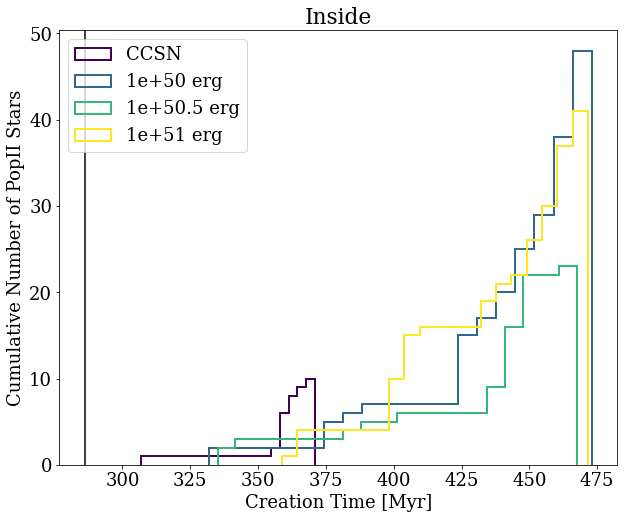

In [20]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
            run_label = param_info[run_name]['energy'] + ' erg'
    else:
        run_label = 'CCSN'
    
    final_ds = '0100'
    
    p2_id = star_info[run_name][final_ds]['star_info']['P2']['id']
    p2_ct = star_info[run_name][final_ds]['star_info']['P2']['creation_time']
    ins = inside_out[run_name]['inside']['P2']
    
    intersect, matching, ind_b = np.intersect1d(p2_id, ins, return_indices=True)

    len_keys_p2 = len(matching)

    if len_keys_p2 > 1:
        number_p2 = len_keys_p2
        ct_p2 = np.array(p2_ct)[matching]
    #print(ct_p2)
    
    plt.hist(ct_p2, color = colors[i], label = run_label, bins = 20, edgecolor = colors[i], linewidth = 2, cumulative = True, histtype = 'step')
    print(run_name + ' total # of P2 stars: ' + str(number_p2))
plt.legend(loc = 'upper left')

plt.ylabel('Cumulative Number of PopII Stars')
plt.xlabel('Creation Time [Myr]')
plt.axvline(NSM_time[vary_energy[1]], color = 'black')
plt.title('Inside')
#plt.savefig('/home/dskinner6/Dropbox/GaTech/GRAD/Group_Meeting_Presentations/Nov_4_2022/energy_num_PopII.png', dpi = 300, facecolor='white')
plt.show()

run_original total # of P2 stars: 10
run_D total # of P2 stars: 48
run_fiducial total # of P2 stars: 23
run_E total # of P2 stars: 41


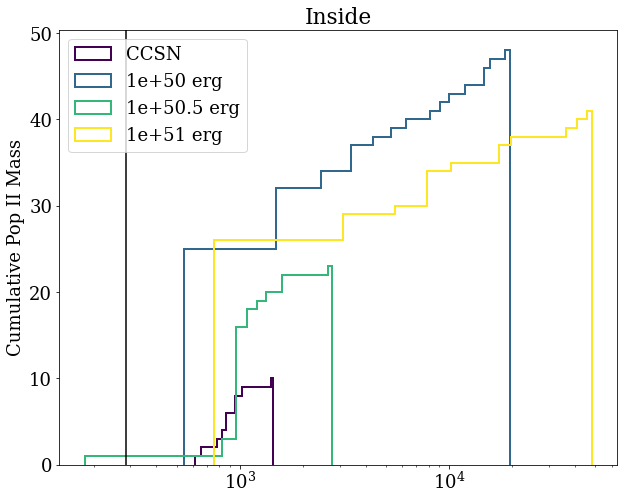

In [71]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
            run_label = param_info[run_name]['energy'] + ' erg'
    else:
        run_label = 'CCSN'
    
    final_ds = '0100'
    
    p2_id = star_info[run_name][final_ds]['star_info']['P2']['id']
    p2_ct = star_info[run_name][final_ds]['star_info']['P2']['creation_time']
    ins = inside_out[run_name]['inside']['P2']
    
    intersect, matching, ind_b = np.intersect1d(p2_id, ins, return_indices=True)
    
    p2_mass = np.array(star_info[run_name][final_ds]['star_info']['P2']['mass'])[matching]

    len_keys_p2 = len(matching)

    if len_keys_p2 > 1:
        number_p2 = len_keys_p2
        ct_p2 = np.array(p2_ct)[matching]
    #print(ct_p2)
    
    plt.hist(p2_mass, color = colors[i], label = run_label, bins = 20, edgecolor = colors[i], linewidth = 2, cumulative = True, histtype = 'step')
    print(run_name + ' total # of P2 stars: ' + str(number_p2))
plt.legend(loc = 'upper left')

plt.ylabel(r'Cumulative Pop II Mass')
#plt.xlabel('Creation Time [Myr]')
plt.axvline(NSM_time[vary_energy[1]], color = 'black')
plt.xscale('log')
plt.title('Inside')
#plt.savefig('/home/dskinner6/Dropbox/GaTech/GRAD/Group_Meeting_Presentations/Nov_4_2022/energy_num_PopII.png', dpi = 300, facecolor='white')
plt.show()

run_original total # of P3 stars: 10
run_D total # of P3 stars: 15
run_fiducial total # of P3 stars: 10
run_E total # of P3 stars: 21


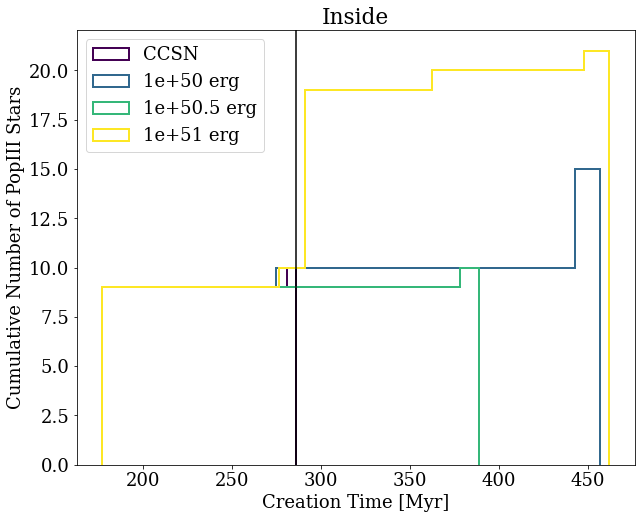

In [22]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
            run_label = param_info[run_name]['energy'] + ' erg'
    else:
        run_label = 'CCSN'
    
    final_ds = '0100'
    
    p3_id = star_info[run_name][final_ds]['star_info']['P3']['id']
    p3_ct = star_info[run_name][final_ds]['star_info']['P3']['creation_time']
    ins = inside_out[run_name]['inside']['P3']
    
    intersect, matching, ind_b = np.intersect1d(p3_id, ins, return_indices=True)

    len_keys_p3 = len(matching)

    if len_keys_p3 > 1:
        number_p3 = len_keys_p3
        ct_p3 = np.array(p3_ct)[matching]
    #print(ct_p2)
    
    plt.hist(ct_p3, color = colors[i], label = run_label, bins = 20, edgecolor = colors[i], linewidth = 2, cumulative = True, histtype = 'step')
    print(run_name + ' total # of P3 stars: ' + str(number_p3))
plt.legend(loc = 'upper left')

plt.ylabel('Cumulative Number of PopIII Stars')
plt.xlabel('Creation Time [Myr]')
plt.title('Inside')
plt.axvline(NSM_time[vary_energy[1]], color = 'black')
#plt.savefig('/home/dskinner6/Dropbox/GaTech/GRAD/Group_Meeting_Presentations/Nov_4_2022/energy_num_PopII.png', dpi = 300, facecolor='white')
plt.show()

run_original total # of P3 stars: 10
run_D total # of P3 stars: 15
run_fiducial total # of P3 stars: 10
run_E total # of P3 stars: 21


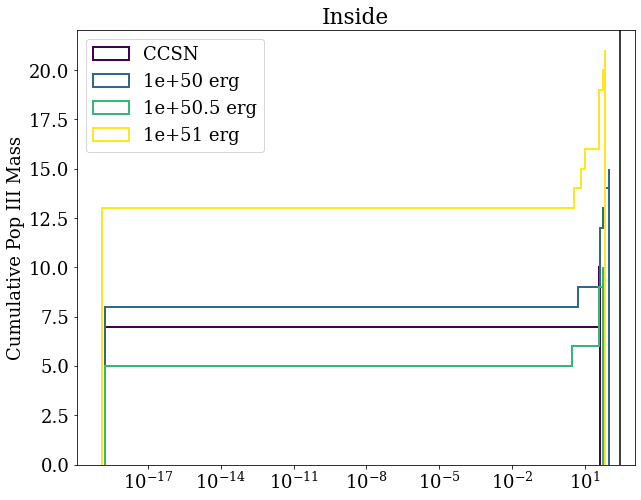

In [73]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
            run_label = param_info[run_name]['energy'] + ' erg'
    else:
        run_label = 'CCSN'
    
    final_ds = '0100'
    
    p3_id = star_info[run_name][final_ds]['star_info']['P3']['id']
    p3_ct = star_info[run_name][final_ds]['star_info']['P3']['creation_time']
    ins = inside_out[run_name]['inside']['P3']
    
    intersect, matching, ind_b = np.intersect1d(p3_id, ins, return_indices=True)
    
    p3_mass = np.array(star_info[run_name][final_ds]['star_info']['P3']['mass'])[matching]

    len_keys_p3 = len(matching)

    if len_keys_p3 > 1:
        number_p3 = len_keys_p3
        ct_p3 = np.array(p3_ct)[matching]
    #print(ct_p2)
    
    plt.hist(p3_mass, color = colors[i], label = run_label, bins = 20, edgecolor = colors[i], linewidth = 2, cumulative = True, histtype = 'step')
    print(run_name + ' total # of P3 stars: ' + str(number_p3))
plt.legend(loc = 'upper left')

plt.ylabel('Cumulative Pop III Mass')
#plt.xlabel('Creation Time [Myr]')
plt.xscale('log')
plt.title('Inside')
plt.axvline(NSM_time[vary_energy[1]], color = 'black')
#plt.savefig('/home/dskinner6/Dropbox/GaTech/GRAD/Group_Meeting_Presentations/Nov_4_2022/energy_num_PopII.png', dpi = 300, facecolor='white')
plt.show()

1e+50 erg
Number of r-process enhanced P2 stars:  45
Number of highly r-process enhanced P2 stars:  24
Total P2 stellar mass:  5.251079504333154
Mass fraction of r-process enhanced P2 stars:  0.988705524353956
Mass fraction of highly r-process enhanced P2 stars:  0.2693461941600308
Smallest creation time:  332.0056511738296
Largest creation time:  473.02959760882703


1e+50.5 erg
Number of r-process enhanced P2 stars:  13
Number of highly r-process enhanced P2 stars:  13
Total P2 stellar mass:  4.421579925019325
Mass fraction of r-process enhanced P2 stars:  0.5638768141456344
Mass fraction of highly r-process enhanced P2 stars:  0.5638768141456344
Smallest creation time:  335.03782628412813
Largest creation time:  467.5831193487362


1e+51 erg
Number of r-process enhanced P2 stars:  40
Number of highly r-process enhanced P2 stars:  30
Total P2 stellar mass:  5.45623908369804
Mass fraction of r-process enhanced P2 stars:  0.9973290287042086
Mass fraction of highly r-process enhanced P2

/tmp/ipykernel_15625/1439691217.py:25: RuntimeWarning: divide by zero encountered in log10
  NSM_p3 = np.log10(star_info[run_name][final_ds]['star_info']['P3']['NSM_metallicity_fraction'])


(-13.0, 3.0)

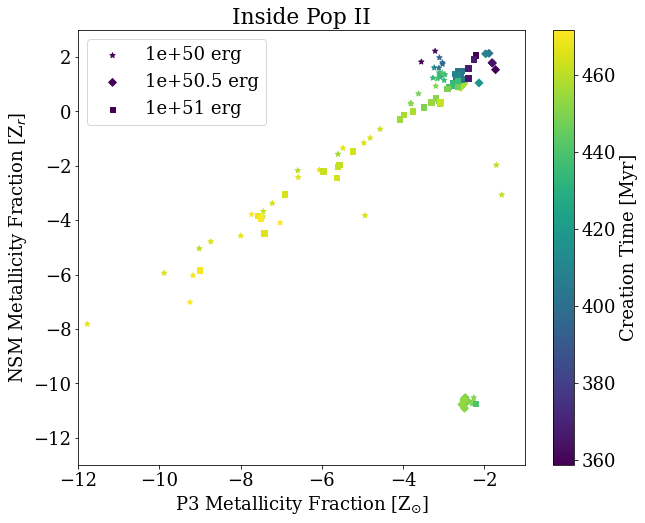

In [60]:
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))
markers = ['.', '*', 'D', 's']

met_bins = np.logspace(-4, -6)
fig = plt.figure(figsize=(10, 8))
for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
        
        run_label = param_info[run_name]['energy'] + ' erg'
        final_ds = '0100'
        
        p2_id = star_info[run_name][final_ds]['star_info']['P2']['id']
        
        ins = inside_out[run_name]['inside']['P2']
    
        intersect, matching, ind_b = np.intersect1d(p2_id, ins, return_indices=True)
        
        
        ct_p2 = np.array(star_info[run_name][final_ds]['star_info']['P2']['creation_time'])[matching]
        NSM_p2 = np.log10(star_info[run_name][final_ds]['star_info']['P2']['NSM_metallicity_fraction'])[matching]
        P3_p2 = np.log10(star_info[run_name][final_ds]['star_info']['P2']['P3_metallicity_fraction'])[matching]
        
        

        NSM_p3 = np.log10(star_info[run_name][final_ds]['star_info']['P3']['NSM_metallicity_fraction'])
        
        p2_mass = np.array(star_info[run_name][final_ds]['star_info']['P2']['mass'])[matching]
        total_p2_mass = np.sum(p2_mass)
        
        rproc_stars = np.sum(p2_mass[NSM_p2 > rprocess_enhanced])
        high_rproc_stars = np.sum(p2_mass[NSM_p2 > high_rprocess_enhanced])
        
        plt.scatter(P3_p2, NSM_p2, c = ct_p2, marker = markers[i], s = 30, label = run_label)
        
        rproc_frac = rproc_stars / total_p2_mass
        high_rproc_frac = high_rproc_stars / total_p2_mass
        
        print(run_label)
        print('Number of r-process enhanced P2 stars: ', len(NSM_p2[NSM_p2 > rprocess_enhanced]))
        print('Number of highly r-process enhanced P2 stars: ', len(NSM_p2[NSM_p2 > high_rprocess_enhanced]))
        print('Total P2 stellar mass: ', np.log10(total_p2_mass))
        print('Mass fraction of r-process enhanced P2 stars: ', rproc_frac)
        print('Mass fraction of highly r-process enhanced P2 stars: ', high_rproc_frac)
        print('Smallest creation time: ', np.min(ct_p2))
        print('Largest creation time: ', np.max(ct_p2))
        
        print('\n')
    else:
        run_label = 'CCSN'


cbar = plt.colorbar()
cbar.set_label('Creation Time [Myr]')
plt.title('Inside Pop II')
plt.ylabel(r'NSM Metallicity Fraction [Z$_{r}$]')
plt.xlabel(r'P3 Metallicity Fraction [Z$_{\odot}$]')
plt.legend()
plt.xlim(-12, -1)
plt.ylim(-13, 3)


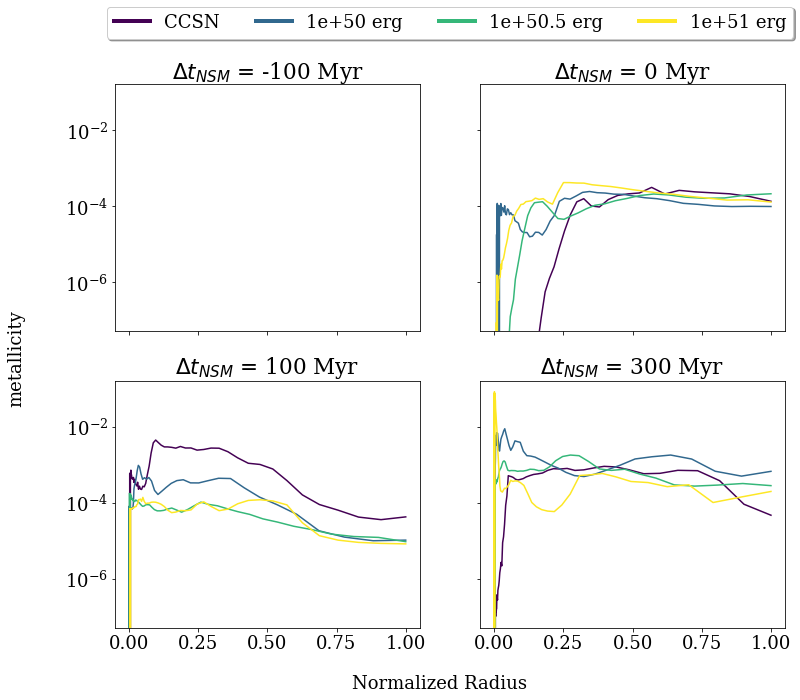

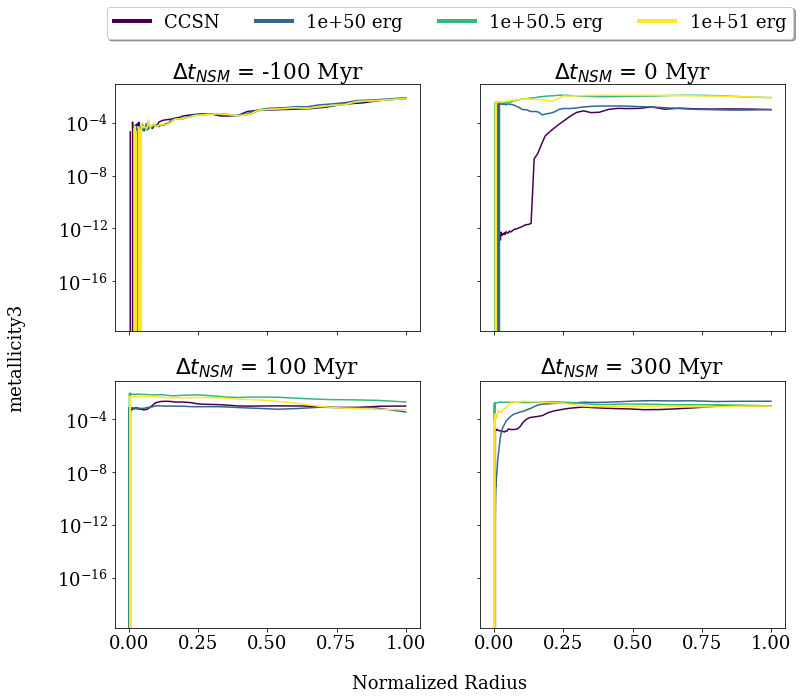

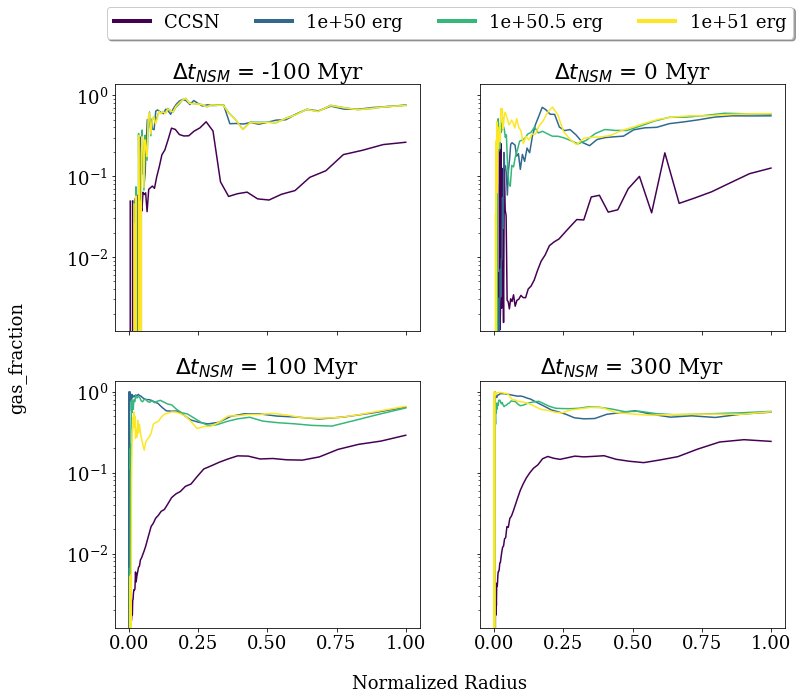

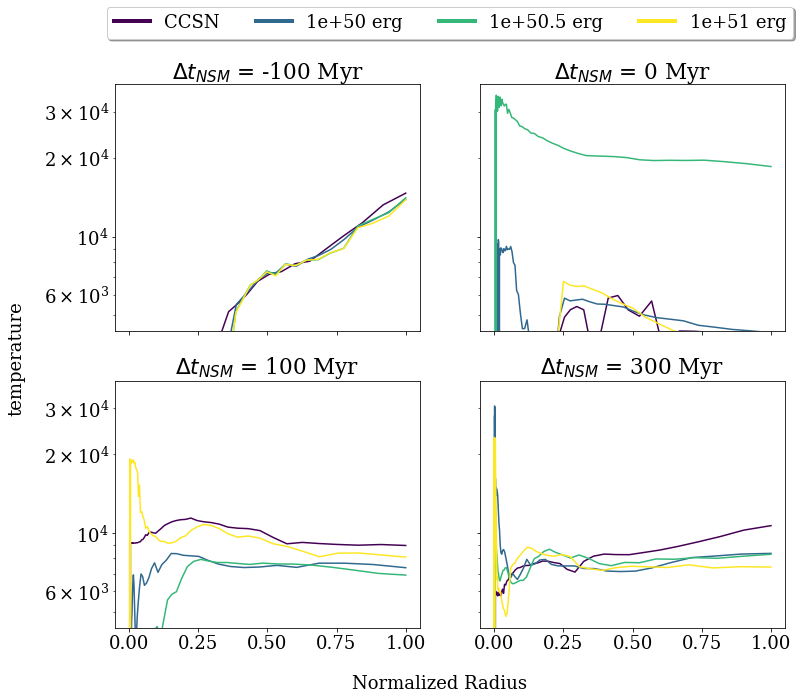

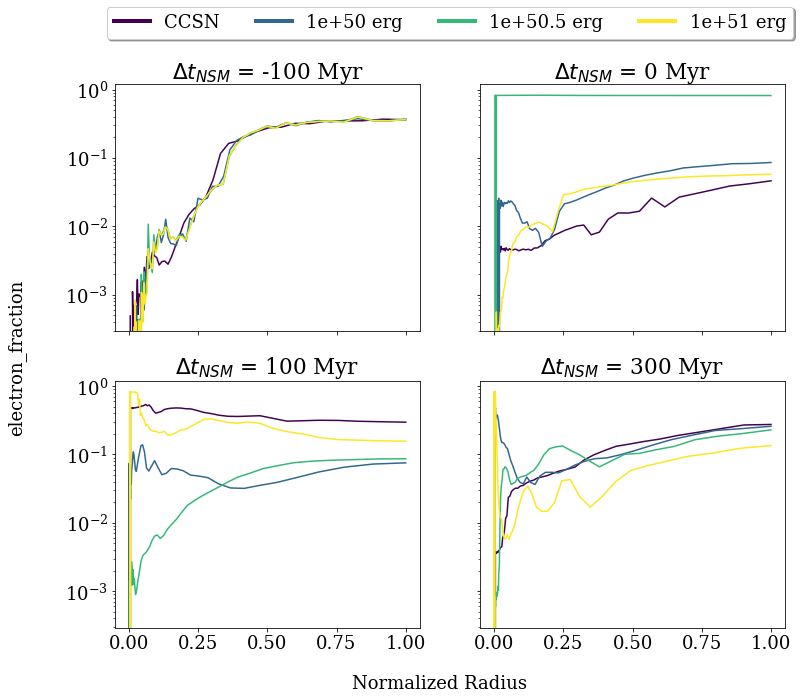

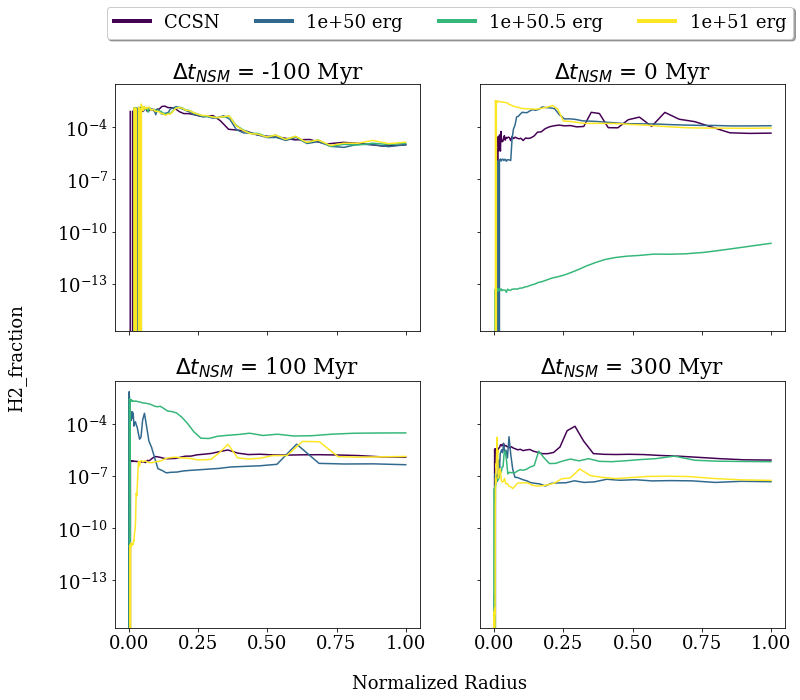

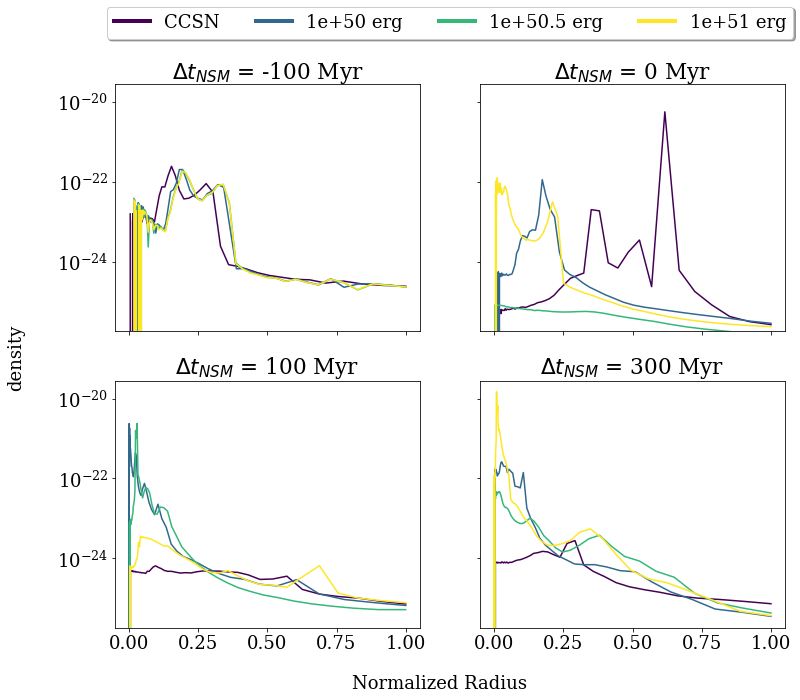

In [115]:
from matplotlib.lines import Line2D
NSM = NSM_time[vary_energy[1]]

time_diff = [-100, 0, 100, 300]
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))
field = 'density'
linestyle = ['-', ':', '--', '-.']

custom_lines = [Line2D([0], [0], linestyle = '-' , color = i, lw=4) for i in colors]




for field in profile_fields:
    fig, axs = plt.subplots(nrows = 2, ncols = 2, figsize = (12, 10), sharex = True, sharey = True)
    axes = axs.flatten()
    for j, diff in enumerate(time_diff):
        labels = []
        
        title = r'$\Delta t_{NSM}$ = ' + str(diff) + ' Myr'
            
        for i, run_name in enumerate(vary_energy):
            time = np.array([DD_data[run_name][ds]['time'] for ds in DD_data[run_name].keys()])
            outputs = [ds for ds in DD_data[run_name].keys()]

            if run_name != 'run_original':
                    run_label = param_info[run_name]['energy'] + ' erg'
            else:
                run_label = 'CCSN'
                
            labels.append(run_label)

            target_time = NSM + diff
            d = np.abs(time - target_time)
            min_index = np.argmin(d)

            out = outputs[min_index]

            y = np.load(f'run_data/profile_{field[1]}_{run_name}_{out}.npy')
            x = np.load(f'run_data/profile_x_{run_name}_{out}.npy')

            x = np.array(x) / x[-1]

            axes[j].plot(x, y, c = colors[i], label = run_label)
            axes[j].set_yscale('log')
            axes[j].set_title(title)
        
    plt.legend(custom_lines, labels, loc='upper center', bbox_to_anchor=(-0.1, 2.55), ncol = 4, fancybox=True, shadow=True)
    fig.text(0.5, 0.04, 'Normalized Radius', ha='center')
    fig.text(0.0, 0.5, field[1], va='center', rotation='vertical')

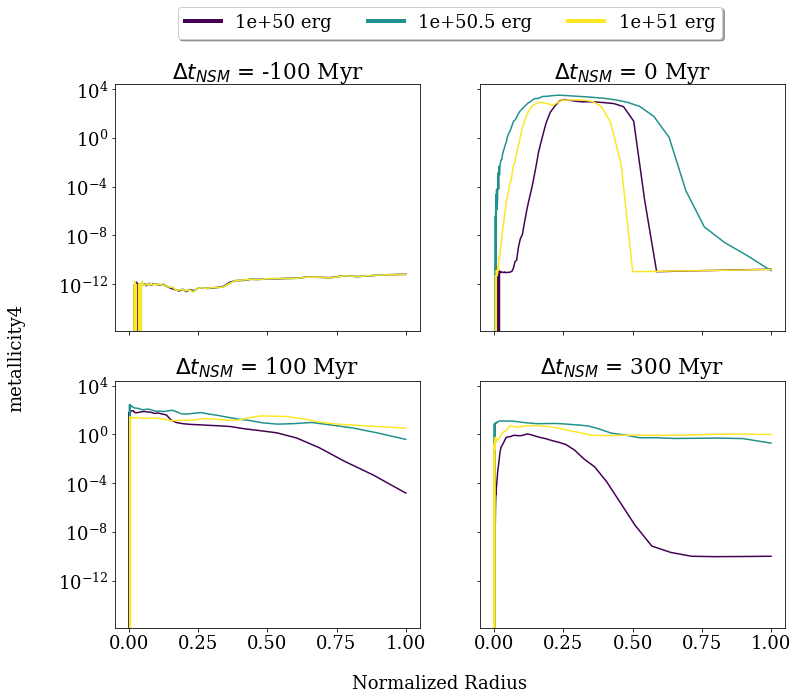

In [121]:
from matplotlib.lines import Line2D
NSM = NSM_time[vary_energy[1]]

time_diff = [-100, 0, 100, 300]
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy[1::]))
field = 'density'
linestyle = ['-', ':', '--', '-.']

custom_lines = [Line2D([0], [0], linestyle = '-' , color = i, lw=4) for i in colors]




for field in profile_fields_postNSM:
    fig, axs = plt.subplots(nrows = 2, ncols = 2, figsize = (12, 10), sharex = True, sharey = True)
    axes = axs.flatten()
    for j, diff in enumerate(time_diff):
        labels = []
        
        title = r'$\Delta t_{NSM}$ = ' + str(diff) + ' Myr'
            
        for i, run_name in enumerate(vary_energy[1::]):

            time = np.array([DD_data[run_name][ds]['time'] for ds in DD_data[run_name].keys()])
            outputs = [ds for ds in DD_data[run_name].keys()]

            if run_name != 'run_original':
                    run_label = param_info[run_name]['energy'] + ' erg'
            else:
                run_label = 'CCSN'

            labels.append(run_label)

            target_time = NSM + diff
            d = np.abs(time - target_time)
            min_index = np.argmin(d)

            out = outputs[min_index]

            y = np.load(f'run_data/profile_{field[1]}_{run_name}_{out}.npy')
            x = np.load(f'run_data/profile_x_{run_name}_{out}.npy')

            x = np.array(x) / x[-1]

            axes[j].plot(x, y, c = colors[i], label = run_label)
            axes[j].set_yscale('log')
            axes[j].set_title(title)
        
    plt.legend(custom_lines, labels, loc='upper center', bbox_to_anchor=(-0.1, 2.55), ncol = 4, fancybox=True, shadow=True)
    fig.text(0.5, 0.04, 'Normalized Radius', ha='center')
    fig.text(0.0, 0.5, field[1], va='center', rotation='vertical')

In [ ]:
for i, run_name in enumerate(vary_energy):
    
    if run_name != 'run_original':
        
        inside_NSM_p2 = []
        outside_NSM_p2 = []
        
        inside_P3_p2 = []
        outside_P3_p2 = []
        
        z = np.array([DD_data[run_name][ds]['redshift'] for ds in DD_data[run_name].keys()])
        time = np.array([DD_data[run_name][ds]['time'] for ds in DD_data[run_name].keys()])
        outputs = np.array([ds for ds in DD_data[run_name].keys()])
        
        for j, ds in enumerate(DD_data[run_name]):
            if ds > '0038':
                if len(star_info[run_name][ds]['star_info']['P2']['NSM_metallicity_fraction']) != 0:
        
                    p2_ct = star_info[run_name][ds]['star_info']['P2']['creation_time']
                    p2_pos = star_info[run_name][ds]['star_info']['P2']['position']
                    p2_id = star_info[run_name][ds]['star_info']['P2']['id']

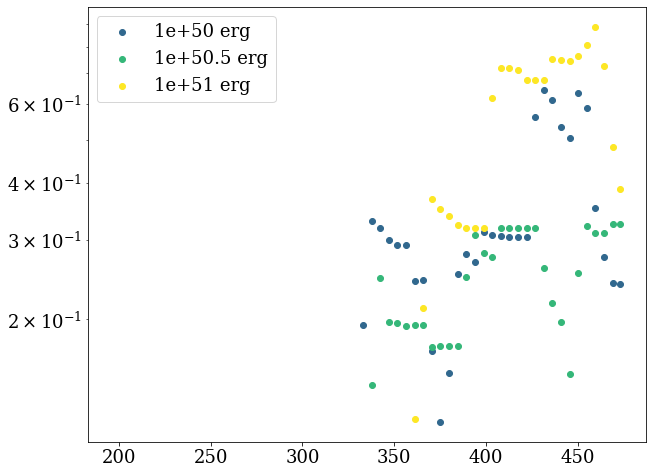

In [111]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))
for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
        
        high_rproc = []
        rproc = []
        z = []
        time = []
        
        for j, ds in enumerate(DD_data['run_A']):
            if ds > '0038':
                if len(star_info[run_name][ds]['star_info']['P2']['NSM_metallicity_fraction']) != 0:
        
                    run_label = param_info[run_name]['energy'] + ' erg'
                    
                    NSM_p2 = np.log10(star_info[run_name][ds]['star_info']['P2']['NSM_metallicity_fraction'])
                    
                    p2_mass = np.array(star_info[run_name][ds]['star_info']['P2']['mass'])
                    total_p2_mass = np.sum(p2_mass)

                    rproc_stars = np.sum(p2_mass[NSM_p2 > rprocess_enhanced])
                    high_rproc_stars = np.sum(p2_mass[NSM_p2 > high_rprocess_enhanced])

                    rproc_frac = rproc_stars / total_p2_mass
                    high_rproc_frac = high_rproc_stars / total_p2_mass
                    
                    high_rproc.append(high_rproc_frac)
                    rproc.append(rproc_frac)
                    z.append(DD_data[run_name][ds]['redshift'])
                    time.append(DD_data[run_name][ds]['time'])
        
        plt.scatter(time, high_rproc, c = colors[i], label = run_label)

plt.legend()
plt.yscale('log')

## Varying time

### Halo quantities for time runs

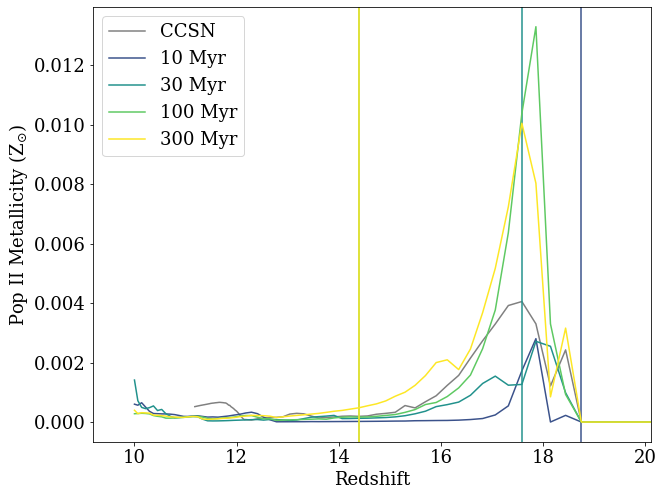

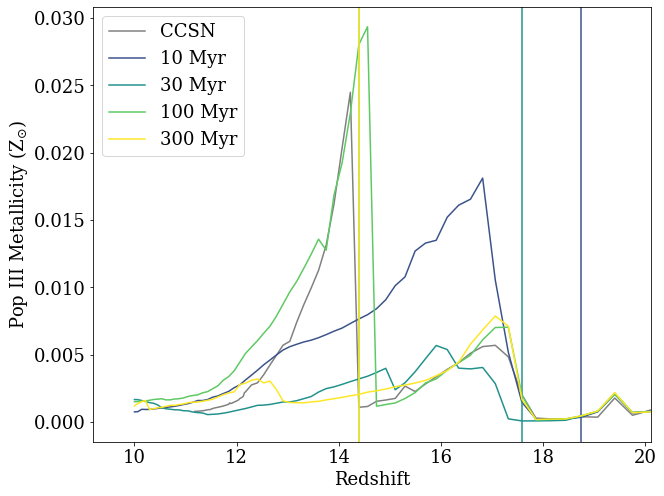

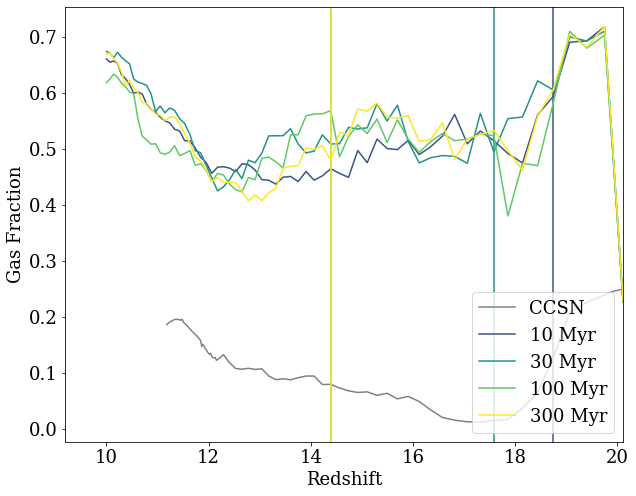

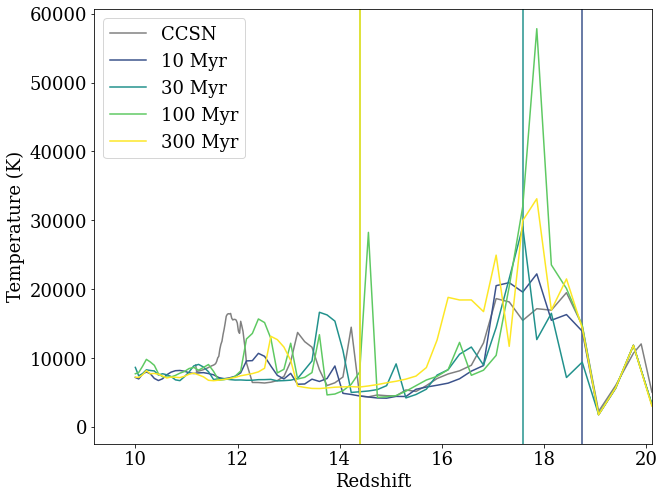

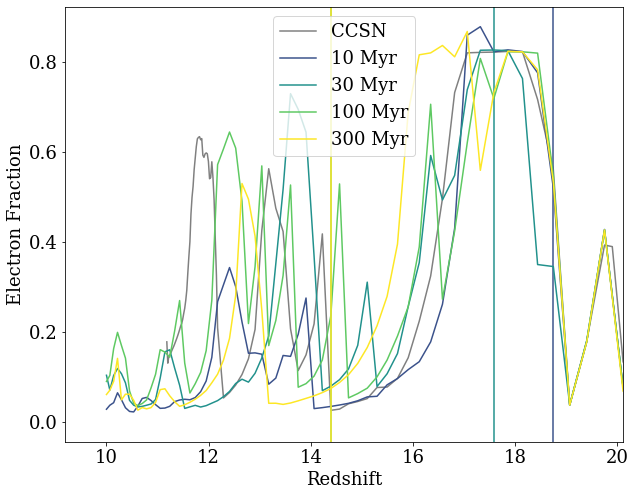

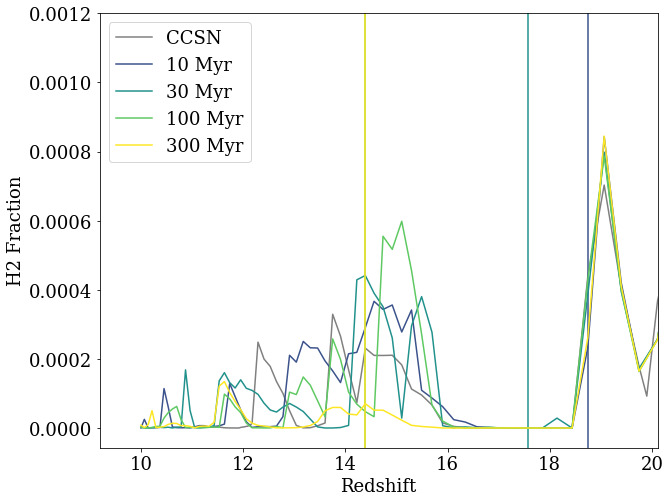

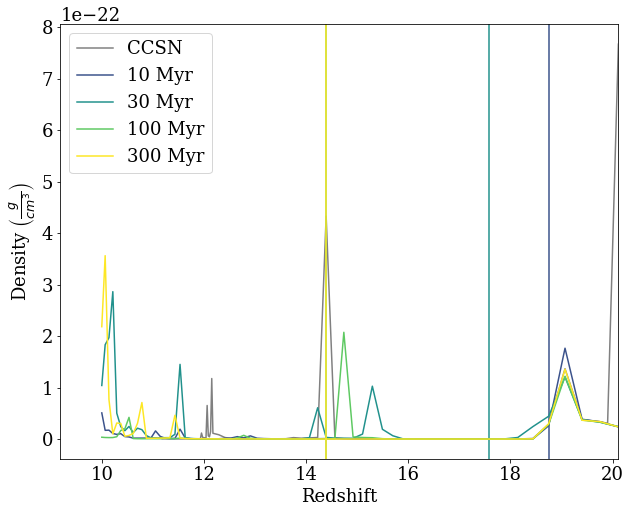

In [16]:
## Comparing time
for field in halo_quant_fields:
    fig = plt.figure(figsize=(10, 8))
    colors=mcp.gen_color(cmap="viridis",n=len(vary_time))
    
    for i, run_name in enumerate(vary_time):
        redshift = []
        y = []

        target_type = 1

        try:
            for j, ds in enumerate(halo_quantities[run_name]):
                redshift.append(DD_data[run_name][ds]['redshift'])
                y.append(halo_quantities[run_name][ds][field[1]]['cell_mass'])
                
                if run_name != 'run_original':
                    if star_info[run_name][ds]['star_info']['chosen_star']['type'] == target_type:
                        NSM_time = DD_data[run_name][ds]['redshift']
                        target_type = -1
        except Exception as e:
            print(e)
            print(run_name)
            print(ds)
            continue

        if run_name != 'run_original':
            plt.axvline(x = NSM_time, c = colors[i])

        red_sorted = np.argsort(redshift)[::-1]
        redshift = np.array(redshift)[red_sorted]
        y = np.array(y)[red_sorted]
        
        if run_name != 'run_original':
            run_label = param_info[run_name]['delay_time'] + ' Myr'
        else:
            run_label = 'CCSN'
        
        if run_name == 'run_original':
            plt.plot(redshift, y, label=run_label, c = 'gray')
        else:
            plt.plot(redshift, y, label=run_label, c = colors[i])
        
    #plt.title('cell_mass')
    plt.xlim(xmax=DD_data['run_A']['0037']['redshift'])
    plt.xlabel('Redshift')
    plt.ylabel(field_labels[field[1]])
    plt.legend()
    plt.show()


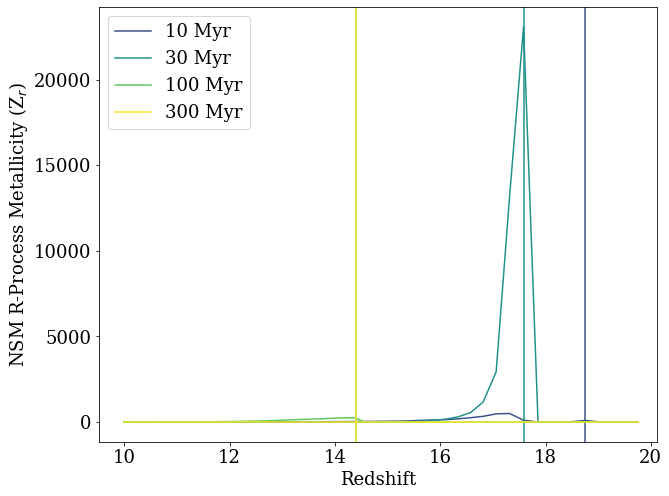

In [17]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_time))

for i, run_name in enumerate(vary_time):
    if run_name != 'run_original':
        redshift = []
        y = []

        target_type = 1

        for j, ds in enumerate(halo_quantities[run_name]):
            if int(ds) <= int('0037'):
                continue
            else:
                redshift.append(DD_data[run_name][ds]['redshift'])
                y.append(halo_quantities[run_name][ds]['metallicity4']['cell_mass'])

                if star_info[run_name][ds]['star_info']['chosen_star']['type'] == target_type:
                    NSM_time = DD_data[run_name][ds]['redshift']
                    target_type = -1

        plt.axvline(x = NSM_time, c = colors[i])

        red_sorted = np.argsort(redshift)[::-1]
        redshift = np.array(redshift)[red_sorted]
        y = np.array(y)[red_sorted]
        run_label = param_info[run_name]['delay_time'] + ' Myr'
        plt.plot(redshift, y, label=run_label, c = colors[i])    
#plt.title('cell_mass')
plt.xlim(xmax=DD_data['run_A']['0037']['redshift'])
plt.xlabel('Redshift')
plt.ylabel(field_labels['metallicity4'])
plt.legend()
plt.show()

### Halo quantities comparing all runs

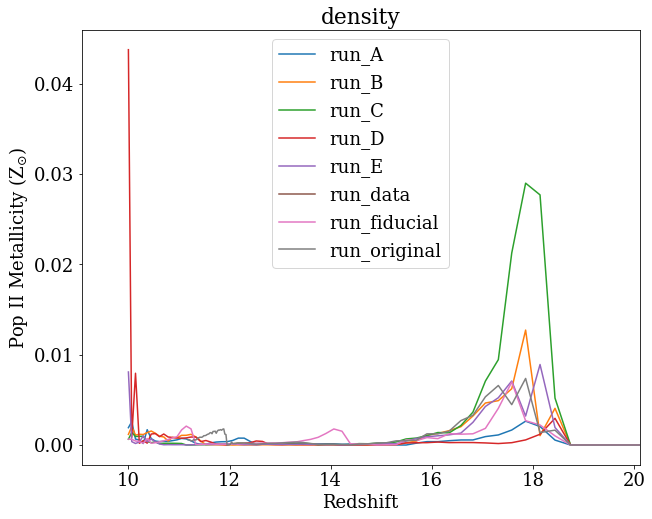

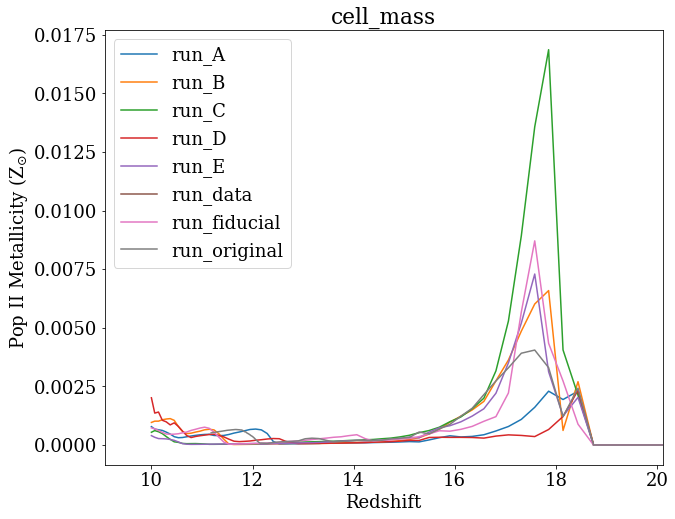

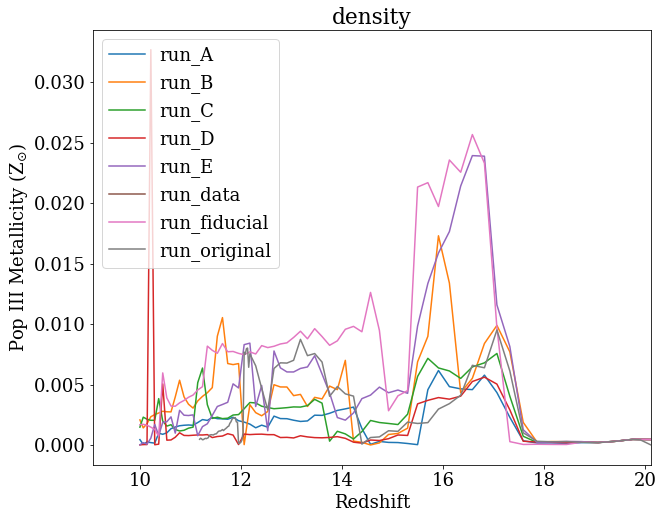

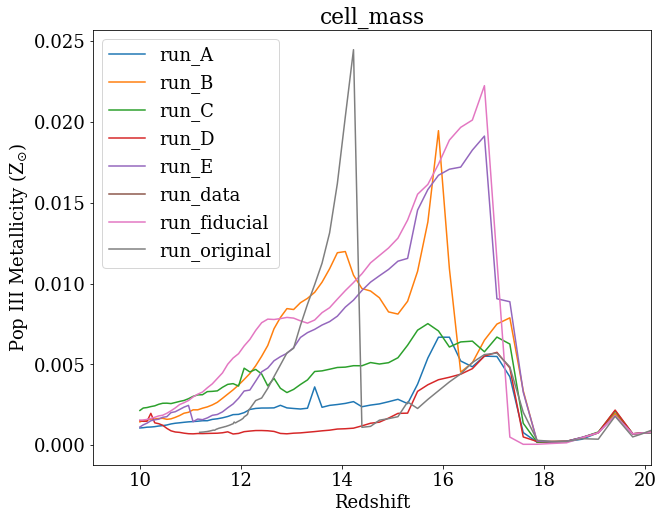

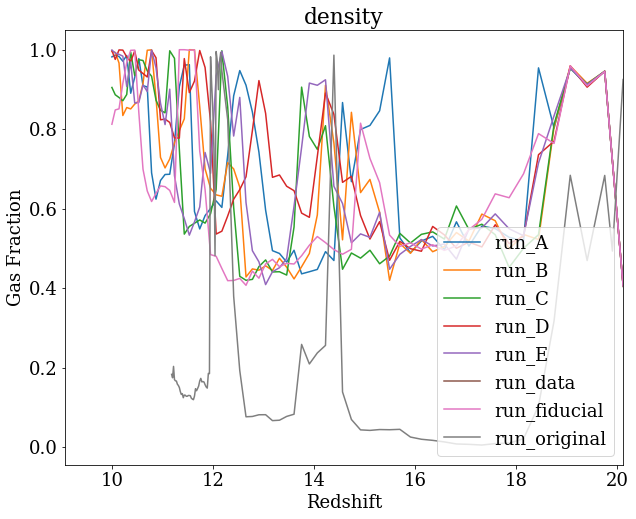

...

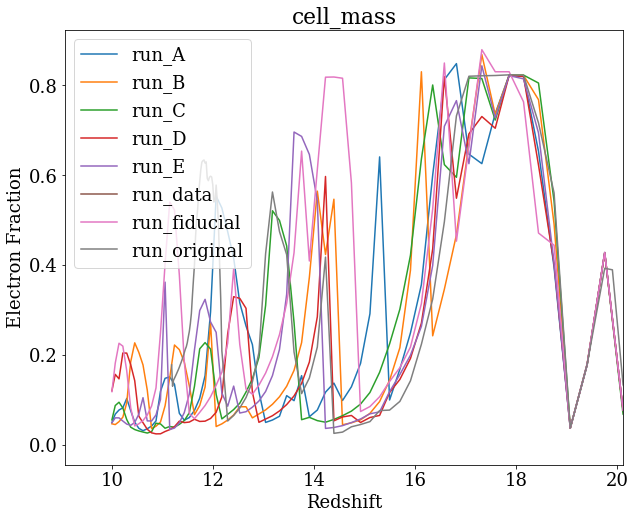

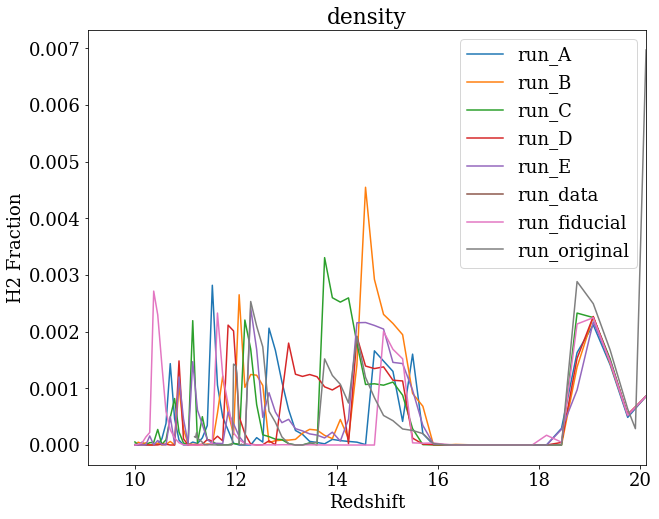

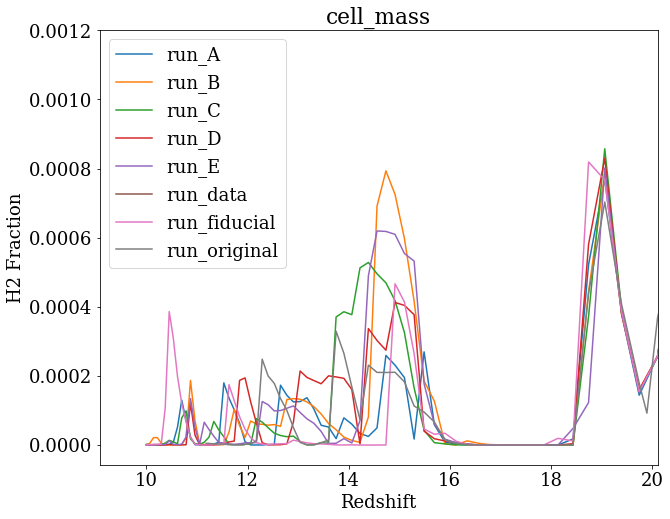

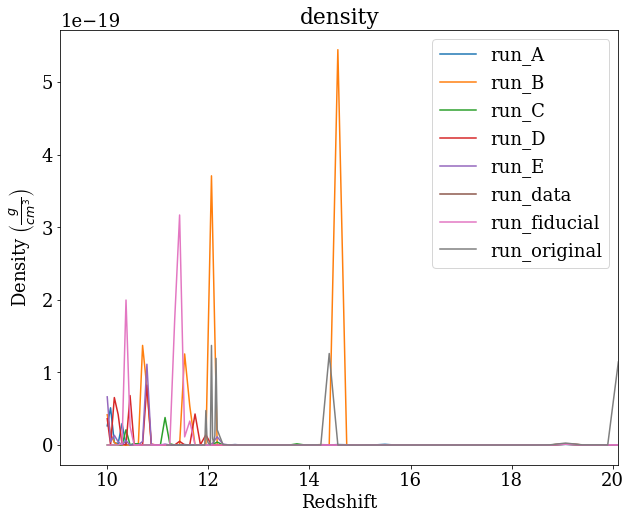

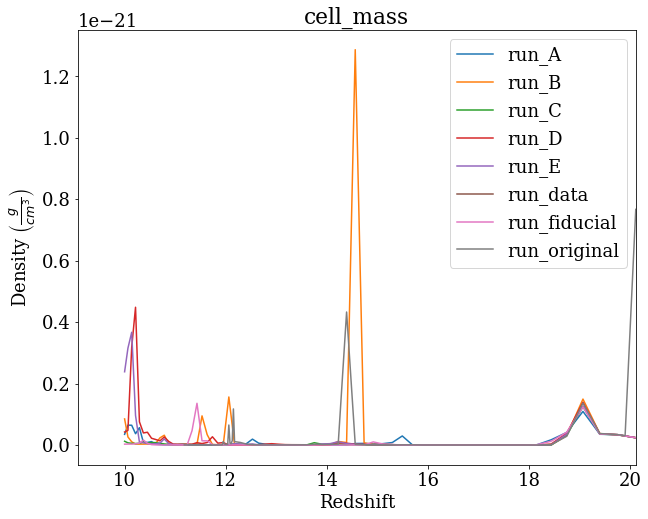

In [33]:
## Comparing all runs
for field in halo_quant_fields:
    for weight in halo_quant_weights:
        fig = plt.figure(figsize=(10, 8))
        
        for i, run_name in enumerate(halo_quantities):
            redshift = []
            y = []
            
            target_type = 1
            
            try:
                for j, ds in enumerate(halo_quantities[run_name]):
                    redshift.append(DD_data[run_name][ds]['redshift'])
                    y.append(halo_quantities[run_name][ds][field[1]][weight[1]])
                    
                    if star_info[run_name][ds]['star_info']['chosen_star']['type'] == target_type:
                        NSM_time = DD_data[run_name][ds]['redshift']
                        target_type = -1
            except Exception as e:
                print(e)
                print(run_name)
                print(ds)
                continue
            
            #plt.axvline(x = NSM_time, c = 'black')
            
            red_sorted = np.argsort(redshift)[::-1]
            redshift = np.array(redshift)[red_sorted]
            y = np.array(y)[red_sorted]
            
            plt.plot(redshift, y, label=run_name)    
        plt.title(weight[1])
        plt.xlim(xmax=DD_data['run_A']['0037']['redshift'])
        plt.xlabel('Redshift')
        plt.ylabel(field_labels[field[1]])
        plt.legend()
        plt.show()


### Halo mass vs. time

Text(0, 0.5, 'Halo Mass [M$_{\\odot}$]')

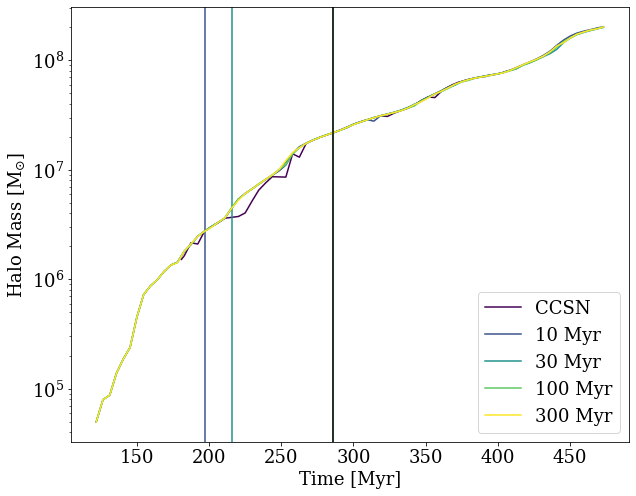

In [198]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_time))

for i, run_name in enumerate(vary_time):
    halo_mass = []
    time = []
    
    target_type = 1
    
    for j, ds in enumerate(run_halos[run_name]):
        
        
        if run_name != 'run_original':
            if star_info[run_name][ds]['star_info']['chosen_star']['type'] == target_type:
                NSM_z = DD_data[run_name][ds]['time']
                target_type = -1
                
                
                plt.axvline(x = NSM_z, c = colors[i])
            halo_mass.append(run_halos[run_name][ds]['mass'])
            time.append(DD_data[run_name][ds]['time'])
        else:
            halo_mass.append(massive_prog[ds]['mass'])
            time.append(DD_data[run_name][ds]['time'])
        
        
    

        
    if run_name != 'run_original':
            run_label = param_info[run_name]['delay_time'] + ' Myr'
    else:
        run_label = 'CCSN'
    plt.plot(time, halo_mass, label=run_label, c = colors[i])
    
plt.axvline(x = NSM_z, c = 'black')   
plt.yscale('log')
plt.legend()
plt.xlabel('Time [Myr]')
plt.ylabel(r'Halo Mass [M$_{\odot}$]')
    

In [ ]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))

for i, run_name in enumerate(vary_energy):
    halo_mass = []
    time = []
    
    target_type = 1
    
    for j, ds in enumerate(run_halos[run_name]):
        halo_mass.append(run_halos[run_name][ds]['mass'])
        time.append(DD_data[run_name][ds]['time'])
        
        if run_name == 'run_D':
            if star_info[run_name][ds]['star_info']['chosen_star']['type'] == target_type:
                NSM_time = DD_data[run_name][ds]['time']
                target_type = -1
        plt.axvline(x = NSM_time, c = 'black') 
    

    if run_name != 'run_original':
            run_label = param_info[run_name]['energy'] + ' erg'
    else:
        run_label = 'CCSN'
    plt.plot(time, halo_mass, label=run_label, c = colors[i])
    
  
plt.yscale('log')
plt.legend()
plt.xlabel('Time [Myr]')
plt.ylabel(r'Halo Mass [M$_{\odot}$]')

### Number of Pop III & Pop II Stars vs. time for energy runs

### Number of Pop III & Pop II Stars vs. time for time runs

run_original total # of P3 stars: 48
run_A total # of P3 stars: 63
run_B total # of P3 stars: 79
run_fiducial total # of P3 stars: 59
run_C total # of P3 stars: 48


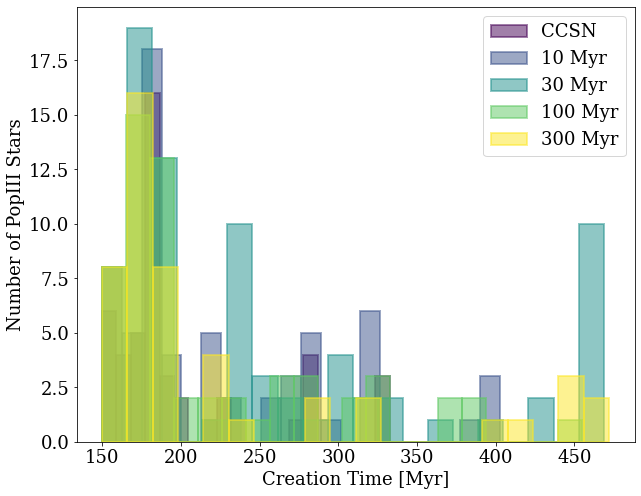

In [116]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_time))

for i, run_name in enumerate(vary_time):
    if run_name != 'run_original':
            run_label = param_info[run_name]['delay_time'] + ' Myr'
    else:
        run_label = 'CCSN'
    
    final_ds = '0100'
        
    len_keys_p3 = len(star_info[run_name][final_ds]['star_info']['P3'])
    len_keys_p2 = len(star_info[run_name][final_ds]['star_info']['P2'])

    if len_keys_p3 > 1:
        number_p3 = len(star_info[run_name][final_ds]['star_info']['P3']['id'])
        ct_p3 = star_info[run_name][final_ds]['star_info']['P3']['creation_time']
    
    
    plt.hist(ct_p3, color = colors[i], label = run_label,bins = 20, alpha = 0.5, edgecolor = colors[i], linewidth = 2)
    print(run_name + ' total # of P3 stars: ' + str(number_p3))
plt.legend()

plt.ylabel('Number of PopIII Stars')
plt.xlabel('Creation Time [Myr]')
plt.savefig('/home/dskinner6/Dropbox/GaTech/GRAD/Group_Meeting_Presentations/Nov_4_2022/time_num_PopIII.png', dpi = 300, facecolor='white')

run_original total # of P2 stars: 18
run_A total # of P2 stars: 39
run_B total # of P2 stars: 59
run_fiducial total # of P2 stars: 38
run_C total # of P2 stars: 40


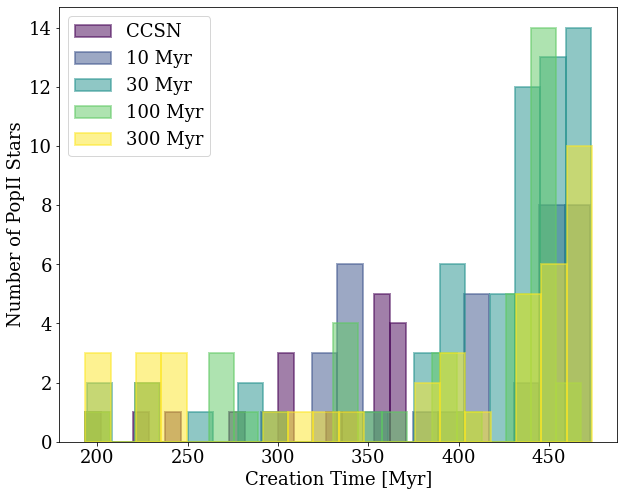

In [117]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_time))

for i, run_name in enumerate(vary_time):
    if run_name != 'run_original':
        run_label = param_info[run_name]['delay_time'] + ' Myr'
    else:
        run_label = 'CCSN'
    
    final_ds = '0100'
        
    len_keys_p3 = len(star_info[run_name][final_ds]['star_info']['P3'])
    len_keys_p2 = len(star_info[run_name][final_ds]['star_info']['P2'])

    if len_keys_p2 > 1:
        number_p2 = len(star_info[run_name][final_ds]['star_info']['P2']['id'])
        ct_p2 = star_info[run_name][final_ds]['star_info']['P2']['creation_time']
    
    
    plt.hist(ct_p2, color = colors[i], label = run_label, bins = 20, alpha = 0.5, edgecolor = colors[i], linewidth = 2)
    print(run_name + ' total # of P2 stars: ' + str(number_p2))
plt.legend()

plt.ylabel('Number of PopII Stars')
plt.xlabel('Creation Time [Myr]')
plt.savefig('/home/dskinner6/Dropbox/GaTech/GRAD/Group_Meeting_Presentations/Nov_4_2022/time_num_PopII.png', dpi = 300, facecolor='white')

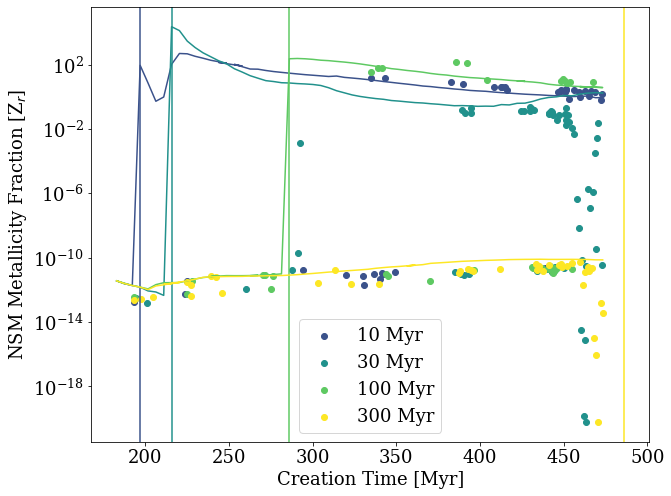

In [118]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_time))

met_bins = np.logspace(-4, -6)

for i, run_name in enumerate(vary_time):
    if run_name != 'run_original':
        run_label = param_info[run_name]['delay_time'] + ' Myr'
        final_ds = '0100'
        NSM_p2 = star_info[run_name][final_ds]['star_info']['P2']['NSM_metallicity_fraction']
        P3_p2 = star_info[run_name][final_ds]['star_info']['P2']['P3_metallicity_fraction']
        ct_p2 = star_info[run_name][final_ds]['star_info']['P2']['creation_time']


        plt.scatter(ct_p2, NSM_p2, c = colors[i], label = run_label)
        plt.axvline(NSM_time[run_name], color = colors[i])
        NSM_density = []
        time = []
        for j, ds in enumerate(halo_quantities[run_name]):
            try:
                NSM_density.append(halo_quantities[run_name][ds]['metallicity4']['cell_mass'])
                time.append(DD_data[run_name][ds]['time'])
            except Exception as e:
                pass
        plt.plot(time, NSM_density, c = colors[i])
    
    else:
        run_label = 'CCSN'

    

    

plt.legend()
plt.ylabel(r'NSM Metallicity Fraction [Z$_{r}$]')
plt.yscale('log')
plt.xlabel('Creation Time [Myr]')
plt.savefig('/home/dskinner6/Dropbox/GaTech/GRAD/Group_Meeting_Presentations/Nov_4_2022/time_NSM_metallicity.png', dpi = 300, facecolor='white')

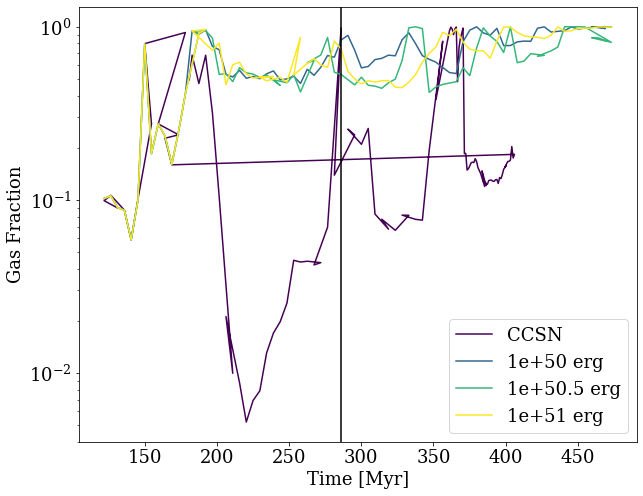

In [182]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_energy))


for i, run_name in enumerate(vary_energy):
    if run_name != 'run_original':
        run_label = param_info[run_name]['energy'] + ' erg'
    else:
        run_label = 'CCSN'

    gas_fraction = []
    time = []
    for j, ds in enumerate(halo_quantities[run_name]):
        gas_fraction.append(halo_quantities[run_name][ds]['gas_fraction']['density'])
        time.append(DD_data[run_name][ds]['time'])
    plt.plot(time, gas_fraction, c = colors[i], label = run_label)

    

plt.legend()
plt.ylabel('Gas Fraction')
plt.xlabel('Time [Myr]')
plt.axvline(NSM_time[vary_energy[1]], color = 'black')
plt.yscale('log')

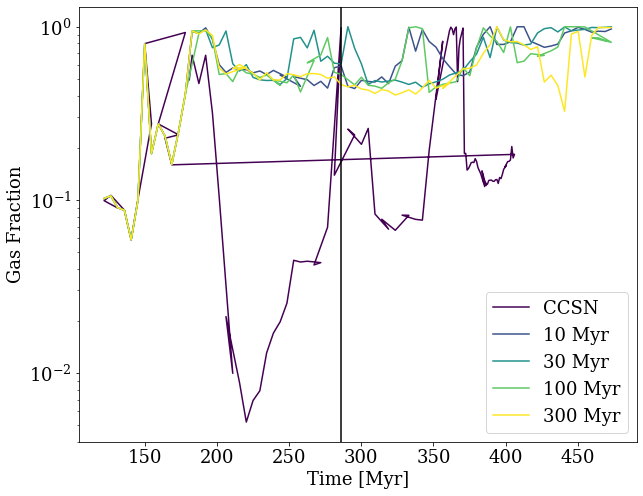

In [191]:
fig = plt.figure(figsize=(10, 8))
colors=mcp.gen_color(cmap="viridis",n=len(vary_time))


for i, run_name in enumerate(vary_time):
    if run_name != 'run_original':
        run_label = param_info[run_name]['delay_time'] + ' Myr'
    else:
        run_label = 'CCSN'

    gas_fraction = []
    time = []
    for j, ds in enumerate(halo_quantities[run_name]):
        gas_fraction.append(halo_quantities[run_name][ds]['gas_fraction']['density'])
        time.append(DD_data[run_name][ds]['time'])
    plt.plot(time, gas_fraction, c = colors[i], label = run_label)
    
    if run_name == 'run_original':
        og_time = time
        og_gas_fraction = gas_fraction
    

plt.legend()
plt.ylabel('Gas Fraction')
plt.xlabel('Time [Myr]')
plt.axvline(NSM_time[vary_energy[1]], color = 'black')
plt.yscale('log')

In [13]:
rprocess_enhanced = -8
high_rprocess_enhanced = -1

In [16]:
star_info['run_A']['0100']['star_info']['P2']['mass']

[828.3312549237463,
 811.4942291914936,
 876.2531604817866,
 6461.197875585589,
 1970.7290680377646,
 878.4945432769659,
 767.9670728499555,
 1069.6878276468826,
 1014.2173686646618,
 822.8592017593277,
 736.4661854540819,
 611.3137086474654,
 956.5593723950993,
 1636.4659358178355,
 4319.815261572928,
 2721.6684110440983,
 928.9210546313101,
 1578.249282325336,
 1683.8536366145465,
 804.6488379272549,
 889.1911874598725,
 754.9254532293843,
 1605.933267842303,
 233.76383295499662,
 4416.688336766227,
 697.888999542627,
 875.7887571057064,
 909.4738957078303,
 884.2879619701806,
 836.7226028424288,
 866.9527714844959,
 976.0941173038934,
 3699.732294011745,
 920.2698847127241,
 404.54444584795556,
 986.1087965248562,
 786.2622711285302,
 936.578685250627,
 899.0965359834319]

10 Myr
Number of r-process enhanced P2 stars:  25
Number of highly r-process enhanced P2 stars:  25
Total P2 stellar mass:  4.732872003566249
Mass fraction of r-process enhanced P2 stars:  0.7517601107379779
Mass fraction of highly r-process enhanced P2 stars:  0.7517601107379779


30 Myr
Number of r-process enhanced P2 stars:  34
Number of highly r-process enhanced P2 stars:  13
Total P2 stellar mass:  5.391306103030537
Mass fraction of r-process enhanced P2 stars:  0.44505717722368887
Mass fraction of highly r-process enhanced P2 stars:  0.07470968681093806


100 Myr
Number of r-process enhanced P2 stars:  13
Number of highly r-process enhanced P2 stars:  13
Total P2 stellar mass:  4.659901341088855
Mass fraction of r-process enhanced P2 stars:  0.32573379662688695
Mass fraction of highly r-process enhanced P2 stars:  0.32573379662688695


300 Myr
Number of r-process enhanced P2 stars:  0
Number of highly r-process enhanced P2 stars:  0
Total P2 stellar mass:  5.141707450116809
Mass 

/tmp/ipykernel_4094/1466338503.py:14: RuntimeWarning: divide by zero encountered in log10
  NSM_p3 = np.log10(star_info[run_name][final_ds]['star_info']['P3']['NSM_metallicity_fraction'])
/tmp/ipykernel_4094/1466338503.py:14: RuntimeWarning: invalid value encountered in log10
  NSM_p3 = np.log10(star_info[run_name][final_ds]['star_info']['P3']['NSM_metallicity_fraction'])


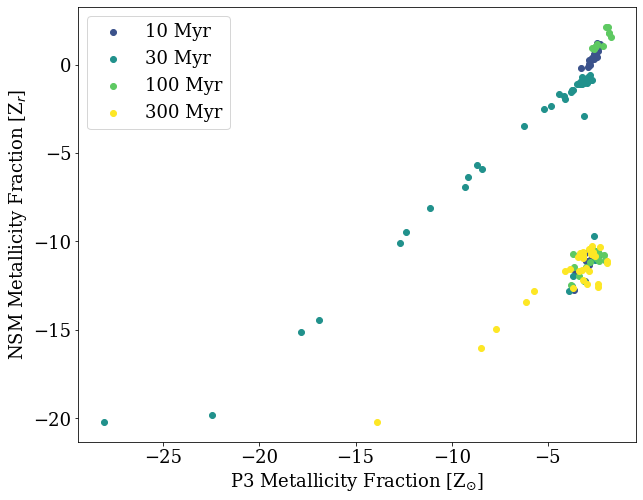

In [28]:

colors=mcp.gen_color(cmap="viridis",n=len(vary_time))

met_bins = np.logspace(-4, -6)
fig = plt.figure(figsize=(10, 8))
for i, run_name in enumerate(vary_time):
    if run_name != 'run_original':
        
        run_label = param_info[run_name]['delay_time'] + ' Myr'
        final_ds = '0100'
        NSM_p2 = np.log10(star_info[run_name][final_ds]['star_info']['P2']['NSM_metallicity_fraction'])
        P3_p2 = np.log10(star_info[run_name][final_ds]['star_info']['P2']['P3_metallicity_fraction'])
        ct_p2 = star_info[run_name][final_ds]['star_info']['P2']['creation_time']

        NSM_p3 = np.log10(star_info[run_name][final_ds]['star_info']['P3']['NSM_metallicity_fraction'])
        
        p2_mass = np.array(star_info[run_name][final_ds]['star_info']['P2']['mass'])
        total_p2_mass = np.sum(p2_mass)
        
        rproc_stars = np.sum(p2_mass[NSM_p2 > rprocess_enhanced])
        high_rproc_stars = np.sum(p2_mass[NSM_p2 > high_rprocess_enhanced])
        
        rproc_frac = rproc_stars / total_p2_mass
        high_rproc_frac = high_rproc_stars / total_p2_mass
        
        #plt.hist2d(P3_p2, NSM_p2, bins = 100)
        plt.scatter(P3_p2, NSM_p2, c = colors[i], label = run_label)
        
        #print(NSM_p2[NSM_p2 > rprocess_enhanced])
        
        print(run_label)
        print('Number of r-process enhanced P2 stars: ', len(NSM_p2[NSM_p2 > rprocess_enhanced]))
        print('Number of highly r-process enhanced P2 stars: ', len(NSM_p2[NSM_p2 > high_rprocess_enhanced]))
        print('Total P2 stellar mass: ', np.log10(total_p2_mass))
        print('Mass fraction of r-process enhanced P2 stars: ', rproc_frac)
        print('Mass fraction of highly r-process enhanced P2 stars: ', high_rproc_frac)
        print('\n')
    else:
        run_label = 'CCSN'

    
plt.ylabel(r'NSM Metallicity Fraction [Z$_{r}$]')
plt.xlabel(r'P3 Metallicity Fraction [Z$_{\odot}$]')
plt.legend()    

In [128]:
from matplotlib.lines import Line2D
colors=mcp.gen_color(cmap="viridis",n=len(vary_time))
markers = ['.', '*', 'D', 's']
marker_size = [50, 50, 20, 20]
legend_elements = []
for i, run_name in enumerate(vary_time[1::]):
    run_label = param_info[run_name]['delay_time'] + ' Myr'
    legend_elements.append(Line2D([0], [0], marker=markers[i], color='w', label=run_label, markerfacecolor='black', markersize=15))


for i, ds in enumerate(DD_data['run_A']):
    if ds > '0038':
        fig = plt.figure(figsize=(10, 8))
        for j, run_name in enumerate(vary_time[1::]):
            marker = markers[j]
            try:
                if len(star_info[run_name][ds]['star_info']['P2']['NSM_metallicity_fraction']) != 0: ## No p2
                    run_label = param_info[run_name]['energy'] + ' erg'

                    NSM_p2 = np.log10(star_info[run_name][ds]['star_info']['P2']['NSM_metallicity_fraction'])
                    P3_p2 = np.log10(star_info[run_name][ds]['star_info']['P2']['P3_metallicity_fraction'])
                    ct_p2 = star_info[run_name][ds]['star_info']['P2']['creation_time']

                    plt.scatter(P3_p2, NSM_p2, c = ct_p2, marker = marker, s = marker_size[j], label = run_label)
                    plt.clim(190, 475)
                    
                else:
                    pass
            except Exception as e:
                print(e)
        if fig.get_axes():
            cbar = plt.colorbar()
            cbar.set_label('Creation Time [Myr]')
            plt.clim(190, 475)
            plt.ylabel(r'NSM Metallicity Fraction [Z$_{r}$]')
            plt.xlabel(r'P3 Metallicity Fraction [Z$_{\odot}$]')
            plt.legend(handles = legend_elements, loc = 'upper left')    
            plt.xlim(-12, -1)
            plt.ylim(-13, 3)
            plt.savefig(image_outputs + 'time_NSM_P3_' + str(ds) + '.png', facecolor = 'white', dpi = 300)
            plt.close()
    else:
        pass

'0067'


<Figure size 720x576 with 0 Axes>

<Figure size 720x576 with 0 Axes>

In [119]:
param_info['run_A']

{'id': '738847', 'energy': '1e+50.5', 'delay_time': '10'}

### Testing

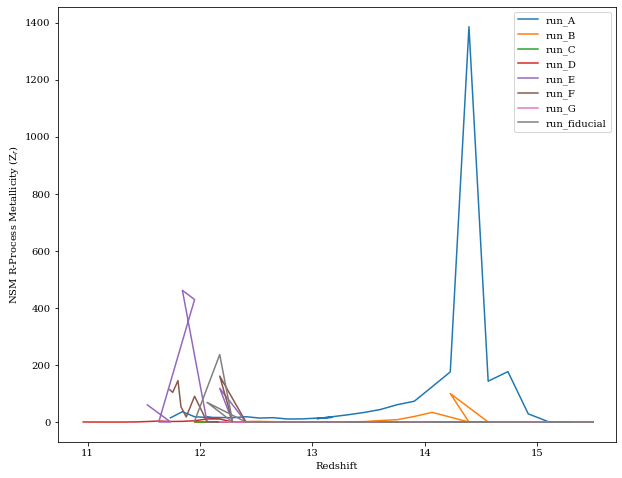

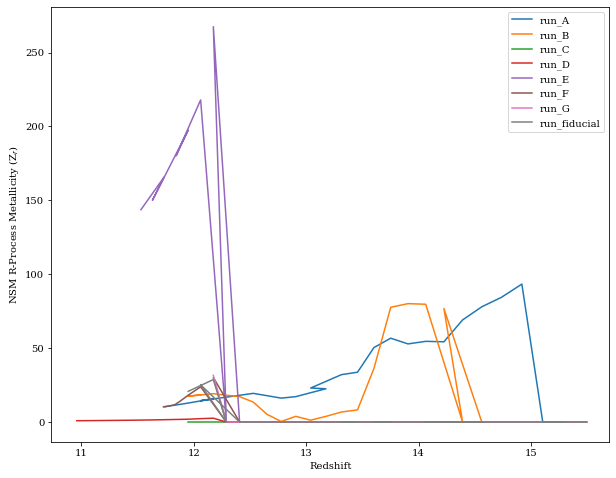

In [39]:
for weight in halo_quant_weights:
    fig = plt.figure(figsize=(10, 8))

    for i, run_name in enumerate(halo_quantities):
        redshift = []
        y = []

        target_type = 1
        
        for j, ds in enumerate(halo_quantities[run_name]):
            keys = halo_quantities[run_name][ds].keys()
            if 'metallicity4' not in keys:
                continue
            else: 
                try:
                    redshift.append(DD_data[run_name][ds]['redshift'])
                    y.append(halo_quantities[run_name][ds]['metallicity4'][weight[1]])

                    if star_info[run_name][ds]['star_info']['chosen_star']['type'] == target_type:
                        NSM_time = DD_data[run_name][ds]['redshift']
                        target_type = -1
                except Exception as e:
                    print(e)
                    print(run_name)
                    print(ds)
                    continue
            #plt.axvline(x = NSM_time, c = 'black')
        red_sorted = np.argsort(redshift)[::-1]
        redshift = np.array(redshift)[red_sorted]
        y = np.array(y)[red_sorted]
        plt.plot(redshift, y, label=run_name)    
    plt.title(weight[1])
    plt.xlim(xmax=DD_data['run_A']['0053']['redshift'])
    plt.xlabel('Redshift')
    plt.ylabel(field_labels['metallicity4'])
    plt.legend()
    plt.show()


In [80]:
## Serial

for i, run_name in enumerate(run_info):
    for j, o in enumerate(run_info[run_name]):
        # Projections
        for field in fields:
            proj_name = data_dir + 'projection_' + field[1] + '_' + run_name + '_' + o + '.npy'
            if os.path.exists(proj_name) == True:
                
                ds = yt.load(run_dir + run_name + '/DD' + o + '/output_' + o)
        
                time = run_info[run_name][o]['time']
                redshift = run_info[run_name][o]['redshift']

                cbar_label =  units_plot[field[1]]
                vmin = zlim[field[1]][0]
                vmax = zlim[field[1]][1]
                cmap = colorbars[field[1]]

                halo_rvir = ds.quan(run_info[run_name][o]['halo_info']['rvir'], 'unitary').to('kpc')
                
                with open(proj_name, 'rb') as f:
                    frb = np.load(f)

                plot_time_label = 't = ' + str(round(time, 2)) + ' Myr \nz = ' + str(round(redshift, 2))
                bbox = dict(boxstyle='square', fc='white', ec='white', alpha=0.5)
                radius = halo_rvir * 100
                #p2_plot_pos = (p2_pos - halo_pos)
                #p2_list_x = [i[1] for i in p2_plot_pos.v]
                #p2_list_y = [i[2] for i in p2_plot_pos.v]

                fig = plt.figure(figsize=(10,10))
                ax = plt.subplot()
                img = ax.imshow(frb, origin="lower",extent=[-5, 5, -5, 5], cmap = cmap, norm=LogNorm(vmin=vmin, vmax=vmax))
                plt.plot(0, 0, 'o', ms=radius, mec='white', mfc='none')
                #plt.scatter(p2_list_x, p2_list_y, marker = '*', color = 'black', alpha=0.5)

                divider = make_axes_locatable(ax)
                cax = divider.append_axes("right", size="5%", pad=0)
                cbar = plt.colorbar(img, cax = cax)
                cbar.set_label(cbar_label)

                ax.set_xlabel('y (kpc)')
                ax.set_ylabel('z (kpc)')
                #ax.set_title(type_name)
                ax.text(-4.8, 4.15, plot_time_label, color='black', bbox=bbox)

                plt.savefig(image_outputs + run_name + '/projection_' + field[1] + '_' + o + '.png' )
            else:
                print(proj_name + ' doesnt exist')
        
        # Phase plots
        for k, field_list in enumerate(phase_plot_fields):
            x_field = field_list[0]
            y_field = field_list[1]
            
            
            for z_field in phase_plot_colors[k]:
                phase_name = data_dir + 'phase_xedges_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_' + run_name + '_' + o +'.npy'
                if os.path.exists(phase_name) == True:
                    with open(data_dir + 'phase_xedges_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_run_fiducial_0078.npy', 'rb') as f:
                        xedges = np.load(f)

                    with open(data_dir + 'phase_yedges_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_run_fiducial_0078.npy', 'rb') as f:
                        yedges = np.load(f)

                    with open(data_dir + 'phase_H_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_run_fiducial_0078.npy', 'rb') as f:
                        H = np.load(f)

                    vmin = zlim_phase[z_field[1]][0]
                    vmax = zlim_phase[z_field[1]][1]


                    X, Y = np.meshgrid(xedges, yedges)

                    fig = plt.figure(figsize=(10,10))
                    ax = plt.subplot()
                    img = ax.pcolormesh(Y, X, H, norm=LogNorm())#, norm=LogNorm(vmin = vmin, vmax = vmax))
                    ax.set_yscale('log')
                    ax.set_xscale('log')
                    divider = make_axes_locatable(ax)
                    cax = divider.append_axes("right", size="5%", pad=0)
                    cbar = plt.colorbar(img, cax = cax)

                    ax.set_xlabel(units_plot[x_field[1]])
                    #ax.set_xlim(zlim_phase[x_field[1]][0], zlim_phase[x_field[1]][1])
                    ax.set_ylabel(units_plot[y_field[1]])
                    #ax.set_ylim(zlim_phase[y_field[1]][0], zlim_phase[y_field[1]][1])
                    #ax.set_title(type_name)
                    cbar.set_label(units_plot[z_field[1]])
                    
                    plt.savefig(image_outputs + run_name + '/phase_' + x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_' + o + '.png')
                else:
                    print(phase_name + ' doesnt exist')

NameError: name 'run_info' is not defined

In [ ]:
### Phase plot comparisons (similar to Smith+2015)



In [129]:
import unyt as u

In [130]:
u.c / (70 * u.km/u.s/u.Mpc)

unyt_quantity(4282.7494, 'Mpc')

In [ ]:
## Parallel

dataset_list = []

for i, run_name in enumerate(temp_run_info):
    for j, ds in enumerate(temp_run_info[run_name][run_name]):
        if run_info[run_name][run_name][ds]['halo_info']['halo_id'] != -1:
            dataset_list.append(run_dir + run_name + '/DD' + ds + '/output_' + ds)
            
fns = yt.DatasetSeries(dataset_list)
for sto, ds in fns.piter(storage=quantities):
    run_name = str(ds.directory).split('/')[-2]
    o = str(ds).split('output_')[-1]
    print(o)
    print(run_name)
    # Projections
    for field in fields:
        proj_name = data_dir + 'projection_' + field[1] + '_' + run_name + '_' + o + '.npy'
        if os.path.exists(proj_name) == True:

            time = run_info[run_name][o]['time']
            redshift = run_info[run_name][o]['redshift']

            cbar_label =  units_plot[field[1]]
            vmin = zlim[field[1]][0]
            vmax = zlim[field[1]][1]
            cmap = colorbars[field[1]]

            halo_rvir = ds.quan(run_info[run_name][o]['halo_info']['rvir'], 'unitary').to('kpc')

            with open(proj_name, 'rb') as f:
                frb = np.load(f)

            plot_time_label = 't = ' + str(round(time, 2)) + ' Myr \nz = ' + str(round(redshift, 2))
            bbox = dict(boxstyle='square', fc='white', ec='white', alpha=0.5)
            radius = halo_rvir * 100
            #p2_plot_pos = (p2_pos - halo_pos)
            #p2_list_x = [i[1] for i in p2_plot_pos.v]
            #p2_list_y = [i[2] for i in p2_plot_pos.v]

            fig = plt.figure(figsize=(10,10))
            ax = plt.subplot()
            img = ax.imshow(frb, origin="lower",extent=[-5, 5, -5, 5], cmap = cmap, norm=LogNorm(vmin=vmin, vmax=vmax))
            plt.plot(0, 0, 'o', ms=radius, mec='white', mfc='none')
            #plt.scatter(p2_list_x, p2_list_y, marker = '*', color = 'black', alpha=0.5)

            divider = make_axes_locatable(ax)
            cax = divider.append_axes("right", size="5%", pad=0)
            cbar = plt.colorbar(img, cax = cax)
            cbar.set_label(cbar_label)

            ax.set_xlabel('y (kpc)')
            ax.set_ylabel('z (kpc)')
            #ax.set_title(type_name)
            ax.text(-4.8, 4.15, plot_time_label, color='black', bbox=bbox)

            for k, field_list in enumerate(phase_plot_fields):
        x_field = field_list[0]
        y_field = field_list[1]

        print(field_list)
        for z_field in phase_plot_colors[k]:
        else:
            print(proj_name + ' doesnt exist')

    # Phase plots
    for k, field_list in enumerate(phase_plot_fields):
        x_field = field_list[0]
        y_field = field_list[1]

        for z_field in phase_plot_colors[k]:
            phase_name = data_dir + 'phase_xedges_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_' + run_name + '_' + o +'.npy'
            if os.path.exists(phase_name) == True:
                with open(data_dir + 'phase_xedges_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_run_fiducial_0078.npy', 'rb') as f:
                    xedges = np.load(f)

                with open(data_dir + 'phase_yedges_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_run_fiducial_0078.npy', 'rb') as f:
                    yedges = np.load(f)

                with open(data_dir + 'phase_H_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_run_fiducial_0078.npy', 'rb') as f:
                    H = np.load(f)

                vmin = zlim_phase[z_field[1]][0]
                vmax = zlim_phase[z_field[1]][1]


                X, Y = np.meshgrid(xedges, yedges)

                fig = plt.figure(figsize=(10,10))
                ax = plt.subplot()
                img = ax.pcolormesh(Y, X, H, norm=LogNorm())#, norm=LogNorm(vmin = vmin, vmax = vmax))
                ax.set_yscale('log')
                ax.set_xscale('log')
                divider = make_axes_locatable(ax)
                cax = divider.append_axes("right", size="5%", pad=0)
                cbar = plt.colorbar(img, cax = cax)

                ax.set_xlabel(units_plot[x_field[1]])
                #ax.set_xlim(zlim_phase[x_field[1]][0], zlim_phase[x_field[1]][1])
                ax.set_ylabel(units_plot[y_field[1]])
                #ax.set_ylim(zlim_phase[y_field[1]][0], zlim_phase[y_field[1]][1])
                #ax.set_title(type_name)
                cbar.set_label(units_plot[z_field[1]])

                plt.savefig(image_outputs + run_name + '/phase_' + x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_' + o + '.png')
            else:
                print(phase_name + ' doesnt exist')
    
    


In [ ]:
for i, run_name in enumerate(run_info):
    for j, o in enumerate(run_info[run_name]):
        print('Making projections')
        # Projections
        for field in fields:
            proj_name = data_dir + 'projection_' + field[1] + '_' + run_name + '_' + o + '.npy'
            if os.path.exists(proj_name) == True:
                print('Making ' + proj_name + '...')
            else:
                print(proj_name + ' doesnt exist')
        
        print('Making phase plots')
        # Phase plots
        for k, field_list in enumerate(phase_plot_fields):
            x_field = field_list[0]
            y_field = field_list[1]
            
            for z_field in phase_plot_colors[k]:
                phase_name = data_dir + 'phase_xedges_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_' + run_name + '_' + o +'.npy'
                if os.path.exists(phase_name) == True:
                    print('Making ' + phase_name + '...')
                else:
                    print(phase_name + ' doesnt exist')

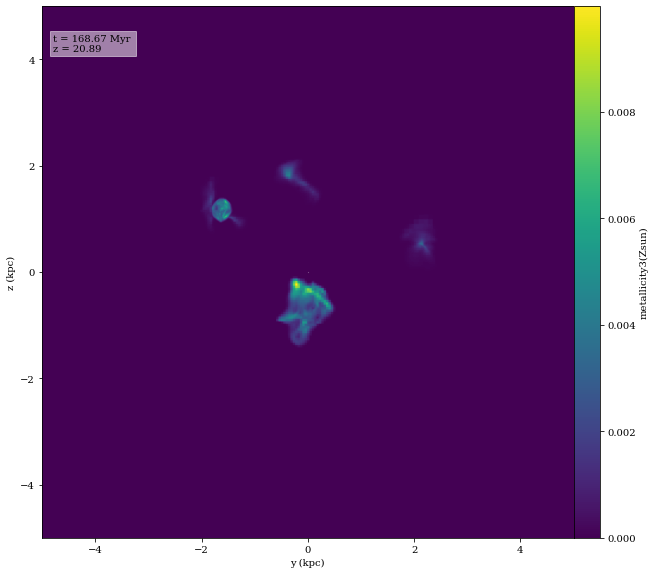

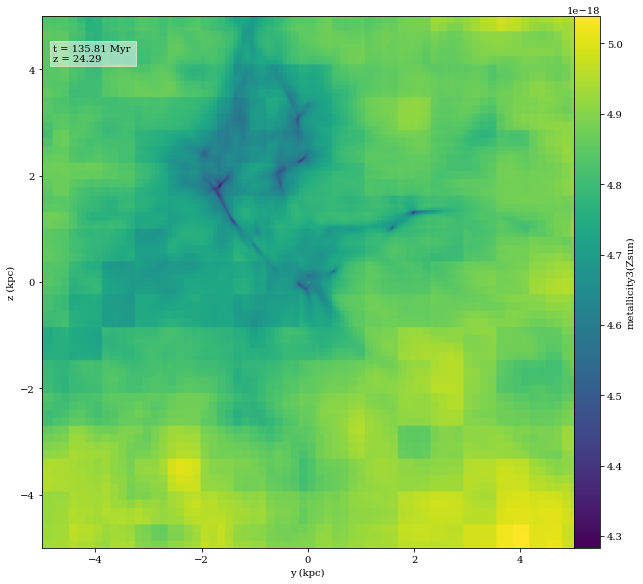

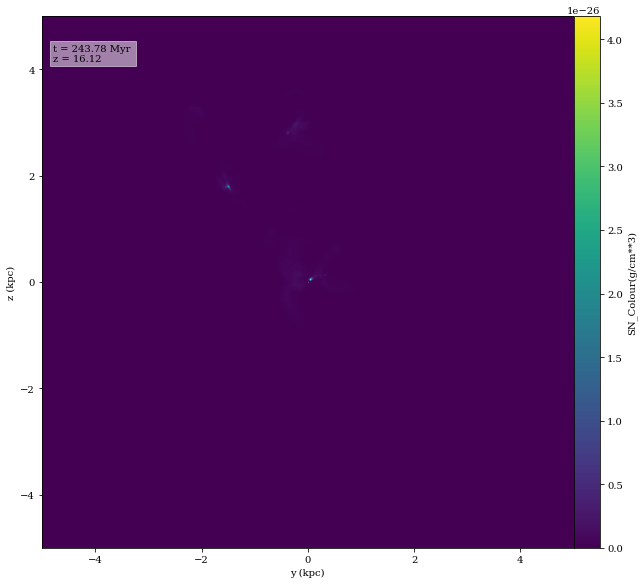

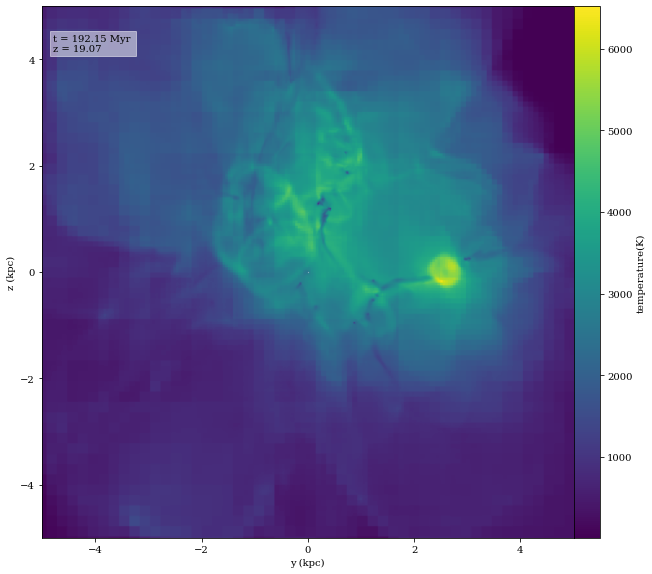

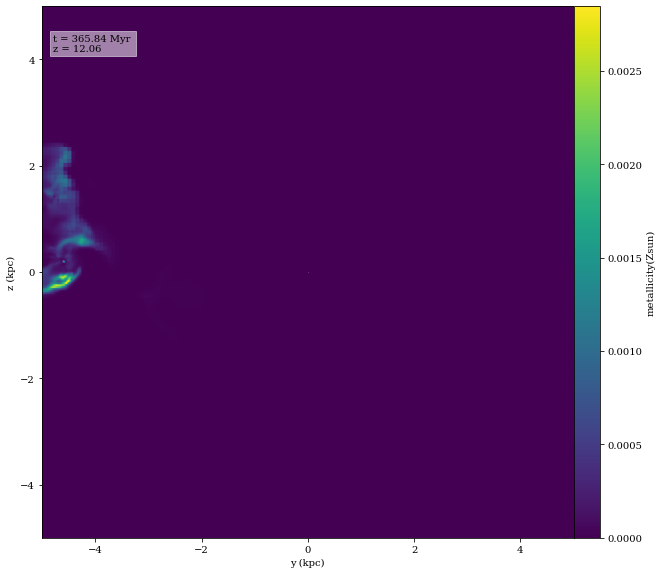

...

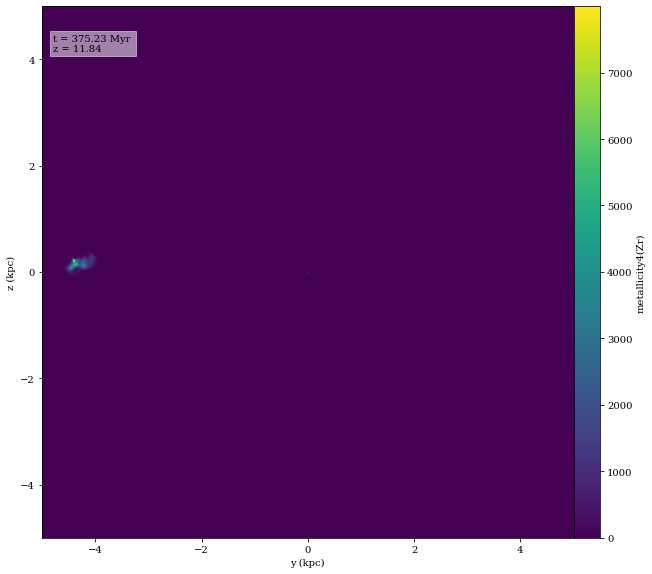

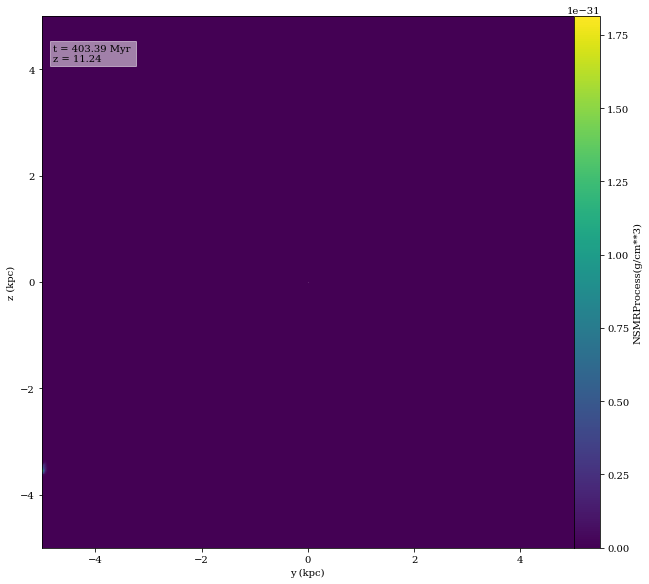

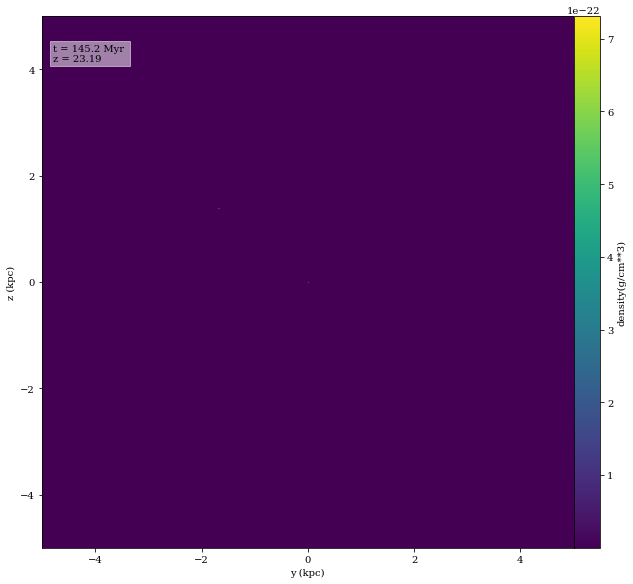

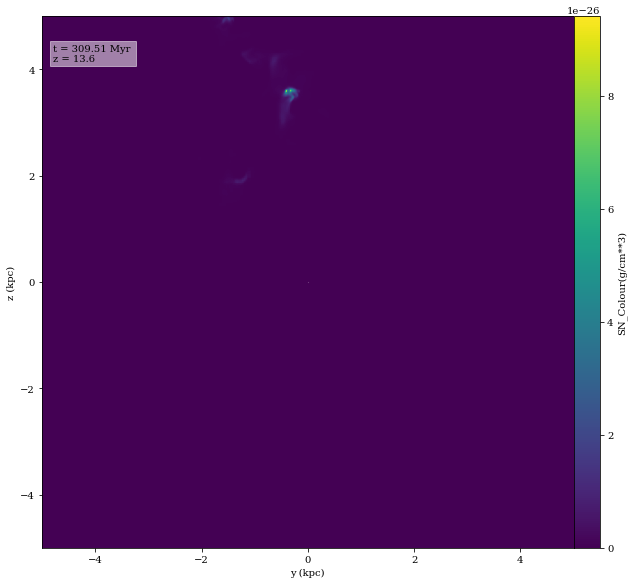

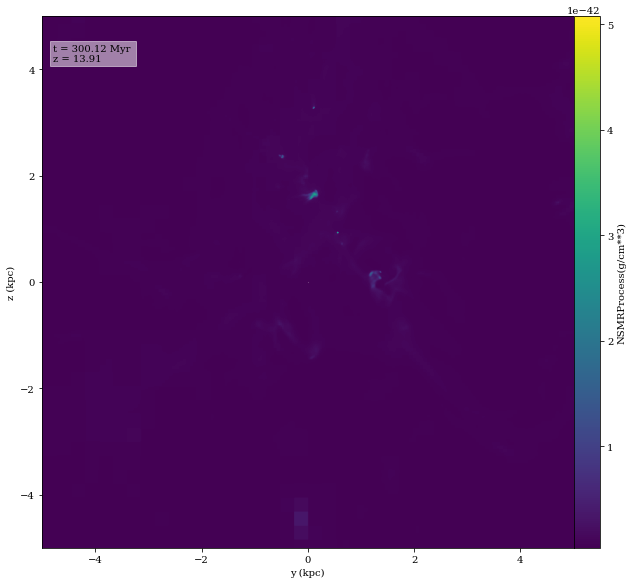

KeyboardInterrupt: 

In [42]:
### Projections

for i in os.listdir(data_dir):
    if i.startswith('projection_'):
        field = i.split('projection_')[1].split('_')[0]
        if field == 'SN':
            field = 'SN_Colour'
        run_name = 'run_' + i.split('run_')[1].split('_')[0]
        o = i.split('.npy')[0].split('_')[-1]
        ds = yt.load(run_name + '/DD' + o + '/output_' + o)
        
        time = run_info[run_name][o]['time']
        redshift = run_info[run_name][o]['redshift']
        
        cbar_label = field + '(' + units_plot[field] + ')'
        vmin = zlim[field][0]
        vmax = zlim[field][1]
        cmap = colorbars[field]
        
        halo_rvir = ds.quan(run_info[run_name][o]['halo_info']['rvir'], 'unitary').to('kpc')
        with open(data_dir + i, 'rb') as f:
            frb = np.load(f)
        
        plot_time_label = 't = ' + str(round(time, 2)) + ' Myr \nz = ' + str(round(redshift, 2))
        bbox = dict(boxstyle='square', fc='white', ec='white', alpha=0.5)
        radius = halo_rvir * 100
        #p2_plot_pos = (p2_pos - halo_pos)
        #p2_list_x = [i[1] for i in p2_plot_pos.v]
        #p2_list_y = [i[2] for i in p2_plot_pos.v]

        fig = plt.figure(figsize=(10,10))
        ax = plt.subplot()
        img = ax.imshow(frb, origin="lower",extent=[-5, 5, -5, 5], cmap = cmap, norm=LogNorm(vmin=vmin, vmax=vmax))
        plt.plot(0, 0, 'o', ms=radius, mec='white', mfc='none')
        #plt.scatter(p2_list_x, p2_list_y, marker = '*', color = 'black', alpha=0.5)

        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0)
        cbar = plt.colorbar(img, cax = cax)
        cbar.set_label(cbar_label)

        ax.set_xlabel('y (kpc)')
        ax.set_ylabel('z (kpc)')
        #ax.set_title(type_name)
        ax.text(-4.8, 4.15, plot_time_label, color='black', bbox=bbox)
        
        plt.savefig(image_outputs + run_name + '/projection_' + field + '_' + o + '.png' )
    
    elif i.startswith('')
    

In [55]:
### Testing

In [15]:
import yt
ds = yt.load('../run_fiducial/DD0053/output_0053')

yt : [INFO     ] 2022-07-15 16:10:40,156 Parameters: current_time              = 47.305043222963
yt : [INFO     ] 2022-07-15 16:10:40,157 Parameters: domain_dimensions         = [64 64 64]
yt : [INFO     ] 2022-07-15 16:10:40,157 Parameters: domain_left_edge          = [0. 0. 0.]
yt : [INFO     ] 2022-07-15 16:10:40,158 Parameters: domain_right_edge         = [1. 1. 1.]
yt : [INFO     ] 2022-07-15 16:10:40,158 Parameters: cosmological_simulation   = 1
yt : [INFO     ] 2022-07-15 16:10:40,158 Parameters: current_redshift          = 15.6963239018
yt : [INFO     ] 2022-07-15 16:10:40,158 Parameters: omega_lambda              = 0.6889
yt : [INFO     ] 2022-07-15 16:10:40,159 Parameters: omega_matter              = 0.3111
yt : [INFO     ] 2022-07-15 16:10:40,159 Parameters: omega_radiation           = 0
yt : [INFO     ] 2022-07-15 16:10:40,159 Parameters: hubble_constant           = 0.6766


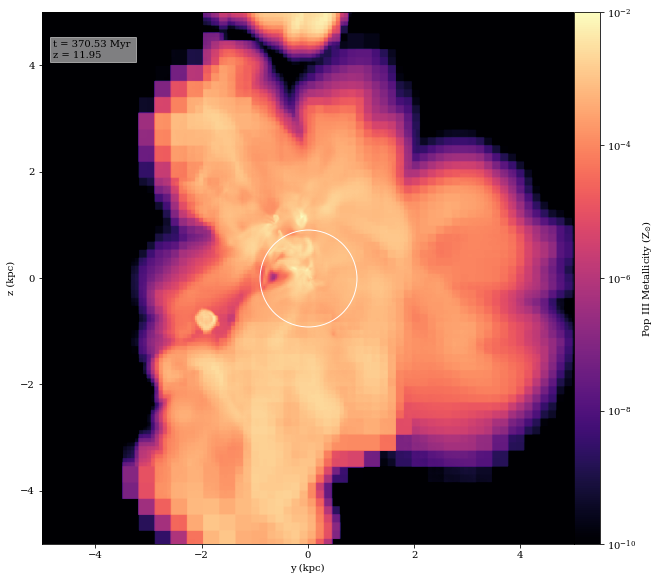

In [9]:
i = 'projection_metallicity3_run_fiducial_0078.npy'
field = i.split('projection_')[1].split('_')[0]
if field == 'SN':
            field = 'SN_Colour'

run_name = 'run_' + i.split('run_')[1].split('_')[0]
o = i.split('.npy')[0].split('_')[-1]

time = run_info[run_name][o]['time']
redshift = run_info[run_name][o]['redshift']

cbar_label = units_plot[field]
vmin = zlim[field][0]
vmax = zlim[field][1]
cmap = colorbars[field]

halo_rvir = ds.quan(run_info[run_name][o]['halo_info']['rvir'], 'unitary').to('kpc')
with open(data_dir + i, 'rb') as f:
    frb = np.load(f)

plot_time_label = 't = ' + str(round(time, 2)) + ' Myr \nz = ' + str(round(redshift, 2))
bbox = dict(boxstyle='square', fc='white', ec='white', alpha=0.5)
radius = halo_rvir.v * 100
#p2_plot_pos = (p2_pos - halo_pos)
#p2_list_x = [i[1] for i in p2_plot_pos.v]
#p2_list_y = [i[2] for i in p2_plot_pos.v]

fig = plt.figure(figsize=(10,10))
ax = plt.subplot()
img = ax.imshow(frb, origin="lower",extent=[-5, 5, -5, 5], cmap = cmap, norm=LogNorm(vmin=vmin, vmax=vmax))
plt.plot(0, 0, 'o', ms=radius, mec='white', mfc='none')
#plt.scatter(p2_list_x, p2_list_y, marker = '*', color = 'black', alpha=0.5)

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0)
cbar = plt.colorbar(img, cax = cax)
cbar.set_label(cbar_label)

ax.set_xlabel('y (kpc)')
ax.set_ylabel('z (kpc)')
#ax.set_title(type_name)
ax.text(-4.8, 4.15, plot_time_label, color='black', bbox=bbox)

plt.show()

In [42]:
zlim_phase = {}
zlim_phase["density"] = (3e-28, 2e-20)
zlim_phase["temperature"] = (2e1, 2e7)
zlim_phase["metallicity3"] = (1e-3, 1)
zlim_phase["metallicity4"] = (1e-15, 1e5)
zlim_phase["mass"] = (1e31, 2e38)

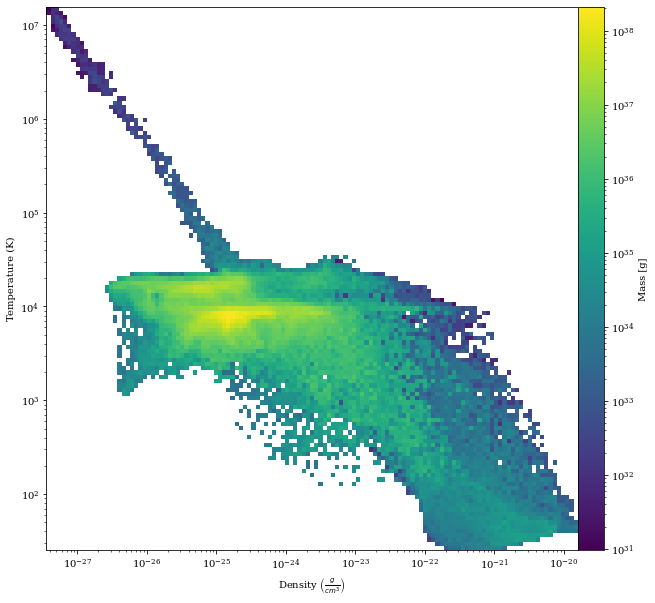

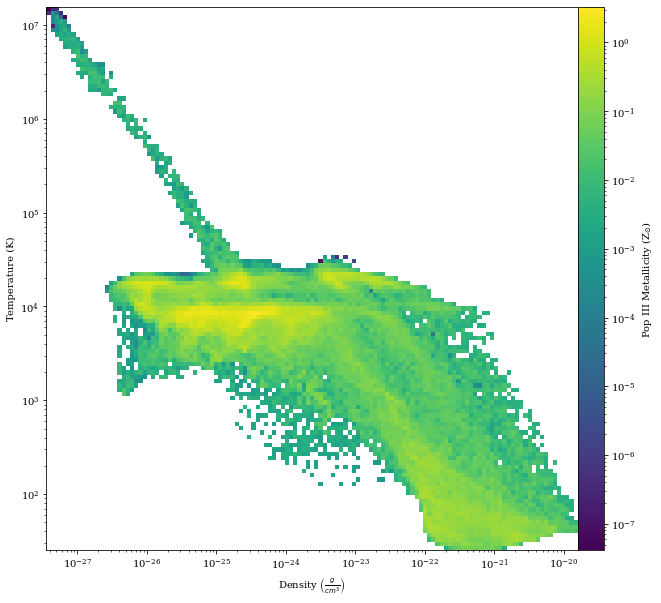

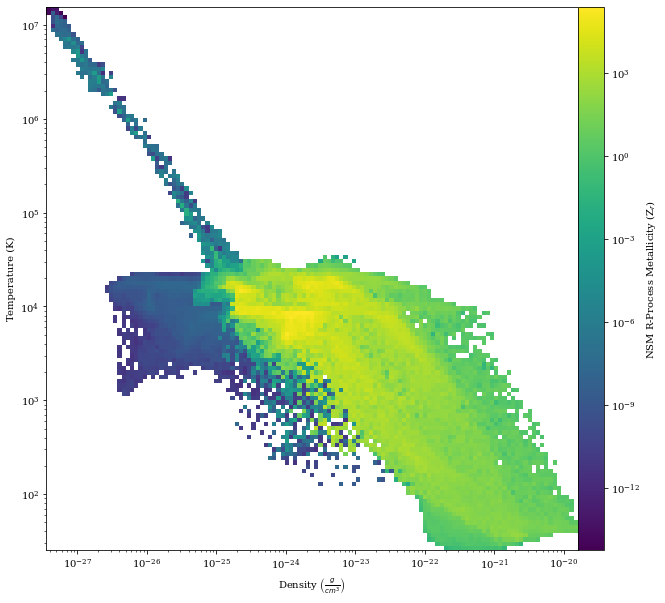

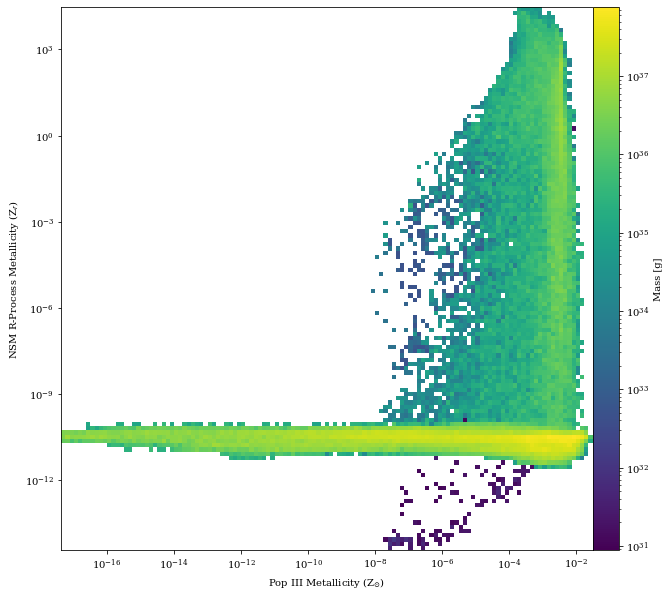

In [45]:
for i, fields in enumerate(phase_plot_fields):
    x_field = fields[0]
    y_field = fields[1]
    
    for z_field in phase_plot_colors[i]:
        with open(data_dir + 'phase_xedges_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_run_fiducial_0078.npy', 'rb') as f:
            xedges = np.load(f)

        with open(data_dir + 'phase_yedges_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_run_fiducial_0078.npy', 'rb') as f:
            yedges = np.load(f)

        with open(data_dir + 'phase_H_'+ x_field[1] + '_' + y_field[1] + '_'+ z_field[1] + '_run_fiducial_0078.npy', 'rb') as f:
            H = np.load(f)
        
        vmin = zlim_phase[z_field[1]][0]
        vmax = zlim_phase[z_field[1]][1]
        
        
        X, Y = np.meshgrid(xedges, yedges)

        fig = plt.figure(figsize=(10,10))
        ax = plt.subplot()
        img = ax.pcolormesh(Y, X, H, norm=LogNorm())#, norm=LogNorm(vmin = vmin, vmax = vmax))
        ax.set_yscale('log')
        ax.set_xscale('log')
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0)
        cbar = plt.colorbar(img, cax = cax)
        
        ax.set_xlabel(units_plot[x_field[1]])
        #ax.set_xlim(zlim_phase[x_field[1]][0], zlim_phase[x_field[1]][1])
        ax.set_ylabel(units_plot[y_field[1]])
        #ax.set_ylim(zlim_phase[y_field[1]][0], zlim_phase[y_field[1]][1])
        #ax.set_title(type_name)
        cbar.set_label(units_plot[z_field[1]])

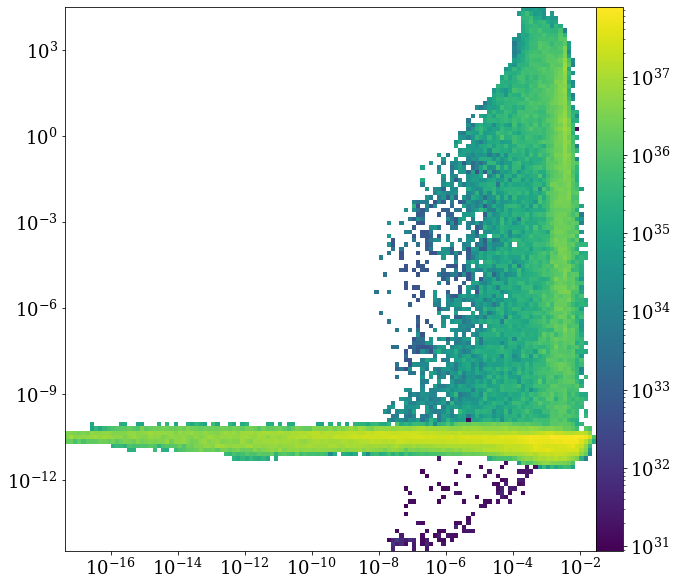

In [83]:
## Phase plots 
with open(data_dir + 'phase_xedges_metallicity3_metallicity4_mass_run_fiducial_0078.npy', 'rb') as f:
    xedges = np.load(f)

with open(data_dir + 'phase_yedges_metallicity3_metallicity4_mass_run_fiducial_0078.npy', 'rb') as f:
    yedges = np.load(f)

with open(data_dir + 'phase_H_metallicity3_metallicity4_mass_run_fiducial_0078.npy', 'rb') as f:
    H = np.load(f)

X, Y = np.meshgrid(xedges, yedges)

fig = plt.figure(figsize=(10,10))
ax = plt.subplot()
img = ax.pcolormesh(Y, X, H, norm=LogNorm())
ax.set_yscale('log')
ax.set_xscale('log')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0)
cbar = plt.colorbar(img, cax = cax)

#ax.set_xlabel(r'Density $\left( \frac{g}{cm^{3}} \right)$')
#ax.set_ylabel('Temperature (K)')
#ax.set_title(type_name)
#cbar.set_label('Mass (g)')